<a href="https://colab.research.google.com/github/MarkovMarkowitz/MarkovMarkowitz/blob/main/Markov_Regime_Change_Models.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# STOCHASTIC MODELING
## Markov Regime Change Models

In [ ]:
!pip3 install statsmodels
!pip3 install pmdarima

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import datetime as dt
from pandas_datareader import data as pdr
import yfinance as yf
from scipy.stats import norm
yf.pdr_override()
import statsmodels.api as sm
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
import statsmodels.tsa
from pmdarima.arima import auto_arima


START = '2019-01-01'
END = '2022-12-31'

# STEP 1. Data Download



In [ ]:
aapl = pdr.get_data_yahoo("AAPL", start= START, end=END)
btcusd = pdr.get_data_yahoo("BTC-USD", start=START, end=END)
tsla = pdr.get_data_yahoo("TSLA", start=START, end=END)
vix = pdr.get_data_yahoo("^VIX", start=START, end=END)


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


In [ ]:
aapl_close = aapl['Adj Close']
aapl_log_returns = aapl_close.pct_change().apply(lambda x: np.log(1+x))
print(aapl_log_returns)

btcusd_close = btcusd['Adj Close']
btcusd_log_returns = btcusd_close.pct_change().apply(lambda x: np.log(1+x))
print(btcusd_log_returns)

tsla_close = tsla['Adj Close']
tsla_log_returns = tsla_close.pct_change().apply(lambda x: np.log(1+x))
print(tsla_log_returns)

Date
2019-01-02         NaN
2019-01-03   -0.104924
2019-01-04    0.041803
2019-01-07   -0.002228
2019-01-08    0.018884
                ...   
2022-12-23   -0.002802
2022-12-27   -0.013976
2022-12-28   -0.031166
2022-12-29    0.027931
2022-12-30    0.002466
Name: Adj Close, Length: 1008, dtype: float64
Date
2019-01-01         NaN
2019-01-02    0.025657
2019-01-03   -0.027422
2019-01-04    0.005452
2019-01-05   -0.003251
                ...   
2022-12-26    0.004610
2022-12-27   -0.012048
2022-12-28   -0.009895
2022-12-29    0.005409
2022-12-30   -0.002392
Name: Adj Close, Length: 1460, dtype: float64
Date
2019-01-02         NaN
2019-01-03   -0.031978
2019-01-04    0.056094
2019-01-07    0.052935
2019-01-08    0.001164
                ...   
2022-12-23   -0.017707
2022-12-27   -0.121138
2022-12-28    0.032553
2022-12-29    0.077726
2022-12-30    0.011102
Name: Adj Close, Length: 1008, dtype: float64


In [ ]:
df = pd.DataFrame()
df["aapl"] = aapl_log_returns
df["btc"] = btcusd_log_returns
df["tsla"] = tsla_log_returns
df["vix"] = vix['Adj Close']


window = 10 # mean days for calculating volatility

# defining volatility for each log returns data
df["aapl.vlt"] = df["aapl"].rolling(window).std()*(252**0.5)
df["btc.vlt"] = df["btc"].rolling(window).std()*(252**0.5)
df["tsla.vlt"] = df["tsla"].rolling(window).std()*(252**0.5)
df["vix.vlt"] = df["vix"]/100

print(df)


                aapl       btc      tsla        vix  aapl.vlt   btc.vlt  \
Date                                                                      
2019-01-02       NaN  0.025657       NaN  23.219999       NaN       NaN   
2019-01-03 -0.104924 -0.027422 -0.031978  25.450001       NaN       NaN   
2019-01-04  0.041803  0.005452  0.056094  21.379999       NaN       NaN   
2019-01-07 -0.002228 -0.012685  0.052935  21.400000       NaN       NaN   
2019-01-08  0.018884  0.001390  0.001164  20.469999       NaN       NaN   
...              ...       ...       ...        ...       ...       ...   
2022-12-23 -0.002802 -0.001986 -0.017707  20.870001  0.330702  0.361927   
2022-12-27 -0.013976 -0.012048 -0.121138  21.650000  0.303544  0.361467   
2022-12-28 -0.031166 -0.009895  0.032553  22.139999  0.302712  0.296312   
2022-12-29  0.027931  0.005409  0.077726  21.440001  0.369174  0.300247   
2022-12-30  0.002466 -0.002392  0.011102  21.670000  0.305035  0.284745   

            tsla.vlt  vi

# STEP 2.a. Data Selection Decision

## Let us plot for all 4 data decide for one of them.

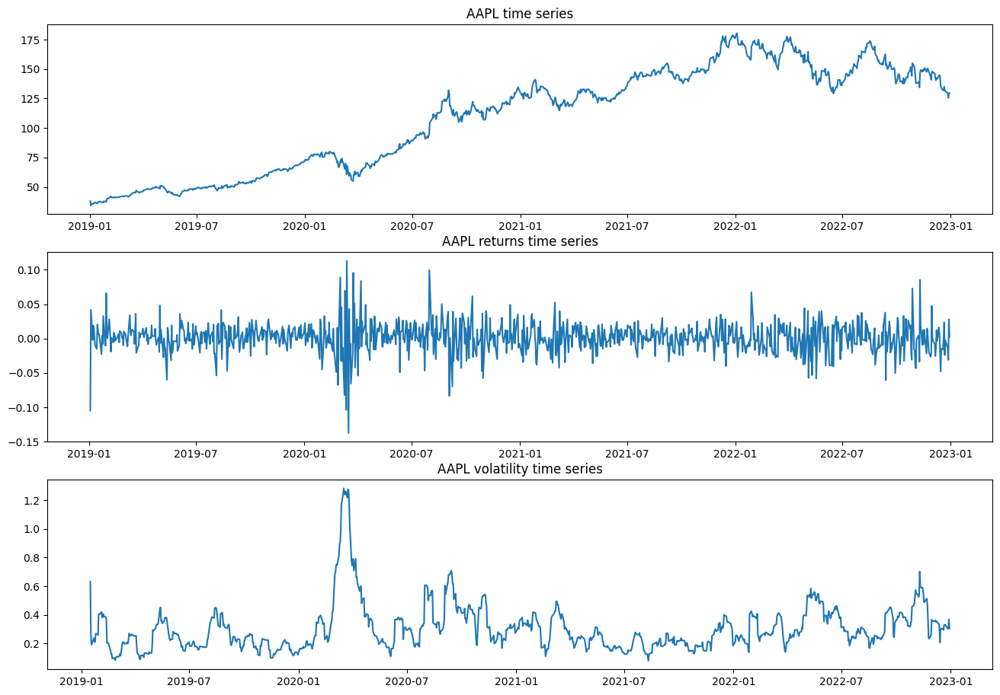

In [ ]:
plt.subplot(3, 1, 1)
plt.plot(aapl_close)
plt.title("AAPL time series")

plt.subplot(3, 1, 2)
plt.plot(df["aapl"])
plt.title("AAPL returns time series")


plt.subplot(3, 1, 3)
plt.plot(df["aapl.vlt"])

plt.title("AAPL volatility time series")

fig = plt.gcf()
fig.set_size_inches(16, 11)
plt.show()

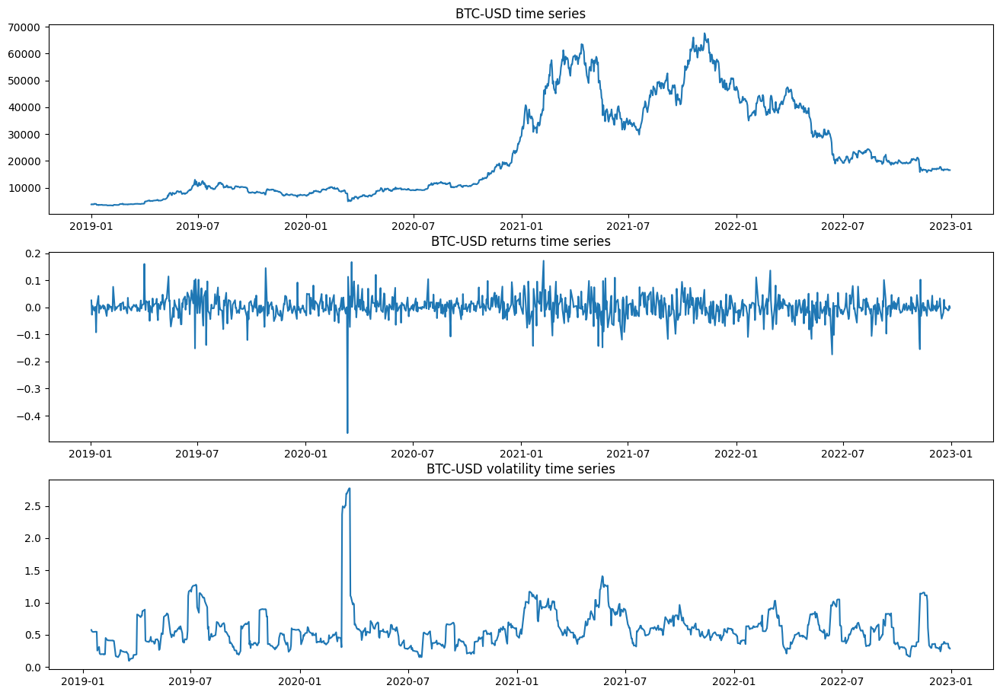

In [ ]:
plt.subplot(3, 1, 1)
plt.plot(btcusd_close)
plt.title("BTC-USD time series")

plt.subplot(3, 1, 2)
plt.plot(df["btc"])
plt.title("BTC-USD returns time series")


plt.subplot(3, 1, 3)
plt.plot(df["btc.vlt"])
plt.title("BTC-USD volatility time series")

fig = plt.gcf()
fig.set_size_inches(16, 11)
plt.show()

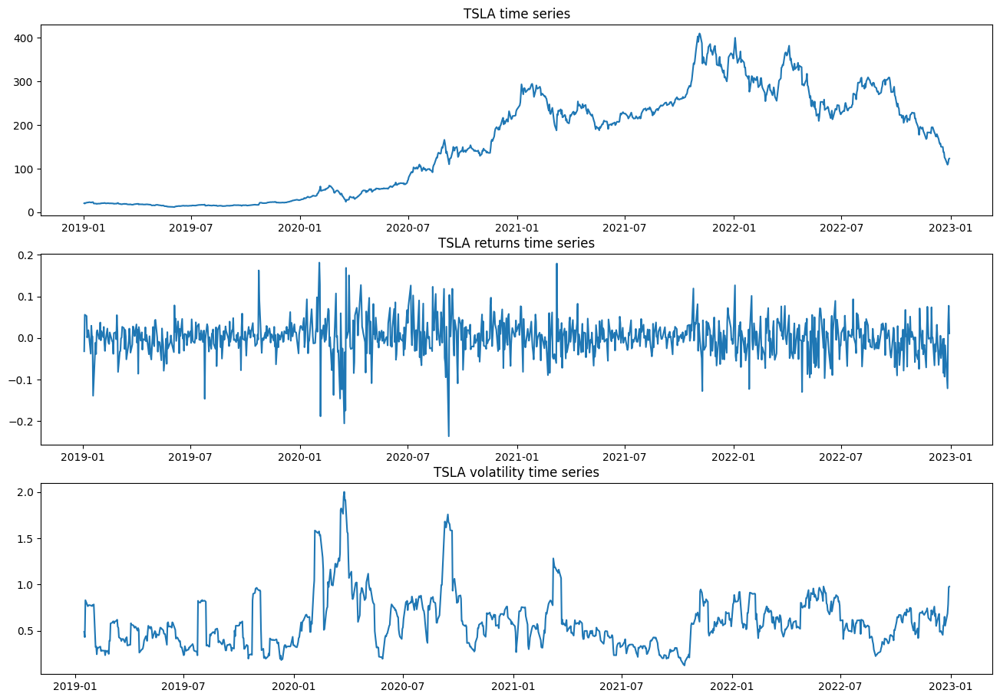

In [ ]:
plt.subplot(3, 1, 1)
plt.plot(tsla_close)
plt.title("TSLA time series")

plt.subplot(3, 1, 2)
plt.plot(df["tsla"])
plt.title("TSLA returns time series")


plt.subplot(3, 1, 3)
plt.plot(df["tsla.vlt"])
plt.title("TSLA volatility time series")

fig = plt.gcf()
fig.set_size_inches(16, 11)
plt.show()

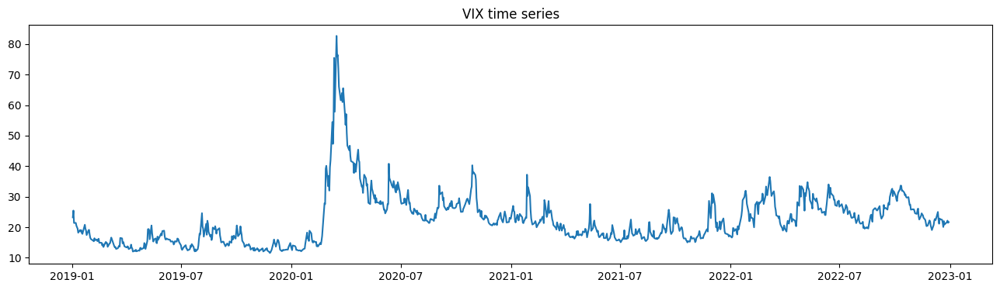

In [ ]:
plt.plot(vix["Adj Close"])
plt.title("VIX time series")


fig = plt.gcf()
fig.set_size_inches(16, 4)
plt.show()

Among these 4 data, we think all can be used for volatility modelling and estimation but we selected VIX as it is a common universal data set for volatility and it is capable of showing the significant volatility change within post-COVID19 markets.

# STEP 2.b Estimate a Markov-regime switching model for VIX

In [ ]:
# Estimation of model with changes in volatility regimes

# Estimation of model with changes in volatility regimes
# Build function that performs the E step
# Likelihood of an observation


def likelihood(xi_prob, mu, sigma, y):
    phi = norm.pdf((y - mu) / sigma)
    y_like = np.dot(xi_prob, phi)

    return y_like


# Hamilton filtering
def forward_alg(pi_hat0, N, T, P, mu, sigma, Y):
    xi_prob_t = np.zeros((T, N))
    xi_prob_t1 = np.zeros((T, N))

    # Case t=1
    y_like = likelihood(pi_hat0, mu, sigma, Y[0])
    for ss in range(0, N):
        phi = np.zeros((N))
        for ss2 in range(0, N):
            phi[ss2] = norm.pdf((Y[0] - mu[ss2]) / sigma[ss2])
    xi_prob_t[0, :] = np.multiply(pi_hat0, phi) / y_like
    for ss in range(0, N):
        xi_prob_t1[0, ss] = np.dot(P[:, ss], xi_prob_t[0, :])

    for tt in range(1, T):
        y_like = likelihood(xi_prob_t1[tt - 1, :], mu, sigma, Y[tt])
        for ss in range(0, N):
            phi = np.zeros((N))
            for ss2 in range(0, N):
                phi[ss2] = norm.pdf((Y[tt] - mu[ss2]) / sigma[ss2])
        xi_prob_t[tt, :] = np.multiply(xi_prob_t1[tt - 1, :], phi) / y_like
        for ss in range(0, N):
            xi_prob_t1[tt, ss] = np.dot(P[:, ss], xi_prob_t[tt, :])

    return xi_prob_t, xi_prob_t1


# Kim filtering
def backward_alg(xi_prob_t, xi_prob_t1, N, T, P, mu, sigma, Y):
    xi_prob_T = np.zeros((T, N))
    xi_prob_T[T - 1, :] = xi_prob_t[T - 1, :]

    for tt in range(T - 2, -1, -1):
        xi_T_xi = np.divide(xi_prob_T[tt + 1, :], xi_prob_t1[tt, :])
        for ss in range(0, N):
            xi_prob_T[tt, ss] = xi_prob_t[tt, ss] * np.dot(P[ss, :], xi_T_xi)

    return xi_prob_T  # , xi_prob_T1


def M_step_func(xi_prob, P, N, T, Y):  #
    mu_hat = np.zeros((N))
    sigma_hat = np.zeros((N))
    P_hat = np.zeros((N, N))
    pi_hat = np.zeros((N))

    for ss in range(0, N):
        xi_y = np.dot(xi_prob[:, ss], Y)
        mu_hat[ss] = xi_y / np.sum(xi_prob[:, ss])

        xi_y_mu2 = np.dot(xi_prob[:, ss], (Y - mu_hat[ss]) ** 2)
        sigma_hat[ss] = (xi_y_mu2 / np.sum(xi_prob[:, ss])) ** 0.5

        for ss2 in range(0, N):
            P_hat[ss, ss2] = np.sum(P[ss, ss2, 1:]) / np.sum(
                P[ss, :, 1:]
            )  # /np.sum(xi_prob[0:T-1,ss]) #np.sum(P[ss,:,1:T])
            # print( np.sum(xi_prob[0:T-1,ss]), np.sum(P[ss,:,1:T]))

        pi_hat[ss] = xi_prob[0, ss]

    return mu_hat, sigma_hat, P_hat, pi_hat

In [ ]:
## Read data for VIX
print (vix)
YDatapd = vix['Adj Close']

YData = YDatapd.to_numpy()
YData = np.log(YData)

                 Open       High        Low      Close  Adj Close  Volume
Date                                                                     
2019-01-02  27.540001  28.530001  23.049999  23.219999  23.219999       0
2019-01-03  25.680000  26.600000  24.049999  25.450001  25.450001       0
2019-01-04  24.360001  24.480000  21.190001  21.379999  21.379999       0
2019-01-07  22.059999  22.709999  20.910000  21.400000  21.400000       0
2019-01-08  20.959999  22.030001  20.090000  20.469999  20.469999       0
...               ...        ...        ...        ...        ...     ...
2022-12-23  22.170000  22.639999  20.780001  20.870001  20.870001       0
2022-12-27  21.670000  22.799999  21.590000  21.650000  21.650000       0
2022-12-28  21.469999  22.260000  20.959999  22.139999  22.139999       0
2022-12-29  22.250000  22.309999  21.360001  21.440001  21.440001       0
2022-12-30  21.830000  22.400000  21.590000  21.670000  21.670000       0

[1008 rows x 6 columns]


## STEP 2.b.i Different number of states. We will try 3 states instead of 2, copying class notes in M4L4.


mu_hat0 = [2.5 3.  3.5], 
sigma_hat0 = [0.3 0.4 0.5], 
P_hat0 = 
[[0.85  0.075 0.075]
 [0.05  0.9   0.05 ]
 [0.15  0.15  0.7  ]], 
pi_hat0 = [0.3333 0.5    0.1667]



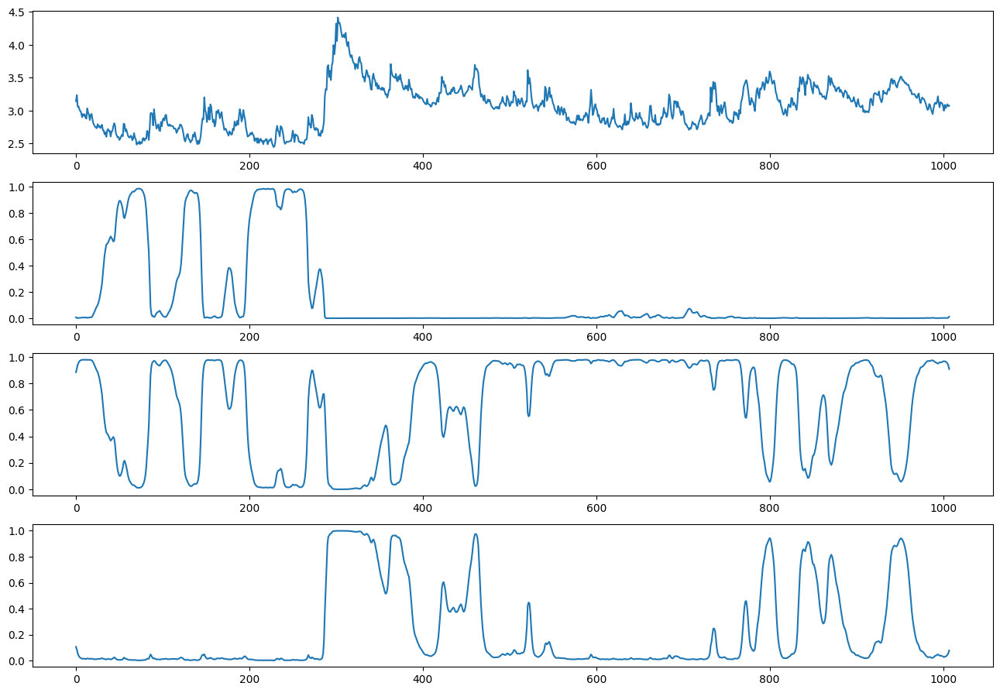


ite=0, max(diff) = 13.903866771601434

mu_hat0 = [2.6101 3.0154 3.4581], 
sigma_hat0 = [0.0974 0.2008 0.278 ], 
P_hat0 = 
[[0.9393 0.0494 0.0112]
 [0.0116 0.9571 0.0313]
 [0.0065 0.0916 0.9019]], 
pi_hat0 = [0.0073 0.8853 0.1074]



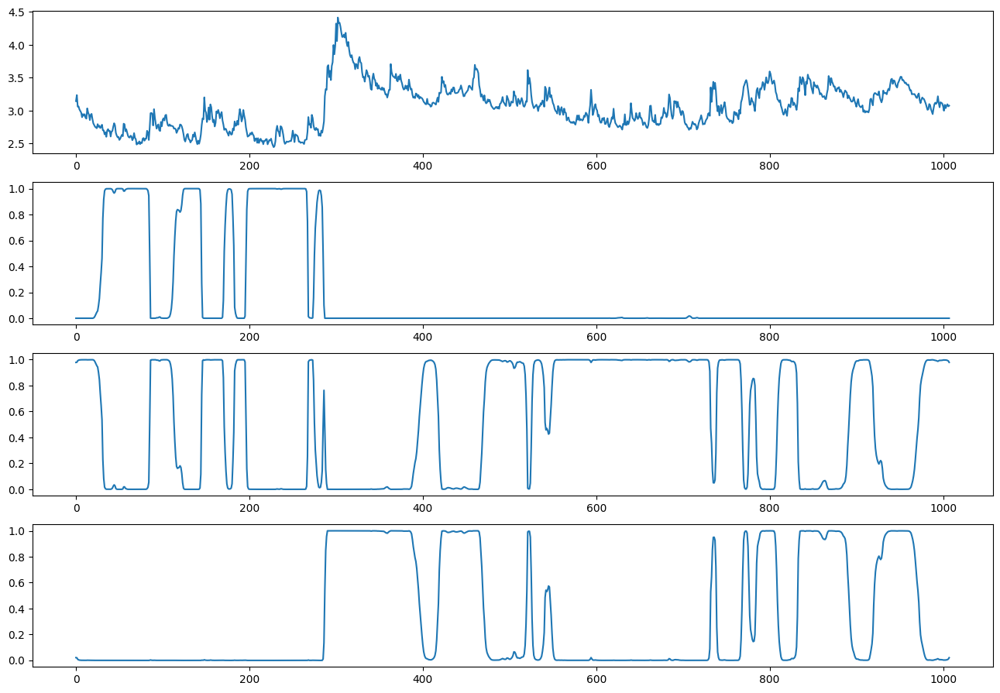


ite=1, max(diff) = 33.50930563218102

mu_hat0 = [2.615  2.9761 3.4222], 
sigma_hat0 = [0.0838 0.1486 0.2323], 
P_hat0 = 
[[0.9705 0.0283 0.0012]
 [0.0102 0.9703 0.0195]
 [0.     0.0319 0.9681]], 
pi_hat0 = [0.     0.9785 0.0215]



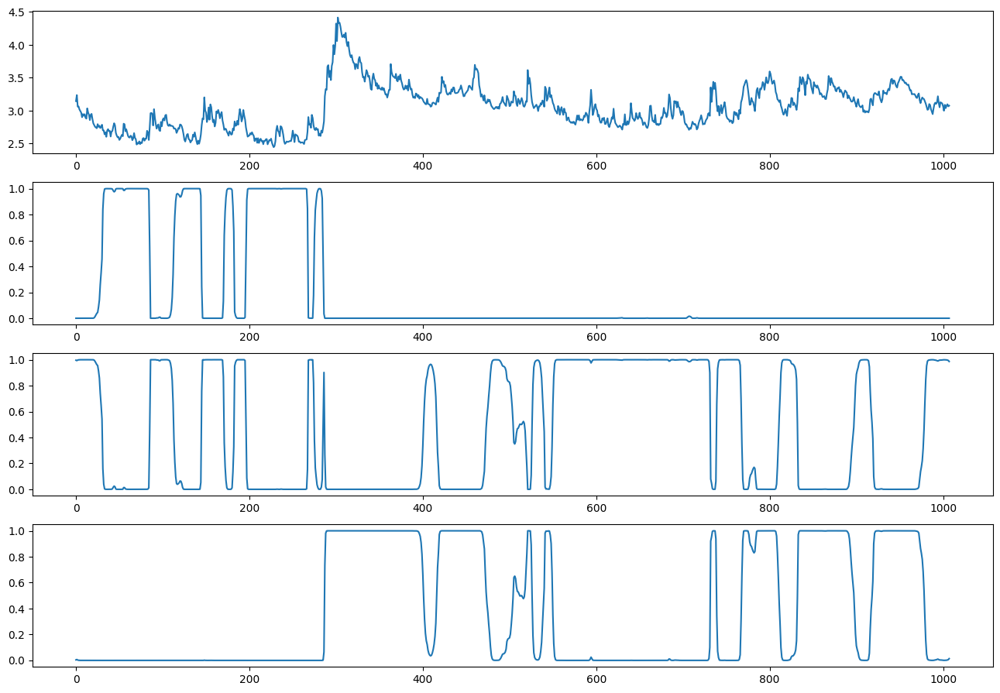


ite=2, max(diff) = 346.95733309774533

mu_hat0 = [2.6164 2.9524 3.3861], 
sigma_hat0 = [0.0839 0.1343 0.2324], 
P_hat0 = 
[[9.714e-01 2.820e-02 4.000e-04]
 [1.140e-02 9.696e-01 1.910e-02]
 [0.000e+00 2.320e-02 9.768e-01]], 
pi_hat0 = [0.     0.9959 0.0041]



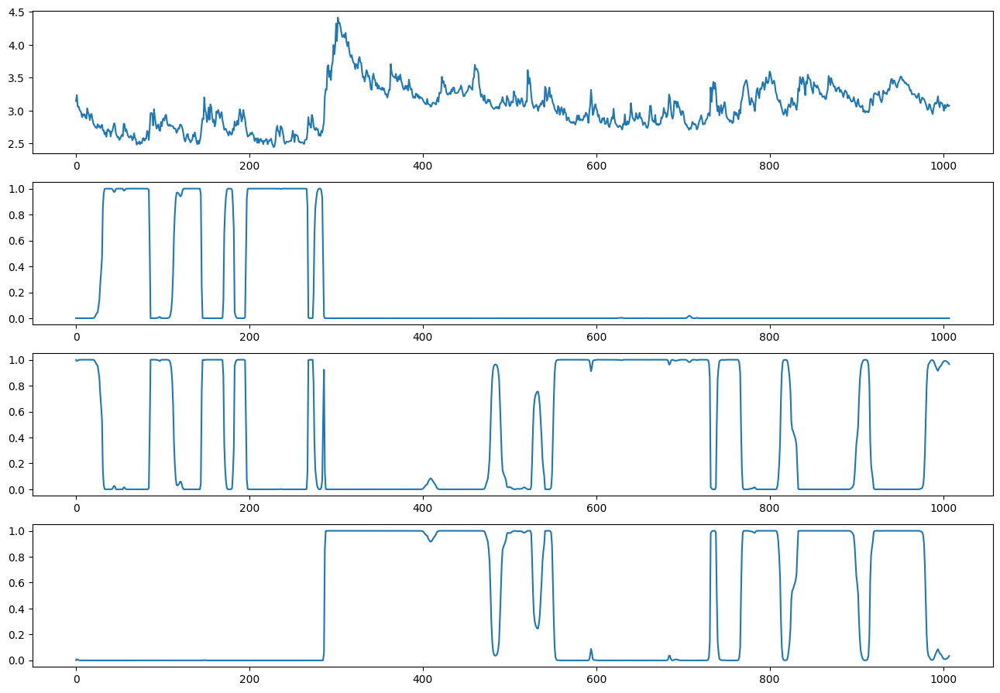


ite=3, max(diff) = 169.97040101749135

mu_hat0 = [2.6165 2.9263 3.3496], 
sigma_hat0 = [0.0839 0.1232 0.2349], 
P_hat0 = 
[[9.714e-01 2.840e-02 2.000e-04]
 [1.320e-02 9.683e-01 1.860e-02]
 [0.000e+00 1.670e-02 9.833e-01]], 
pi_hat0 = [0.     0.9975 0.0025]



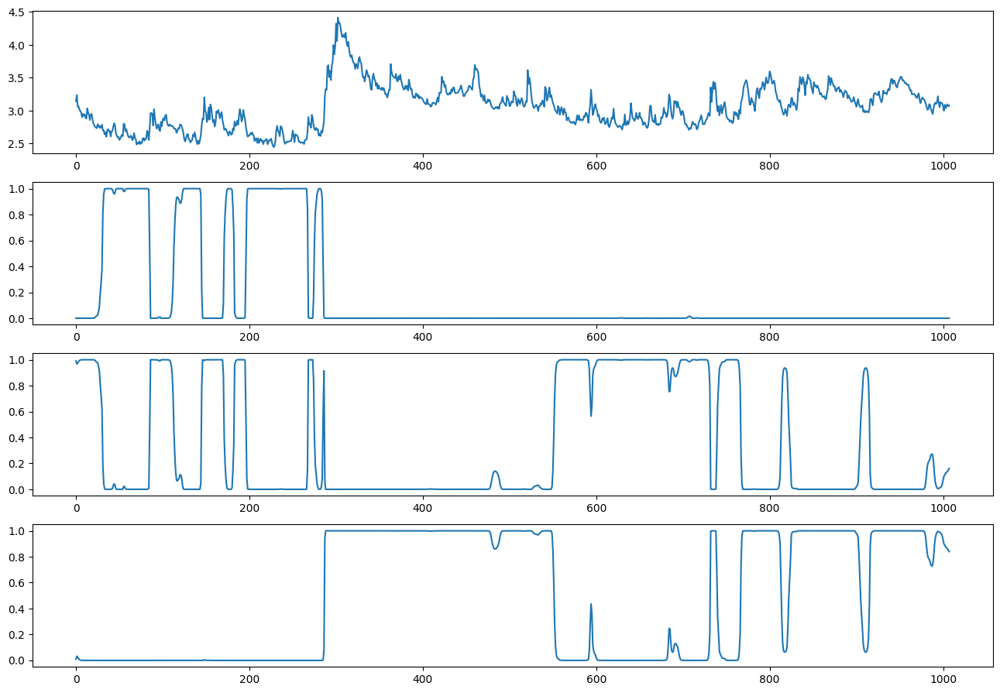


ite=4, max(diff) = 174.70085681201053

mu_hat0 = [2.6153 2.8983 3.3172], 
sigma_hat0 = [0.0833 0.1115 0.2381], 
P_hat0 = 
[[9.709e-01 2.900e-02 1.000e-04]
 [1.550e-02 9.658e-01 1.870e-02]
 [0.000e+00 1.100e-02 9.890e-01]], 
pi_hat0 = [0.     0.9898 0.0102]



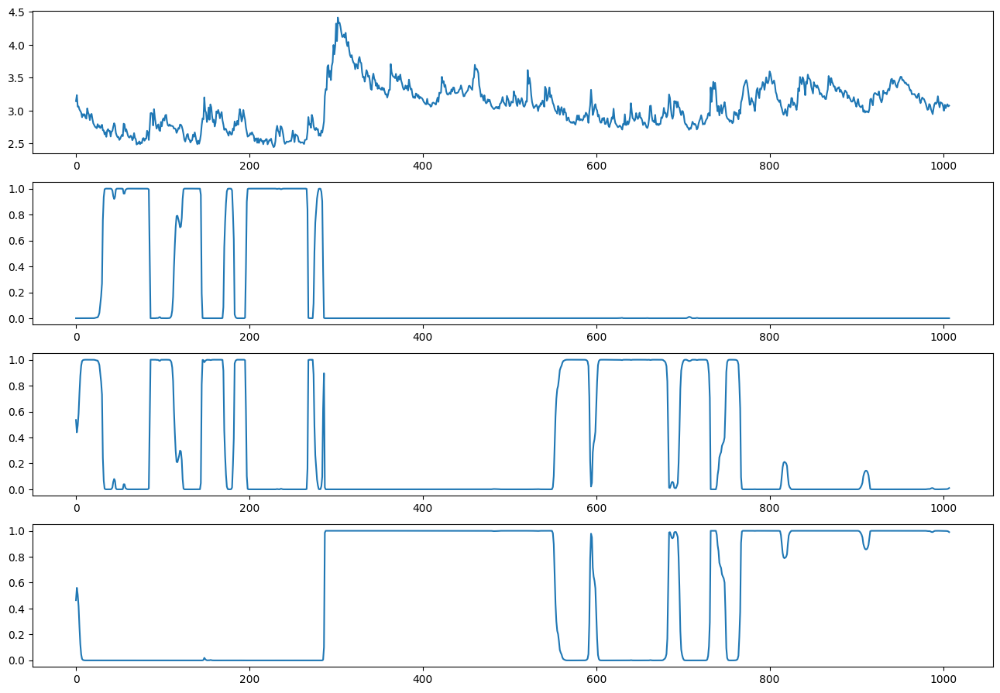


ite=5, max(diff) = 9092.387322744977

mu_hat0 = [2.6129 2.8727 3.2924], 
sigma_hat0 = [0.0821 0.0976 0.2418], 
P_hat0 = 
[[9.697e-01 3.020e-02 1.000e-04]
 [1.830e-02 9.624e-01 1.930e-02]
 [0.000e+00 9.400e-03 9.906e-01]], 
pi_hat0 = [0.     0.5352 0.4648]



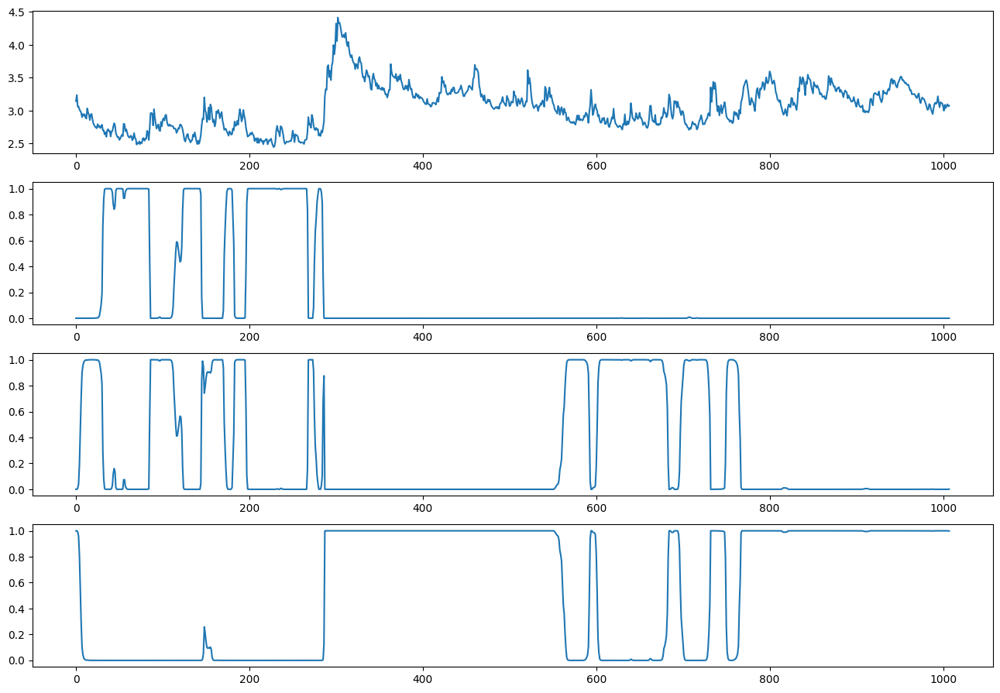


ite=6, max(diff) = 10693.05777976833

mu_hat0 = [2.6101 2.8578 3.2802], 
sigma_hat0 = [0.0806 0.0896 0.2437], 
P_hat0 = 
[[9.679e-01 3.200e-02 1.000e-04]
 [2.050e-02 9.596e-01 2.000e-02]
 [0.000e+00 9.500e-03 9.905e-01]], 
pi_hat0 = [0.000e+00 6.000e-04 9.994e-01]



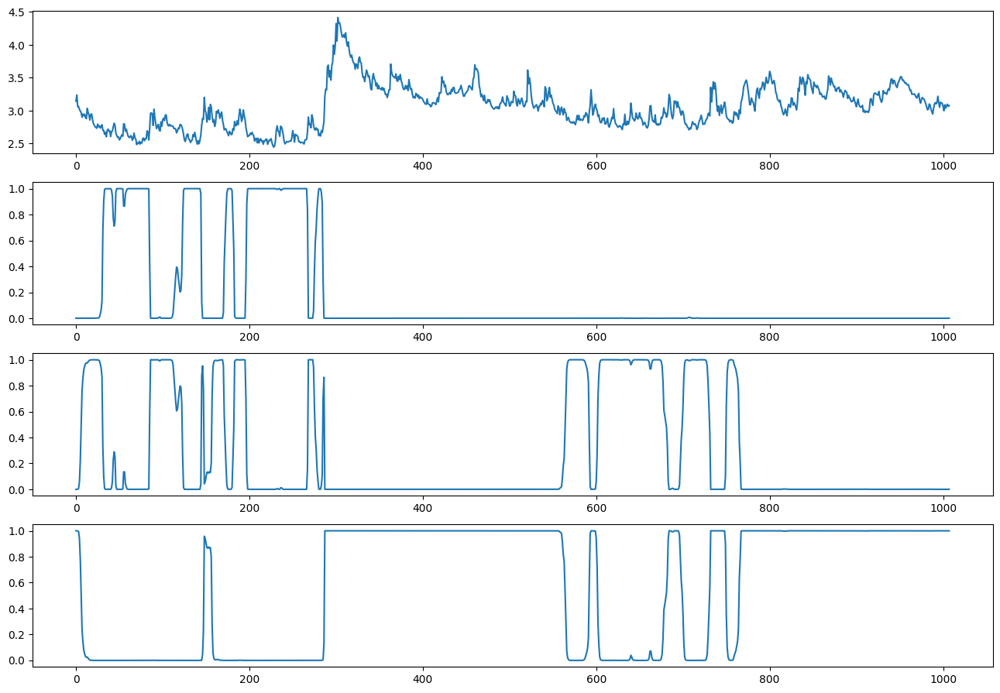


ite=7, max(diff) = 184.15831151459125

mu_hat0 = [2.6072 2.8482 3.2714], 
sigma_hat0 = [0.0789 0.0846 0.2459], 
P_hat0 = 
[[9.658e-01 3.410e-02 1.000e-04]
 [2.240e-02 9.535e-01 2.410e-02]
 [0.000e+00 1.050e-02 9.895e-01]], 
pi_hat0 = [0. 0. 1.]



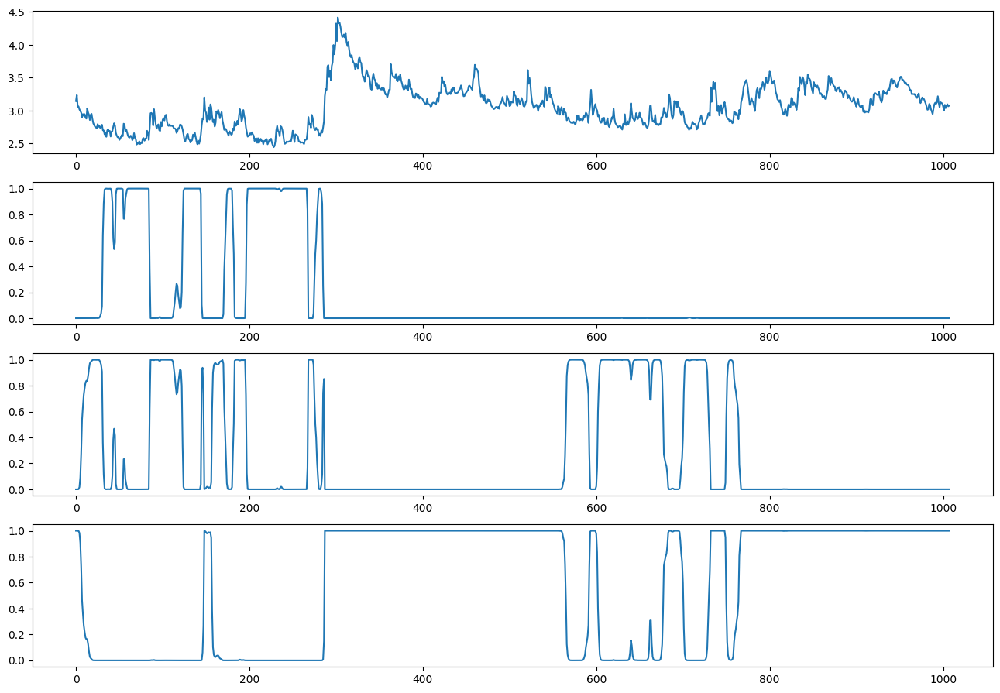


ite=8, max(diff) = 145.29002013805615

mu_hat0 = [2.6047 2.8422 3.2657], 
sigma_hat0 = [0.0773 0.0825 0.2474], 
P_hat0 = 
[[9.634e-01 3.650e-02 1.000e-04]
 [2.430e-02 9.492e-01 2.660e-02]
 [0.000e+00 1.110e-02 9.889e-01]], 
pi_hat0 = [0. 0. 1.]



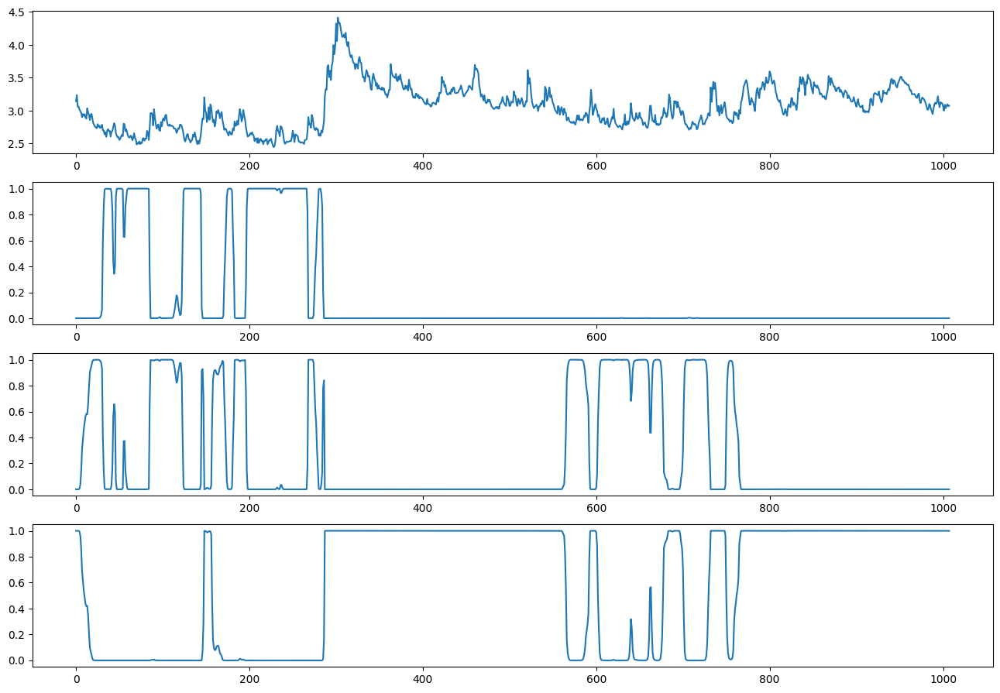


ite=9, max(diff) = 154.35208881934975

mu_hat0 = [2.6022 2.8371 3.2611], 
sigma_hat0 = [0.0756 0.0809 0.2487], 
P_hat0 = 
[[0.9608 0.0391 0.    ]
 [0.0261 0.9447 0.0292]
 [0.     0.0117 0.9883]], 
pi_hat0 = [0. 0. 1.]



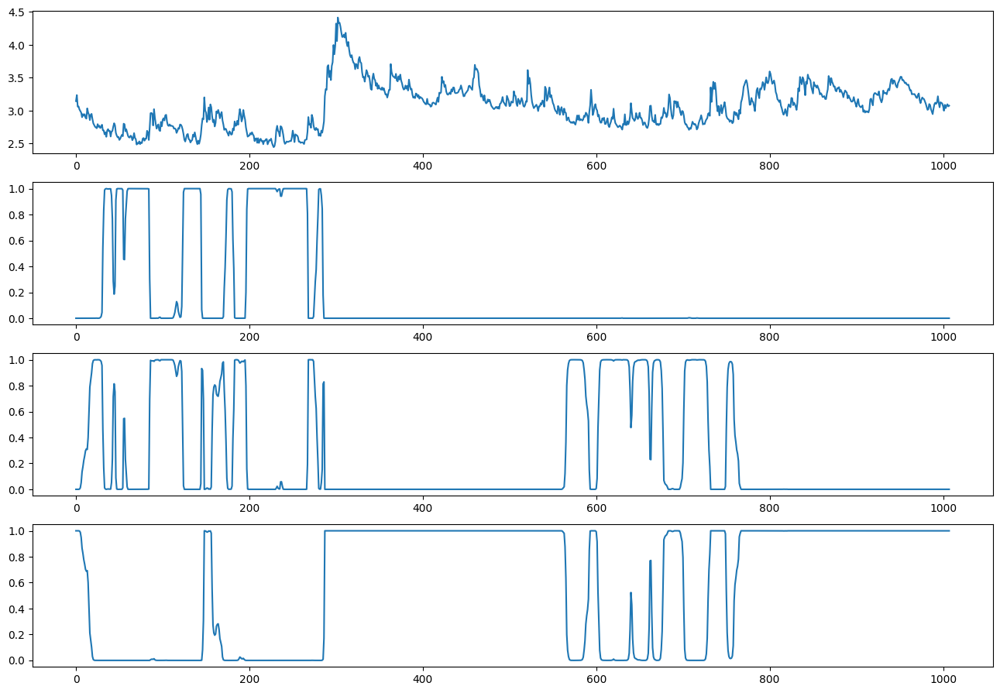


ite=10, max(diff) = 168.19604969734542

mu_hat0 = [2.5999 2.8321 3.2565], 
sigma_hat0 = [0.0739 0.0791 0.25  ], 
P_hat0 = 
[[0.9581 0.0419 0.    ]
 [0.0282 0.9397 0.0321]
 [0.     0.0123 0.9877]], 
pi_hat0 = [0. 0. 1.]



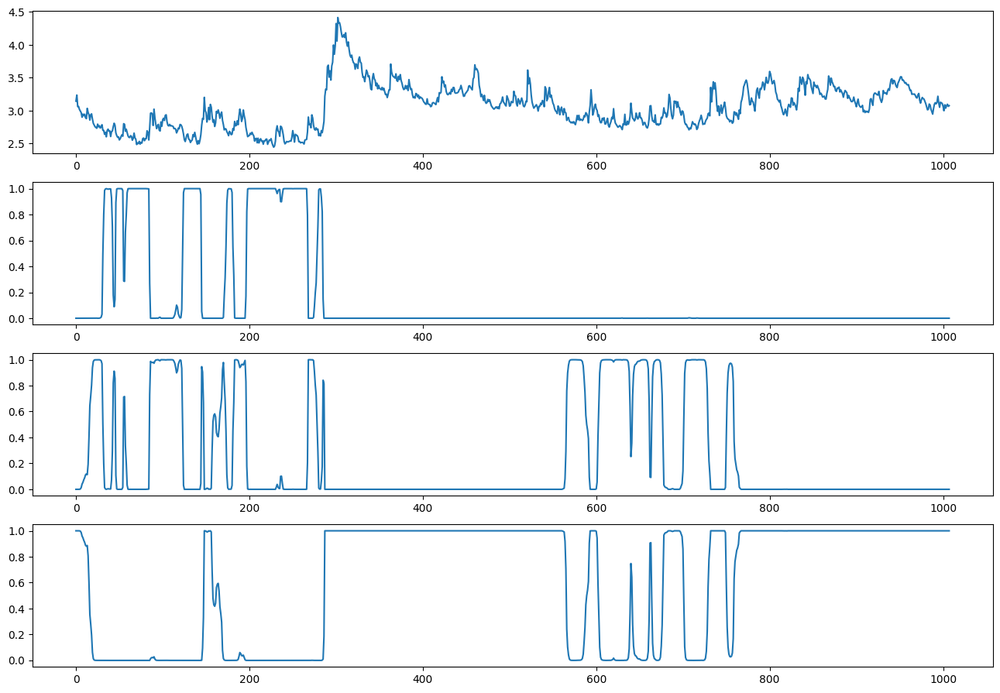


ite=11, max(diff) = 175.48200401955293

mu_hat0 = [2.5978 2.8267 3.2513], 
sigma_hat0 = [0.0723 0.0768 0.2515], 
P_hat0 = 
[[0.9555 0.0445 0.    ]
 [0.0305 0.9341 0.0354]
 [0.     0.013  0.987 ]], 
pi_hat0 = [0. 0. 1.]



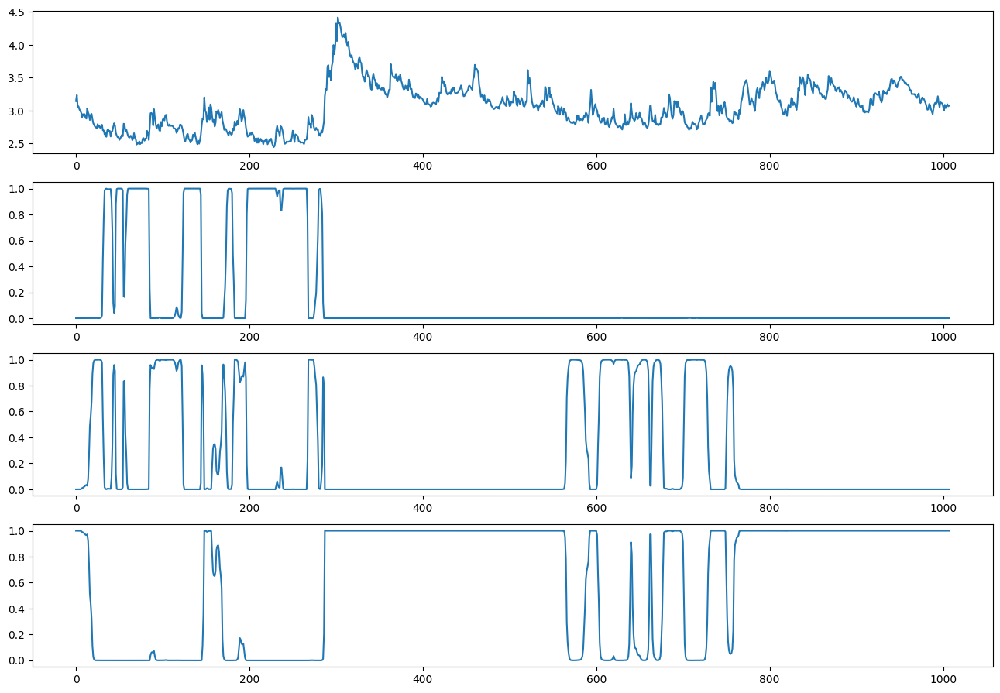


ite=12, max(diff) = 166.74743329320918

mu_hat0 = [2.5961 2.8214 3.246 ], 
sigma_hat0 = [0.0711 0.0744 0.253 ], 
P_hat0 = 
[[0.9534 0.0466 0.    ]
 [0.0327 0.9285 0.0388]
 [0.     0.0135 0.9865]], 
pi_hat0 = [0. 0. 1.]



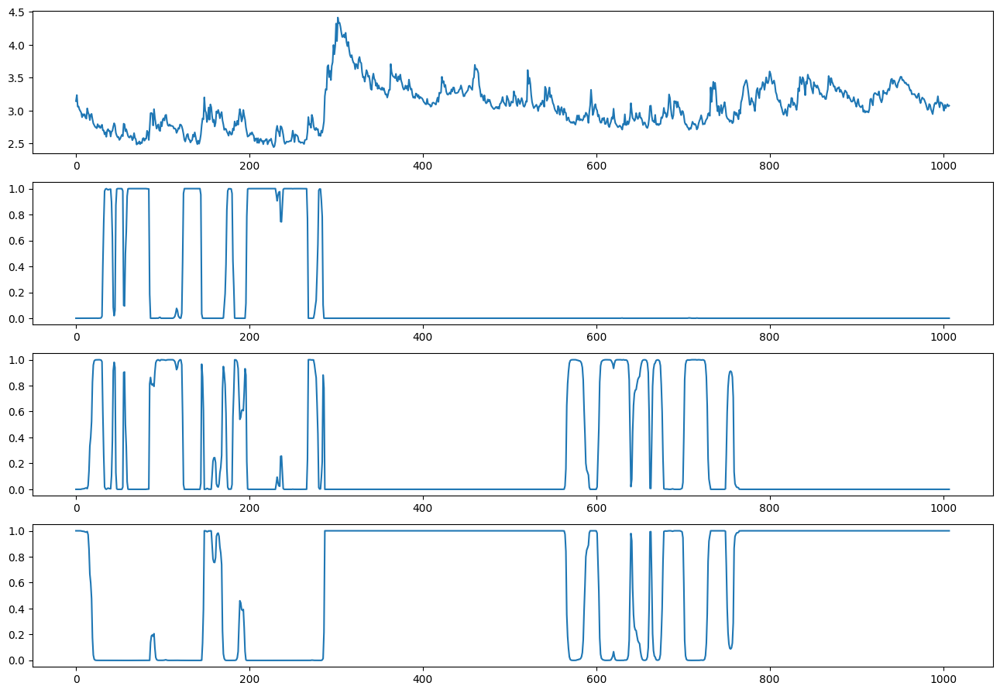


ite=13, max(diff) = 172.19166613436184

mu_hat0 = [2.5947 2.8163 3.2409], 
sigma_hat0 = [0.07   0.0722 0.2545], 
P_hat0 = 
[[0.9516 0.0484 0.    ]
 [0.0349 0.9223 0.0428]
 [0.     0.0141 0.9859]], 
pi_hat0 = [0. 0. 1.]



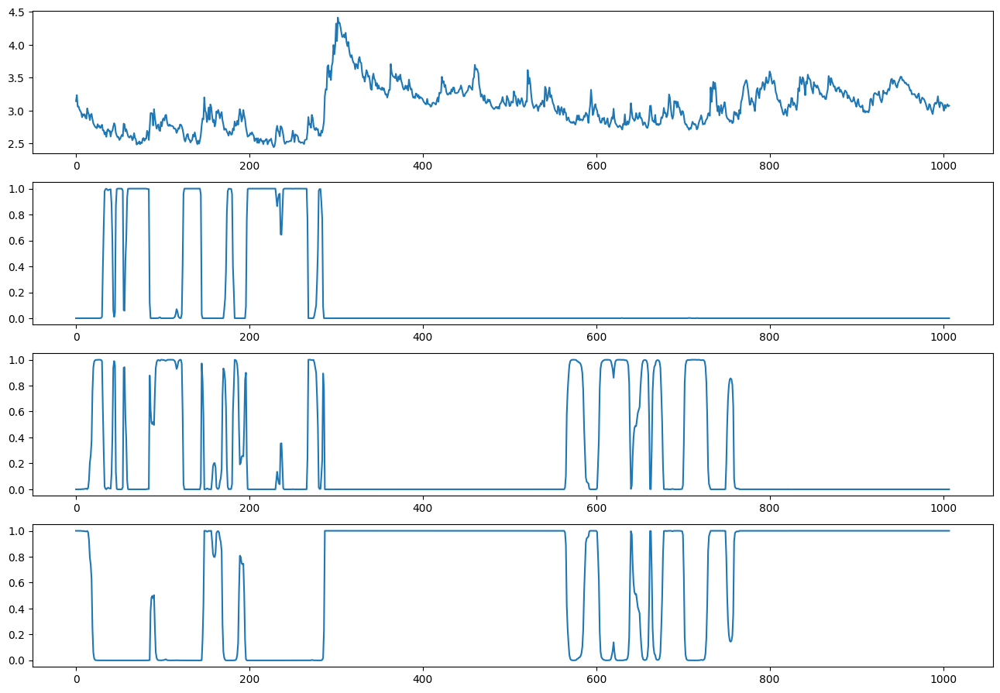


ite=14, max(diff) = 210.73063612627934

mu_hat0 = [2.5935 2.8105 3.2351], 
sigma_hat0 = [0.0692 0.0692 0.2561], 
P_hat0 = 
[[0.95   0.05   0.    ]
 [0.0375 0.9141 0.0484]
 [0.     0.0149 0.9851]], 
pi_hat0 = [0. 0. 1.]



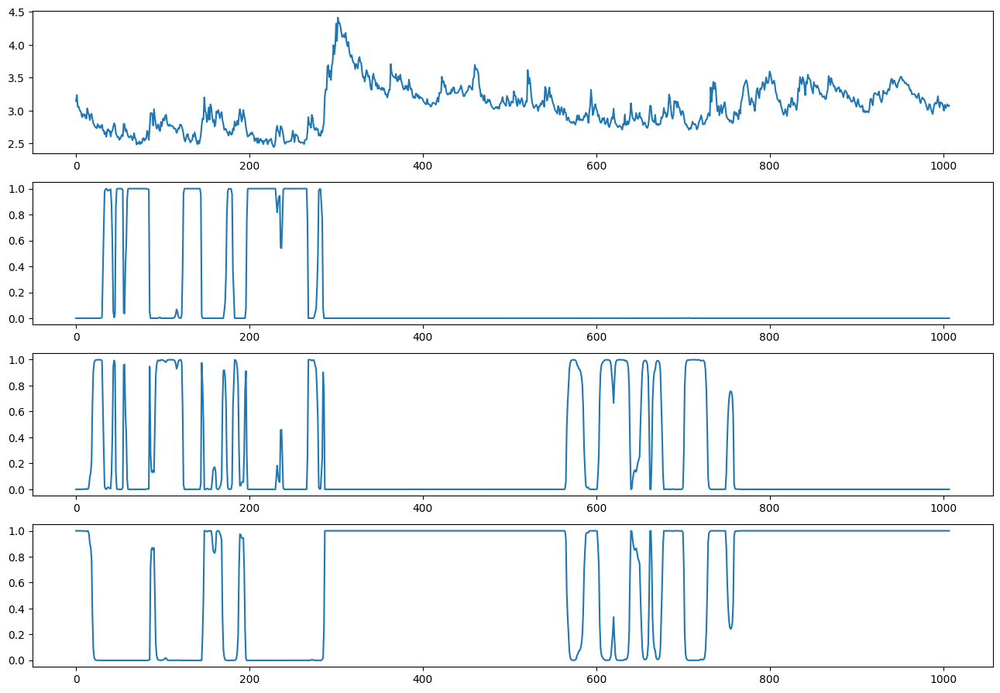


ite=15, max(diff) = 232.8018260446575

mu_hat0 = [2.5925 2.8038 3.2286], 
sigma_hat0 = [0.0684 0.0655 0.2579], 
P_hat0 = 
[[0.9485 0.0515 0.    ]
 [0.0407 0.9046 0.0546]
 [0.     0.0156 0.9844]], 
pi_hat0 = [0. 0. 1.]



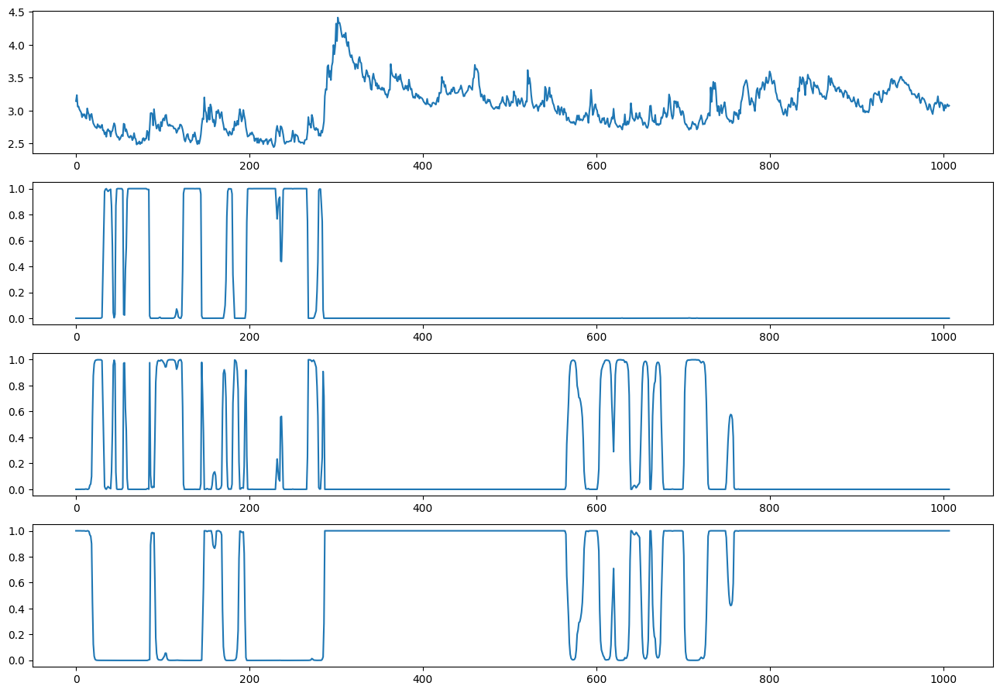


ite=16, max(diff) = 211.61432649291817

mu_hat0 = [2.5917 2.7979 3.2224], 
sigma_hat0 = [0.0677 0.0624 0.2597], 
P_hat0 = 
[[0.947  0.053  0.    ]
 [0.0442 0.8957 0.06  ]
 [0.     0.0158 0.9842]], 
pi_hat0 = [0. 0. 1.]



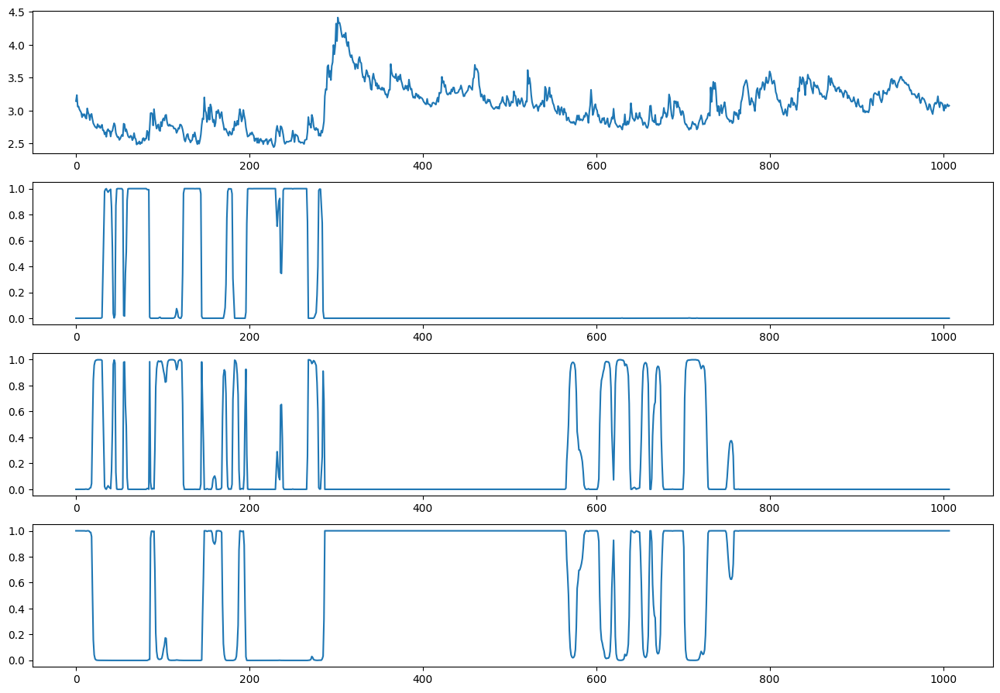


ite=17, max(diff) = 201.10342922008513

mu_hat0 = [2.5909 2.7923 3.2163], 
sigma_hat0 = [0.0671 0.0601 0.2616], 
P_hat0 = 
[[0.9456 0.0543 0.    ]
 [0.0481 0.8872 0.0647]
 [0.     0.0157 0.9843]], 
pi_hat0 = [0. 0. 1.]



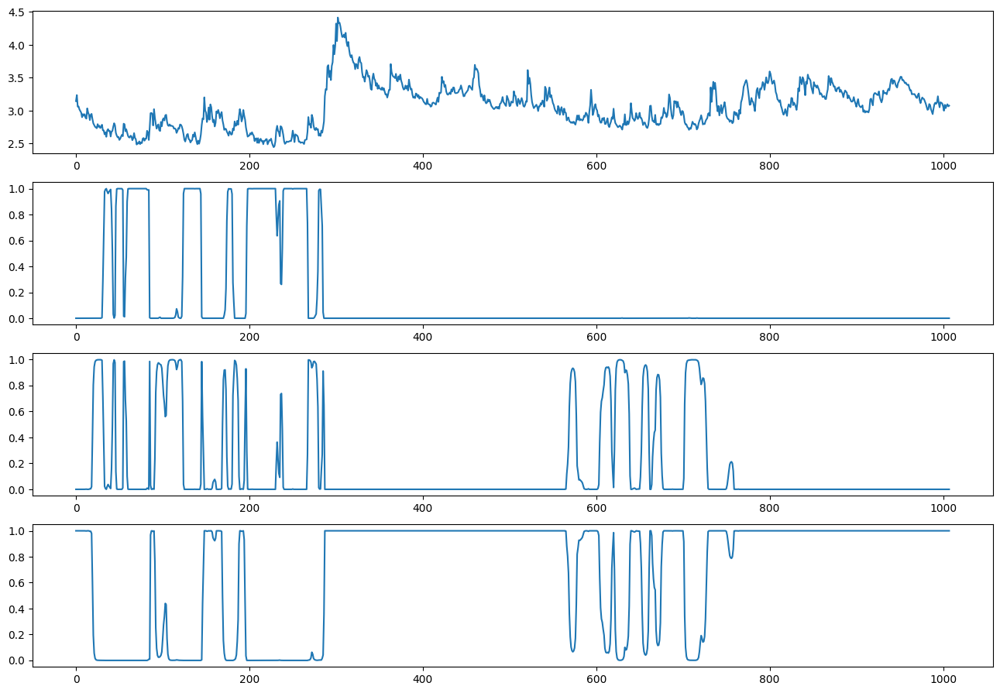


ite=18, max(diff) = 218.72789090765312

mu_hat0 = [2.59   2.7868 3.2102], 
sigma_hat0 = [0.0664 0.058  0.2636], 
P_hat0 = 
[[0.9442 0.0558 0.    ]
 [0.0525 0.8779 0.0697]
 [0.     0.0155 0.9845]], 
pi_hat0 = [0. 0. 1.]



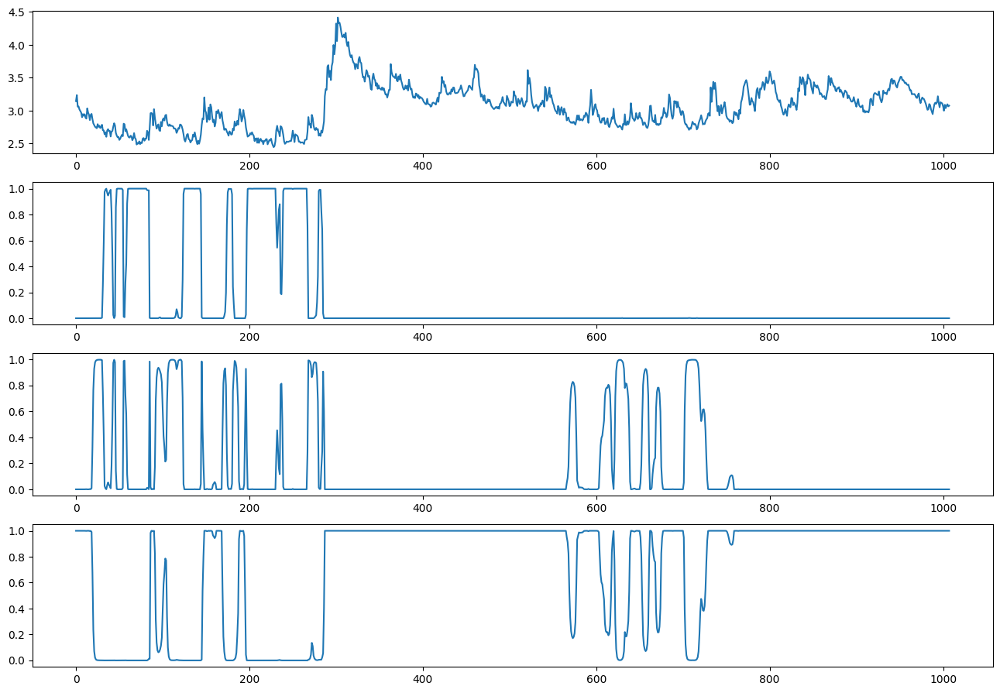


ite=19, max(diff) = 287.177139191593

mu_hat0 = [2.5889 2.7801 3.2028], 
sigma_hat0 = [0.0657 0.0554 0.266 ], 
P_hat0 = 
[[0.9427 0.0573 0.    ]
 [0.0585 0.8654 0.0762]
 [0.     0.0152 0.9848]], 
pi_hat0 = [0. 0. 1.]



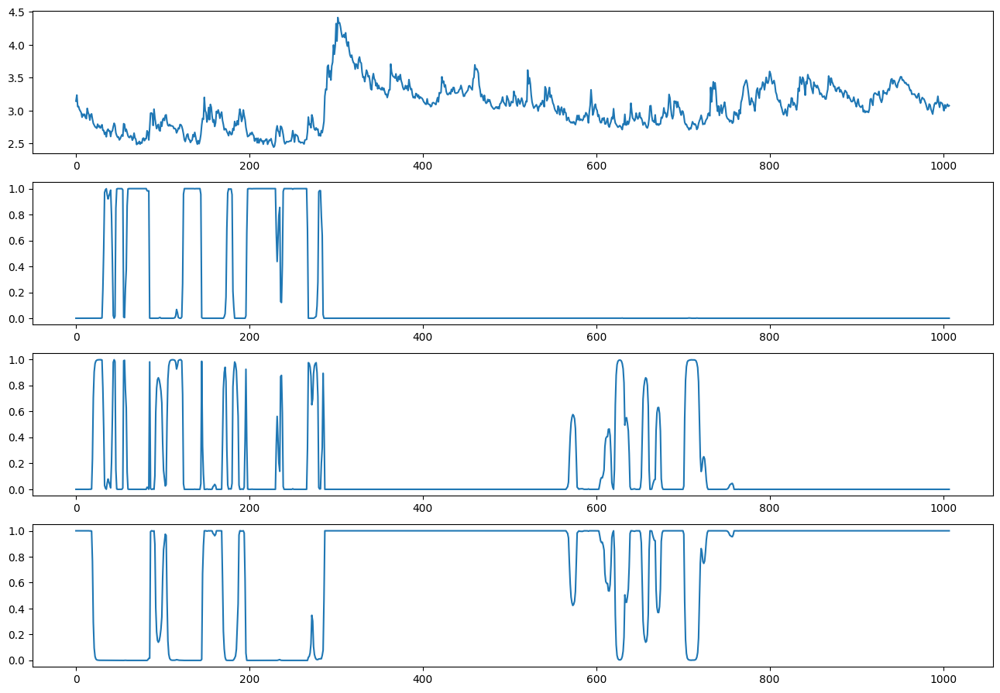


ite=20, max(diff) = 393.0075740744419

mu_hat0 = [2.5878 2.771  3.193 ], 
sigma_hat0 = [0.0649 0.0513 0.2692], 
P_hat0 = 
[[0.941  0.059  0.    ]
 [0.0683 0.8485 0.0832]
 [0.     0.0141 0.9859]], 
pi_hat0 = [0. 0. 1.]



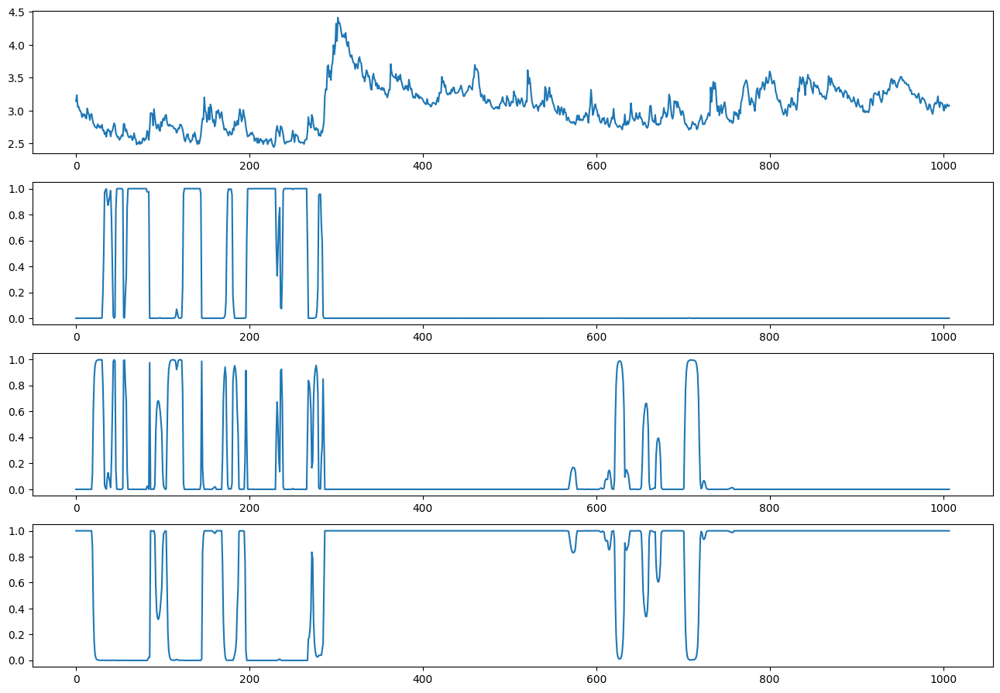


ite=21, max(diff) = 466.0035365241442

mu_hat0 = [2.5866 2.761  3.1828], 
sigma_hat0 = [0.064  0.0456 0.2727], 
P_hat0 = 
[[0.939  0.061  0.    ]
 [0.0824 0.8289 0.0887]
 [0.     0.0124 0.9876]], 
pi_hat0 = [0. 0. 1.]



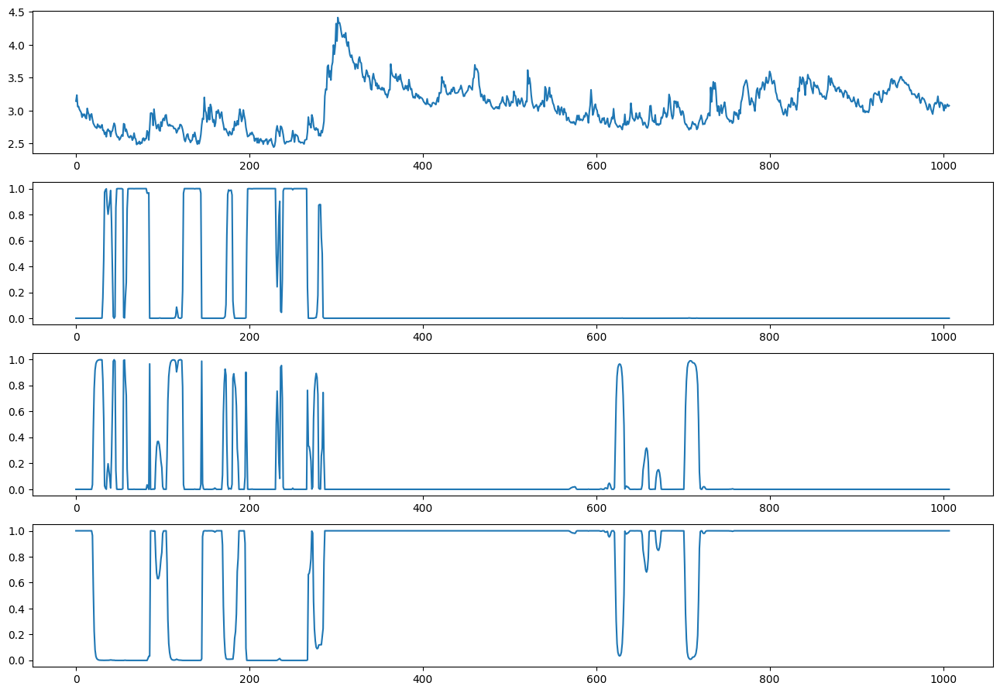


ite=22, max(diff) = 409.76955198187795

mu_hat0 = [2.5853 2.7537 3.1743], 
sigma_hat0 = [0.0631 0.0411 0.2757], 
P_hat0 = 
[[9.371e-01 6.280e-02 1.000e-04]
 [9.810e-02 8.121e-01 8.970e-02]
 [0.000e+00 1.050e-02 9.895e-01]], 
pi_hat0 = [0. 0. 1.]



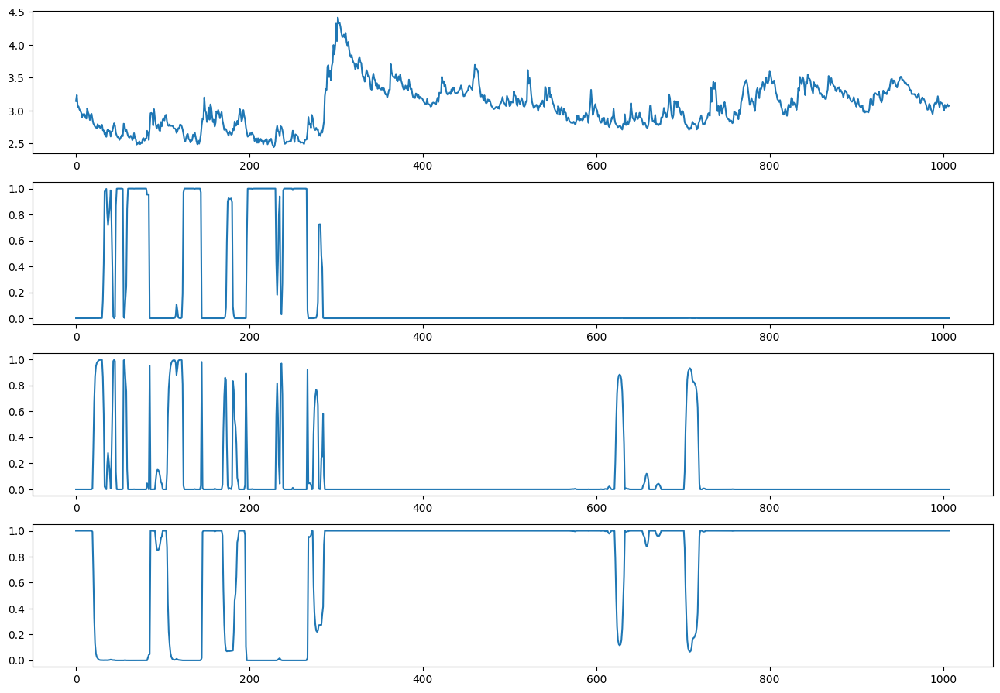


ite=23, max(diff) = 340.849068077733

mu_hat0 = [2.5839 2.7494 3.1674], 
sigma_hat0 = [0.0624 0.0387 0.2785], 
P_hat0 = 
[[9.361e-01 6.340e-02 5.000e-04]
 [1.125e-01 7.975e-01 9.000e-02]
 [0.000e+00 9.100e-03 9.909e-01]], 
pi_hat0 = [0. 0. 1.]



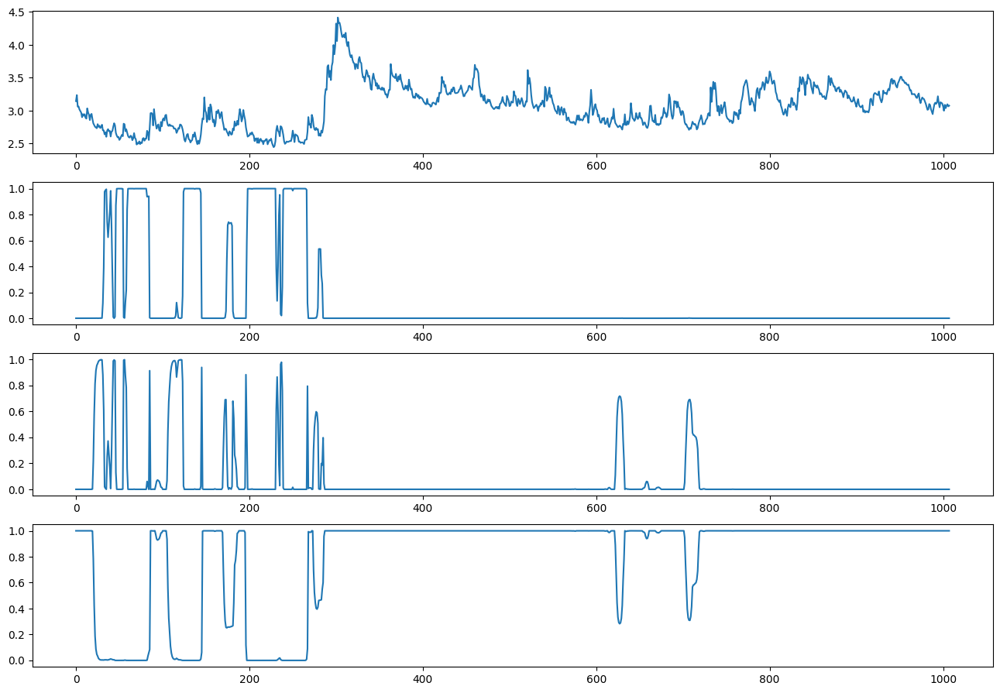


ite=24, max(diff) = 391.60369529403147

mu_hat0 = [2.5822 2.7463 3.1598], 
sigma_hat0 = [0.0616 0.0375 0.2817], 
P_hat0 = 
[[0.9362 0.0615 0.0023]
 [0.1288 0.7831 0.0882]
 [0.     0.0078 0.9922]], 
pi_hat0 = [0. 0. 1.]



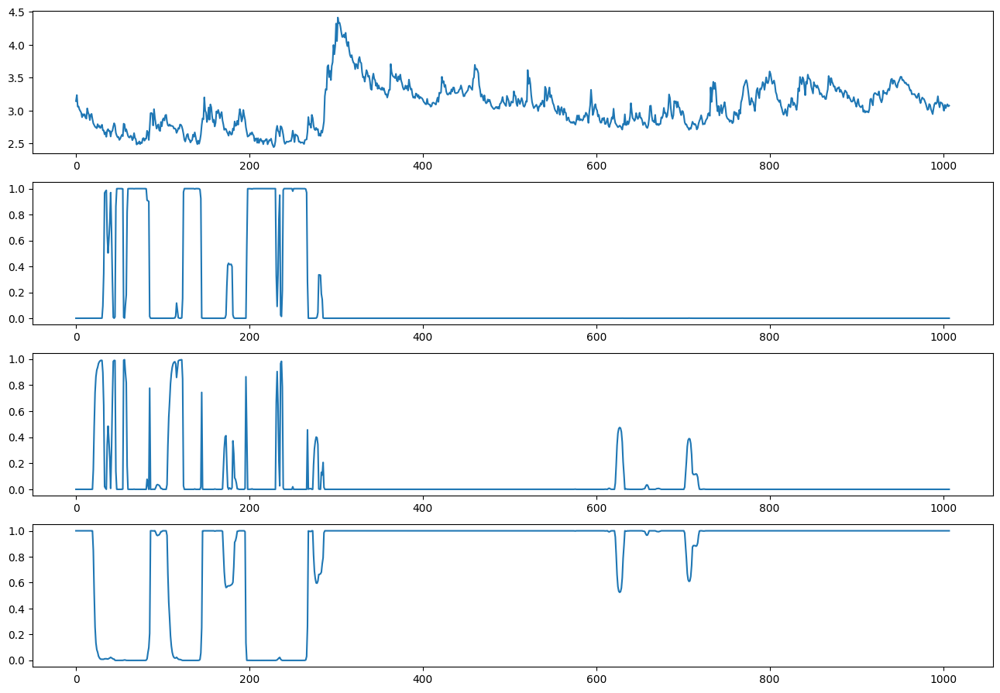


ite=25, max(diff) = 531.9760526543851

mu_hat0 = [2.5797 2.744  3.1519], 
sigma_hat0 = [0.0606 0.0372 0.285 ], 
P_hat0 = 
[[0.9371 0.0552 0.0078]
 [0.1475 0.7798 0.0726]
 [0.     0.0063 0.9937]], 
pi_hat0 = [0. 0. 1.]



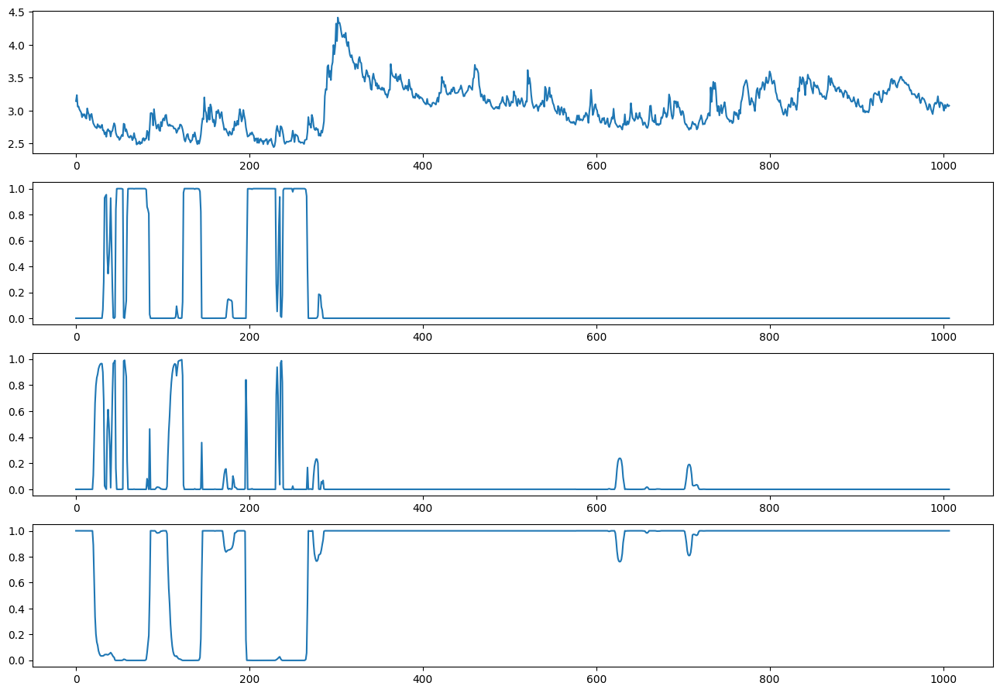


ite=26, max(diff) = 815.0648083452239

mu_hat0 = [2.5769 2.7421 3.1456], 
sigma_hat0 = [0.0592 0.0378 0.2877], 
P_hat0 = 
[[0.9376 0.0461 0.0163]
 [0.164  0.7937 0.0423]
 [0.     0.005  0.995 ]], 
pi_hat0 = [0. 0. 1.]



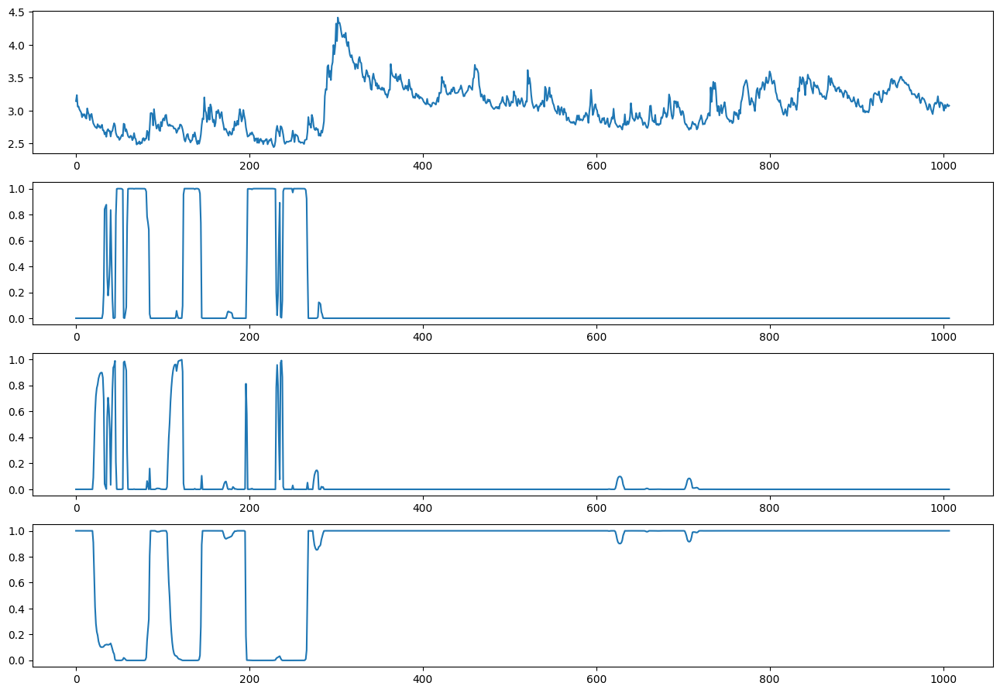


ite=27, max(diff) = 638.2582575616602

mu_hat0 = [2.5743 2.7398 3.142 ], 
sigma_hat0 = [0.0576 0.0391 0.2892], 
P_hat0 = 
[[0.9375 0.0397 0.0228]
 [0.1721 0.8104 0.0175]
 [0.     0.0043 0.9957]], 
pi_hat0 = [0. 0. 1.]



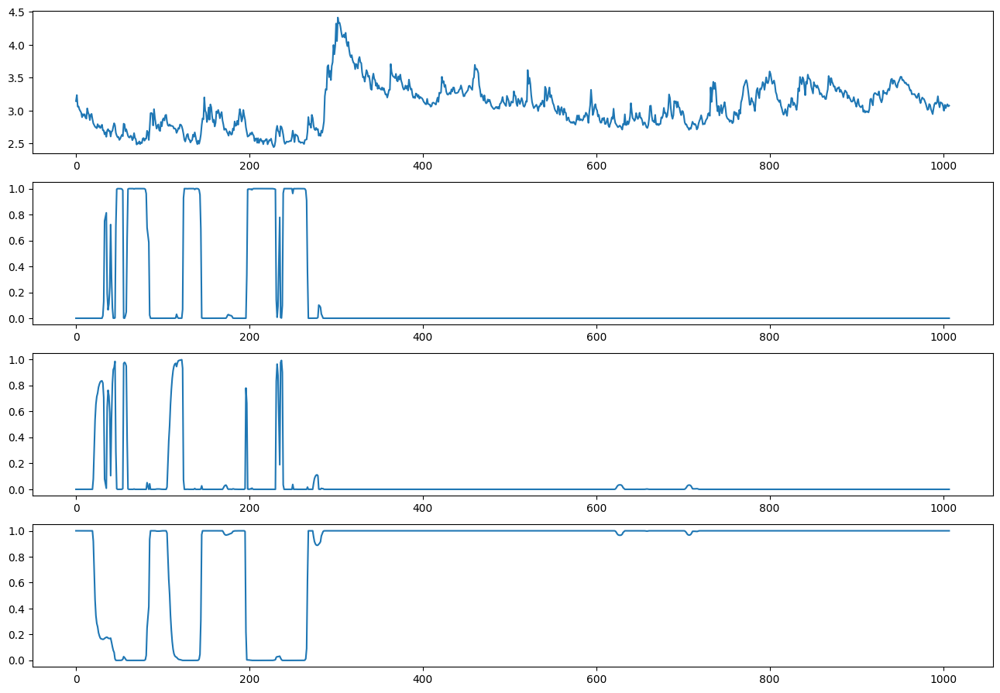


ite=28, max(diff) = 348.2427816685664

mu_hat0 = [2.5722 2.737  3.1402], 
sigma_hat0 = [0.0561 0.0409 0.2899], 
P_hat0 = 
[[0.9379 0.0365 0.0256]
 [0.1695 0.8244 0.0061]
 [0.     0.004  0.996 ]], 
pi_hat0 = [0. 0. 1.]



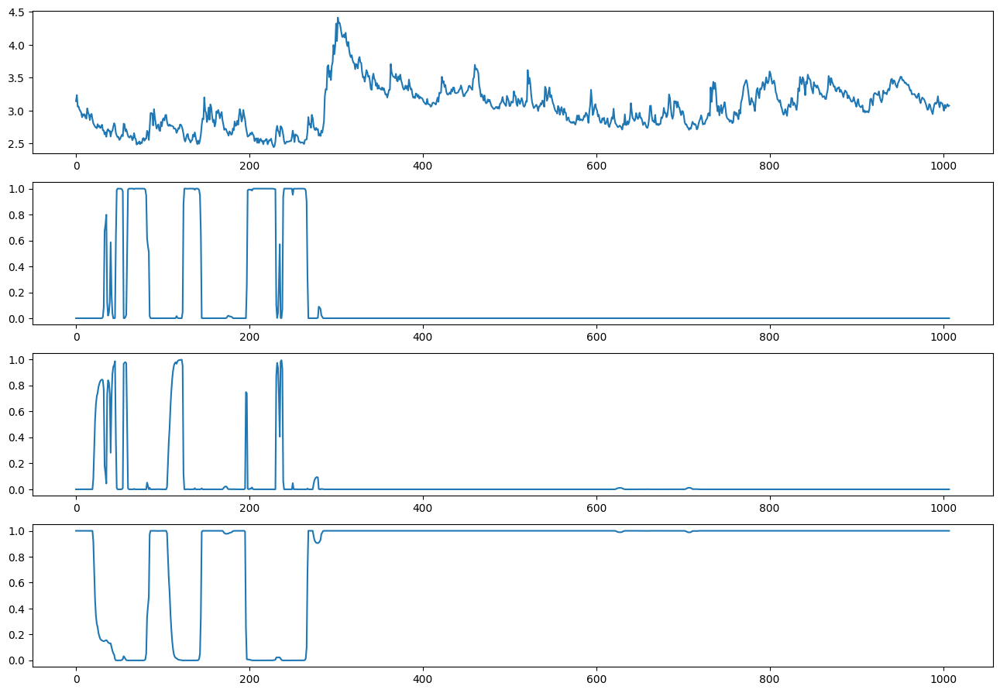


ite=29, max(diff) = 397.0238827606766

mu_hat0 = [2.5705 2.7337 3.1399], 
sigma_hat0 = [0.0549 0.0433 0.29  ], 
P_hat0 = 
[[0.9394 0.0341 0.0265]
 [0.1563 0.8417 0.002 ]
 [0.     0.0039 0.9961]], 
pi_hat0 = [0. 0. 1.]



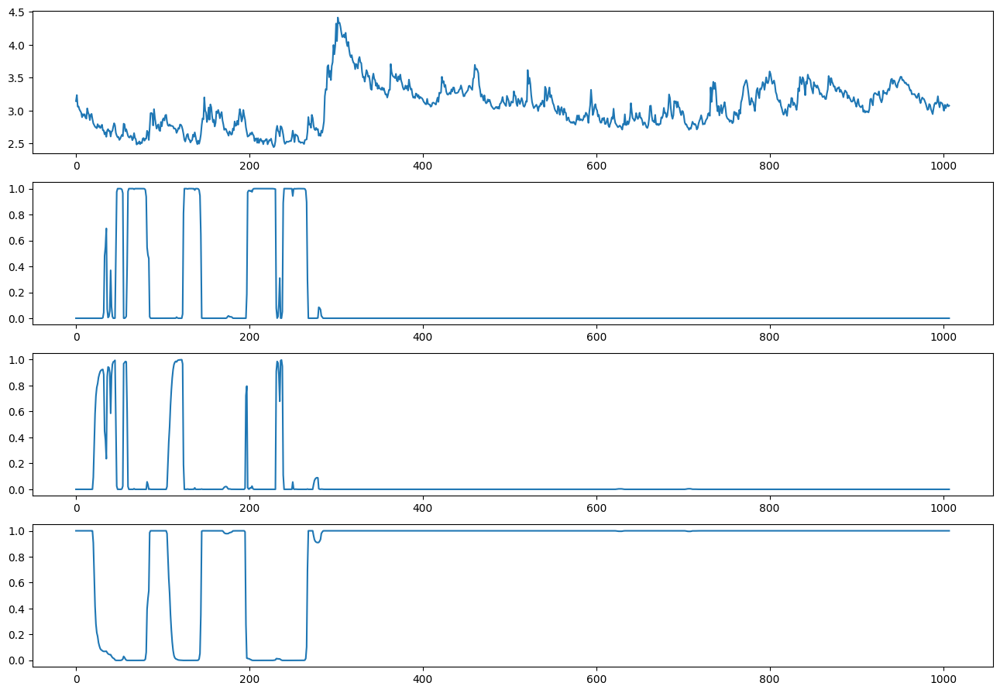


ite=30, max(diff) = 558.8845507332337

mu_hat0 = [2.5688 2.7295 3.1406], 
sigma_hat0 = [0.054  0.0465 0.2897], 
P_hat0 = 
[[9.428e-01 3.020e-02 2.700e-02]
 [1.338e-01 8.656e-01 6.000e-04]
 [0.000e+00 3.800e-03 9.962e-01]], 
pi_hat0 = [0. 0. 1.]



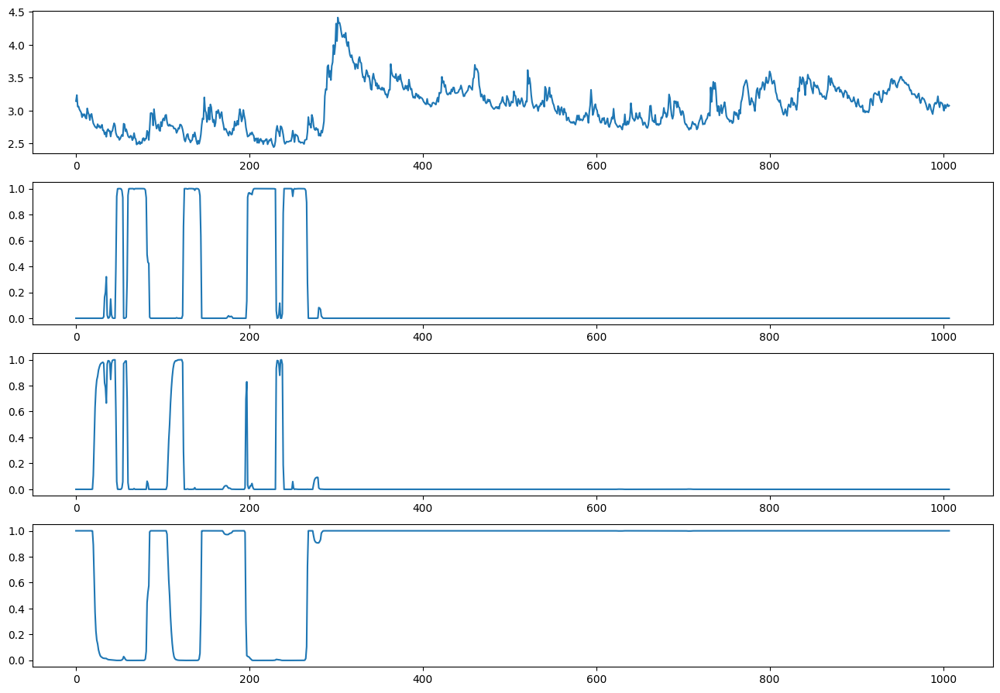


ite=31, max(diff) = 597.1427596061646

mu_hat0 = [2.567  2.7253 3.1411], 
sigma_hat0 = [0.0531 0.0496 0.2896], 
P_hat0 = 
[[9.481e-01 2.420e-02 2.770e-02]
 [1.102e-01 8.895e-01 2.000e-04]
 [0.000e+00 3.800e-03 9.962e-01]], 
pi_hat0 = [0. 0. 1.]



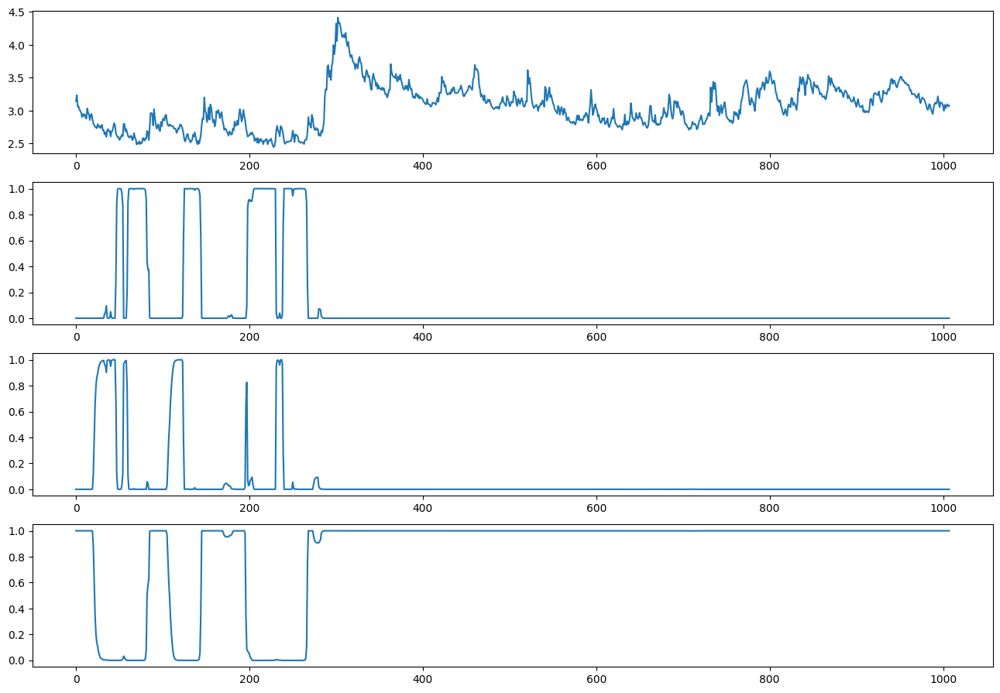


ite=32, max(diff) = 290.768276615287

mu_hat0 = [2.5657 2.7227 3.1411], 
sigma_hat0 = [0.0525 0.0513 0.2896], 
P_hat0 = 
[[9.507e-01 2.100e-02 2.830e-02]
 [9.900e-02 9.008e-01 1.000e-04]
 [0.000e+00 3.800e-03 9.962e-01]], 
pi_hat0 = [0. 0. 1.]



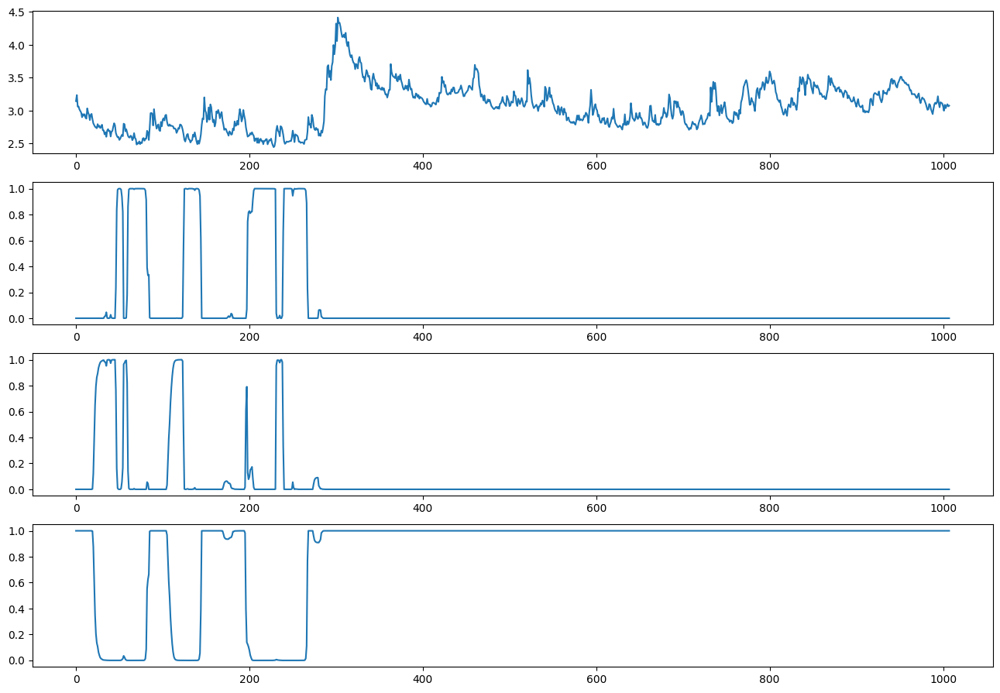


ite=33, max(diff) = 77.35895093166133

mu_hat0 = [2.5649 2.7211 3.141 ], 
sigma_hat0 = [0.0521 0.0523 0.2897], 
P_hat0 = 
[[9.507e-01 2.050e-02 2.880e-02]
 [9.570e-02 9.041e-01 2.000e-04]
 [0.000e+00 3.800e-03 9.962e-01]], 
pi_hat0 = [0. 0. 1.]



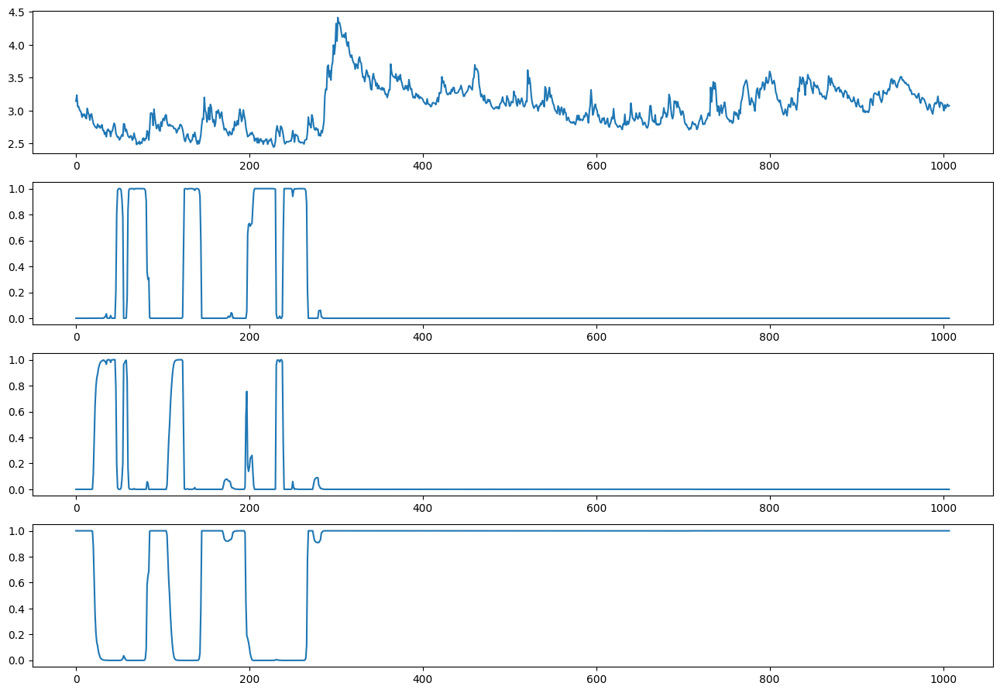


ite=34, max(diff) = 36.97094950649858

mu_hat0 = [2.5642 2.7197 3.1408], 
sigma_hat0 = [0.0518 0.0529 0.2898], 
P_hat0 = 
[[9.502e-01 2.060e-02 2.920e-02]
 [9.450e-02 9.053e-01 3.000e-04]
 [0.000e+00 3.800e-03 9.962e-01]], 
pi_hat0 = [0. 0. 1.]



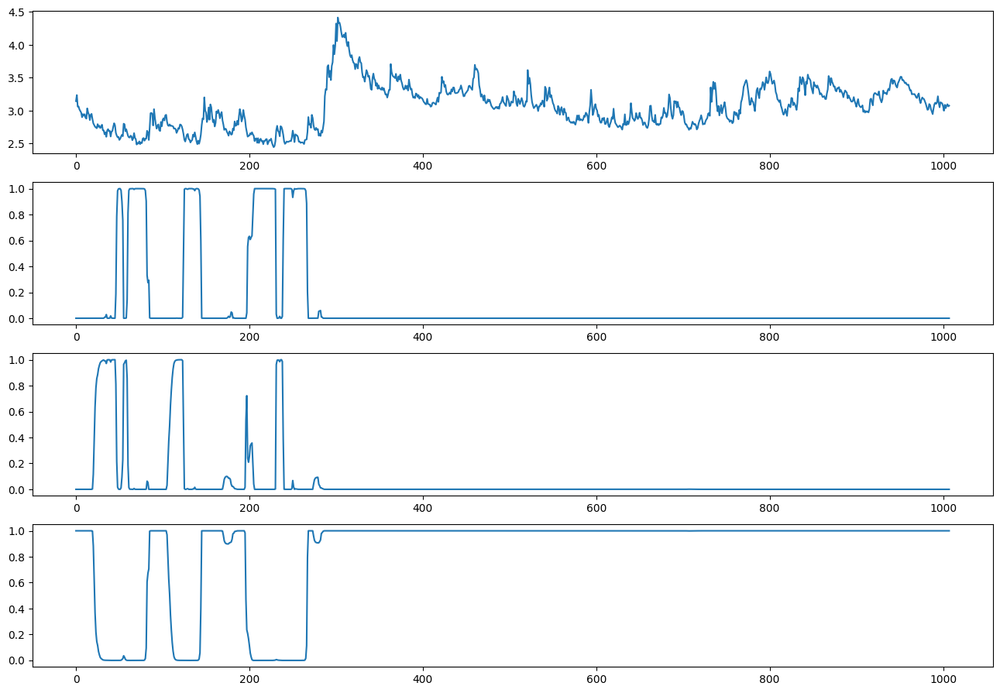


ite=35, max(diff) = 36.2541867443867

mu_hat0 = [2.5635 2.7183 3.1408], 
sigma_hat0 = [0.0515 0.0535 0.2898], 
P_hat0 = 
[[9.495e-01 2.090e-02 2.950e-02]
 [9.330e-02 9.061e-01 6.000e-04]
 [0.000e+00 3.900e-03 9.961e-01]], 
pi_hat0 = [0. 0. 1.]



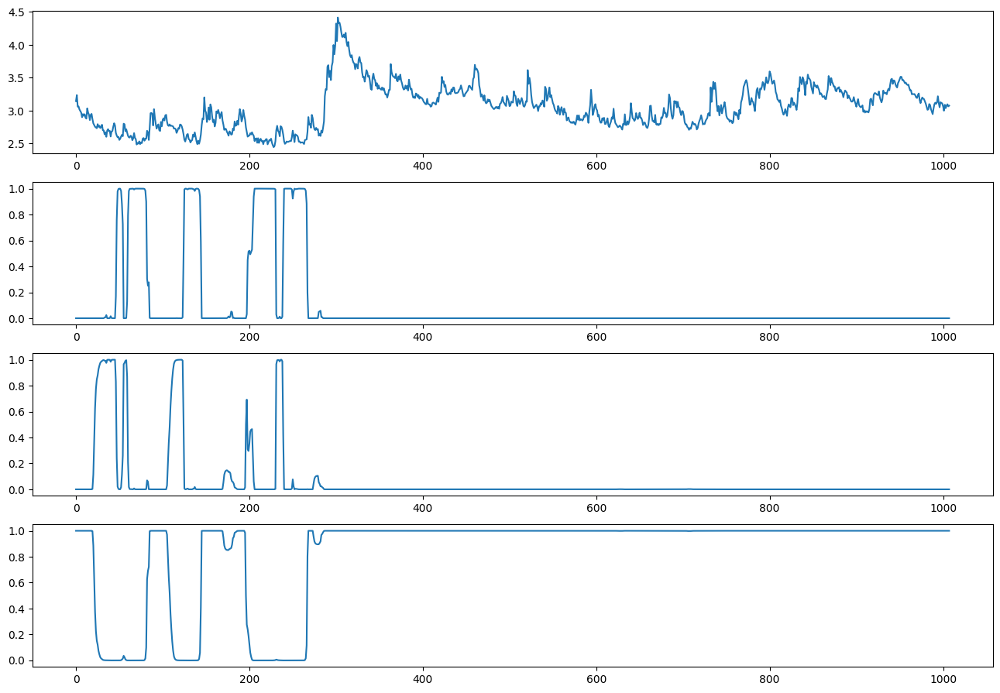


ite=36, max(diff) = 52.40165608686544

mu_hat0 = [2.5627 2.7167 3.141 ], 
sigma_hat0 = [0.0511 0.0541 0.2897], 
P_hat0 = 
[[0.9488 0.0214 0.0298]
 [0.0915 0.9069 0.0016]
 [0.     0.0039 0.9961]], 
pi_hat0 = [0. 0. 1.]



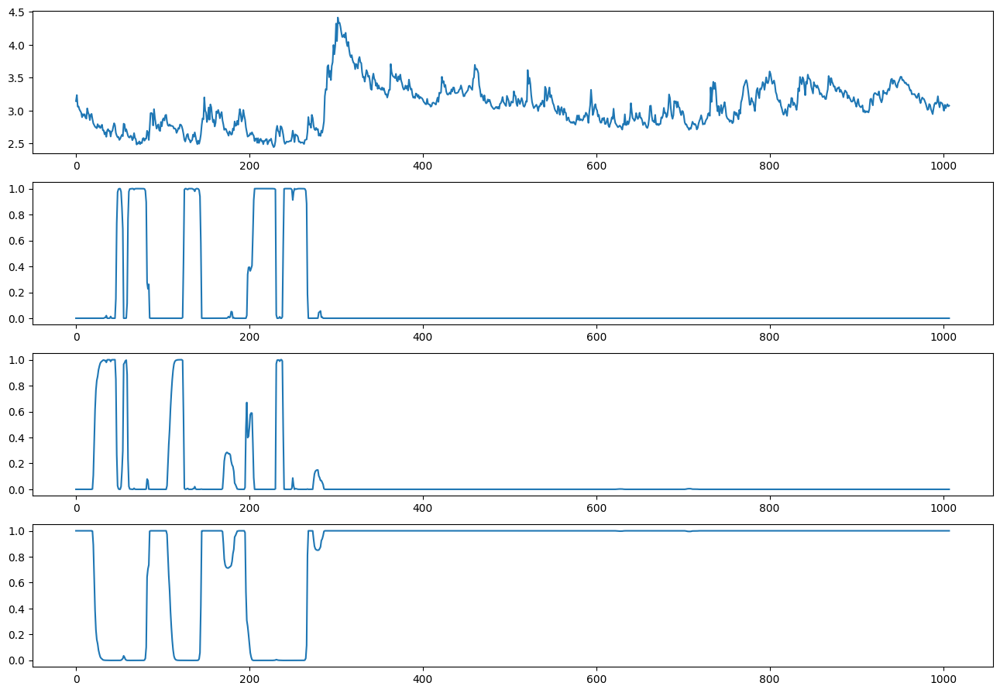


ite=37, max(diff) = 104.18700355839887

mu_hat0 = [2.5619 2.7142 3.142 ], 
sigma_hat0 = [0.0507 0.0548 0.2892], 
P_hat0 = 
[[0.948  0.0219 0.0301]
 [0.0873 0.908  0.0047]
 [0.     0.0042 0.9958]], 
pi_hat0 = [0. 0. 1.]



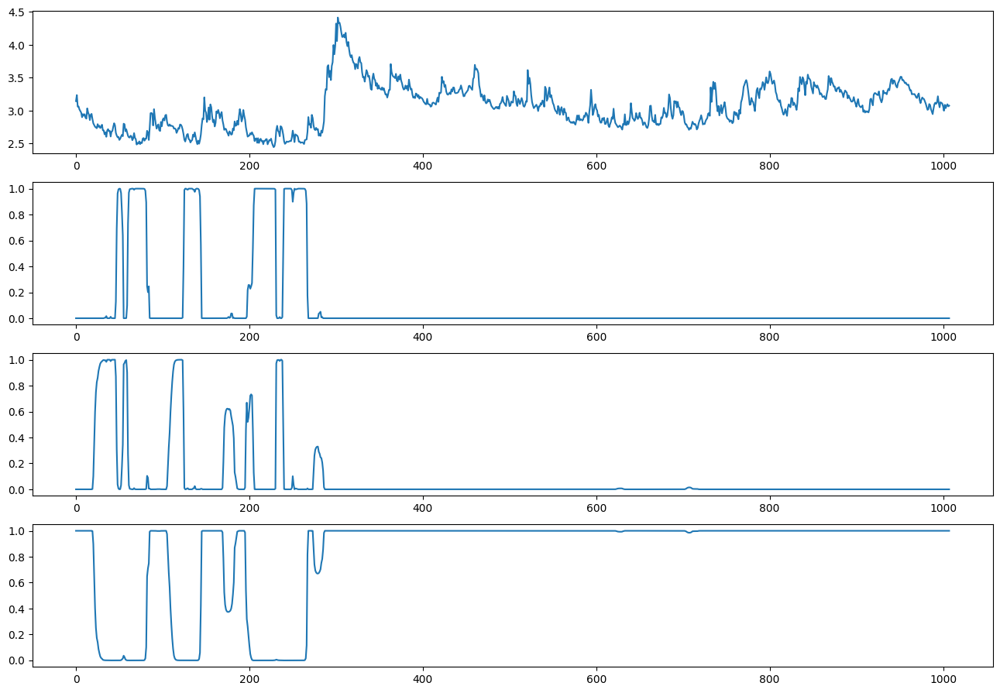


ite=38, max(diff) = 215.39365978202494

mu_hat0 = [2.5608 2.7103 3.1452], 
sigma_hat0 = [0.0502 0.0552 0.2877], 
P_hat0 = 
[[0.9475 0.0227 0.0299]
 [0.078  0.9091 0.0129]
 [0.     0.0049 0.9951]], 
pi_hat0 = [0. 0. 1.]



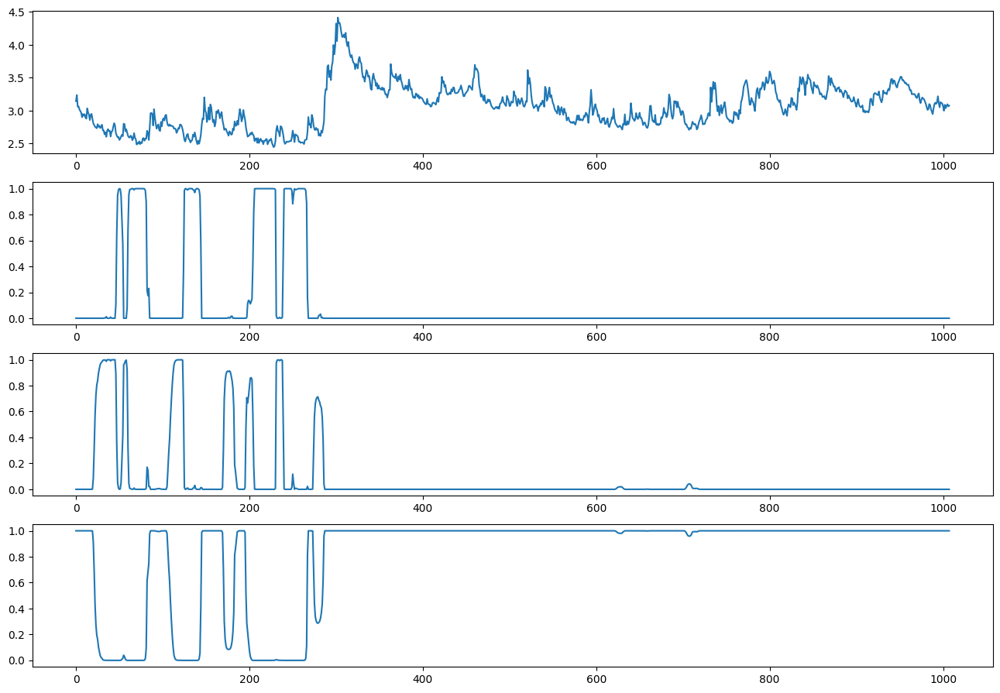


ite=39, max(diff) = 242.13259633136158

mu_hat0 = [2.5597 2.7065 3.1495], 
sigma_hat0 = [0.0496 0.0552 0.2855], 
P_hat0 = 
[[0.9472 0.024  0.0288]
 [0.0682 0.9092 0.0226]
 [0.     0.0058 0.9942]], 
pi_hat0 = [0. 0. 1.]



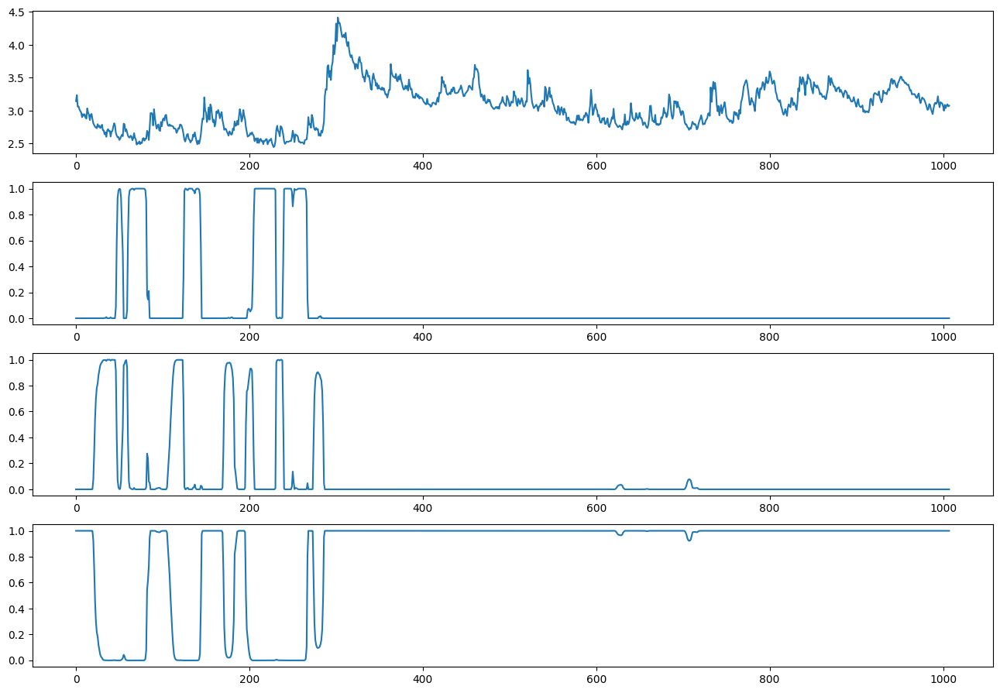


ite=40, max(diff) = 144.43405887671565

mu_hat0 = [2.5588 2.7044 3.1514], 
sigma_hat0 = [0.0492 0.0553 0.2845], 
P_hat0 = 
[[0.9469 0.0258 0.0273]
 [0.0644 0.9081 0.0276]
 [0.     0.0062 0.9938]], 
pi_hat0 = [0. 0. 1.]



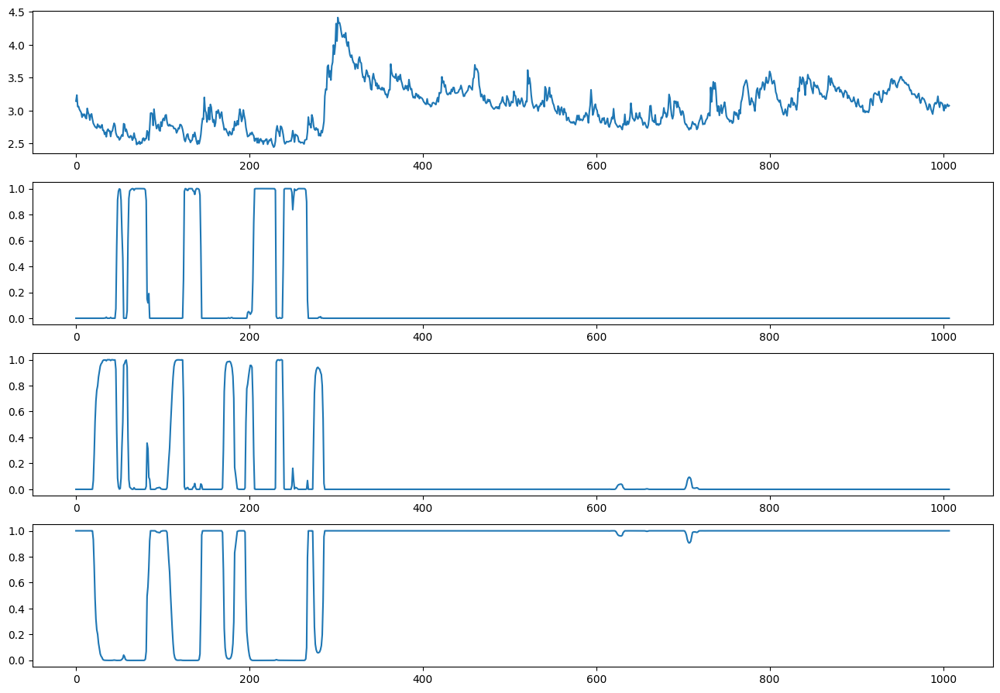


ite=41, max(diff) = 77.05153867012093

mu_hat0 = [2.5583 2.7034 3.1518], 
sigma_hat0 = [0.0489 0.0554 0.2843], 
P_hat0 = 
[[0.9463 0.0275 0.0262]
 [0.0637 0.9067 0.0296]
 [0.     0.0063 0.9937]], 
pi_hat0 = [0. 0. 1.]



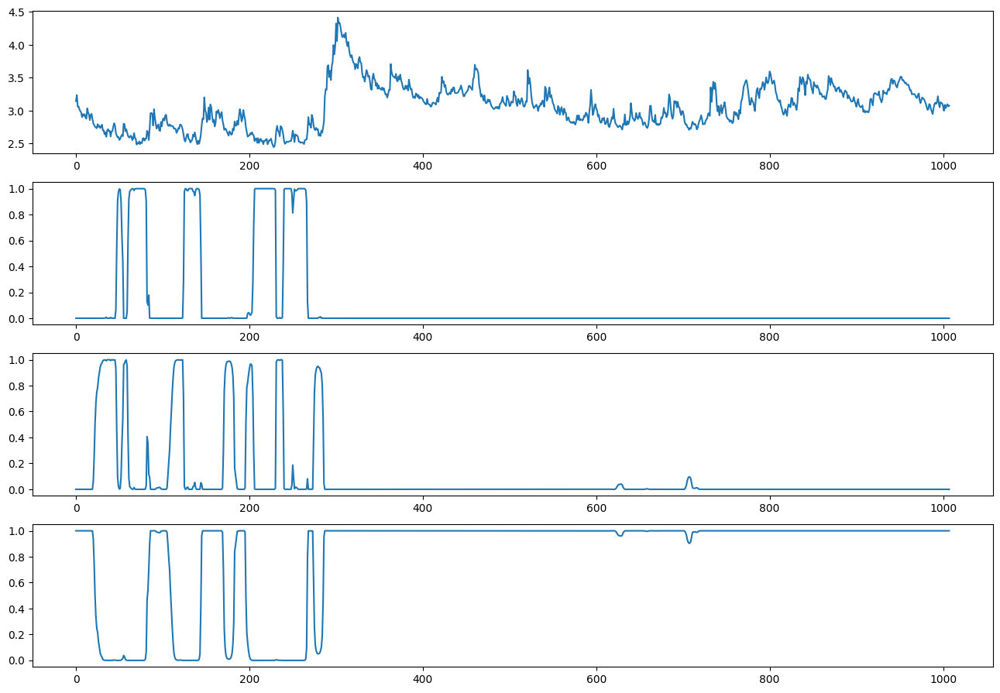


ite=42, max(diff) = 47.7508893427869

mu_hat0 = [2.558  2.7028 3.1518], 
sigma_hat0 = [0.0487 0.0555 0.2842], 
P_hat0 = 
[[0.9457 0.0288 0.0255]
 [0.0638 0.9057 0.0305]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



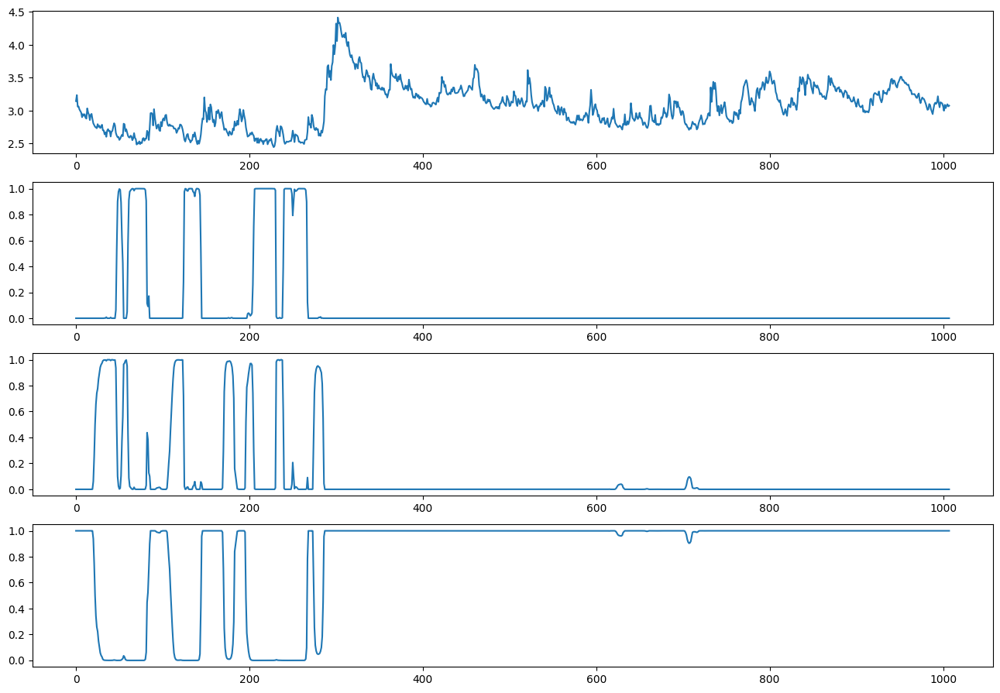


ite=43, max(diff) = 33.509804448420404

mu_hat0 = [2.5578 2.7025 3.1518], 
sigma_hat0 = [0.0485 0.0555 0.2842], 
P_hat0 = 
[[0.9452 0.0298 0.0251]
 [0.064  0.9049 0.0311]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



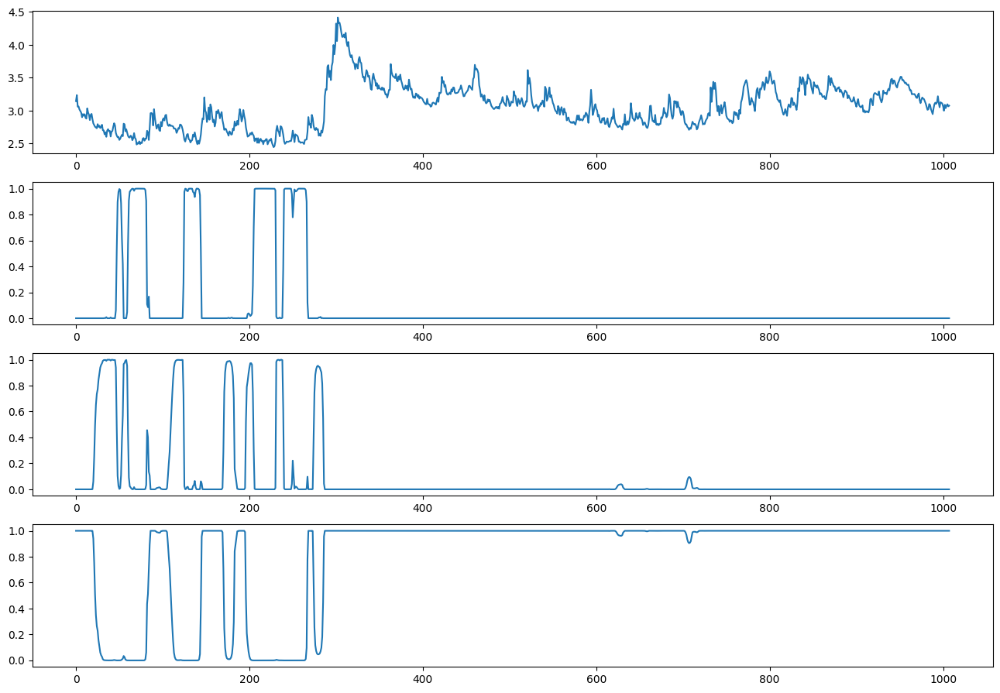


ite=44, max(diff) = 23.256852629995343

mu_hat0 = [2.5577 2.7022 3.1518], 
sigma_hat0 = [0.0485 0.0556 0.2842], 
P_hat0 = 
[[0.9448 0.0304 0.0248]
 [0.0643 0.9044 0.0314]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



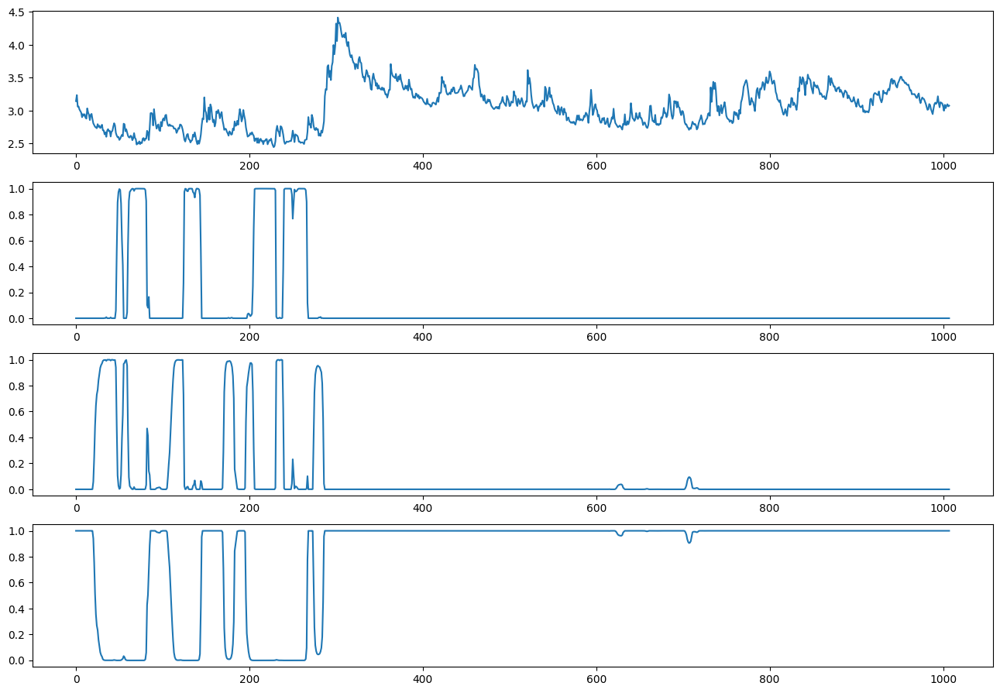


ite=45, max(diff) = 16.114099182183963

mu_hat0 = [2.5576 2.7021 3.1518], 
sigma_hat0 = [0.0484 0.0556 0.2842], 
P_hat0 = 
[[0.9446 0.0308 0.0246]
 [0.0644 0.904  0.0316]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



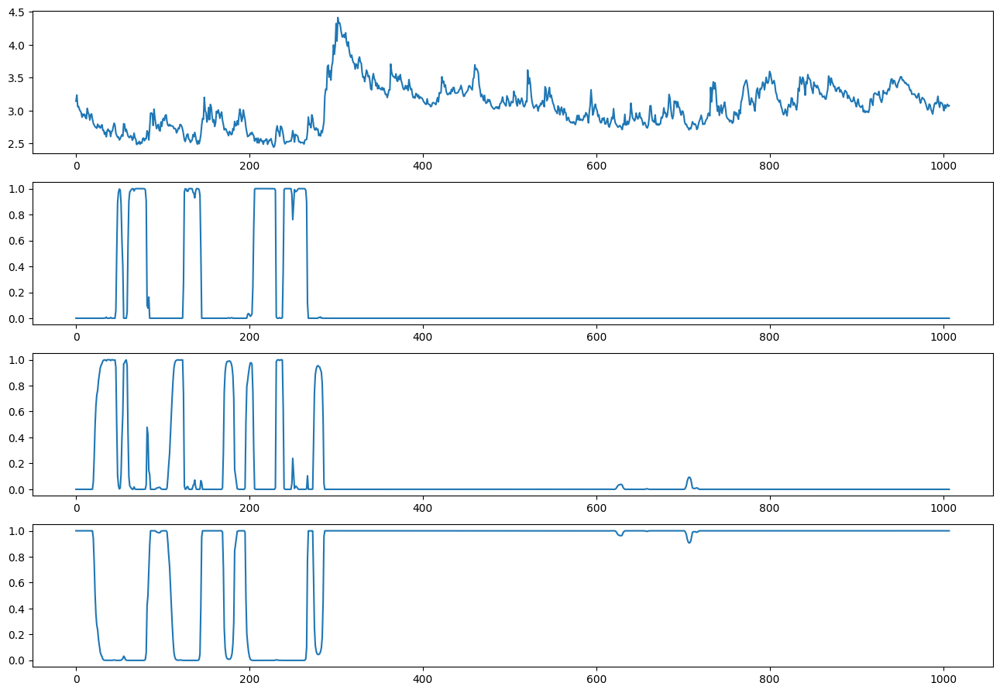


ite=46, max(diff) = 11.201030218921572

mu_hat0 = [2.5575 2.702  3.1518], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.9444 0.0311 0.0245]
 [0.0645 0.9038 0.0317]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



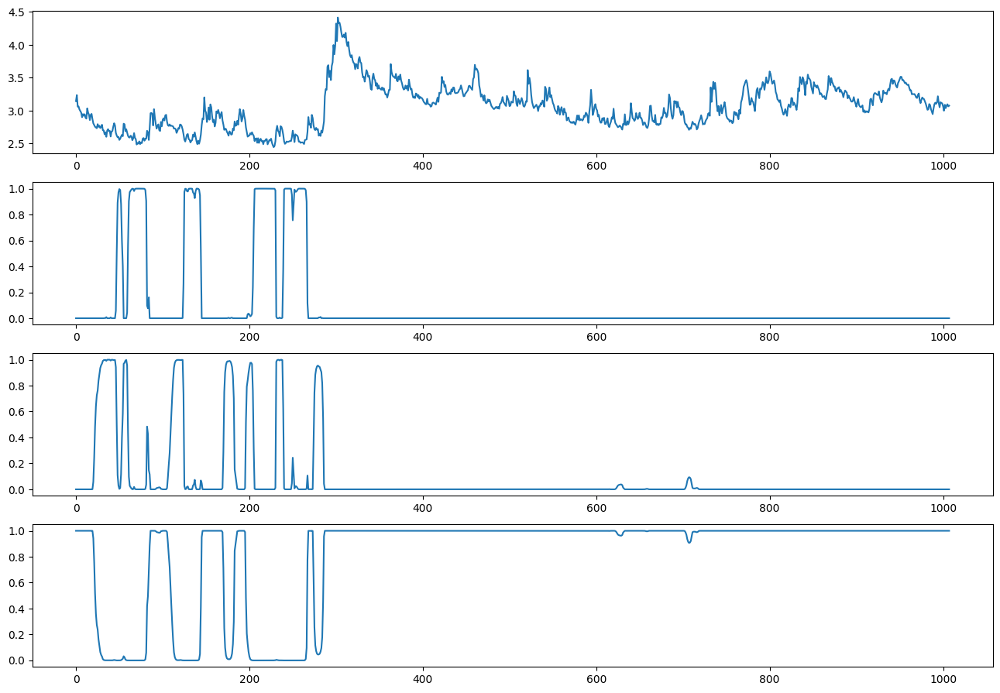


ite=47, max(diff) = 7.816630421717428

mu_hat0 = [2.5575 2.7019 3.1518], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.9443 0.0314 0.0244]
 [0.0646 0.9036 0.0318]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



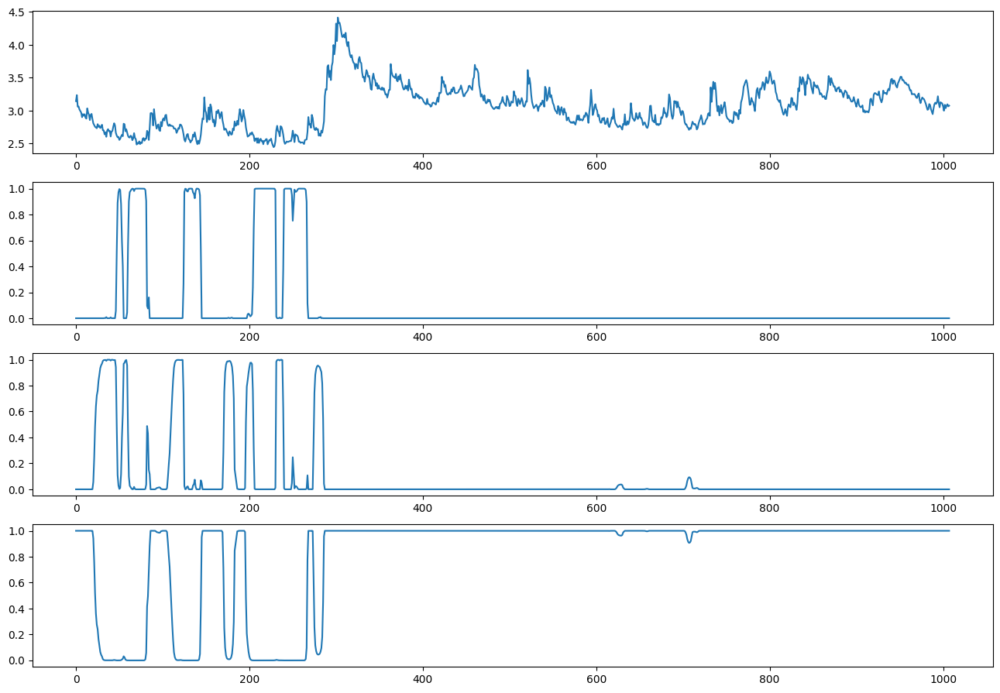


ite=48, max(diff) = 5.473084233724029

mu_hat0 = [2.5574 2.7018 3.1518], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.9442 0.0315 0.0243]
 [0.0647 0.9035 0.0319]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



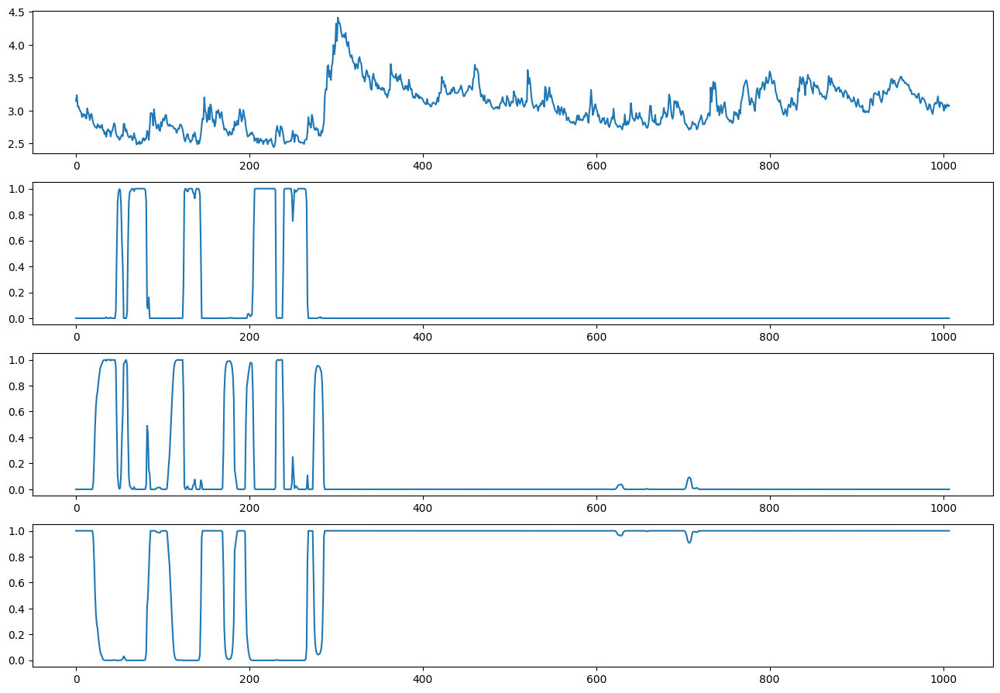


ite=49, max(diff) = 3.8418760664118543

mu_hat0 = [2.5574 2.7018 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.9441 0.0316 0.0243]
 [0.0647 0.9034 0.0319]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



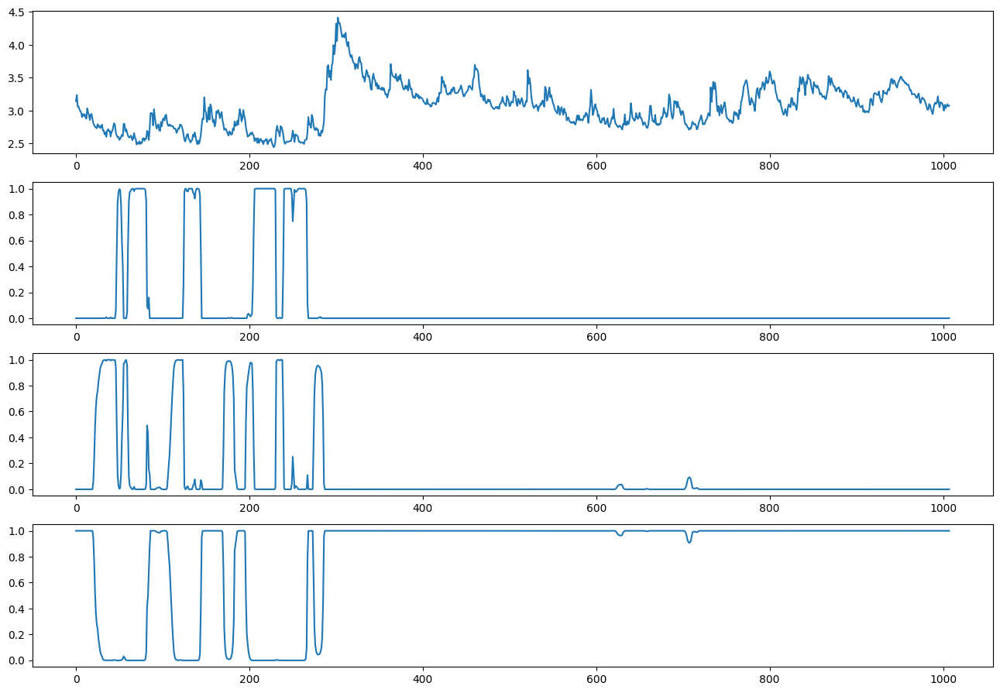


ite=50, max(diff) = 2.701746514479821

mu_hat0 = [2.5574 2.7018 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.9441 0.0317 0.0242]
 [0.0647 0.9033 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



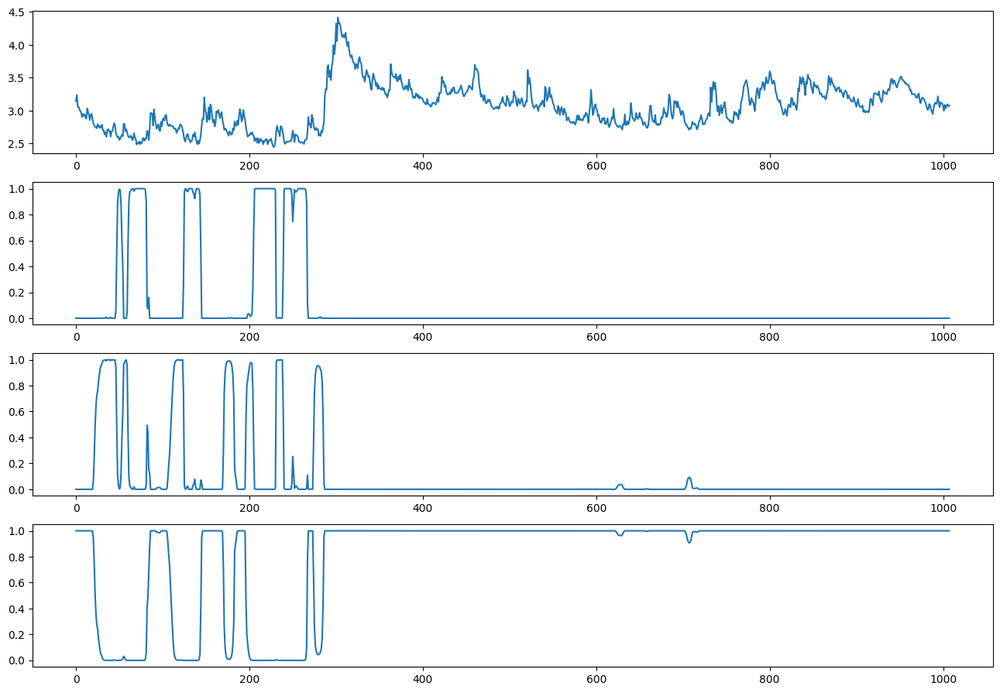


ite=51, max(diff) = 1.9023823502966641

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0317 0.0242]
 [0.0648 0.9033 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



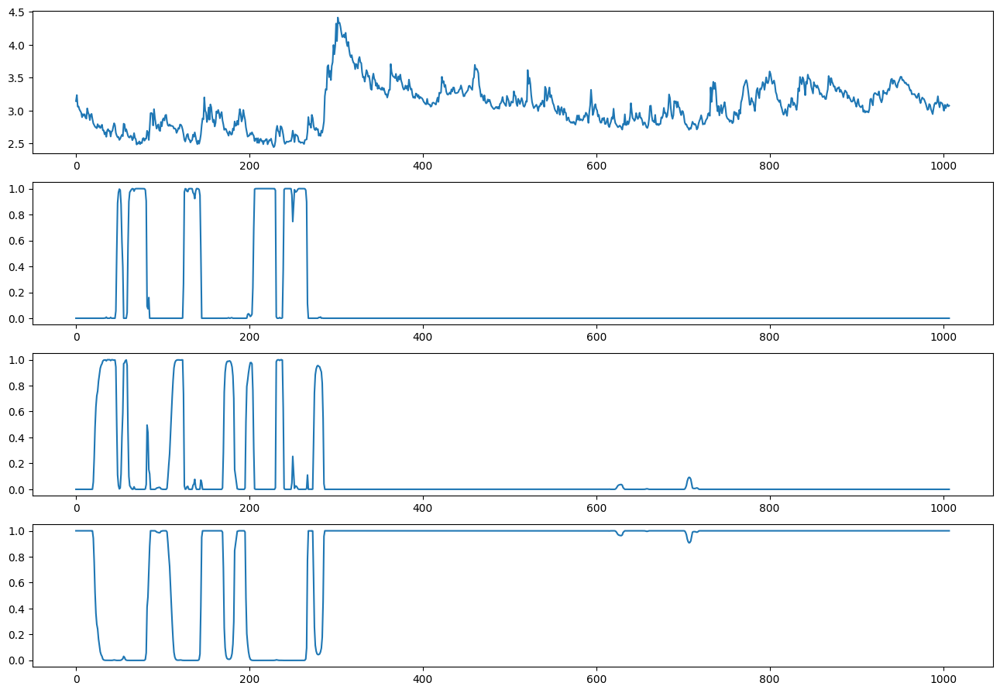


ite=52, max(diff) = 1.3406930215433681

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0318 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



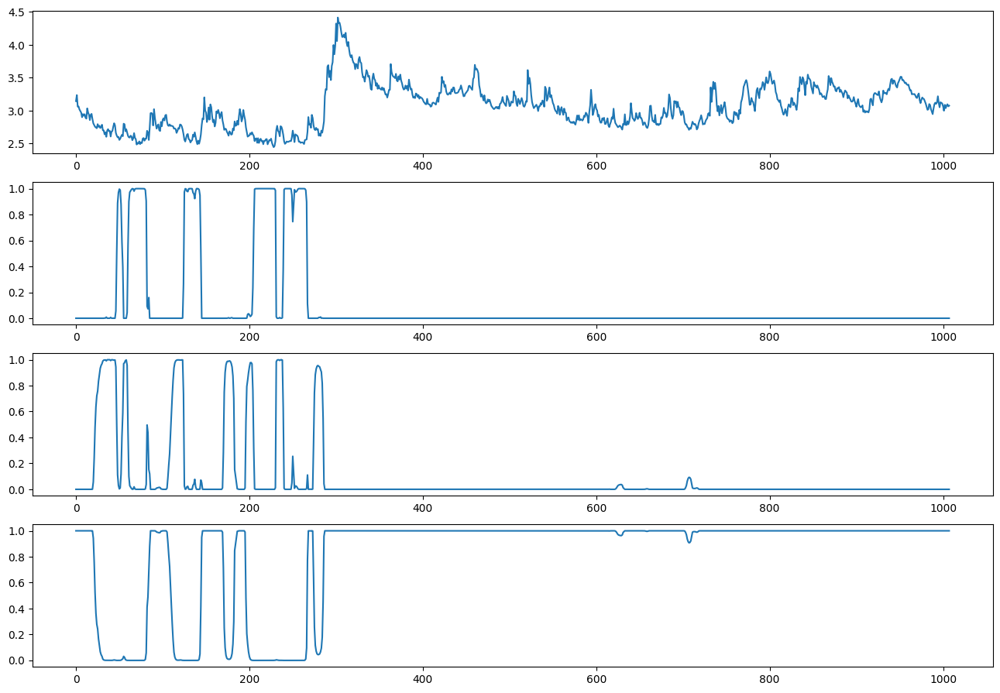


ite=53, max(diff) = 0.9454017516213018

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0318 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



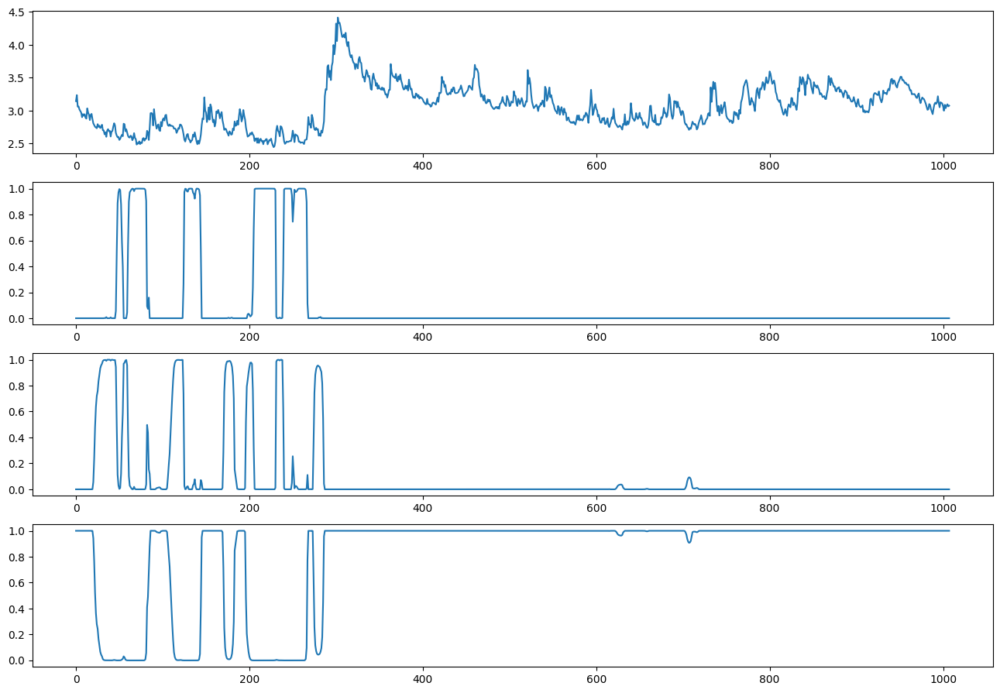


ite=54, max(diff) = 0.666920053642708

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0318 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



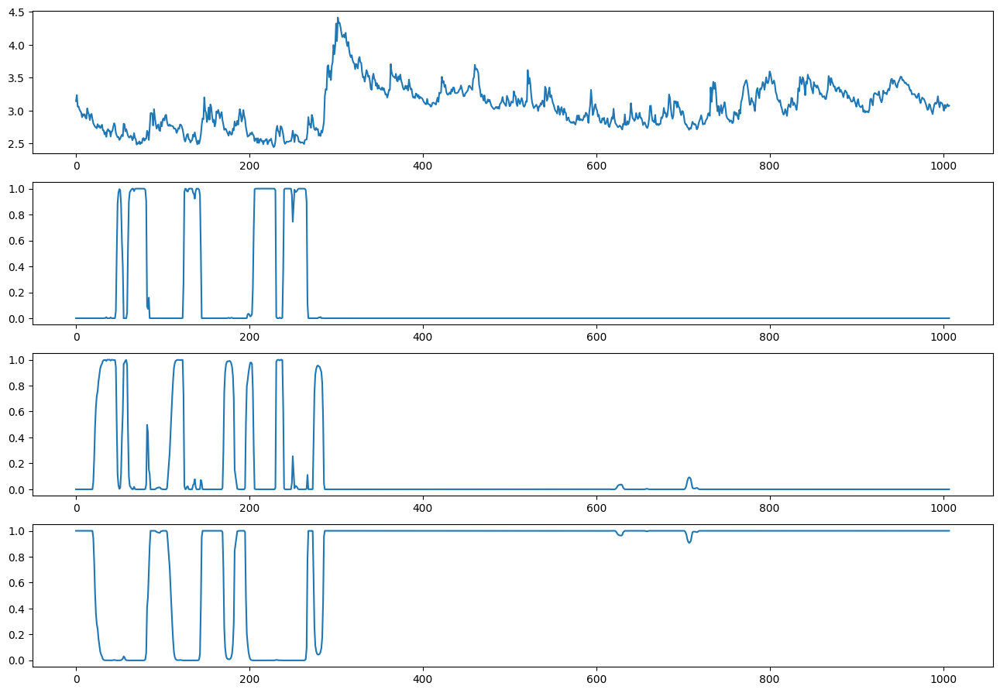


ite=55, max(diff) = 0.4705905808207334

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0318 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



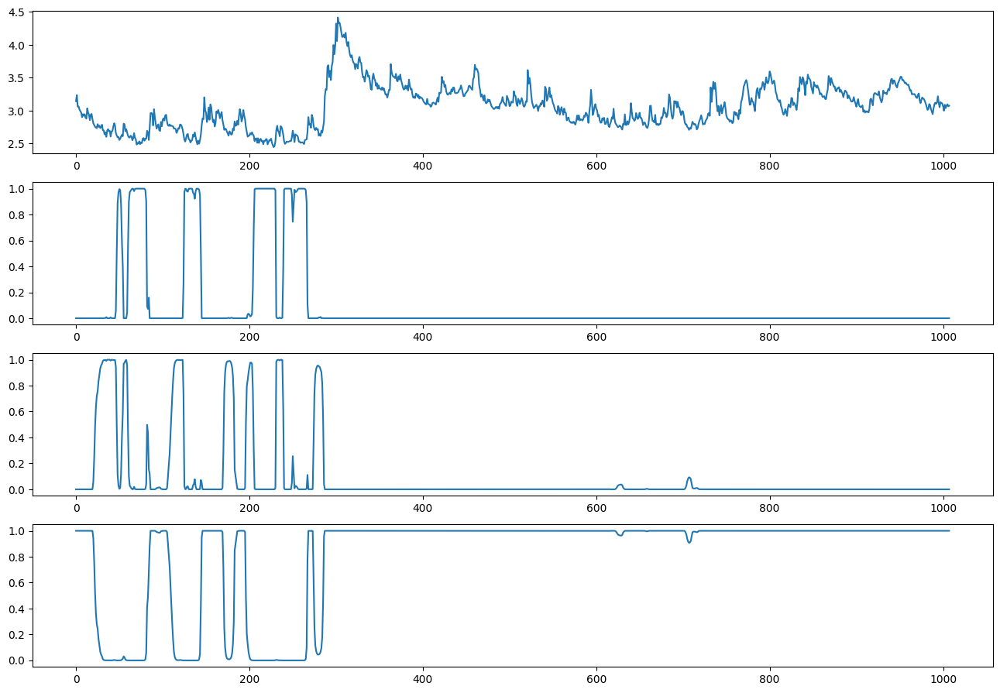


ite=56, max(diff) = 0.33211266186428806

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0318 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



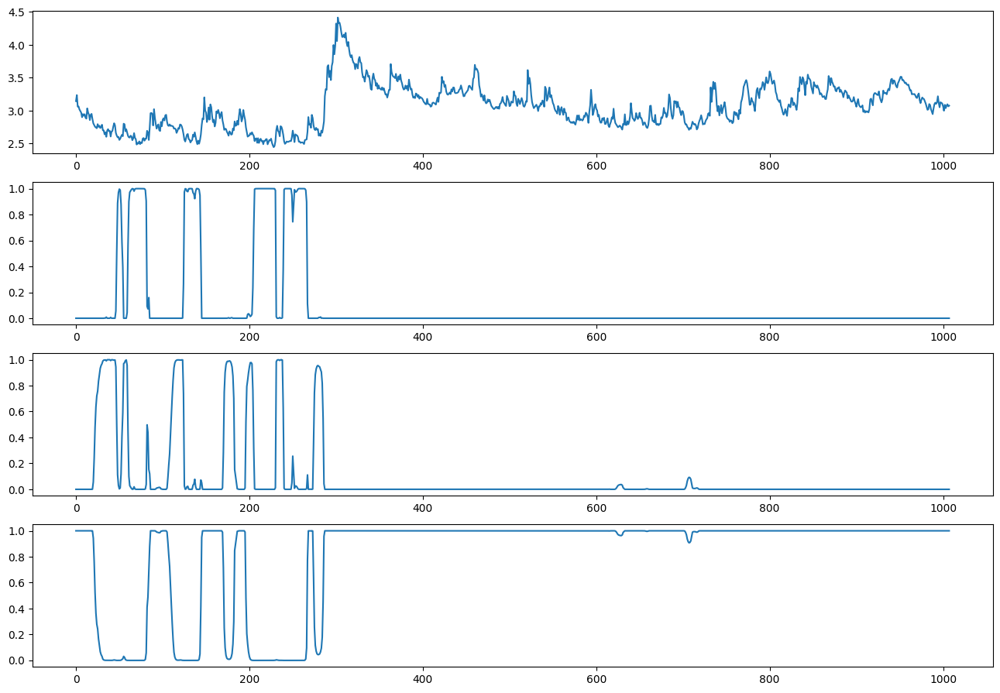


ite=57, max(diff) = 0.2344089153453674

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0318 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



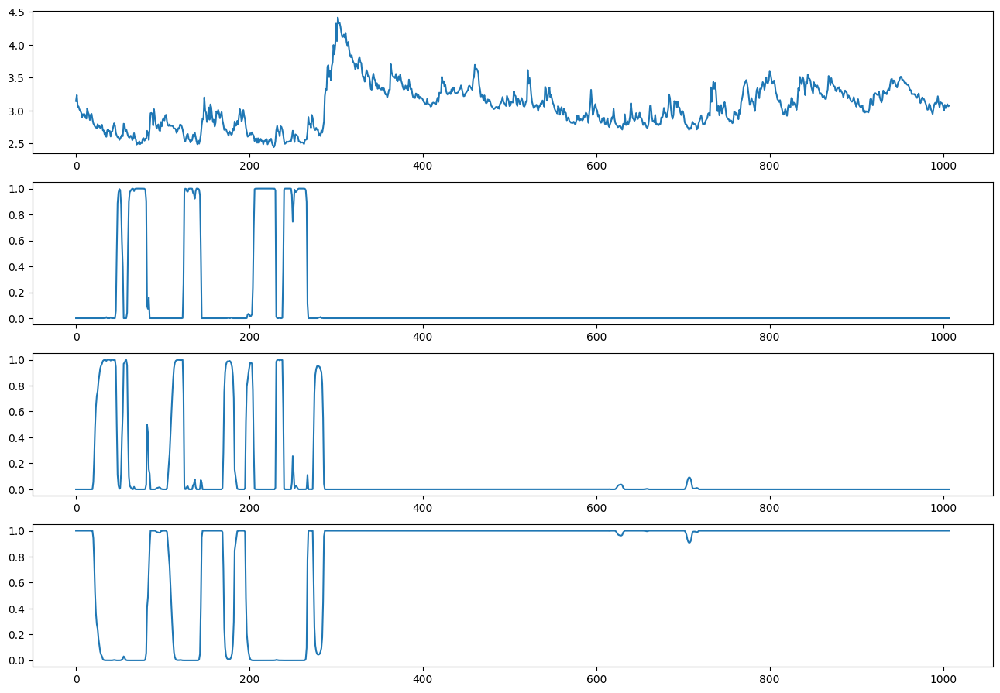


ite=58, max(diff) = 0.16545960033996499

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0318 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



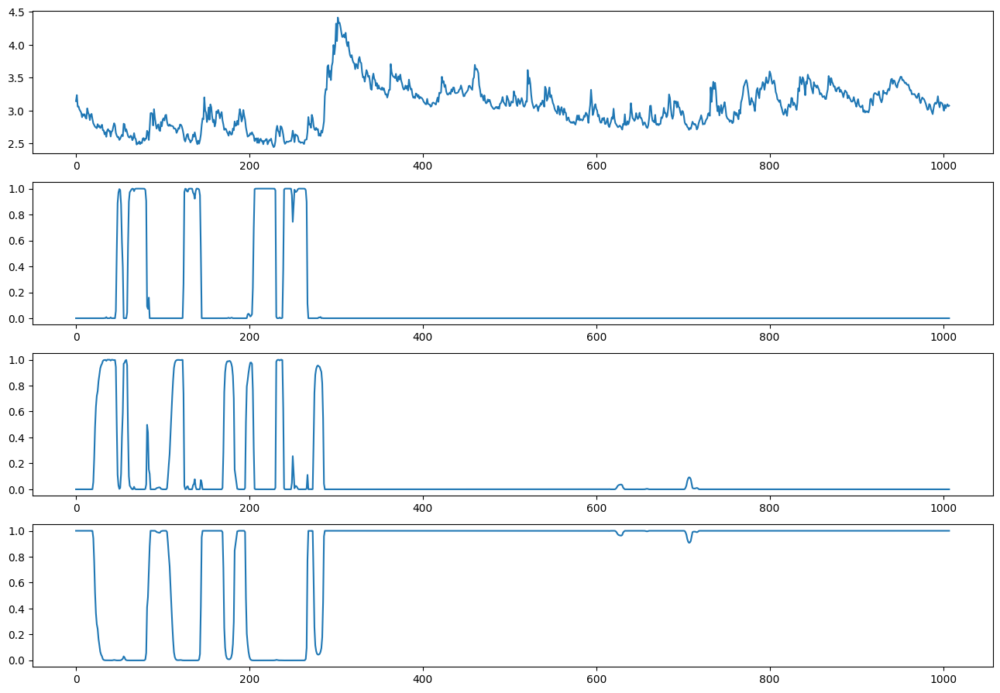


ite=59, max(diff) = 0.11679591876147602

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0318 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



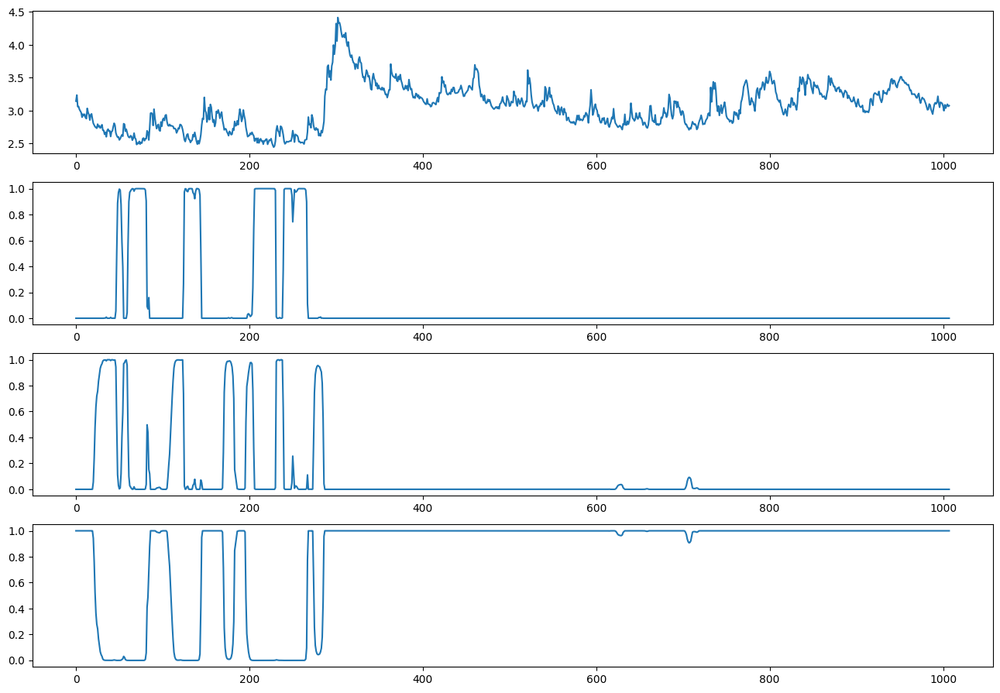


ite=60, max(diff) = 0.08244682687540313

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0318 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



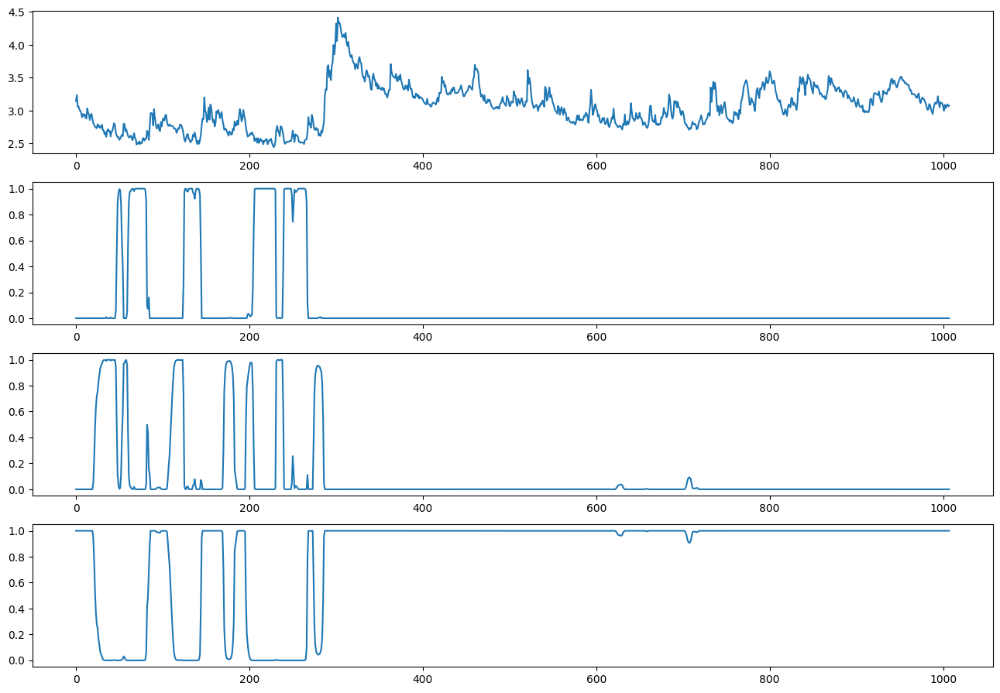


ite=61, max(diff) = 0.05820043205189557

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0319 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



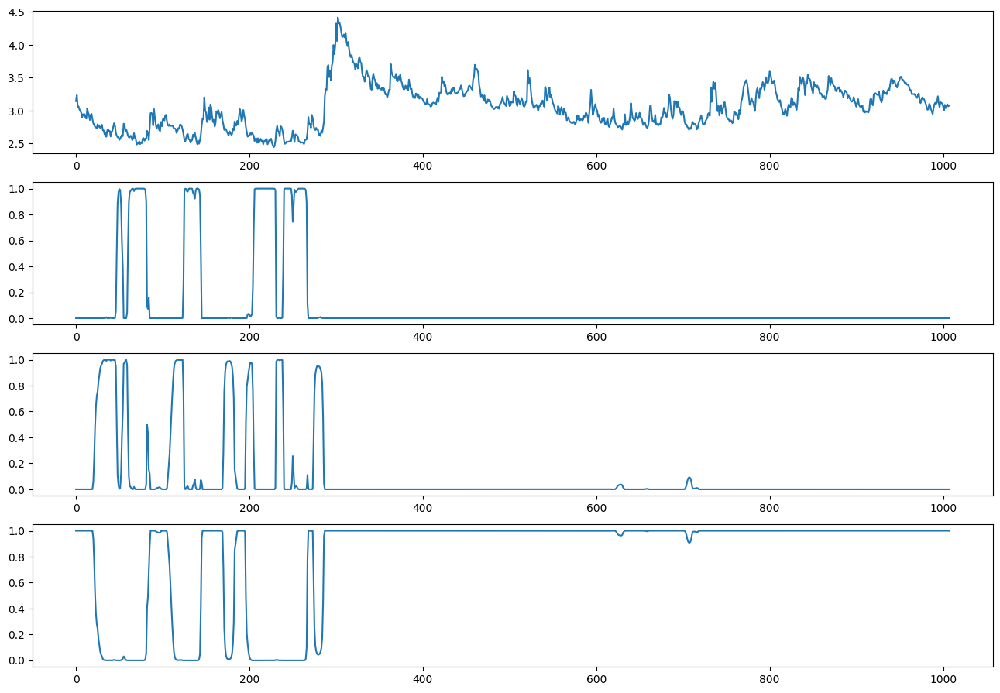


ite=62, max(diff) = 0.04108484071594504

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0319 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



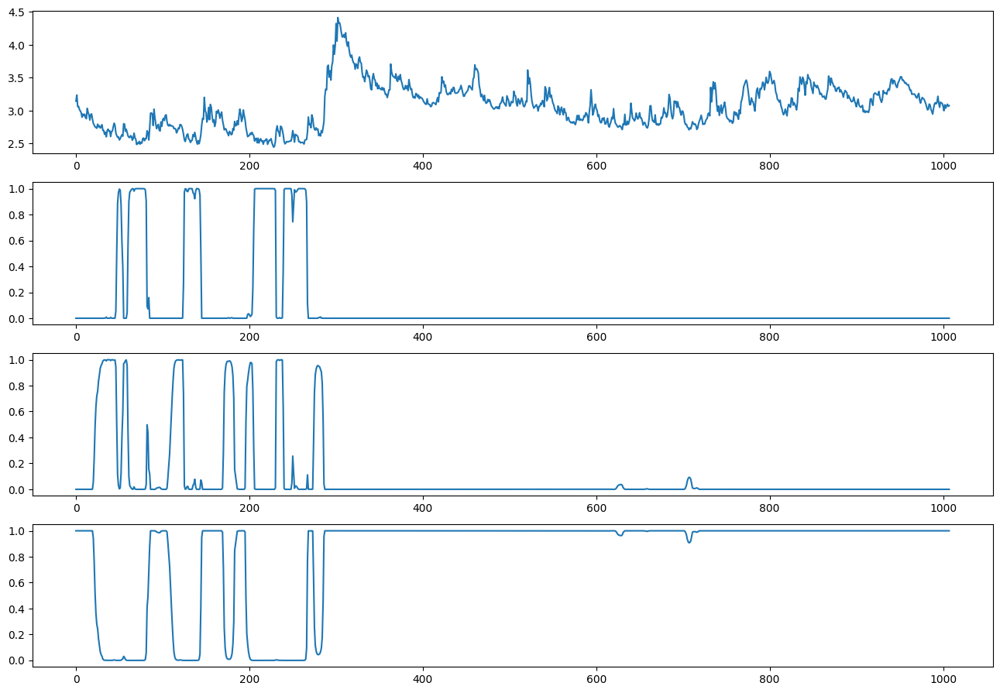


ite=63, max(diff) = 0.029002699646245647

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0319 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



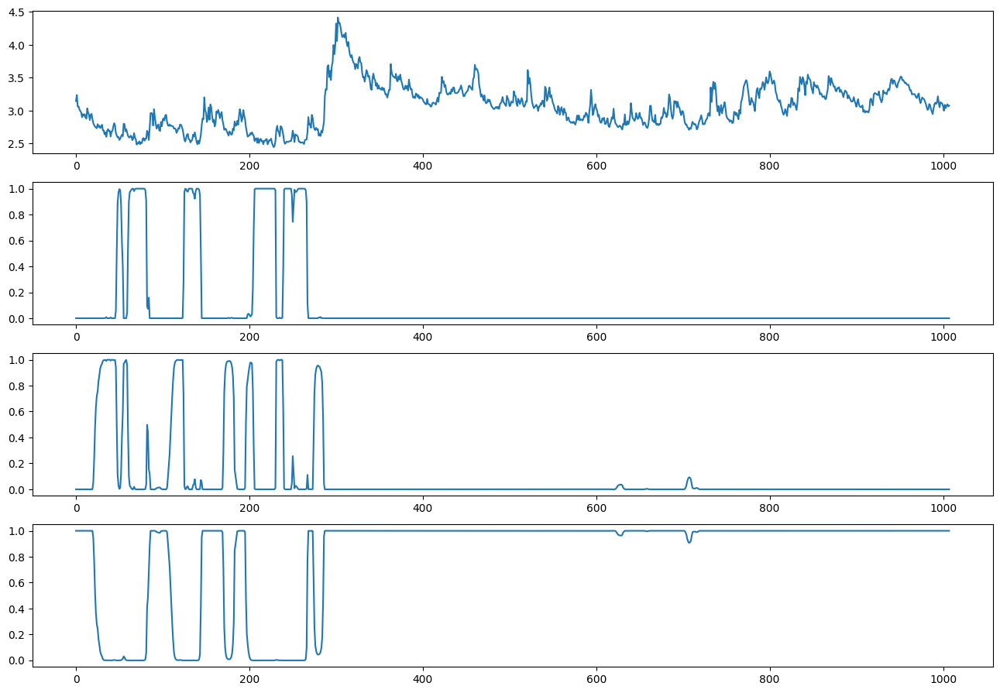


ite=64, max(diff) = 0.02047366835617251

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0319 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



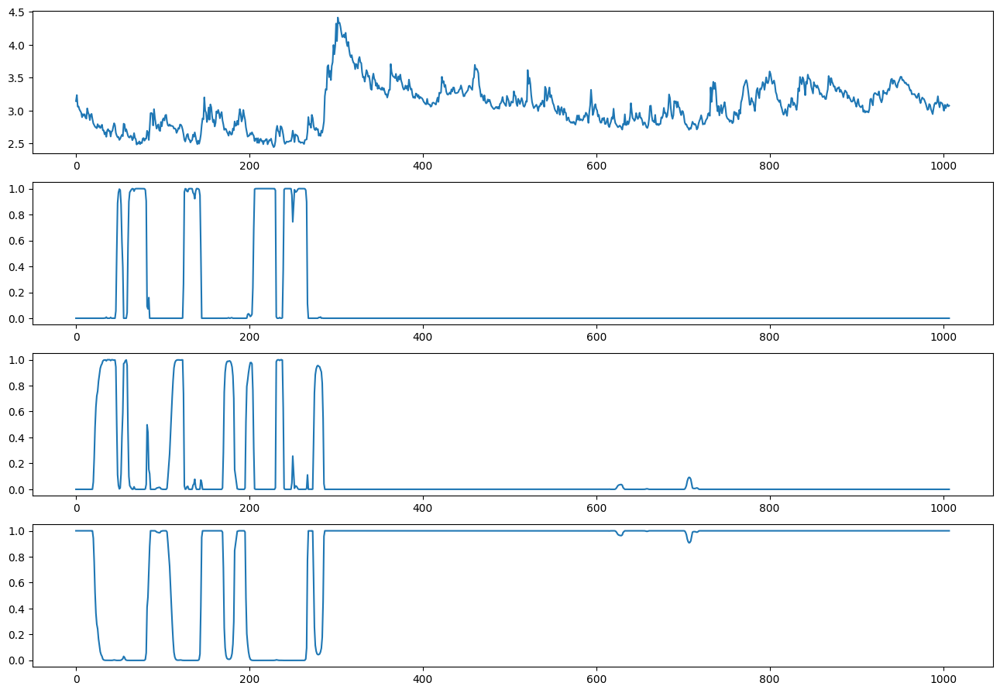


ite=65, max(diff) = 0.01445282614290569

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0319 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



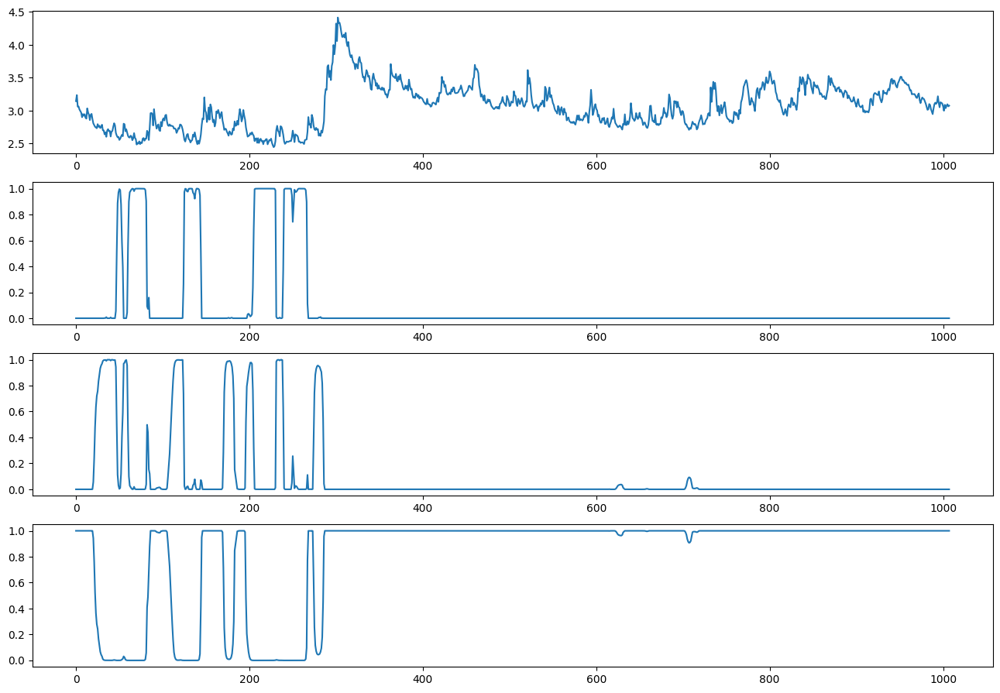


ite=66, max(diff) = 0.010202568001844298

mu_hat0 = [2.5574 2.7017 3.1517], 
sigma_hat0 = [0.0483 0.0556 0.2842], 
P_hat0 = 
[[0.944  0.0319 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat0 = [0. 0. 1.]



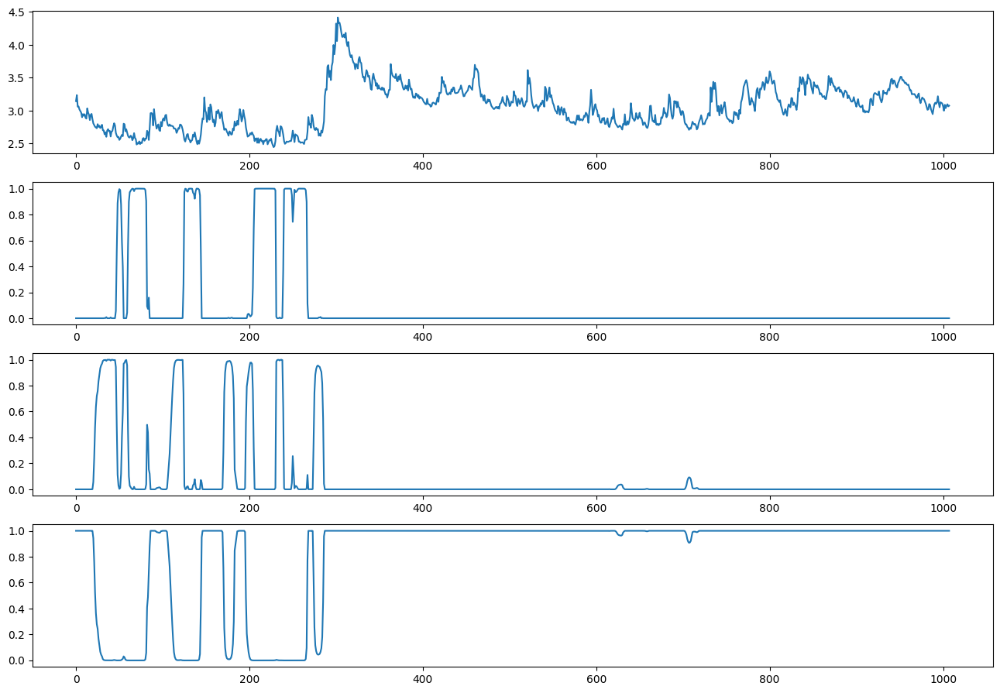


ite=67, max(diff) = 0.007202208945822006

mu_hat1 = [2.5574 2.7017 3.1517], 
sigma_hat1 = [0.0483 0.0556 0.2842], 
P_hat1 = 
[[0.944  0.0319 0.0242]
 [0.0648 0.9032 0.032 ]
 [0.     0.0064 0.9936]], 
pi_hat1 = [0. 0. 1.]


In [ ]:


# Initialize parameters
T = len(YData)
N = 3

# SET INITIAL GUESSES

mu_hat0 = [2.5, 3, 3.5] * np.ones((N))
sigma_hat0 = [0.3, 0.4, 0.5] * np.ones((N))
P_hat0 = np.zeros((N, N))

P_hat0[0, 0] = 0.85
P_hat0[0, 1] = (1 - P_hat0[0, 0])/2
P_hat0[0, 2] = (1 - P_hat0[0, 0])/2

P_hat0[1, 1] = 0.90
P_hat0[1, 0] = (1 - P_hat0[1, 1])/2
P_hat0[1, 2] = (1 - P_hat0[1, 1])/2

P_hat0[2, 2] = 0.70
P_hat0[2, 0] = (1 - P_hat0[2, 2])/2
P_hat0[2, 1] = (1 - P_hat0[2, 2])/2



pi_hat0 = [0.5, 0.25, 0.25] * np.ones((N))
for t in range(1, 100):
    pi_hat0 = np.dot(P_hat0.T, pi_hat0)

# Determine maximum number of iterations until convergence and convergence tolerance
itemax = 100
itetol = 1e-2

for ite in range(0, itemax):
    #print(mu_hat0, sigma_hat0, P_hat0, pi_hat0)
    print(f"\nmu_hat0 = {np.round(mu_hat0,4)}, \nsigma_hat0 = {np.round(sigma_hat0,4)}, \nP_hat0 = \n{np.round(P_hat0,4)}, \npi_hat0 = {np.round(pi_hat0,4)}")

    # E-step
    xi_prob_t, xi_prob_t1 = forward_alg(
        pi_hat0, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )
    xi_prob_T = backward_alg(
        xi_prob_t, xi_prob_t1, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )

    print("")

    plt.subplot(4, 1, 1)
    plt.plot(YData)
    plt.subplot(4, 1, 2)
    plt.plot(xi_prob_T[:, 0])
    plt.subplot(4, 1, 3)
    plt.plot(xi_prob_T[:, 1])
    plt.subplot(4, 1, 4)
    plt.plot(xi_prob_T[:, 2])
    fig = plt.gcf()
    fig.set_size_inches(16, 11)
    plt.show()
    print("")

    # Compute Pr(s_t+1 = j, s_t = i)
    P_hat_T = np.zeros((N, N, T))
    for tt in range(1, T):
        for ss in range(0, N):
            for ss2 in range(0, N):
                P_hat_T[ss, ss2, tt] = (
                    P_hat0[ss, ss2]
                    * xi_prob_t[tt - 1, ss]
                    * xi_prob_T[tt, ss2]
                    / xi_prob_t1[tt - 1, ss2]
                )
    # M-step
    mu_hat1, sigma_hat1, P_hat1, pi_hat1 = M_step_func(xi_prob_T, P_hat_T, N, T, YData)

    diff = np.zeros((4))
    diff[0] = np.sum(np.absolute(mu_hat1 - mu_hat0)) / (np.min(mu_hat0) + itetol * 1e-2)
    diff[1] = np.sum(np.absolute(sigma_hat1 - sigma_hat0)) / (
        np.min(sigma_hat0) + itetol * 1e-2
    )
    diff[2] = np.sum(np.absolute(np.subtract(P_hat1, P_hat0))) / (
        np.min(P_hat0) + itetol * 1e-2
    )
    diff[3] = np.sum(np.absolute(pi_hat1 - pi_hat0)) / (np.min(pi_hat0) + itetol * 1e-2)

    print(f"ite={ite}, max(diff) = {np.max(diff)}")

    if np.max(diff) > itetol:
        mu_hat0, sigma_hat0, P_hat0, pi_hat0 = mu_hat1, sigma_hat1, P_hat1, pi_hat1
    else:
        print(f"\nmu_hat1 = {np.round(mu_hat1,4)}, \nsigma_hat1 = {np.round(sigma_hat1,4)}, \nP_hat1 = \n{np.round(P_hat1,4)}, \npi_hat1 = {np.round(pi_hat1,4)}")
        break

### 3-state model with different mu and same sigma converged, this can be used to detect regime change as well.

## STEP 2.b.ii Same mu same sigma


mu_hat0 = [2. 2.], 
sigma_hat0 = [0.1 0.1], 
P_hat0 = 
[[0.85 0.15]
 [0.1  0.9 ]], 
pi_hat0 = [0.4 0.6]



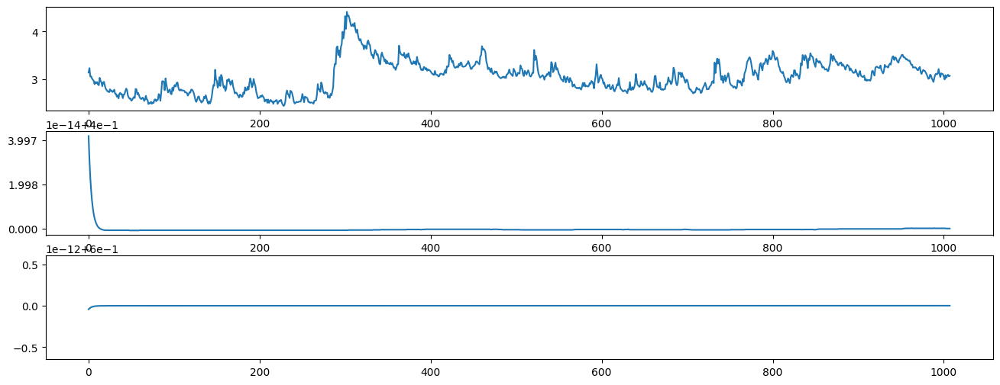


ite=0, max(diff) = 4.607380006428183

mu_hat0 = [3.0538 3.0538], 
sigma_hat0 = [0.3306 0.3306], 
P_hat0 = 
[[0.85 0.15]
 [0.1  0.9 ]], 
pi_hat0 = [0.4 0.6]



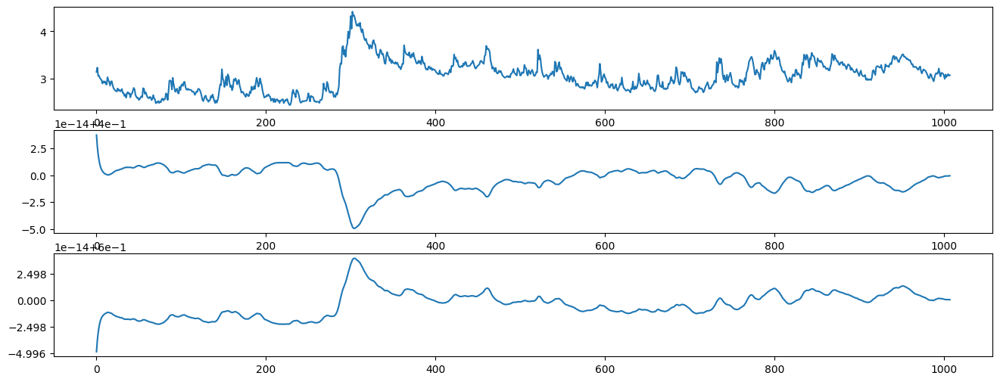


ite=1, max(diff) = 2.3447599495330152e-14

mu_hat1 = [3.0538 3.0538], 
sigma_hat1 = [0.3306 0.3306], 
P_hat1 = 
[[0.85 0.15]
 [0.1  0.9 ]], 
pi_hat1 = [0.4 0.6]


In [ ]:
#Assume same mu same sigma

# Initialize parameters
T = len(YData)
N = 2

# SET INITIAL GUESSES

mu_hat0 = [2, 2] * np.ones((N))
sigma_hat0 = [0.1, 0.1] * np.ones((N))
P_hat0 = np.zeros((N, N))

P_hat0[0, 0] = 0.85
P_hat0[0, 1] = 1 - P_hat0[0, 0]
P_hat0[1, 1] = 0.90
P_hat0[1, 0] = 1 - P_hat0[1, 1]

pi_hat0 = [0.5, 0.5] * np.ones((N))
for t in range(1, 100):
    pi_hat0 = np.dot(P_hat0.T, pi_hat0)

# Determine maximum number of iterations until convergence and convergence tolerance
itemax = 100
itetol = 1e-2

for ite in range(0, itemax):
    #print(mu_hat0, sigma_hat0, P_hat0, pi_hat0)
    print(f"\nmu_hat0 = {np.round(mu_hat0,4)}, \nsigma_hat0 = {np.round(sigma_hat0,4)}, \nP_hat0 = \n{np.round(P_hat0,4)}, \npi_hat0 = {np.round(pi_hat0,4)}")

    # E-step
    xi_prob_t, xi_prob_t1 = forward_alg(
        pi_hat0, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )
    xi_prob_T = backward_alg(
        xi_prob_t, xi_prob_t1, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )

    print("")

    plt.subplot(3, 1, 1)
    plt.plot(YData)
    plt.subplot(3, 1, 2)
    plt.plot(xi_prob_T[:, 0])
    plt.subplot(3, 1, 3)
    plt.plot(xi_prob_T[:, 1])
    fig = plt.gcf()
    fig.set_size_inches(16, 6)
    plt.show()
    print("")

    # Compute Pr(s_t+1 = j, s_t = i)
    P_hat_T = np.zeros((N, N, T))
    for tt in range(1, T):
        for ss in range(0, N):
            for ss2 in range(0, N):
                P_hat_T[ss, ss2, tt] = (
                    P_hat0[ss, ss2]
                    * xi_prob_t[tt - 1, ss]
                    * xi_prob_T[tt, ss2]
                    / xi_prob_t1[tt - 1, ss2]
                )
    # M-step
    mu_hat1, sigma_hat1, P_hat1, pi_hat1 = M_step_func(xi_prob_T, P_hat_T, N, T, YData)

    diff = np.zeros((4))
    diff[0] = np.sum(np.absolute(mu_hat1 - mu_hat0)) / (np.min(mu_hat0) + itetol * 1e-2)
    diff[1] = np.sum(np.absolute(sigma_hat1 - sigma_hat0)) / (
        np.min(sigma_hat0) + itetol * 1e-2
    )
    diff[2] = np.sum(np.absolute(np.subtract(P_hat1, P_hat0))) / (
        np.min(P_hat0) + itetol * 1e-2
    )
    diff[3] = np.sum(np.absolute(pi_hat1 - pi_hat0)) / (np.min(pi_hat0) + itetol * 1e-2)

    print(f"ite={ite}, max(diff) = {np.max(diff)}")

    if np.max(diff) > itetol:
        mu_hat0, sigma_hat0, P_hat0, pi_hat0 = mu_hat1, sigma_hat1, P_hat1, pi_hat1
    else:
        print(f"\nmu_hat1 = {np.round(mu_hat1,4)}, \nsigma_hat1 = {np.round(sigma_hat1,4)}, \nP_hat1 = \n{np.round(P_hat1,4)}, \npi_hat1 = {np.round(pi_hat1,4)}")
        break

### same mu and same sigma converged but did not behave well, this may not be used for regime change detection.

## STEP 2.b.ii Different mu same sigma


mu_hat0 = [2. 4.], 
sigma_hat0 = [0.1 0.1], 
P_hat0 = 
[[0.85 0.15]
 [0.1  0.9 ]], 
pi_hat0 = [0.4 0.6]



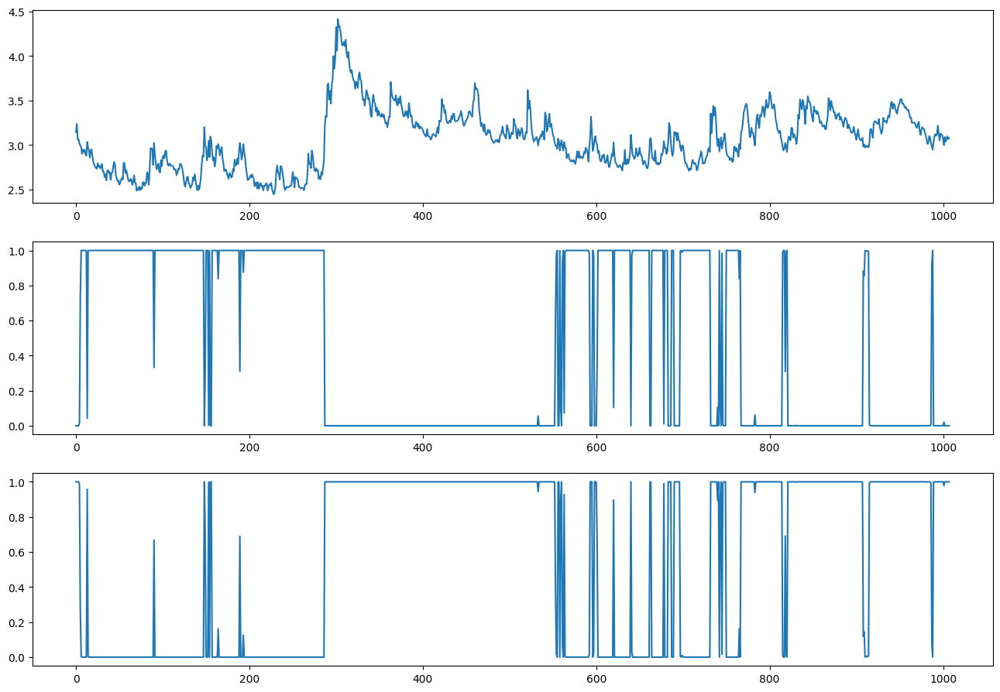


ite=0, max(diff) = 2.949265401079581

mu_hat0 = [2.7664 3.2938], 
sigma_hat0 = [0.1456 0.2372], 
P_hat0 = 
[[0.9442 0.0558]
 [0.0466 0.9534]], 
pi_hat0 = [0. 1.]



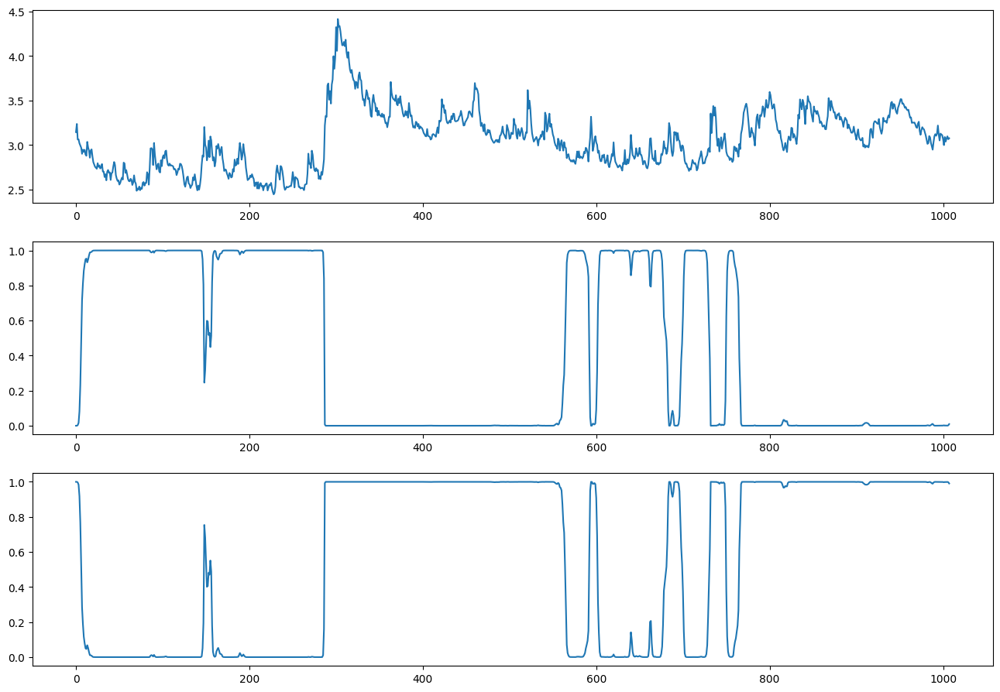


ite=1, max(diff) = 3.1212123816178736

mu_hat0 = [2.7542 3.2727], 
sigma_hat0 = [0.1448 0.2456], 
P_hat0 = 
[[0.983  0.017 ]
 [0.0125 0.9875]], 
pi_hat0 = [0. 1.]



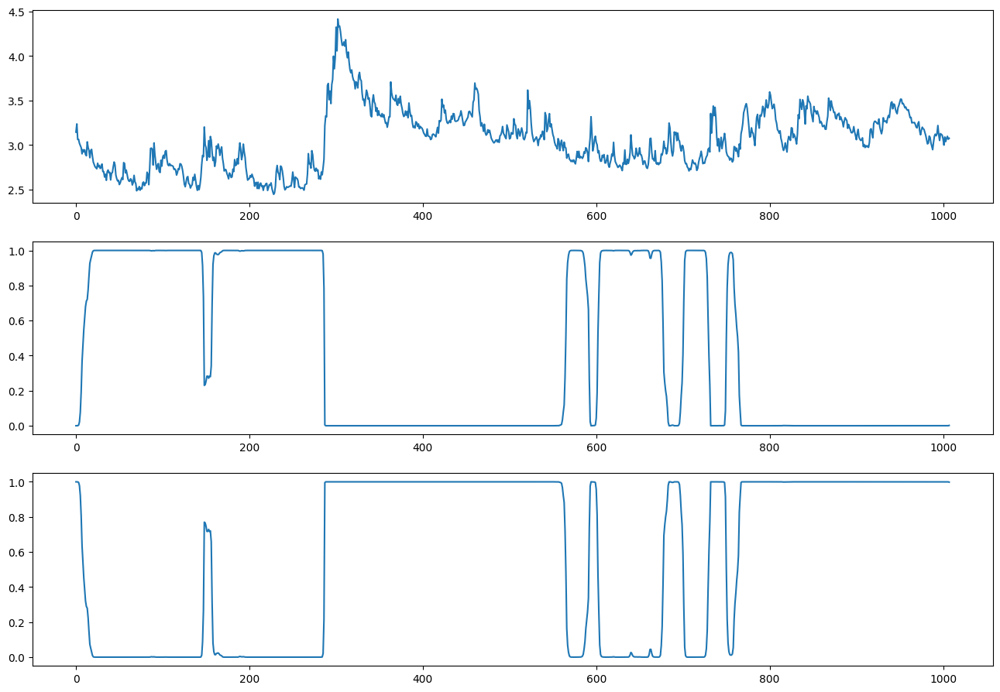


ite=2, max(diff) = 0.793733315500965

mu_hat0 = [2.7482 3.2653], 
sigma_hat0 = [0.1428 0.2479], 
P_hat0 = 
[[0.9855 0.0145]
 [0.01   0.99  ]], 
pi_hat0 = [0. 1.]



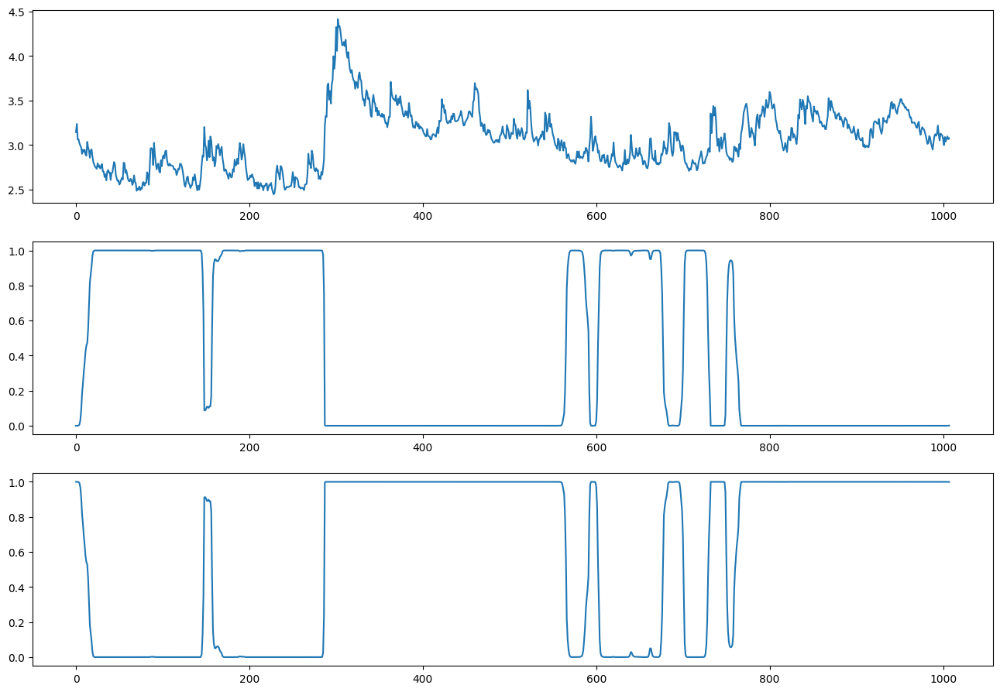


ite=3, max(diff) = 0.10798259126323842

mu_hat0 = [2.7438 3.2604], 
sigma_hat0 = [0.141  0.2494], 
P_hat0 = 
[[0.985 0.015]
 [0.01  0.99 ]], 
pi_hat0 = [0. 1.]



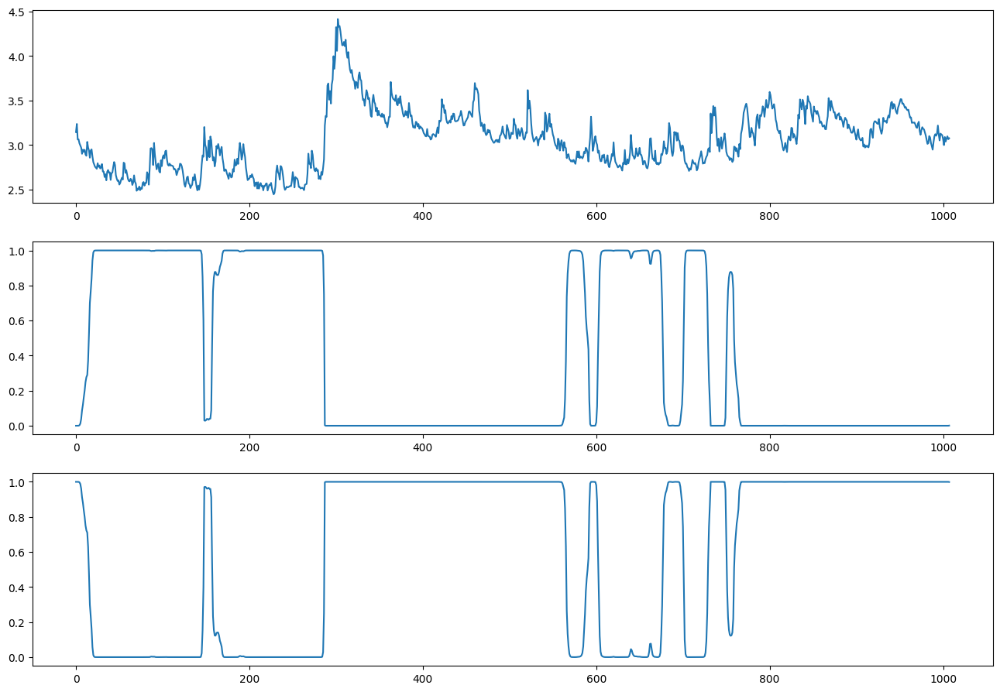


ite=4, max(diff) = 0.0839673525040369

mu_hat0 = [2.7405 3.2566], 
sigma_hat0 = [0.1397 0.2505], 
P_hat0 = 
[[0.9846 0.0154]
 [0.01   0.99  ]], 
pi_hat0 = [0. 1.]



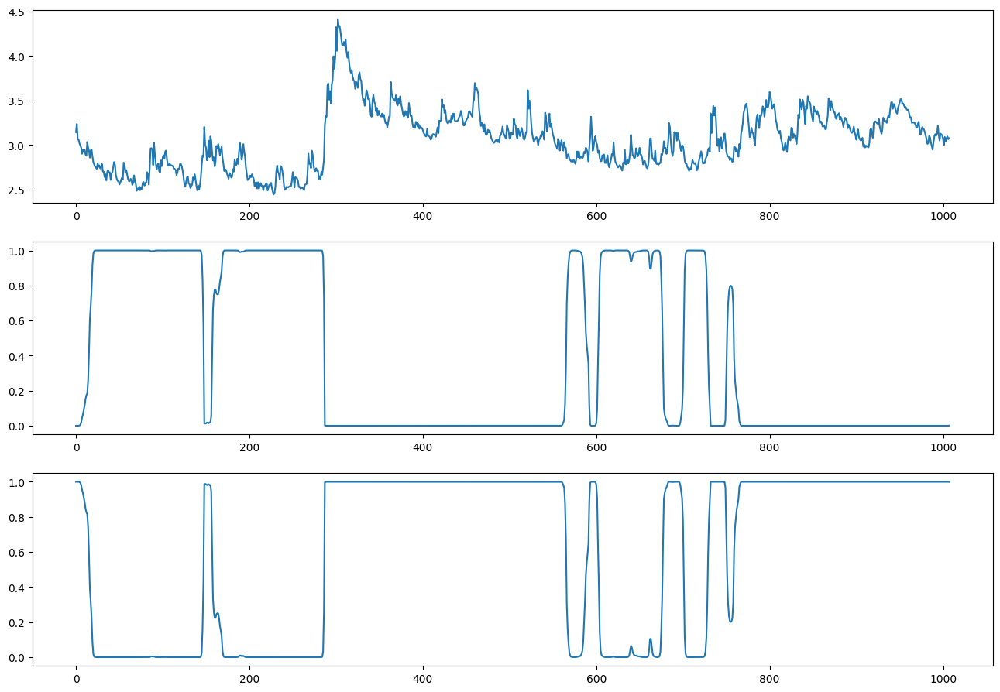


ite=5, max(diff) = 0.06059399276735226

mu_hat0 = [2.738  3.2536], 
sigma_hat0 = [0.1388 0.2515], 
P_hat0 = 
[[0.9844 0.0156]
 [0.0099 0.9901]], 
pi_hat0 = [0. 1.]



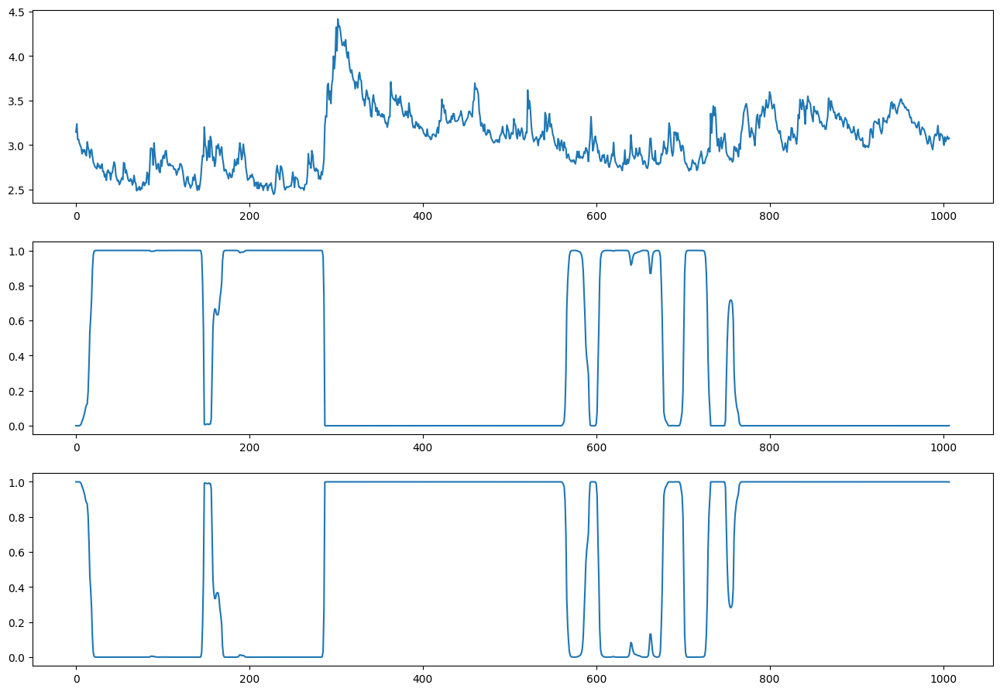


ite=6, max(diff) = 0.04731194204980001

mu_hat0 = [2.736  3.2511], 
sigma_hat0 = [0.1382 0.2523], 
P_hat0 = 
[[0.9843 0.0157]
 [0.0098 0.9902]], 
pi_hat0 = [0. 1.]



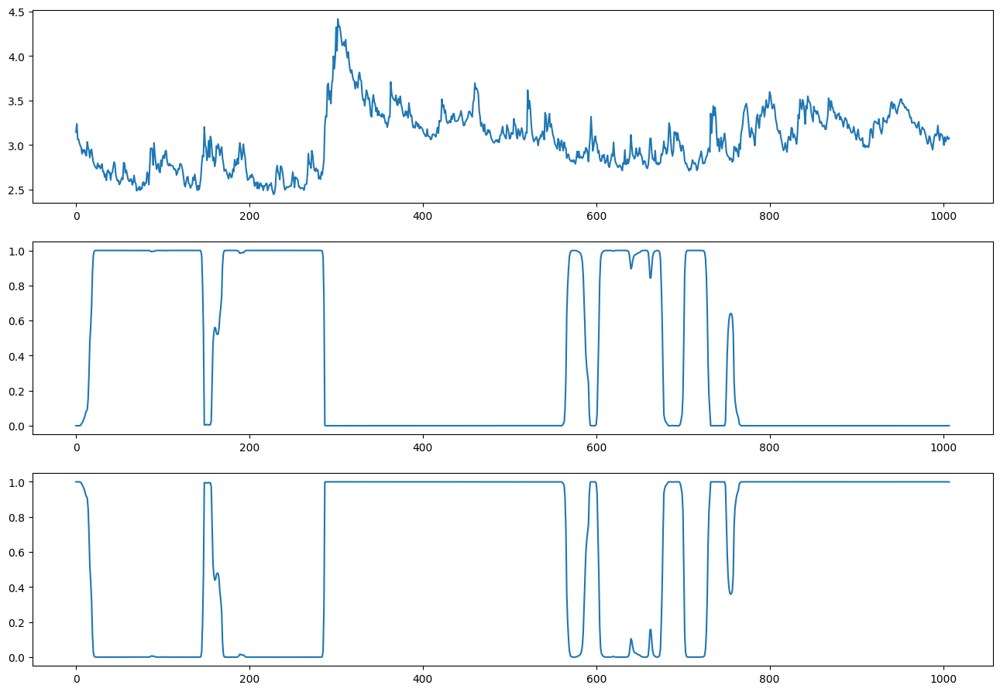


ite=7, max(diff) = 0.039875683671715706

mu_hat0 = [2.7343 3.2491], 
sigma_hat0 = [0.1376 0.253 ], 
P_hat0 = 
[[0.9842 0.0158]
 [0.0097 0.9903]], 
pi_hat0 = [0. 1.]



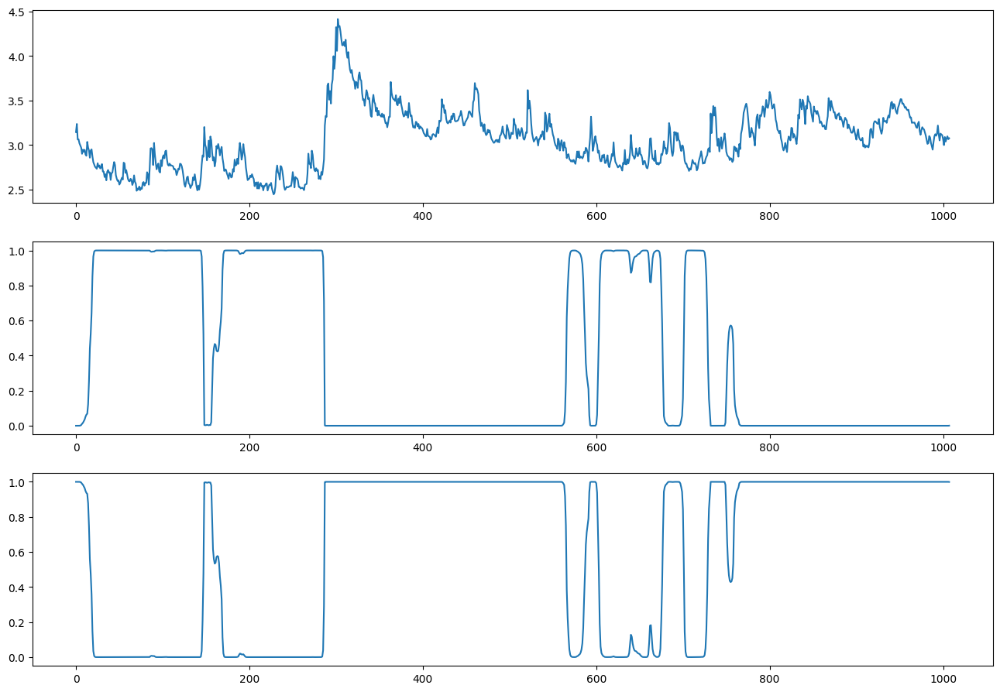


ite=8, max(diff) = 0.03549927860947613

mu_hat0 = [2.7329 3.2473], 
sigma_hat0 = [0.1371 0.2536], 
P_hat0 = 
[[0.9841 0.0159]
 [0.0096 0.9904]], 
pi_hat0 = [0. 1.]



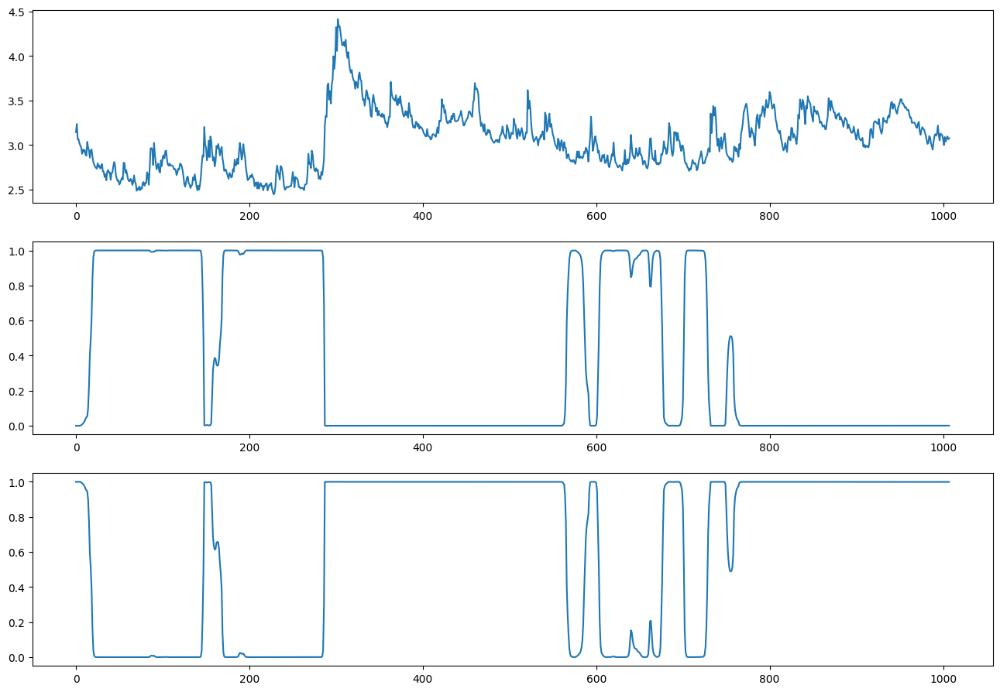


ite=9, max(diff) = 0.032763840006676925

mu_hat0 = [2.7316 3.2458], 
sigma_hat0 = [0.1367 0.2541], 
P_hat0 = 
[[0.9839 0.0161]
 [0.0096 0.9904]], 
pi_hat0 = [0. 1.]



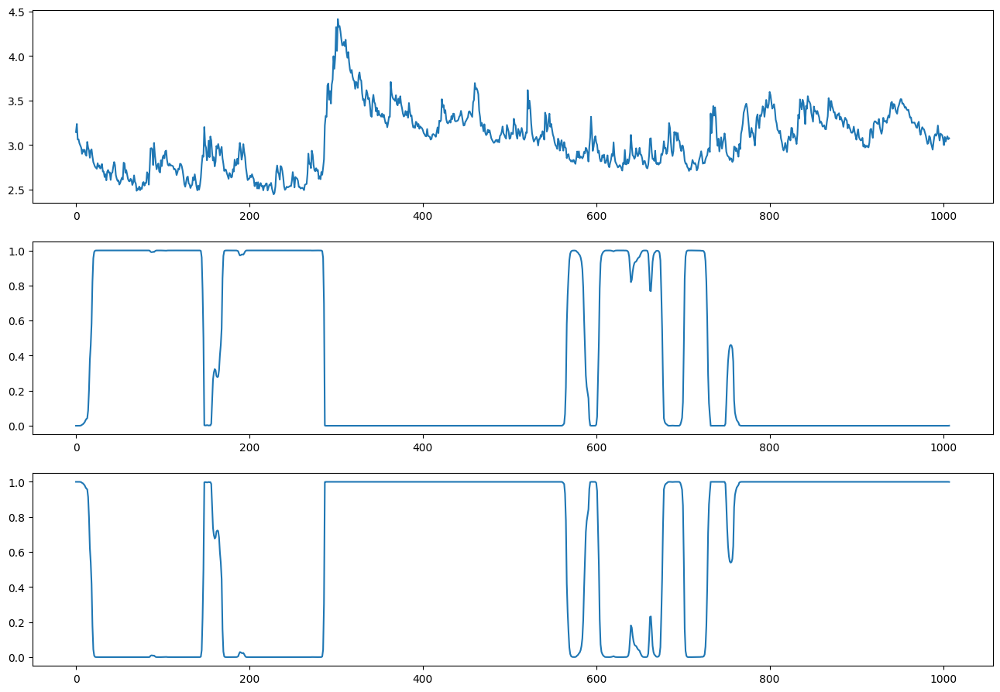


ite=10, max(diff) = 0.030959101225414103

mu_hat0 = [2.7305 3.2445], 
sigma_hat0 = [0.1363 0.2545], 
P_hat0 = 
[[0.9838 0.0162]
 [0.0096 0.9904]], 
pi_hat0 = [0. 1.]



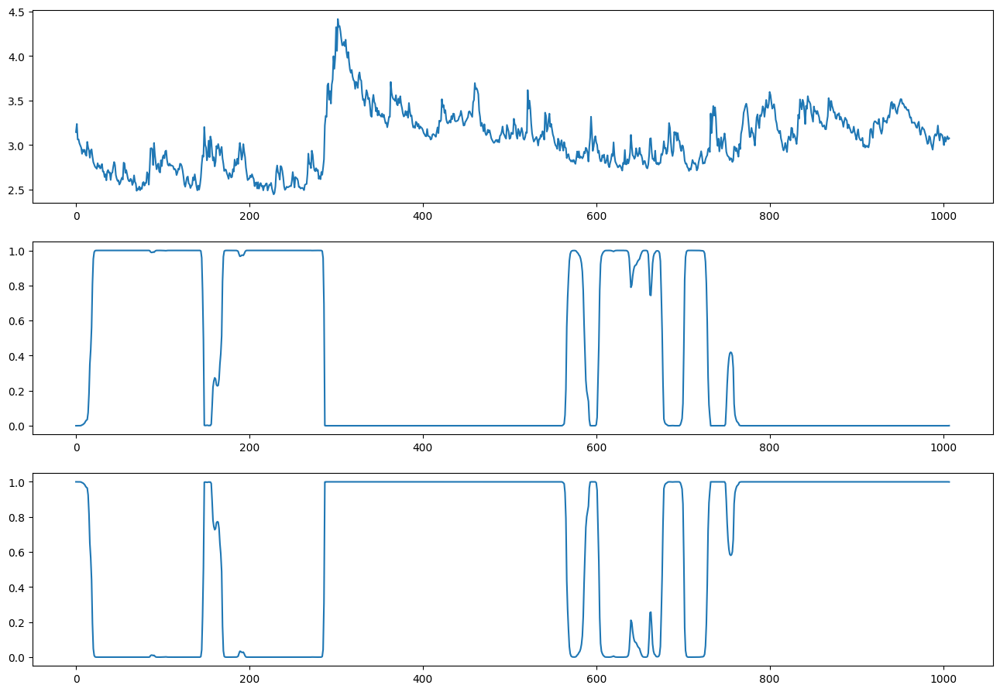


ite=11, max(diff) = 0.029714838344462903

mu_hat0 = [2.7295 3.2434], 
sigma_hat0 = [0.1359 0.2549], 
P_hat0 = 
[[0.9837 0.0163]
 [0.0096 0.9904]], 
pi_hat0 = [0. 1.]



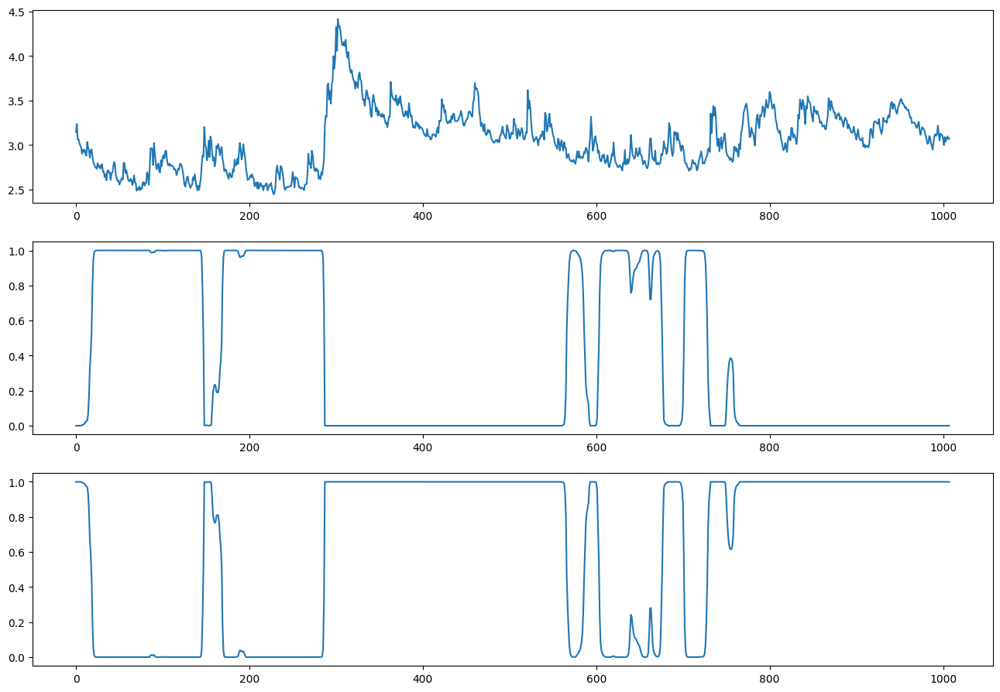


ite=12, max(diff) = 0.036399560901023476

mu_hat0 = [2.7286 3.2424], 
sigma_hat0 = [0.1356 0.2552], 
P_hat0 = 
[[0.9835 0.0165]
 [0.0096 0.9904]], 
pi_hat0 = [0. 1.]



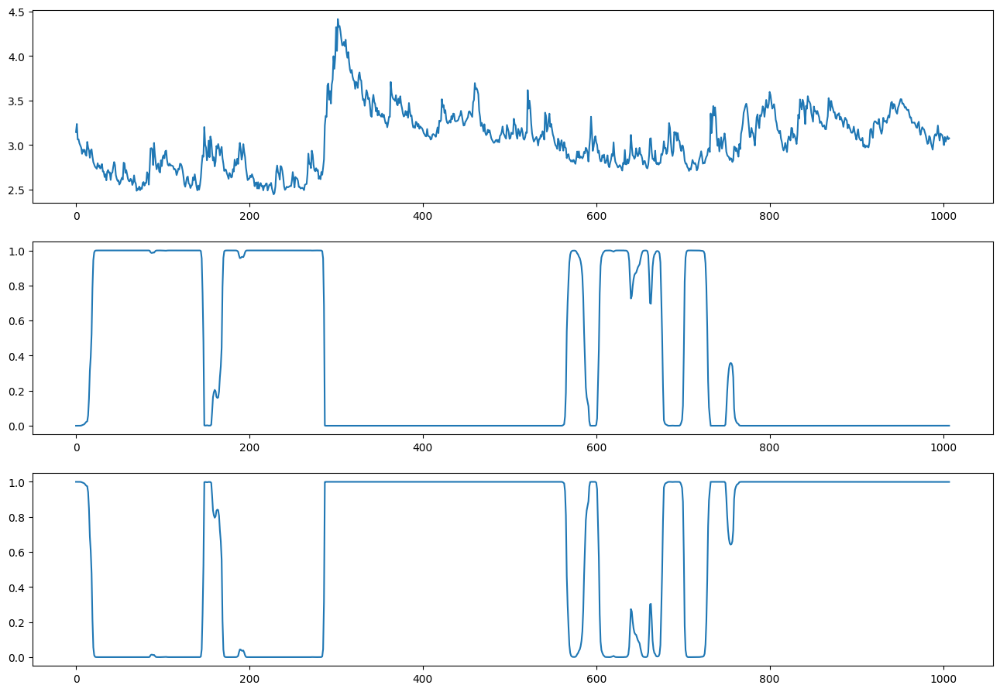


ite=13, max(diff) = 0.041835149463878625

mu_hat0 = [2.7278 3.2416], 
sigma_hat0 = [0.1353 0.2554], 
P_hat0 = 
[[0.9833 0.0167]
 [0.0096 0.9904]], 
pi_hat0 = [0. 1.]



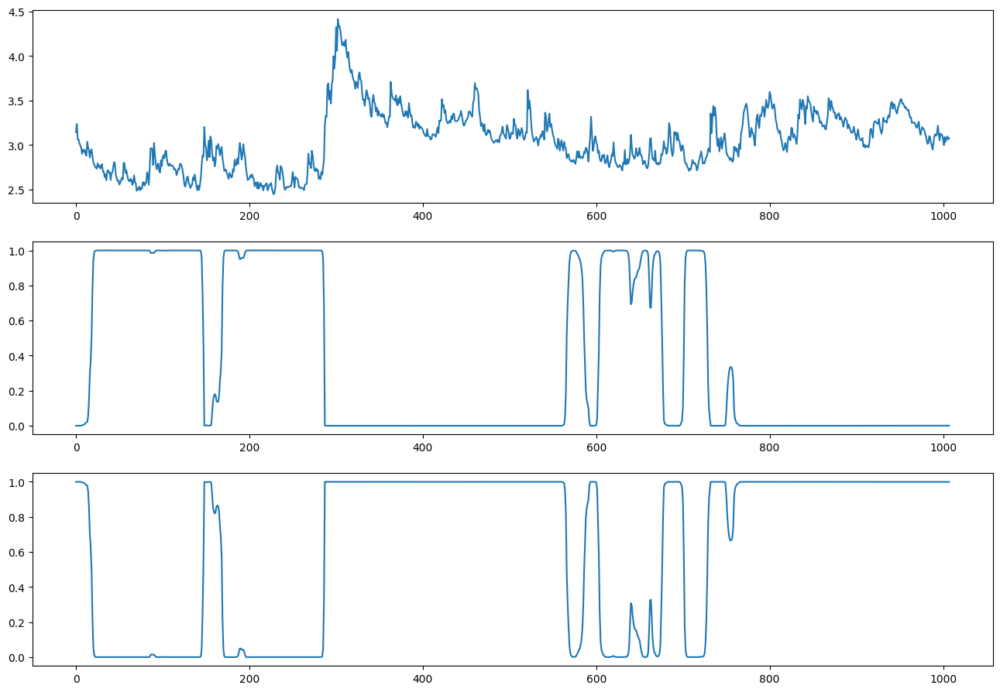


ite=14, max(diff) = 0.046283745891728845

mu_hat0 = [2.7271 3.2408], 
sigma_hat0 = [0.135  0.2557], 
P_hat0 = 
[[0.9832 0.0168]
 [0.0097 0.9903]], 
pi_hat0 = [0. 1.]



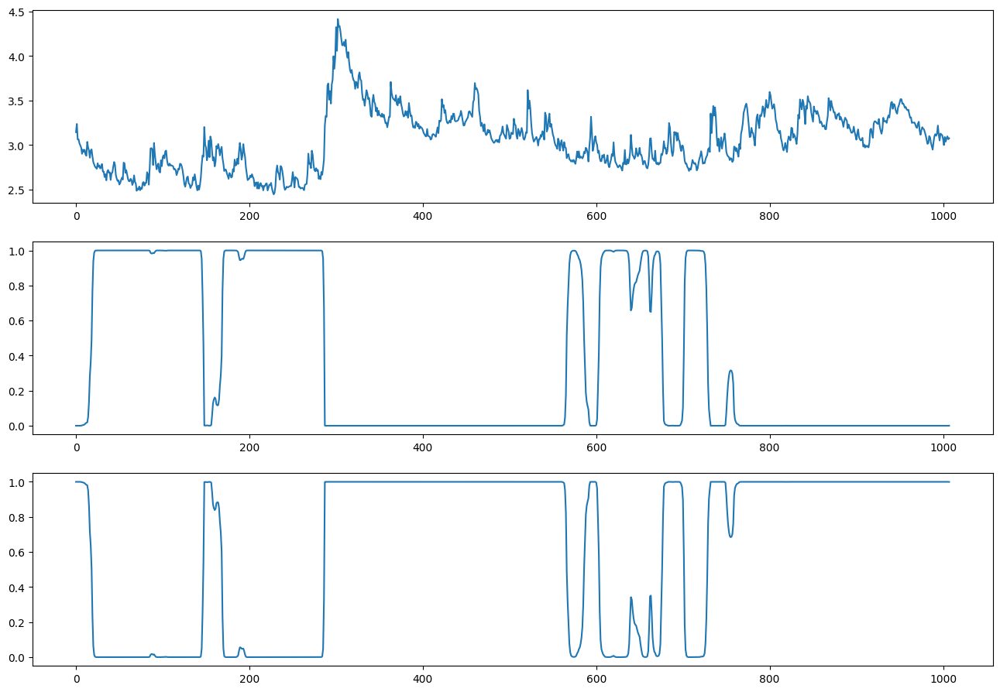


ite=15, max(diff) = 0.05032192137262009

mu_hat0 = [2.7265 3.2401], 
sigma_hat0 = [0.1347 0.2559], 
P_hat0 = 
[[0.983  0.017 ]
 [0.0097 0.9903]], 
pi_hat0 = [0. 1.]



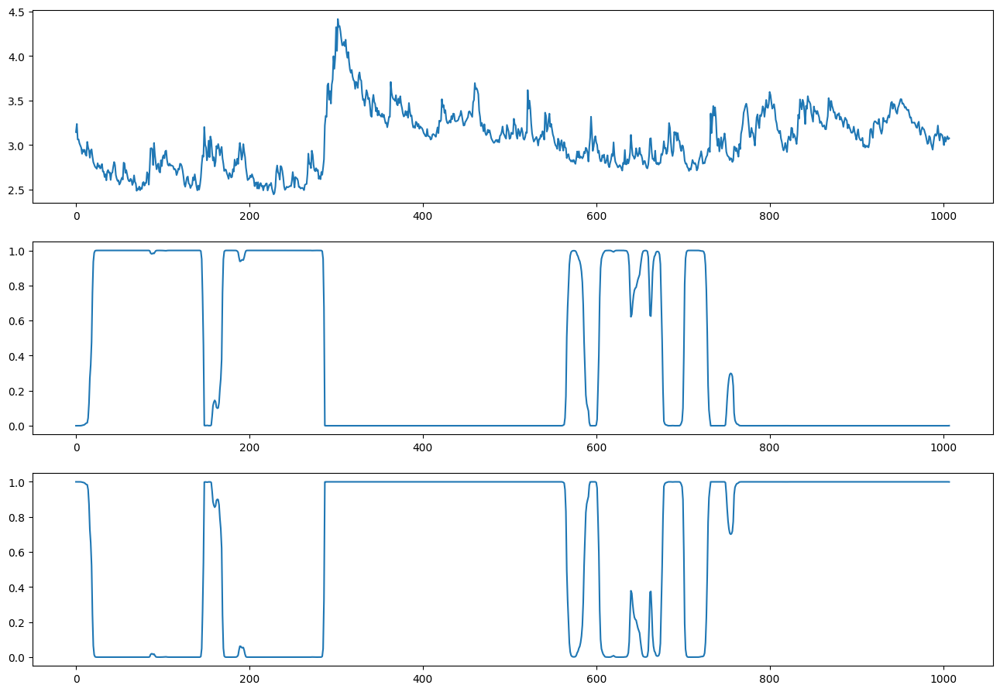


ite=16, max(diff) = 0.05460696177942095

mu_hat0 = [2.7258 3.2395], 
sigma_hat0 = [0.1344 0.2561], 
P_hat0 = 
[[0.9828 0.0172]
 [0.0098 0.9902]], 
pi_hat0 = [0. 1.]



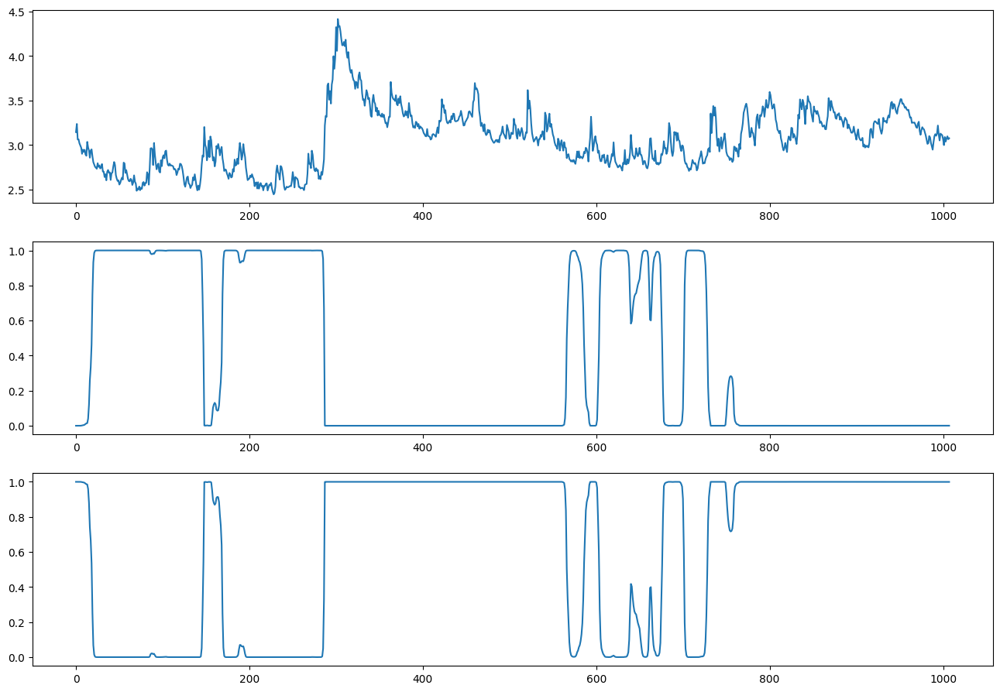


ite=17, max(diff) = 0.059797601903513485

mu_hat0 = [2.7251 3.2388], 
sigma_hat0 = [0.1341 0.2563], 
P_hat0 = 
[[0.9825 0.0175]
 [0.0098 0.9902]], 
pi_hat0 = [0. 1.]



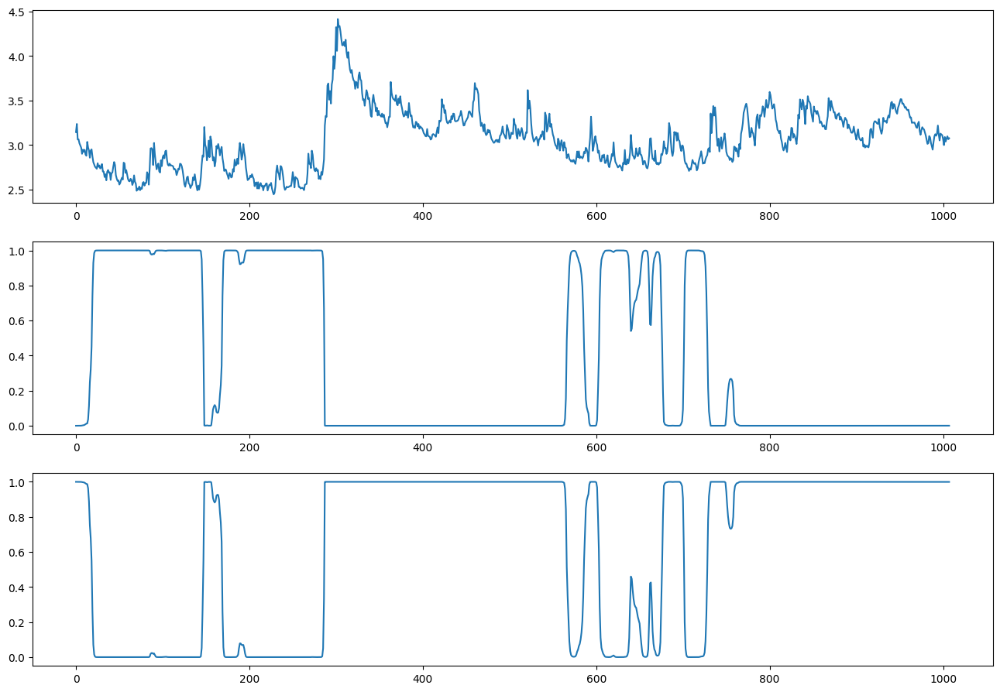


ite=18, max(diff) = 0.06656748368228282

mu_hat0 = [2.7244 3.2381], 
sigma_hat0 = [0.1338 0.2565], 
P_hat0 = 
[[0.9823 0.0177]
 [0.0099 0.9901]], 
pi_hat0 = [0. 1.]



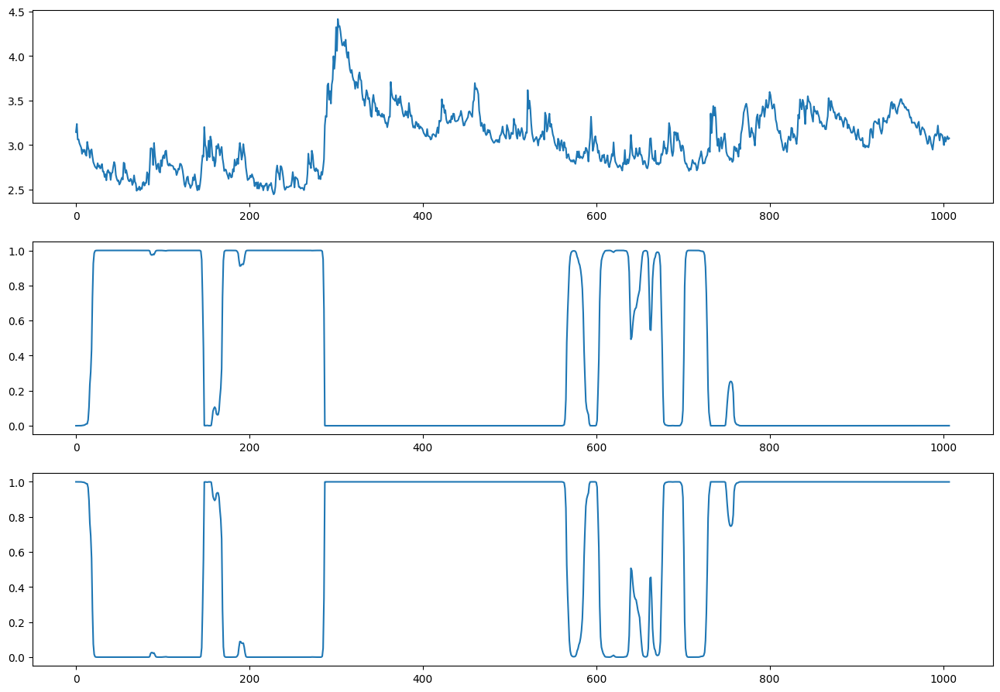


ite=19, max(diff) = 0.07565583725517858

mu_hat0 = [2.7236 3.2373], 
sigma_hat0 = [0.1335 0.2567], 
P_hat0 = 
[[0.982 0.018]
 [0.01  0.99 ]], 
pi_hat0 = [0. 1.]



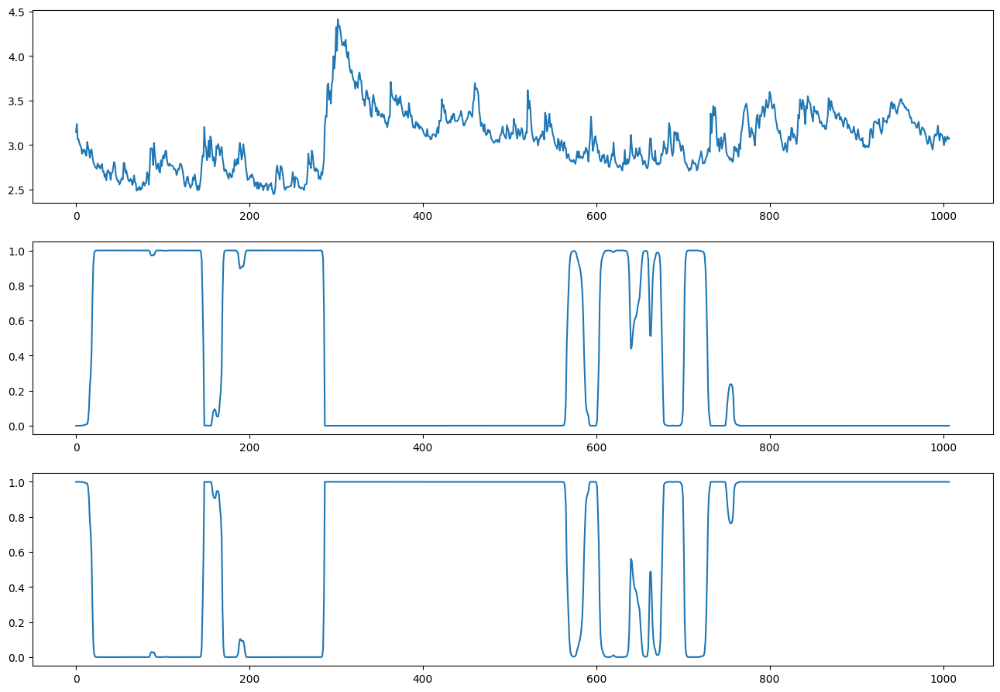


ite=20, max(diff) = 0.0878984976699603

mu_hat0 = [2.7227 3.2364], 
sigma_hat0 = [0.1331 0.2569], 
P_hat0 = 
[[0.9817 0.0183]
 [0.0101 0.9899]], 
pi_hat0 = [0. 1.]



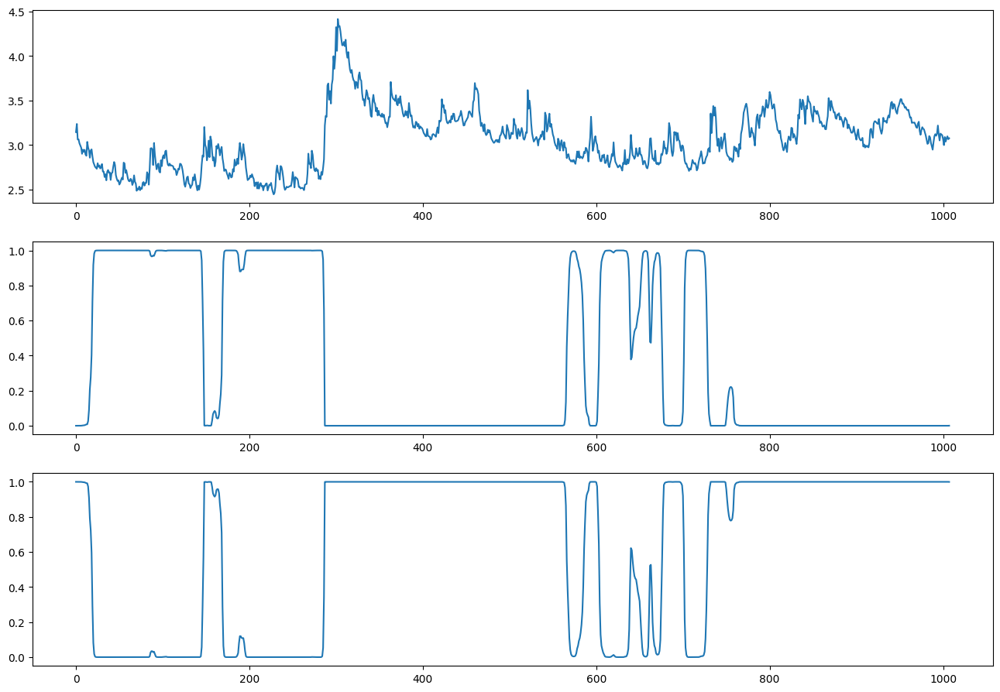


ite=21, max(diff) = 0.10415206439801777

mu_hat0 = [2.7217 3.2354], 
sigma_hat0 = [0.1326 0.2572], 
P_hat0 = 
[[0.9813 0.0187]
 [0.0103 0.9897]], 
pi_hat0 = [0. 1.]



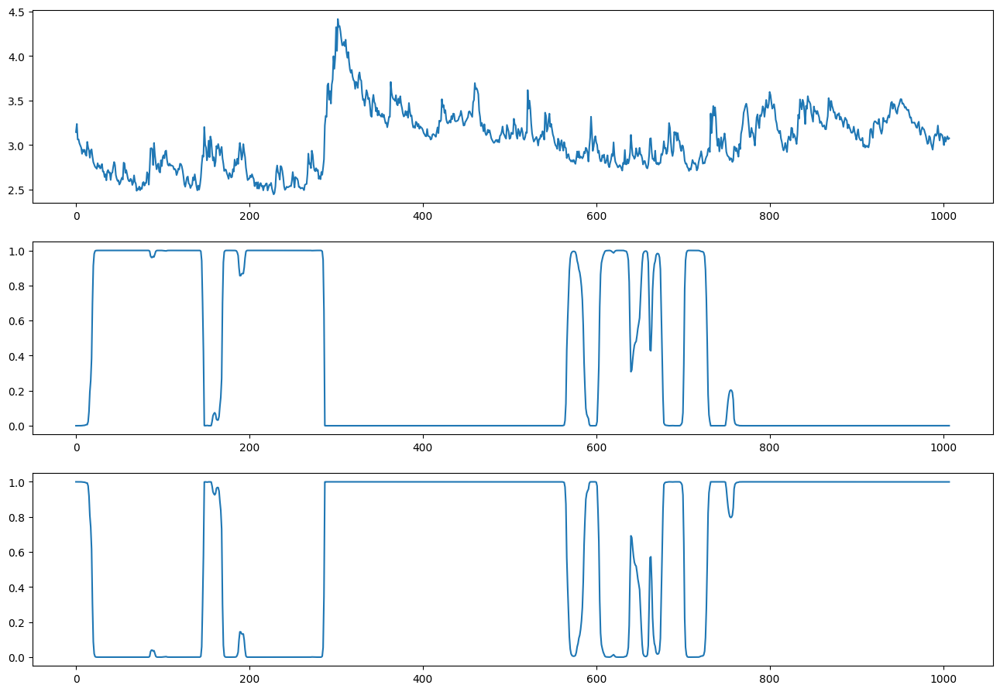


ite=22, max(diff) = 0.12494828618876225

mu_hat0 = [2.7204 3.2342], 
sigma_hat0 = [0.132  0.2575], 
P_hat0 = 
[[0.9808 0.0192]
 [0.0104 0.9896]], 
pi_hat0 = [0. 1.]



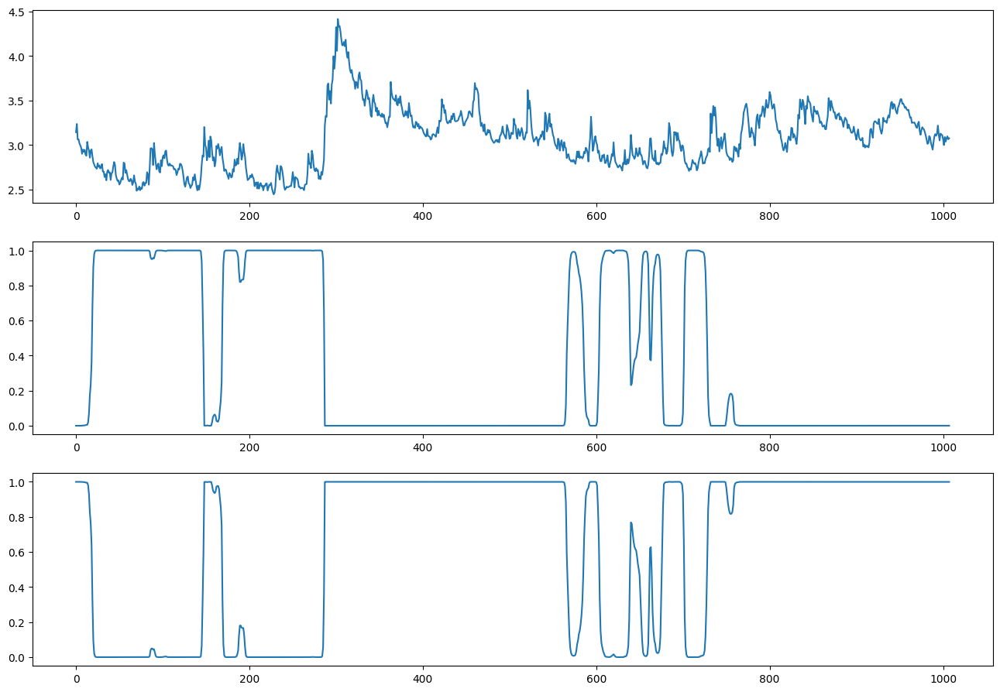


ite=23, max(diff) = 0.14969705084664772

mu_hat0 = [2.7188 3.2327], 
sigma_hat0 = [0.1313 0.2579], 
P_hat0 = 
[[0.9802 0.0198]
 [0.0106 0.9894]], 
pi_hat0 = [0. 1.]



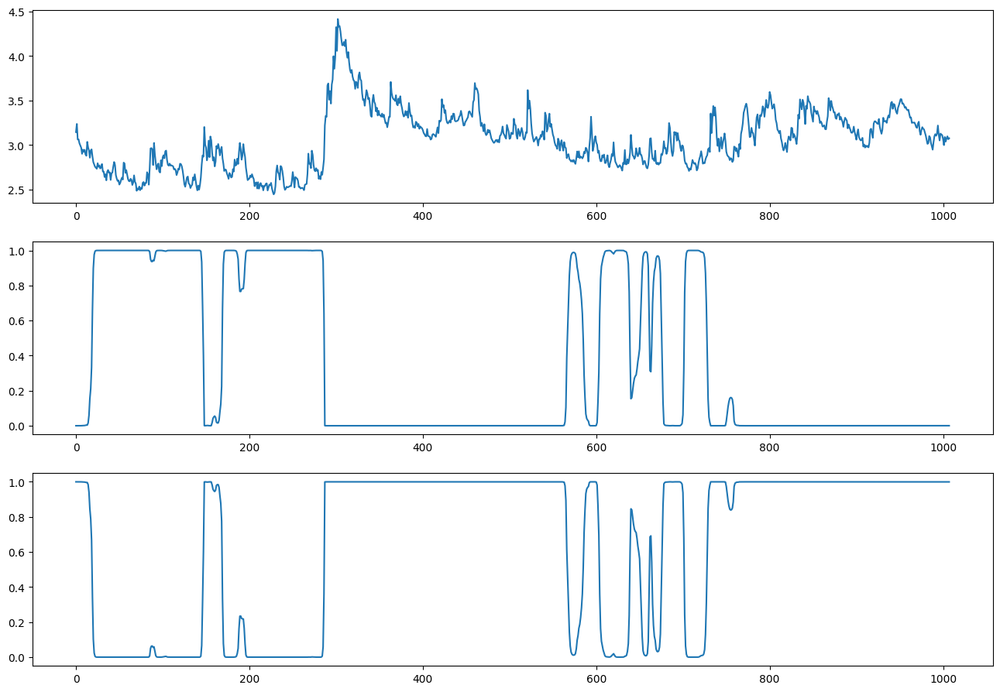


ite=24, max(diff) = 0.17576342611179496

mu_hat0 = [2.7169 3.2309], 
sigma_hat0 = [0.1304 0.2584], 
P_hat0 = 
[[0.9795 0.0205]
 [0.0108 0.9892]], 
pi_hat0 = [0. 1.]



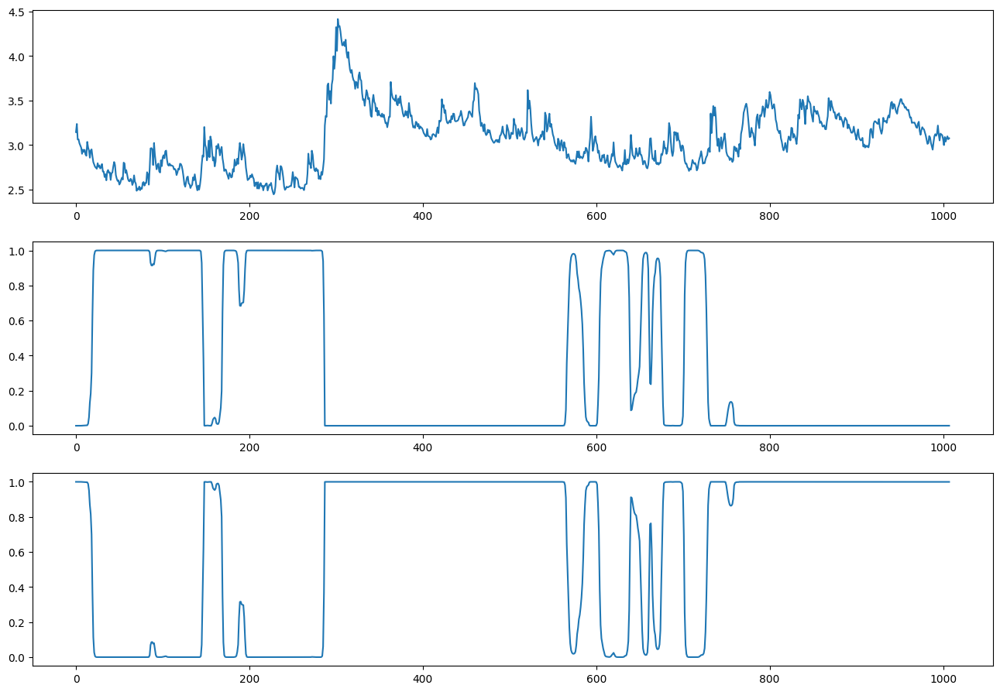


ite=25, max(diff) = 0.19912091632143428

mu_hat0 = [2.7146 3.2287], 
sigma_hat0 = [0.1294 0.259 ], 
P_hat0 = 
[[0.9786 0.0214]
 [0.011  0.989 ]], 
pi_hat0 = [0. 1.]



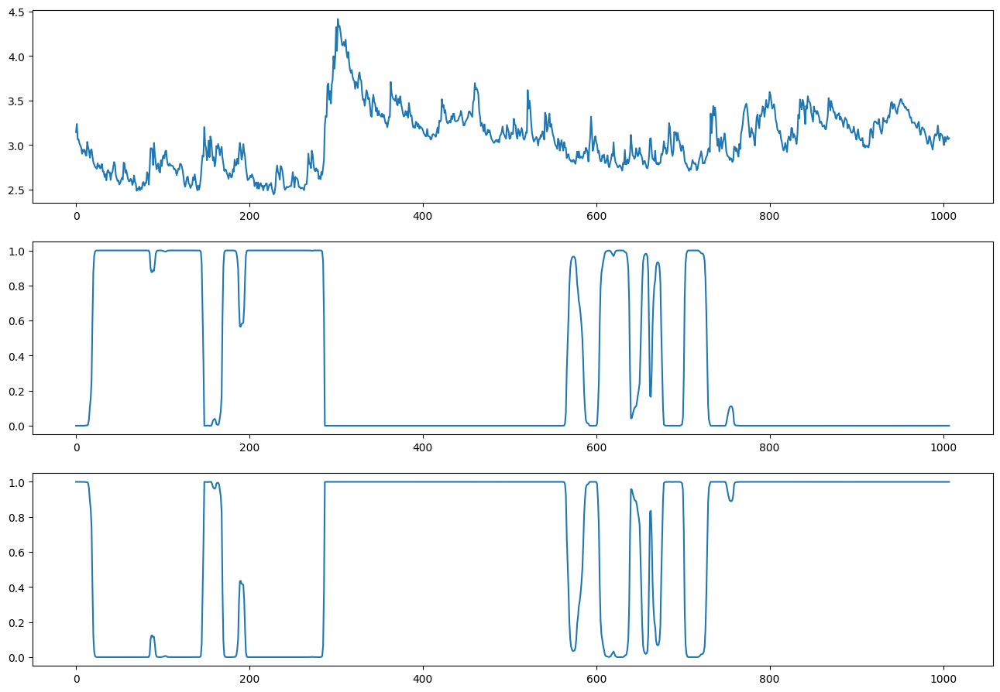


ite=26, max(diff) = 0.21716909208900934

mu_hat0 = [2.7119 3.2262], 
sigma_hat0 = [0.1281 0.2597], 
P_hat0 = 
[[0.9776 0.0224]
 [0.0113 0.9887]], 
pi_hat0 = [0. 1.]



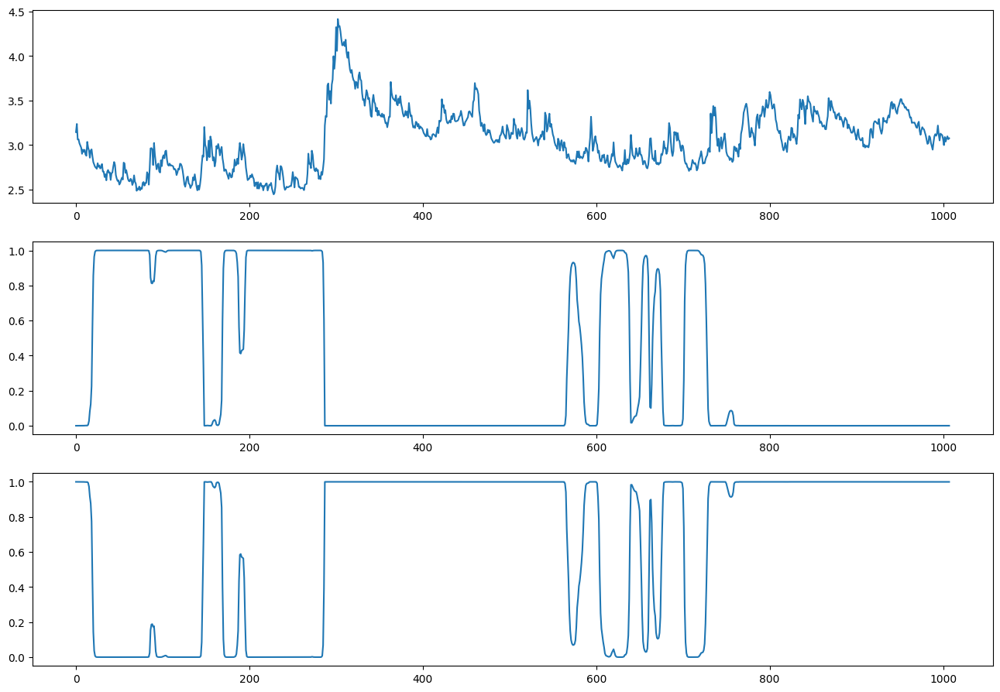


ite=27, max(diff) = 0.2269592606391339

mu_hat0 = [2.7086 3.2231], 
sigma_hat0 = [0.1267 0.2606], 
P_hat0 = 
[[0.9766 0.0234]
 [0.0115 0.9885]], 
pi_hat0 = [0. 1.]



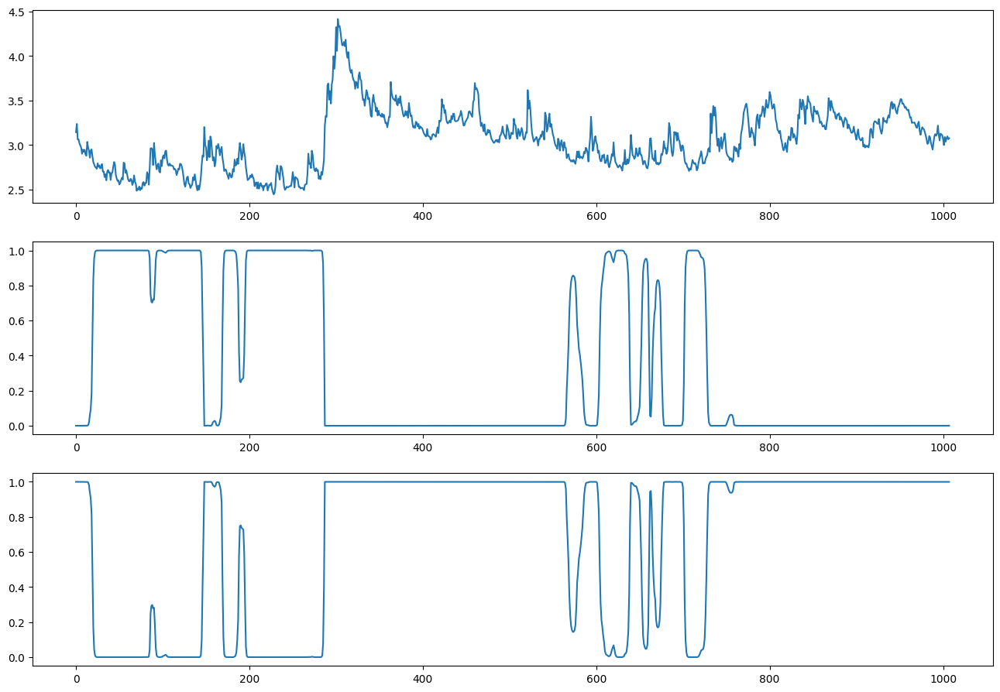


ite=28, max(diff) = 0.21545040795302123

mu_hat0 = [2.7046 3.2193], 
sigma_hat0 = [0.125  0.2618], 
P_hat0 = 
[[0.9755 0.0245]
 [0.0116 0.9884]], 
pi_hat0 = [0. 1.]



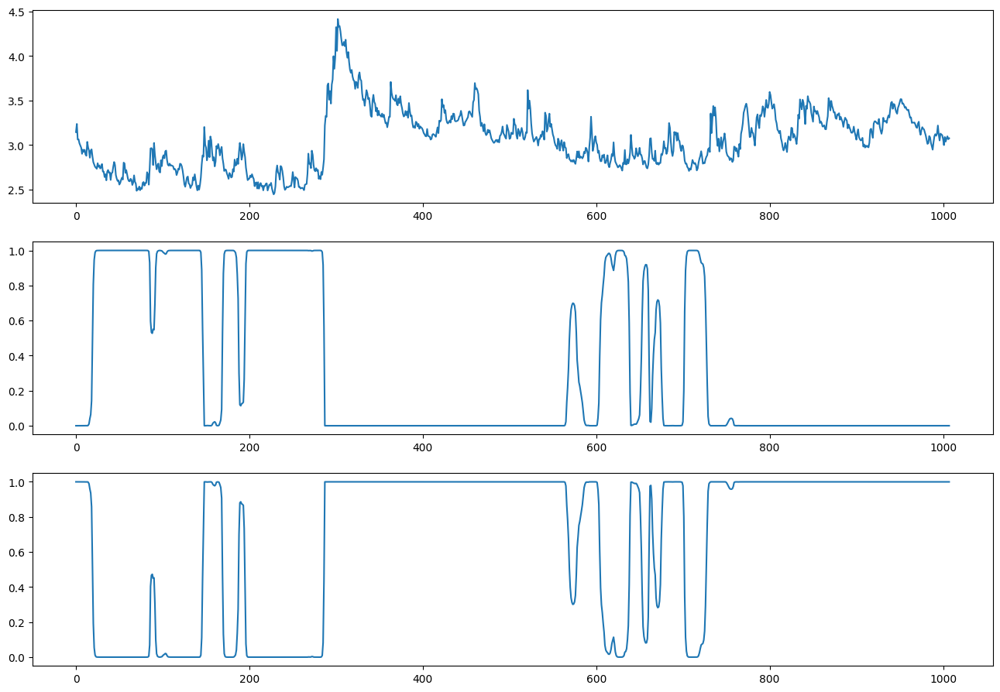


ite=29, max(diff) = 0.18121642674770377

mu_hat0 = [2.6994 3.2142], 
sigma_hat0 = [0.1228 0.2633], 
P_hat0 = 
[[0.9745 0.0255]
 [0.0116 0.9884]], 
pi_hat0 = [0. 1.]



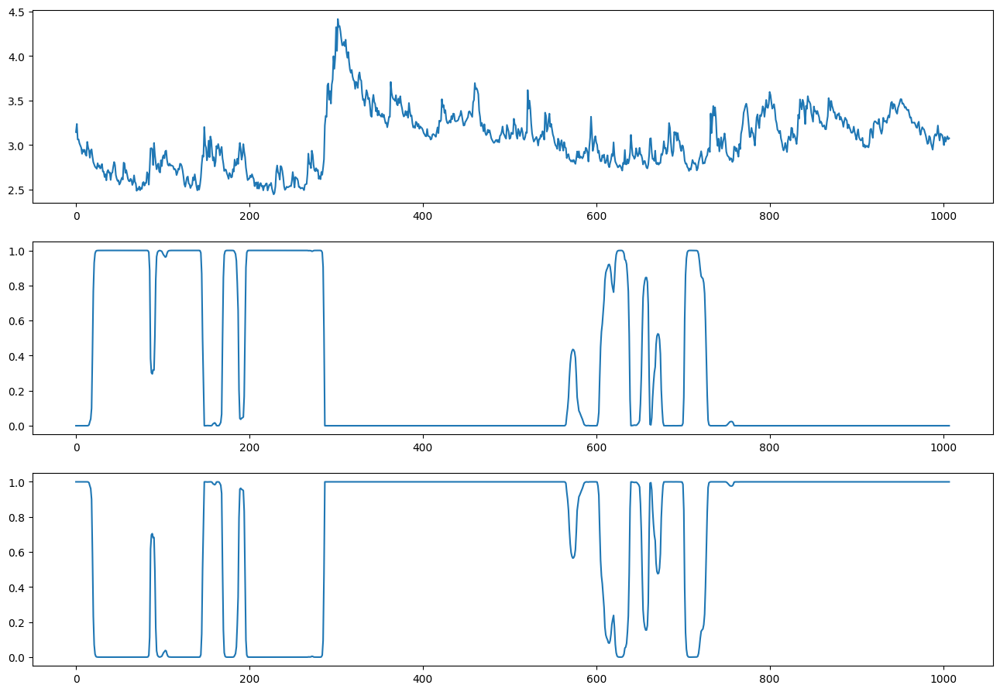


ite=30, max(diff) = 0.18677124631000977

mu_hat0 = [2.6924 3.2075], 
sigma_hat0 = [0.1201 0.2655], 
P_hat0 = 
[[0.9738 0.0262]
 [0.0112 0.9888]], 
pi_hat0 = [0. 1.]



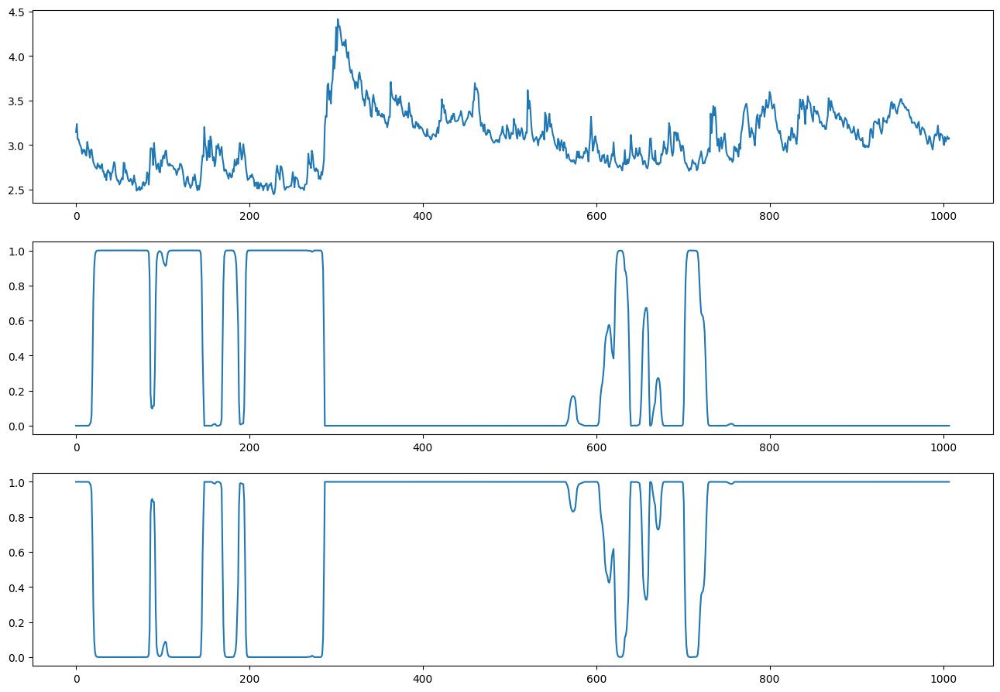


ite=31, max(diff) = 0.21749338445068633

mu_hat0 = [2.6819 3.1979], 
sigma_hat0 = [0.1159 0.2685], 
P_hat0 = 
[[0.9734 0.0266]
 [0.0103 0.9897]], 
pi_hat0 = [0. 1.]



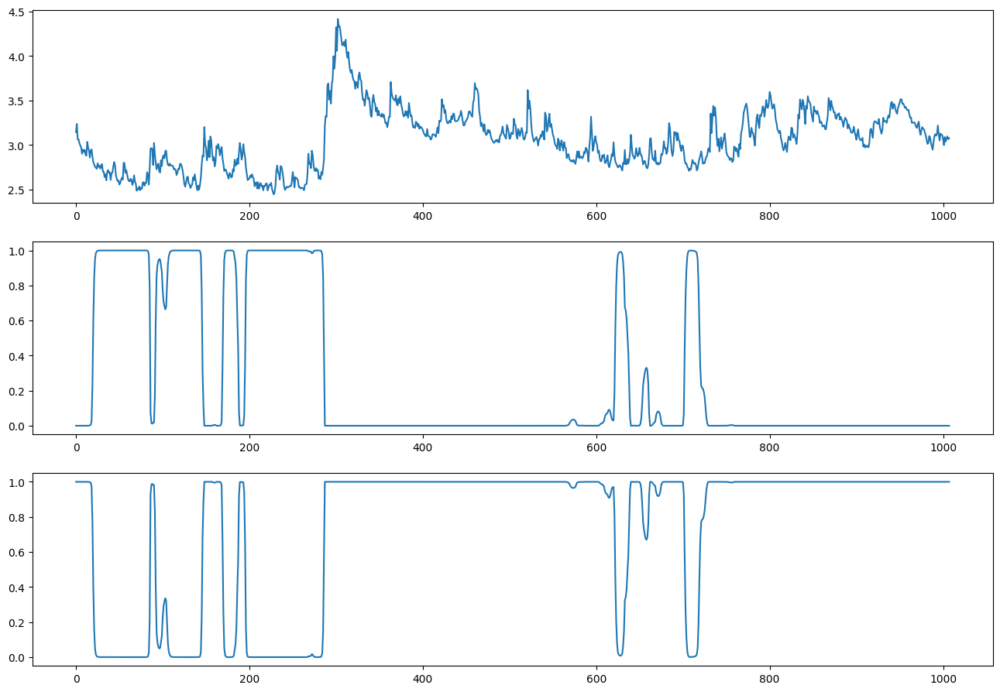


ite=32, max(diff) = 0.2262014127404986

mu_hat0 = [2.6689 3.1872], 
sigma_hat0 = [0.1099 0.2718], 
P_hat0 = 
[[0.9733 0.0267]
 [0.0093 0.9907]], 
pi_hat0 = [0. 1.]



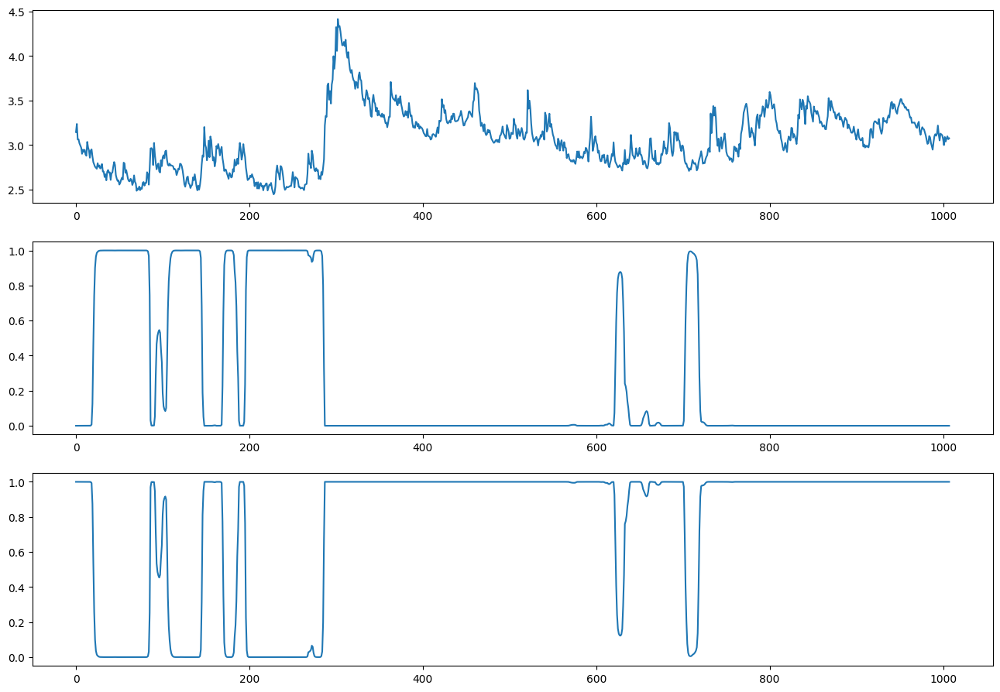


ite=33, max(diff) = 0.3330756970009073

mu_hat0 = [2.6567 3.1776], 
sigma_hat0 = [0.1039 0.2748], 
P_hat0 = 
[[0.9723 0.0277]
 [0.0086 0.9914]], 
pi_hat0 = [0. 1.]



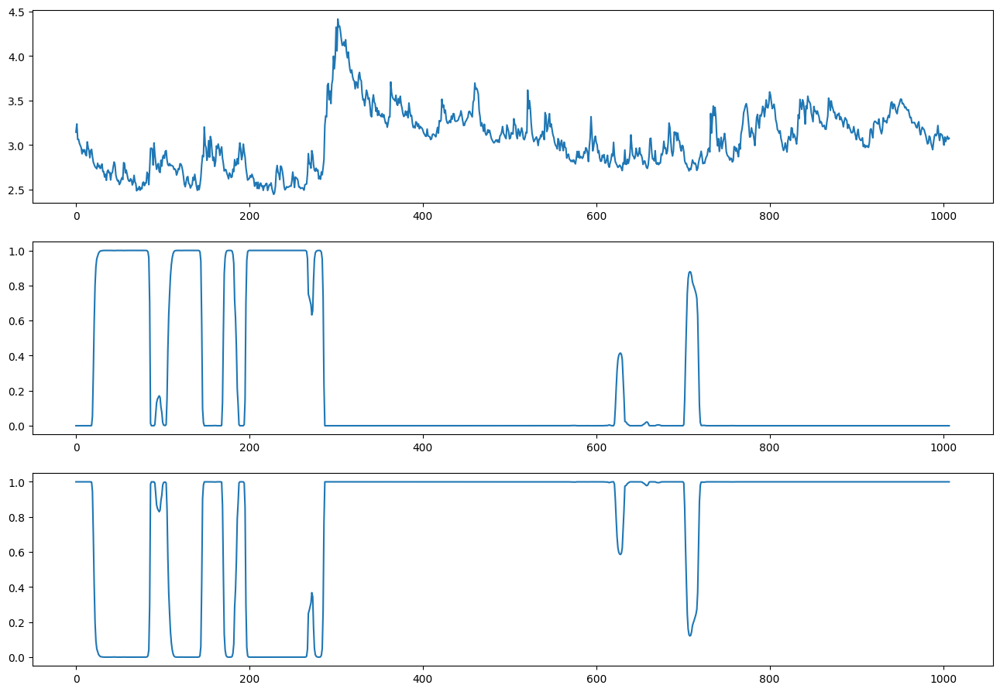


ite=34, max(diff) = 0.3964818369605528

mu_hat0 = [2.6459 3.1686], 
sigma_hat0 = [0.0995 0.278 ], 
P_hat0 = 
[[0.973  0.027 ]
 [0.0076 0.9924]], 
pi_hat0 = [0. 1.]



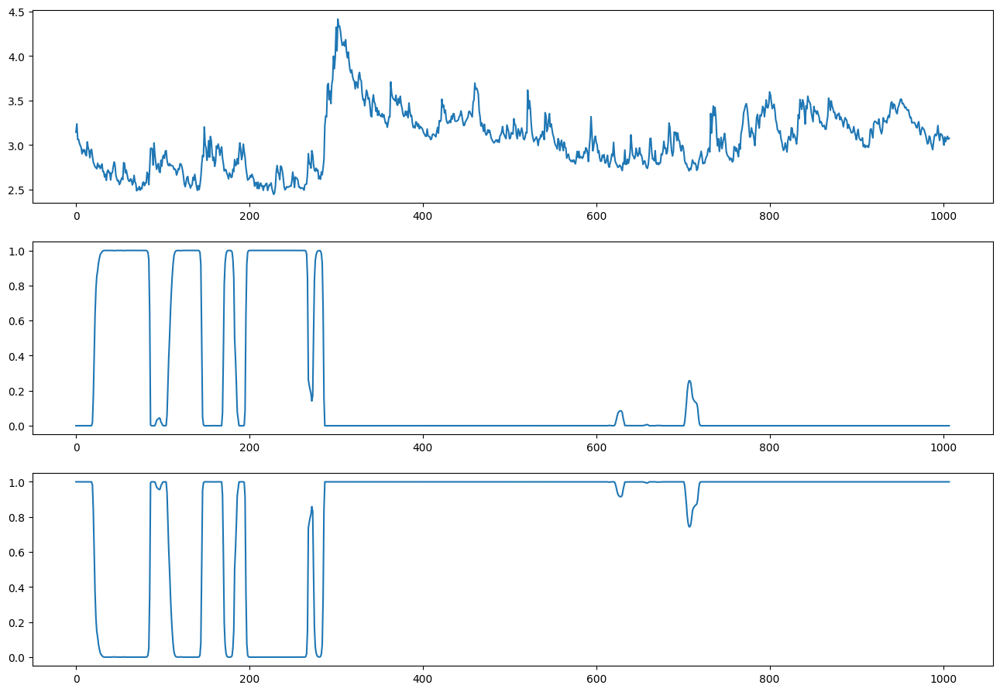


ite=35, max(diff) = 0.337016530721677

mu_hat0 = [2.632  3.1585], 
sigma_hat0 = [0.0927 0.2814], 
P_hat0 = 
[[0.9734 0.0266]
 [0.0066 0.9934]], 
pi_hat0 = [0. 1.]



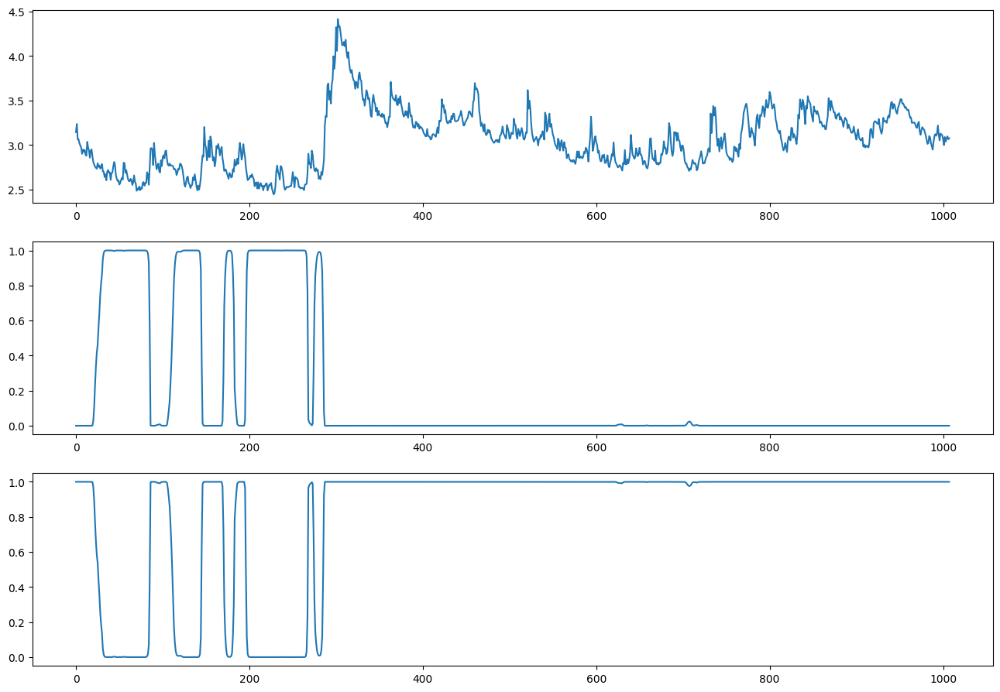


ite=36, max(diff) = 0.289741872706888

mu_hat0 = [2.6222 3.152 ], 
sigma_hat0 = [0.0873 0.2835], 
P_hat0 = 
[[0.9728 0.0272]
 [0.0062 0.9938]], 
pi_hat0 = [0. 1.]



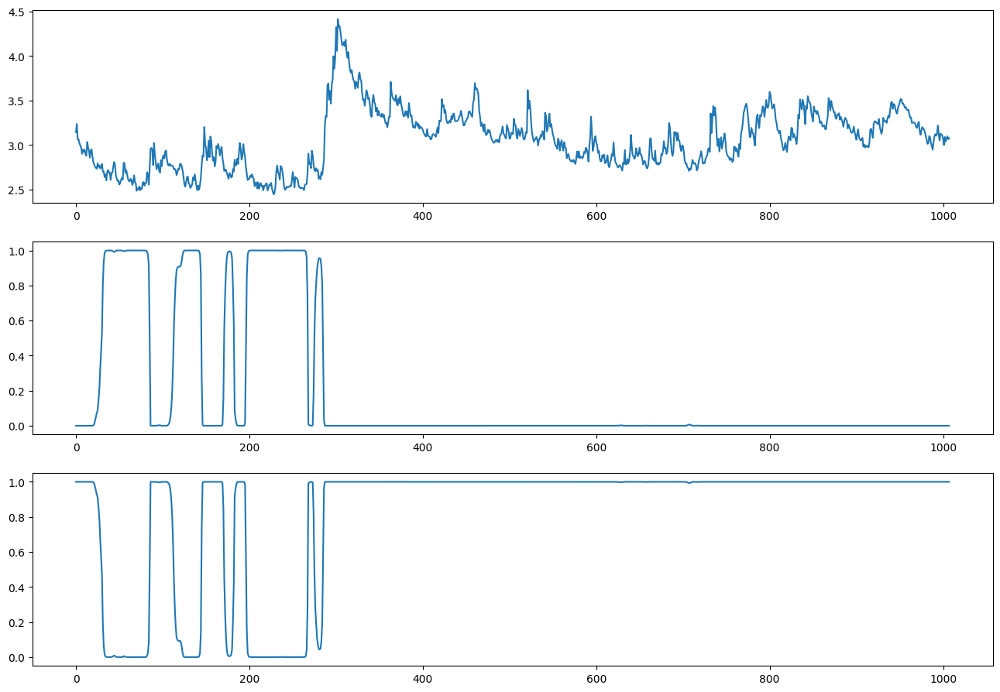


ite=37, max(diff) = 0.36195821062743355

mu_hat0 = [2.616  3.1478], 
sigma_hat0 = [0.0843 0.2851], 
P_hat0 = 
[[0.9718 0.0282]
 [0.0061 0.9939]], 
pi_hat0 = [0. 1.]



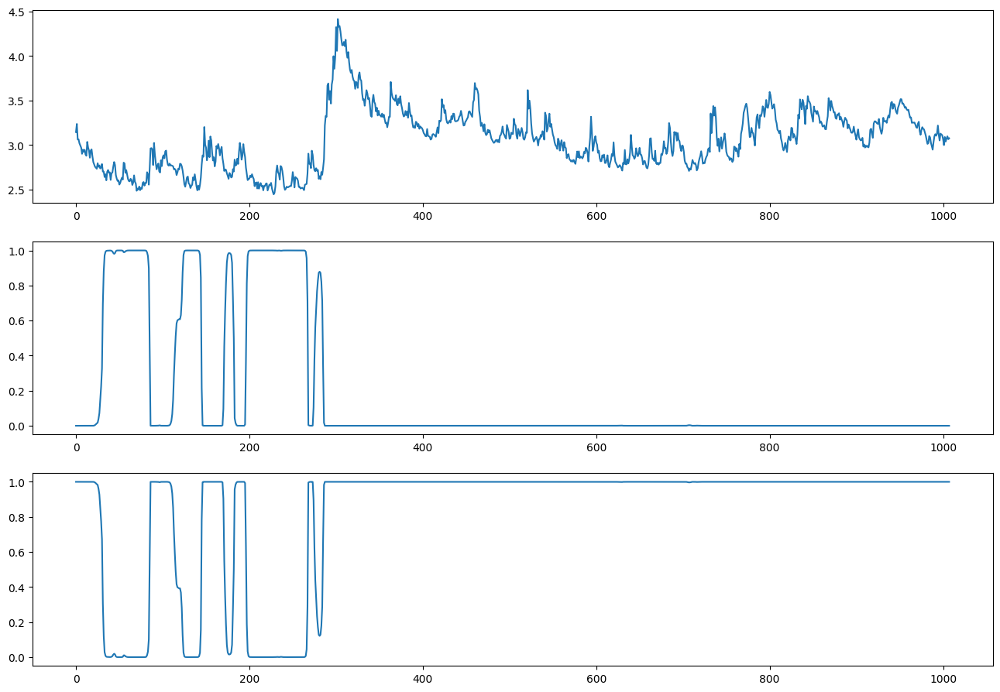


ite=38, max(diff) = 0.2955071138078903

mu_hat0 = [2.6113 3.1442], 
sigma_hat0 = [0.0822 0.2865], 
P_hat0 = 
[[0.971  0.029 ]
 [0.0059 0.9941]], 
pi_hat0 = [0. 1.]



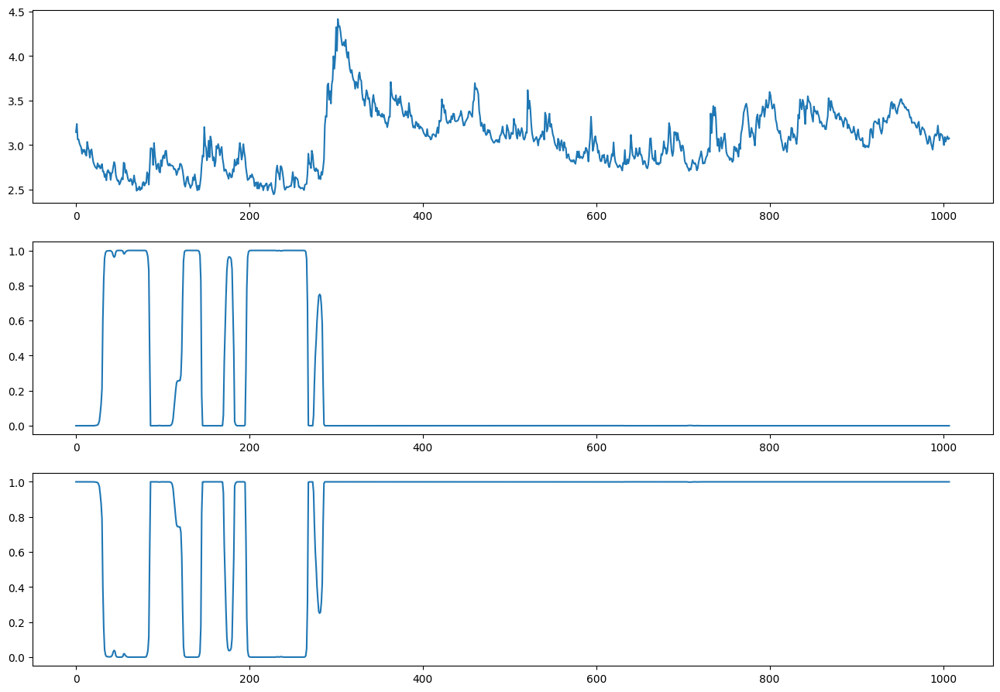


ite=39, max(diff) = 0.2094071509911622

mu_hat0 = [2.6068 3.1409], 
sigma_hat0 = [0.0802 0.2878], 
P_hat0 = 
[[0.9706 0.0294]
 [0.0057 0.9943]], 
pi_hat0 = [0. 1.]



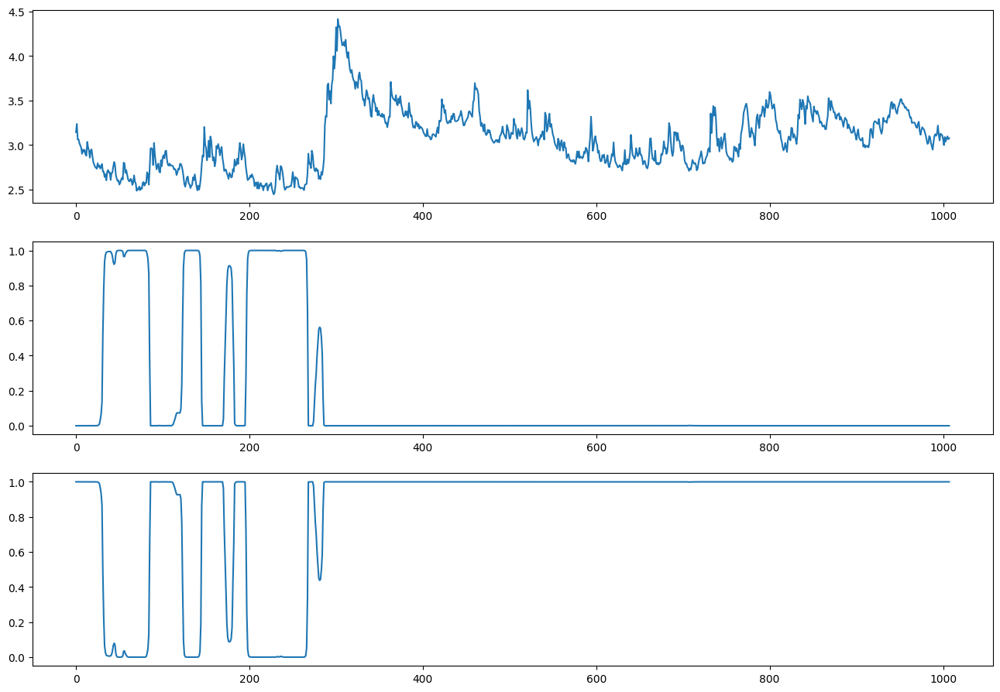


ite=40, max(diff) = 0.13683942104973168

mu_hat0 = [2.6032 3.138 ], 
sigma_hat0 = [0.0786 0.289 ], 
P_hat0 = 
[[0.9707 0.0293]
 [0.0055 0.9945]], 
pi_hat0 = [0. 1.]



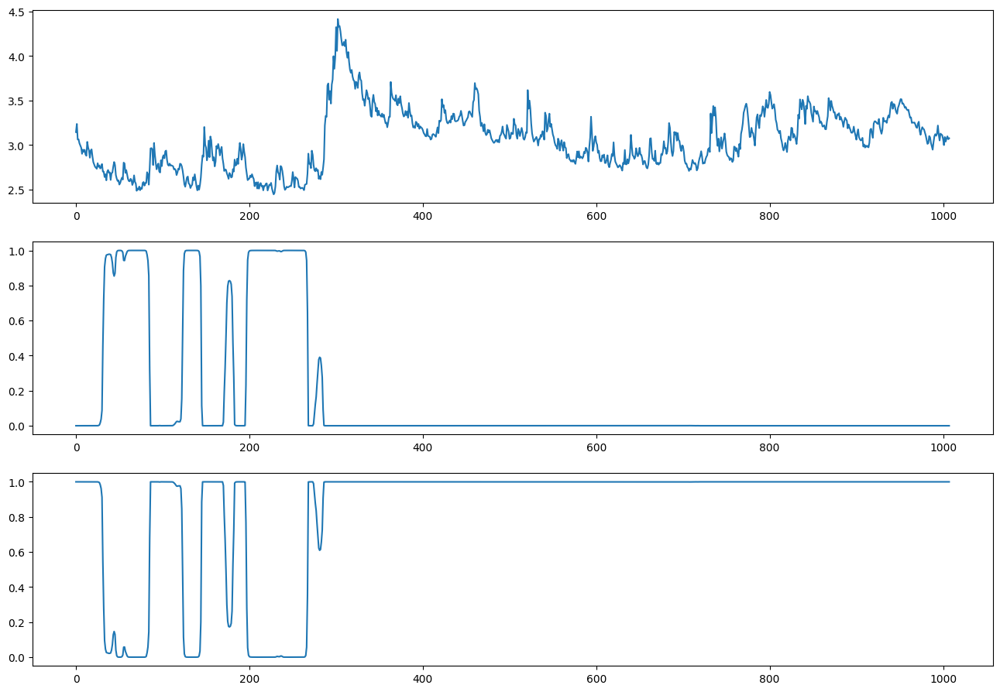


ite=41, max(diff) = 0.21928661307104846

mu_hat0 = [2.6006 3.1359], 
sigma_hat0 = [0.0777 0.2899], 
P_hat0 = 
[[0.9711 0.0289]
 [0.0052 0.9948]], 
pi_hat0 = [0. 1.]



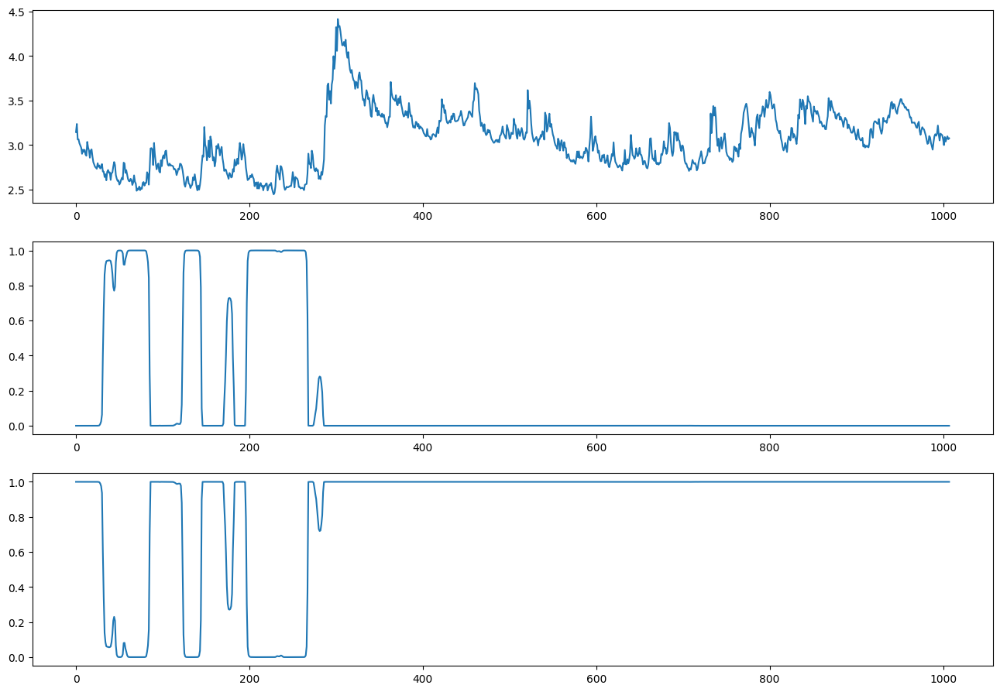


ite=42, max(diff) = 0.15466479642193043

mu_hat0 = [2.5986 3.1342], 
sigma_hat0 = [0.0769 0.2907], 
P_hat0 = 
[[0.9713 0.0287]
 [0.0051 0.9949]], 
pi_hat0 = [0. 1.]



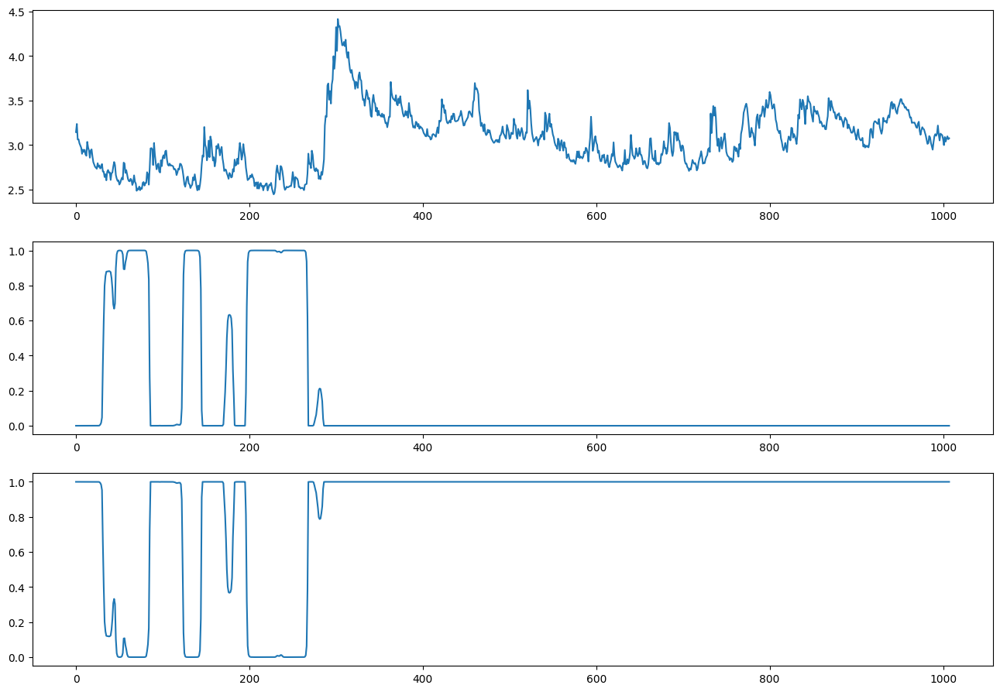


ite=43, max(diff) = 0.05817294778511746

mu_hat0 = [2.5968 3.1327], 
sigma_hat0 = [0.0762 0.2914], 
P_hat0 = 
[[0.9714 0.0286]
 [0.0049 0.9951]], 
pi_hat0 = [0. 1.]



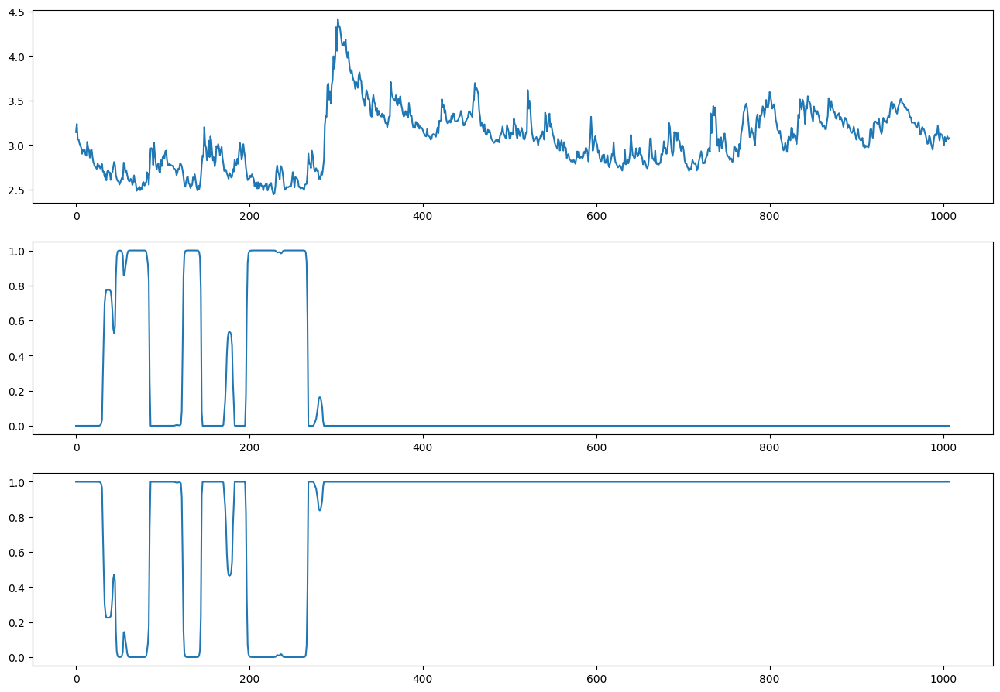


ite=44, max(diff) = 0.12008544048044746

mu_hat0 = [2.5945 3.1309], 
sigma_hat0 = [0.0752 0.2921], 
P_hat0 = 
[[0.9712 0.0288]
 [0.0048 0.9952]], 
pi_hat0 = [0. 1.]



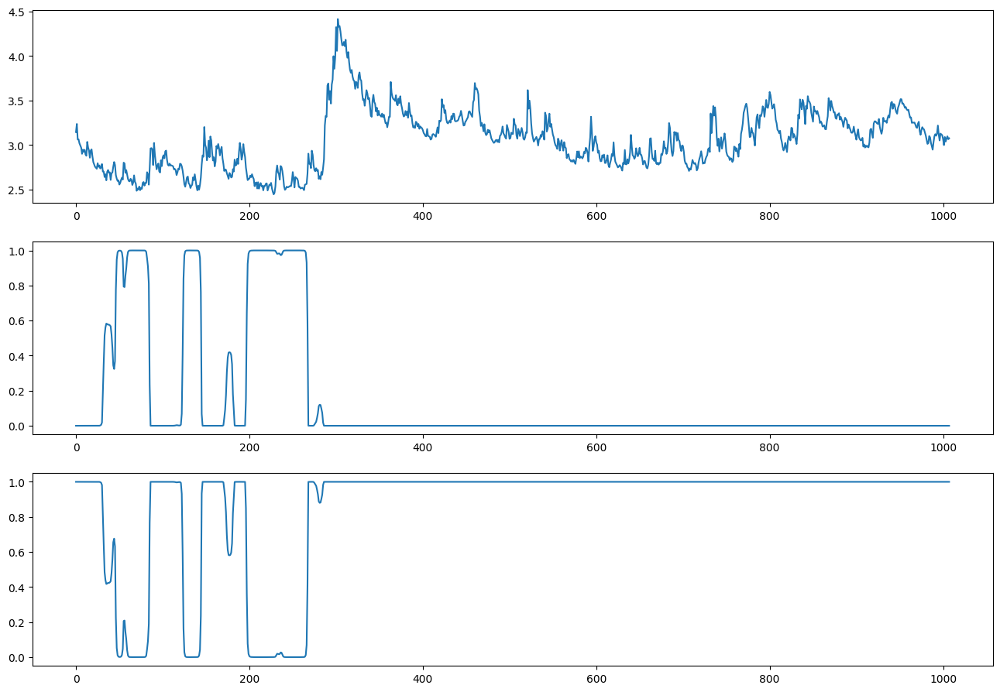


ite=45, max(diff) = 0.24212128974554312

mu_hat0 = [2.5912 3.1285], 
sigma_hat0 = [0.0736 0.2932], 
P_hat0 = 
[[0.9707 0.0293]
 [0.0047 0.9953]], 
pi_hat0 = [0. 1.]



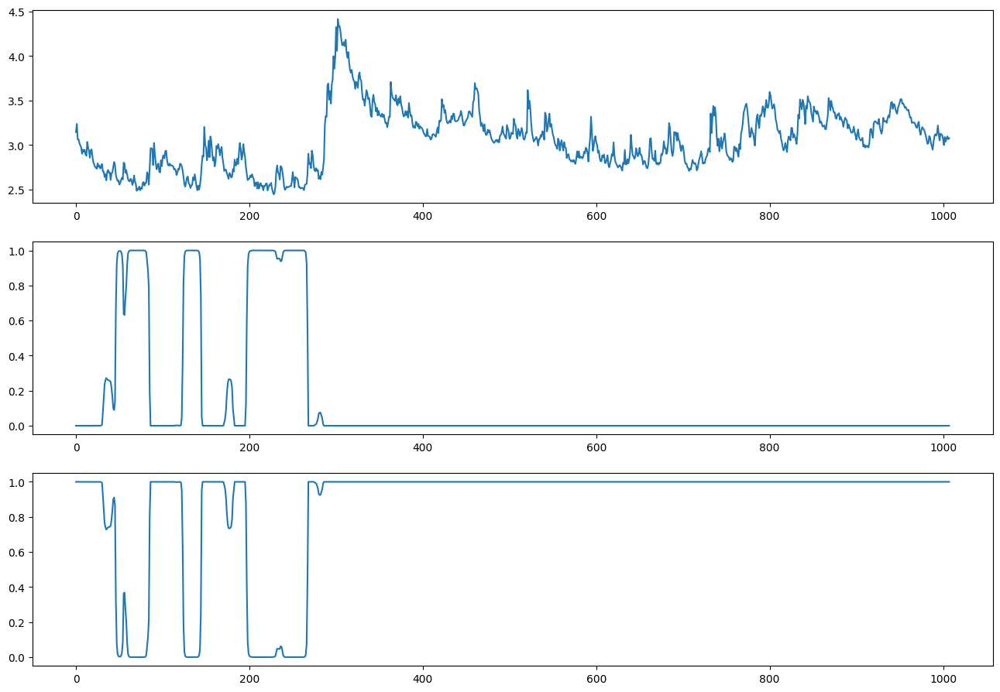


ite=46, max(diff) = 0.43638528915963143

mu_hat0 = [2.5859 3.1249], 
sigma_hat0 = [0.0707 0.2947], 
P_hat0 = 
[[0.9698 0.0302]
 [0.0046 0.9954]], 
pi_hat0 = [0. 1.]



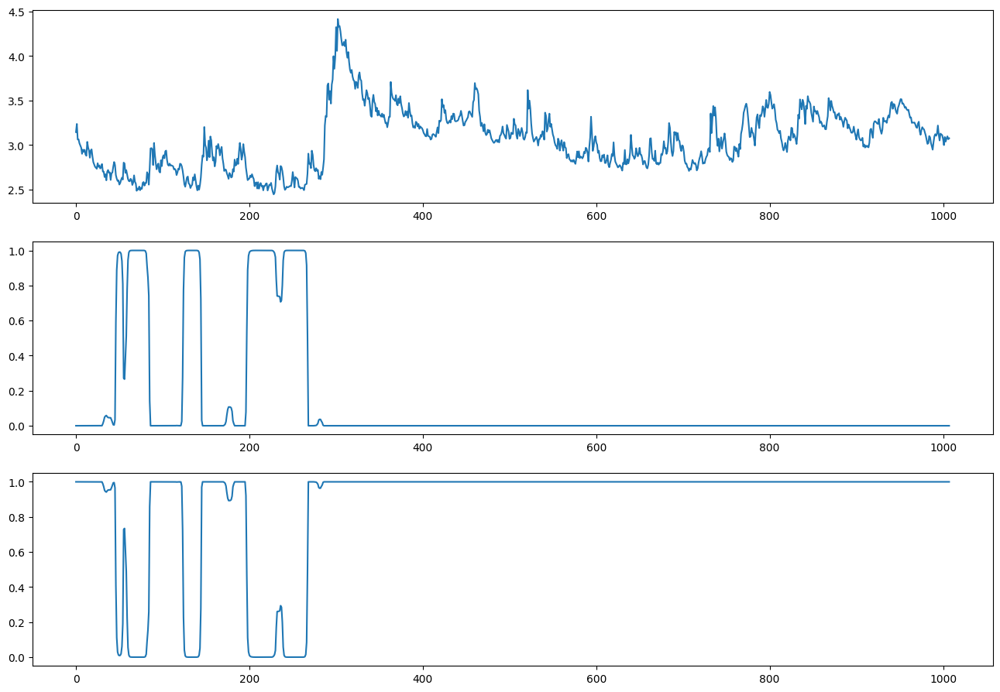


ite=47, max(diff) = 1.8099219801612

mu_hat0 = [2.579  3.1209], 
sigma_hat0 = [0.0655 0.2962], 
P_hat0 = 
[[0.9658 0.0342]
 [0.0048 0.9952]], 
pi_hat0 = [0. 1.]



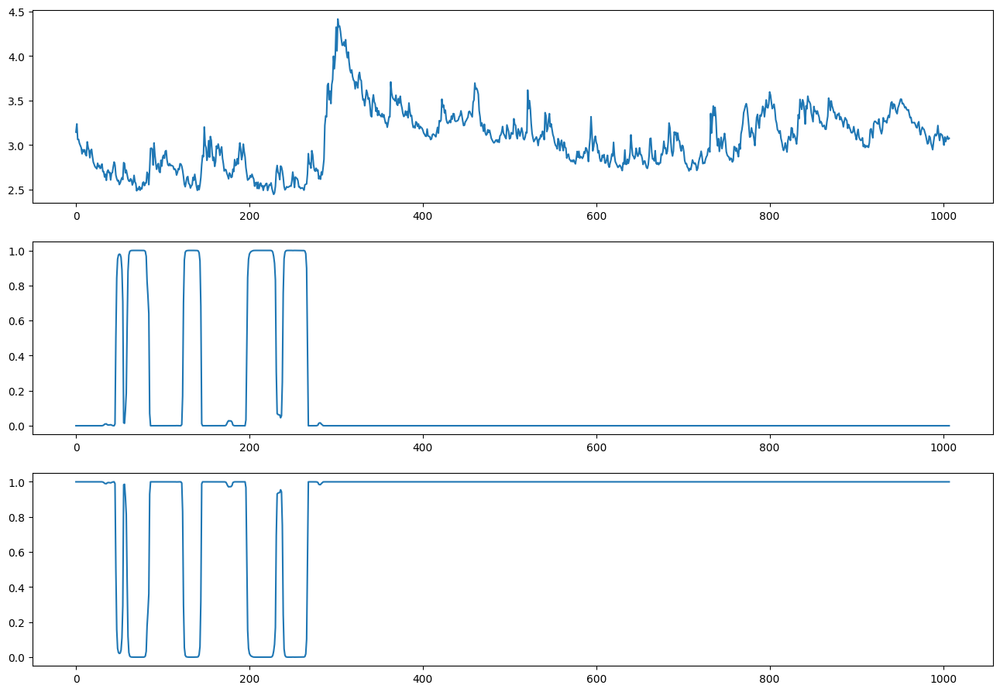


ite=48, max(diff) = 4.039922421830241

mu_hat0 = [2.5697 3.1164], 
sigma_hat0 = [0.0563 0.298 ], 
P_hat0 = 
[[0.9565 0.0435]
 [0.0056 0.9944]], 
pi_hat0 = [0. 1.]



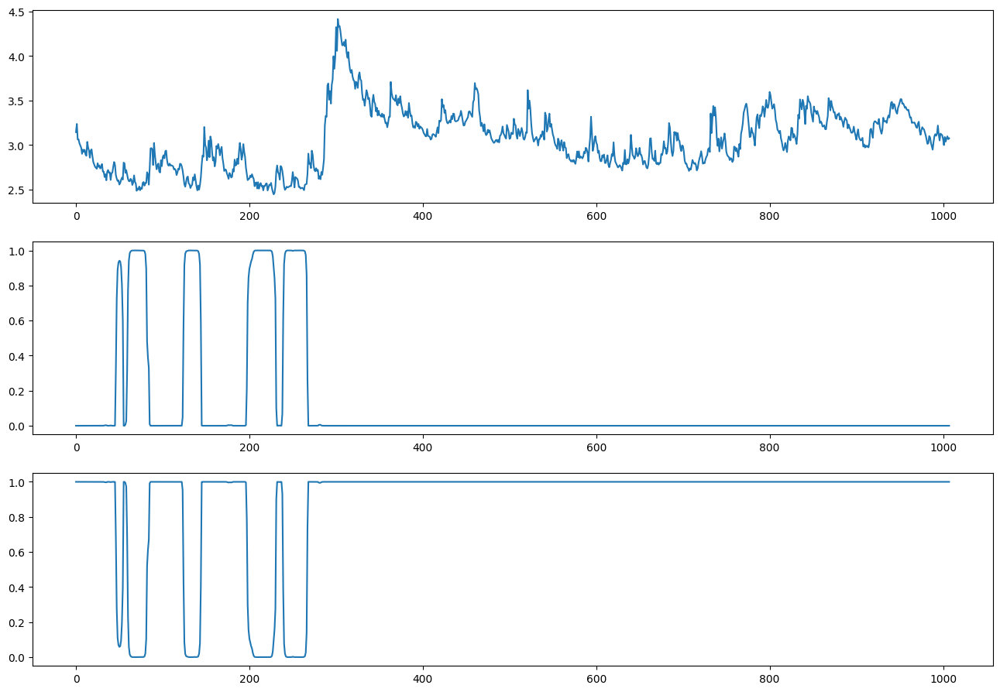


ite=49, max(diff) = 0.7004344296266184

mu_hat0 = [2.5658 3.1135], 
sigma_hat0 = [0.053  0.2994], 
P_hat0 = 
[[0.9546 0.0454]
 [0.0056 0.9944]], 
pi_hat0 = [0. 1.]



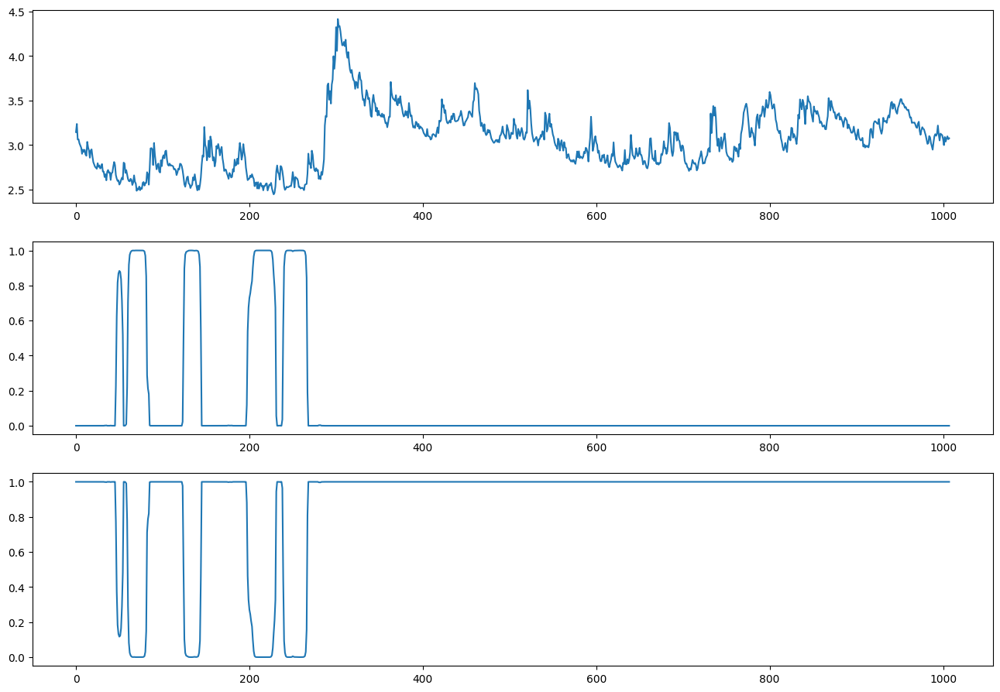


ite=50, max(diff) = 0.33118387074364614

mu_hat0 = [2.564  3.1117], 
sigma_hat0 = [0.0519 0.3003], 
P_hat0 = 
[[0.9538 0.0462]
 [0.0055 0.9945]], 
pi_hat0 = [0. 1.]



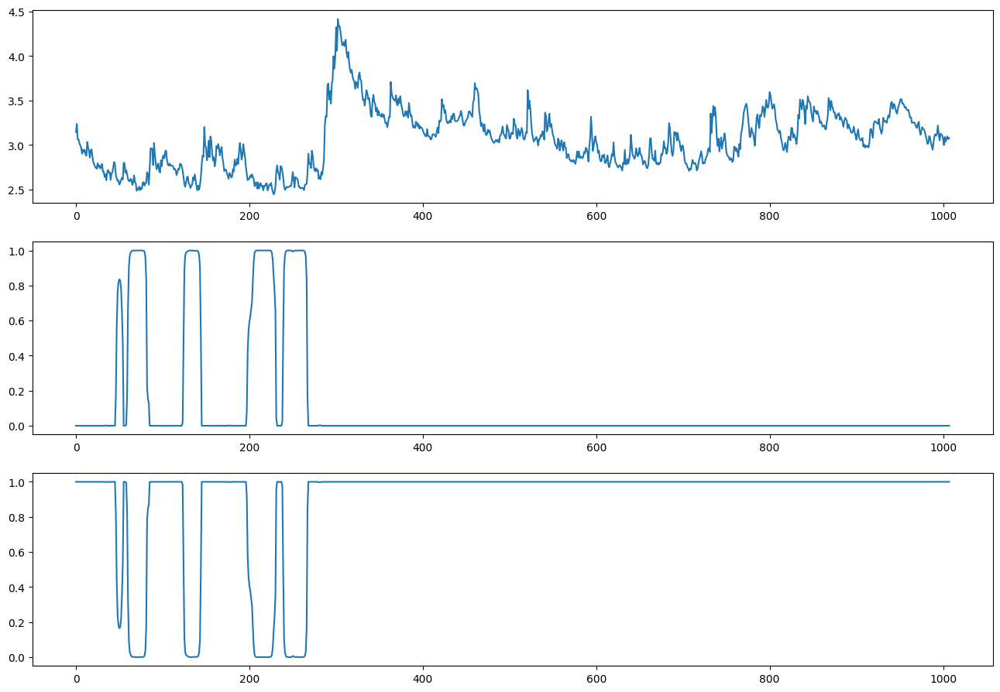


ite=51, max(diff) = 0.17946180740819945

mu_hat0 = [2.5629 3.1106], 
sigma_hat0 = [0.0513 0.3009], 
P_hat0 = 
[[0.9533 0.0467]
 [0.0054 0.9946]], 
pi_hat0 = [0. 1.]



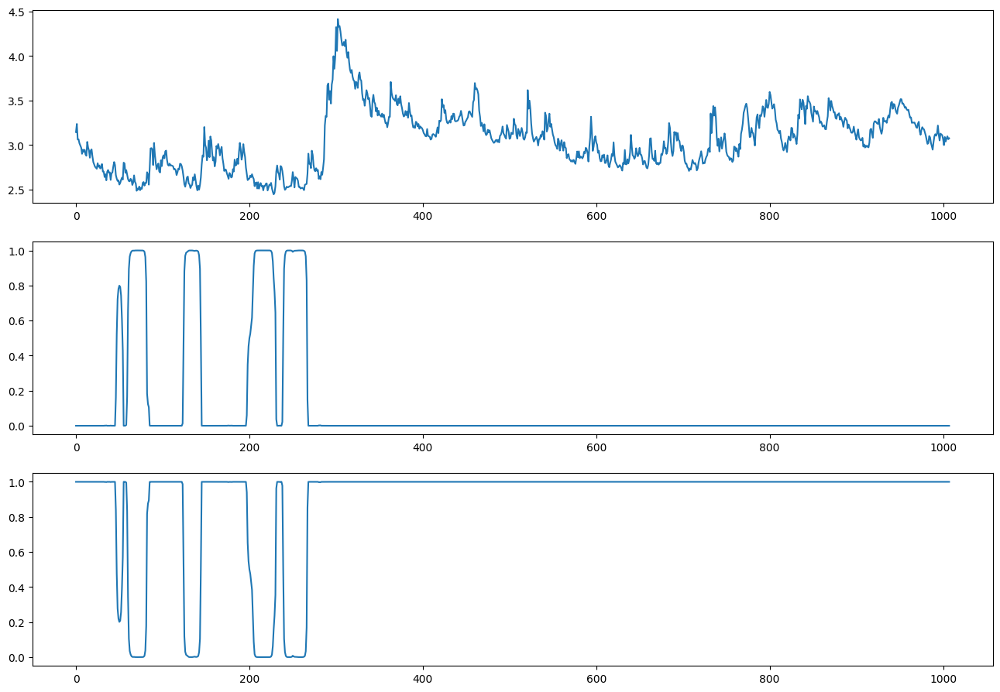


ite=52, max(diff) = 0.10723913990605184

mu_hat0 = [2.5621 3.11  ], 
sigma_hat0 = [0.0509 0.3012], 
P_hat0 = 
[[0.9531 0.0469]
 [0.0054 0.9946]], 
pi_hat0 = [0. 1.]



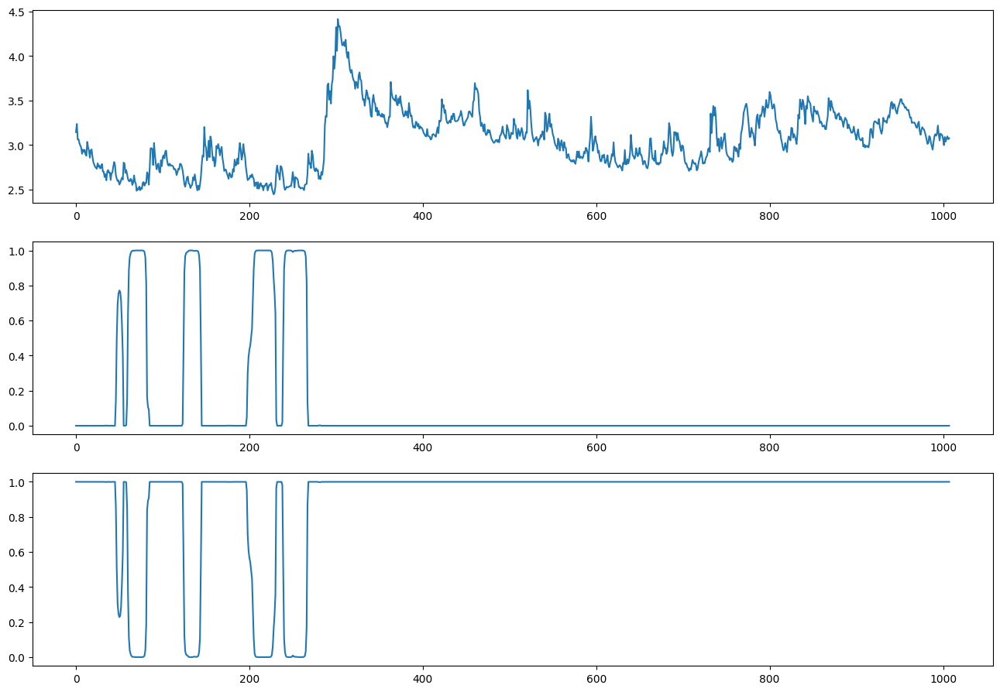


ite=53, max(diff) = 0.06867067973944843

mu_hat0 = [2.5615 3.1095], 
sigma_hat0 = [0.0507 0.3014], 
P_hat0 = 
[[0.9529 0.0471]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



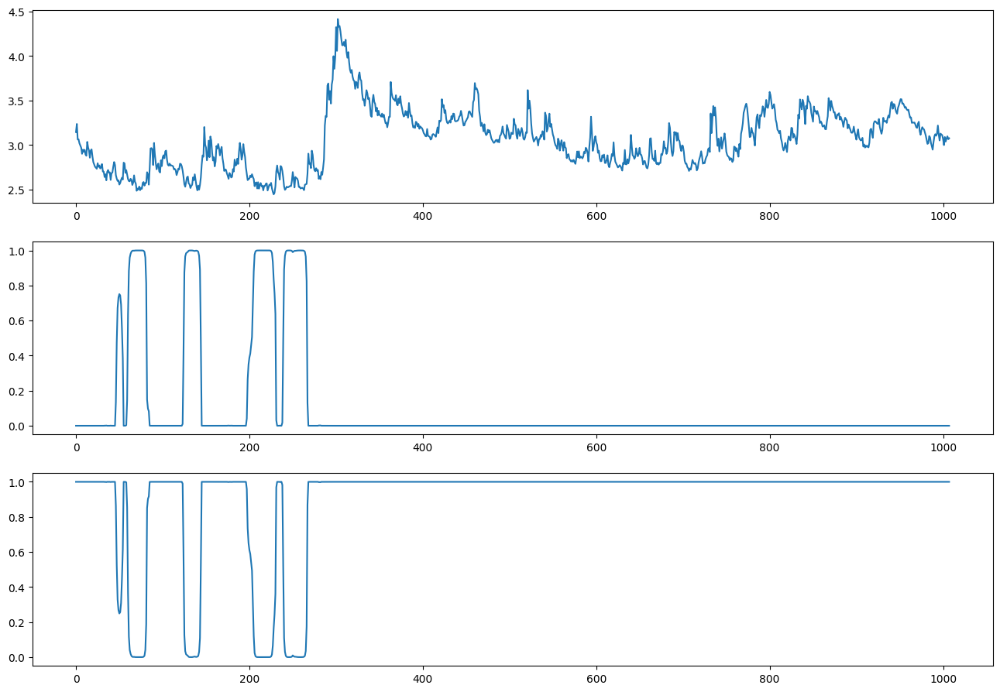


ite=54, max(diff) = 0.04555144889651729

mu_hat0 = [2.5612 3.1091], 
sigma_hat0 = [0.0505 0.3016], 
P_hat0 = 
[[0.9528 0.0472]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



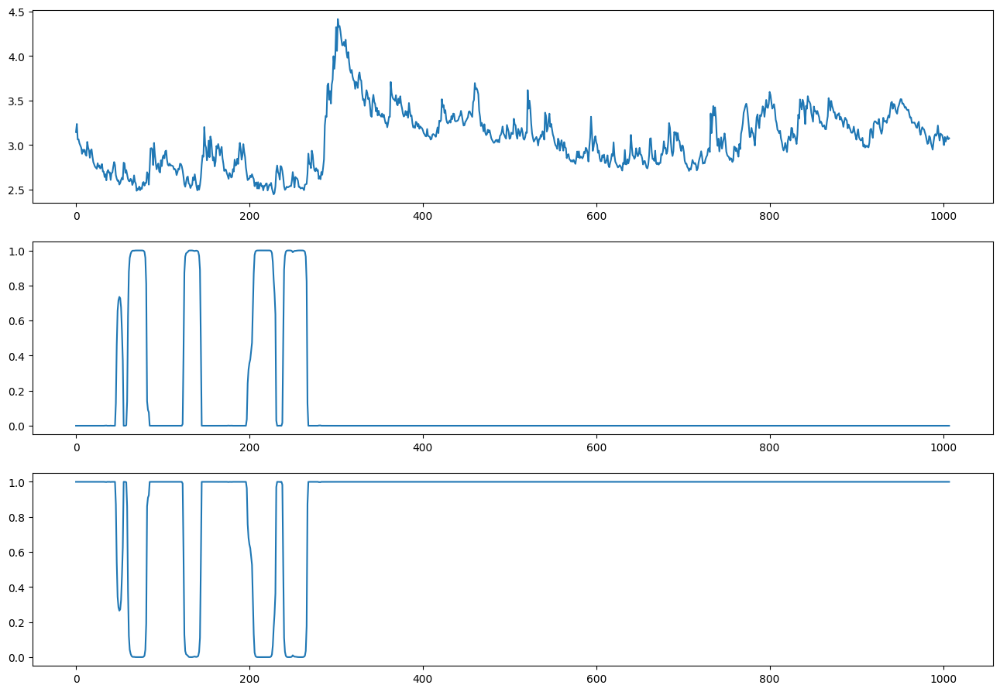


ite=55, max(diff) = 0.030781614161882558

mu_hat0 = [2.5609 3.1089], 
sigma_hat0 = [0.0504 0.3017], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



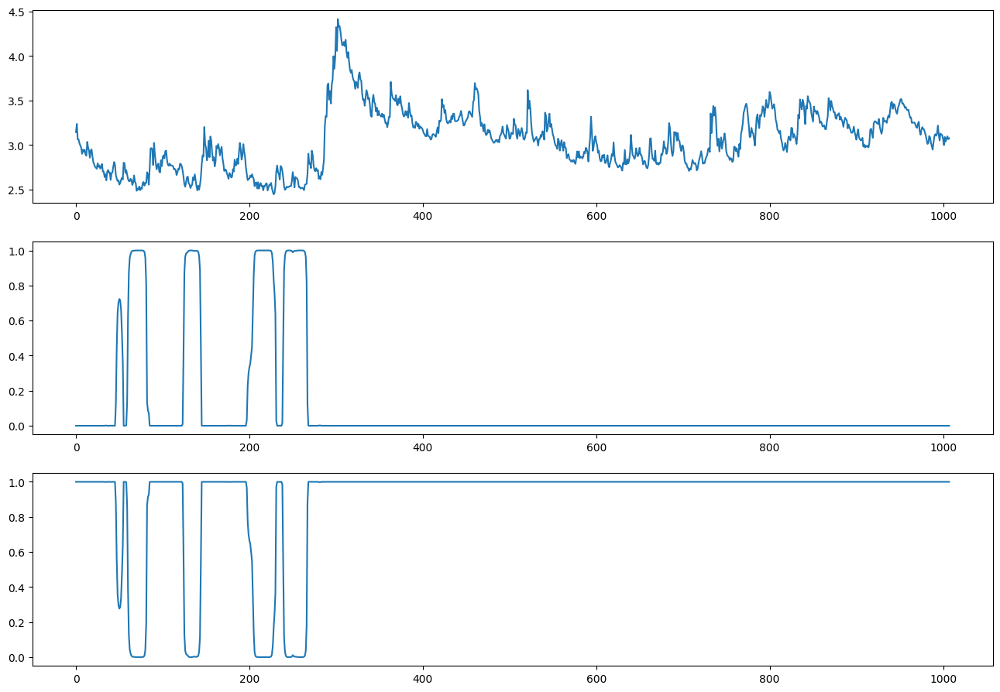


ite=56, max(diff) = 0.02104759137659729

mu_hat0 = [2.5607 3.1087], 
sigma_hat0 = [0.0503 0.3018], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



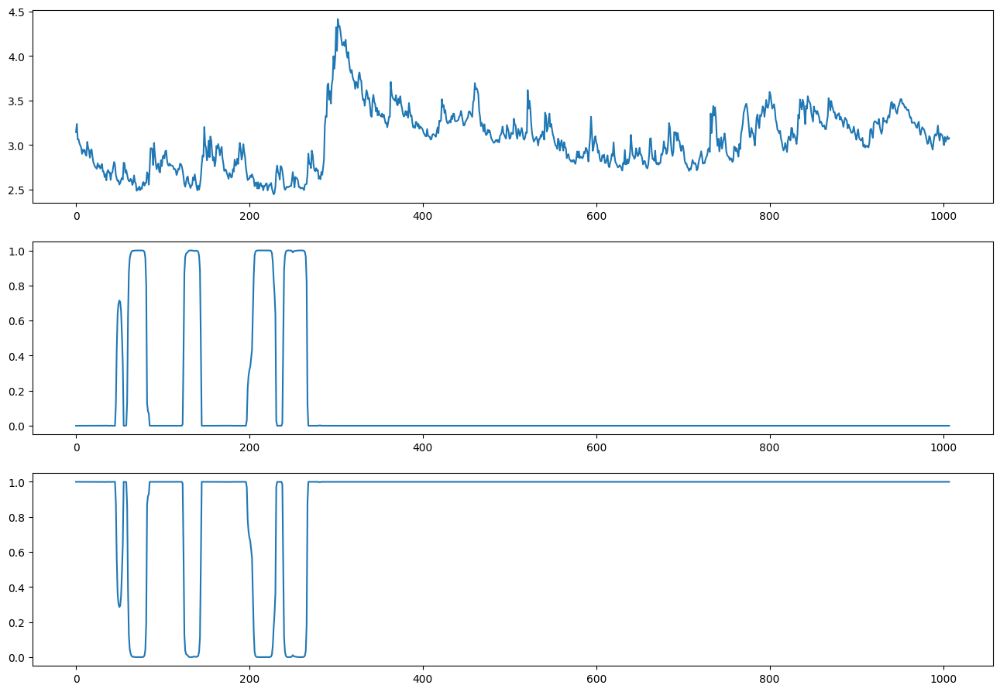


ite=57, max(diff) = 0.014522652765312123

mu_hat0 = [2.5605 3.1086], 
sigma_hat0 = [0.0502 0.3019], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



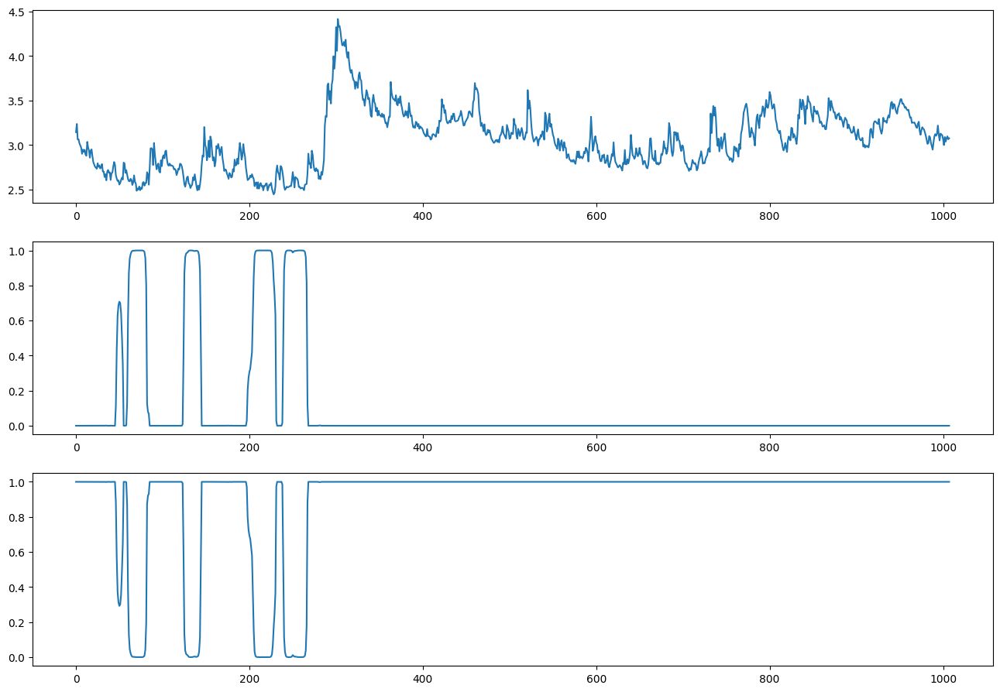


ite=58, max(diff) = 0.01009745951533313

mu_hat0 = [2.5604 3.1085], 
sigma_hat0 = [0.0502 0.3019], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



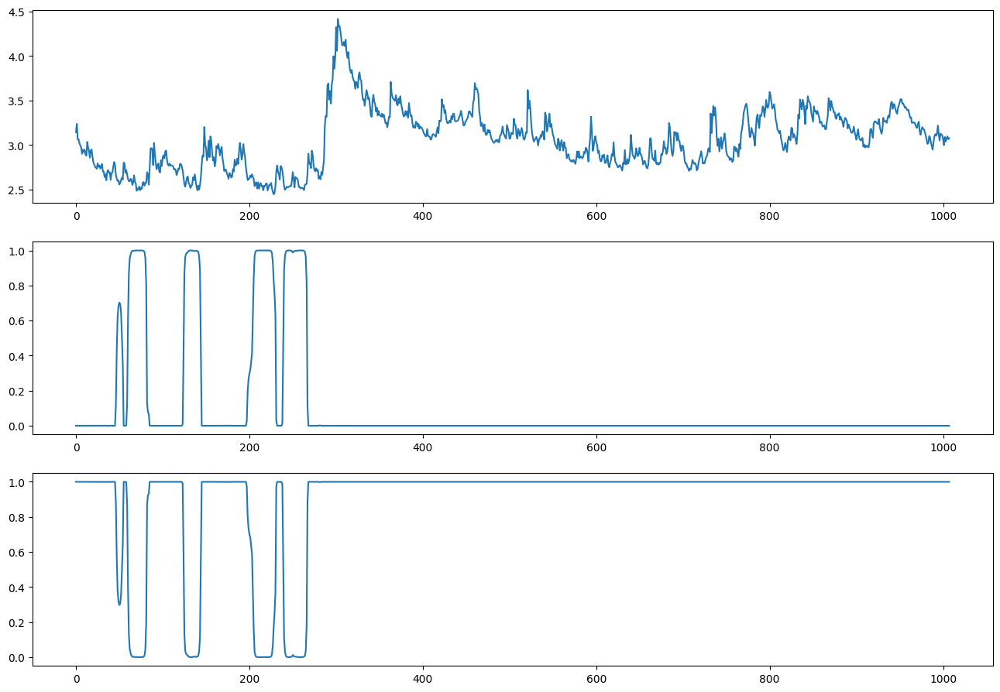


ite=59, max(diff) = 0.007066911442710454

mu_hat1 = [2.5604 3.1084], 
sigma_hat1 = [0.0502 0.302 ], 
P_hat1 = 
[[0.9526 0.0474]
 [0.0052 0.9948]], 
pi_hat1 = [0. 1.]


In [ ]:
#Assume same mu same sigma

# Initialize parameters
T = len(YData)
N = 2

# SET INITIAL GUESSES

mu_hat0 = [2, 4] * np.ones((N))
sigma_hat0 = [0.1, 0.1] * np.ones((N))
P_hat0 = np.zeros((N, N))

P_hat0[0, 0] = 0.85
P_hat0[0, 1] = 1 - P_hat0[0, 0]
P_hat0[1, 1] = 0.90
P_hat0[1, 0] = 1 - P_hat0[1, 1]

pi_hat0 = [0.5, 0.5] * np.ones((N))
for t in range(1, 100):
    pi_hat0 = np.dot(P_hat0.T, pi_hat0)

# Determine maximum number of iterations until convergence and convergence tolerance
itemax = 100
itetol = 1e-2

for ite in range(0, itemax):
    #print(mu_hat0, sigma_hat0, P_hat0, pi_hat0)
    print(f"\nmu_hat0 = {np.round(mu_hat0,4)}, \nsigma_hat0 = {np.round(sigma_hat0,4)}, \nP_hat0 = \n{np.round(P_hat0,4)}, \npi_hat0 = {np.round(pi_hat0,4)}")

    # E-step
    xi_prob_t, xi_prob_t1 = forward_alg(
        pi_hat0, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )
    xi_prob_T = backward_alg(
        xi_prob_t, xi_prob_t1, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )

    print("")

    plt.subplot(3, 1, 1)
    plt.plot(YData)
    plt.subplot(3, 1, 2)
    plt.plot(xi_prob_T[:, 0])
    plt.subplot(3, 1, 3)
    plt.plot(xi_prob_T[:, 1])
    fig = plt.gcf()
    fig.set_size_inches(16, 11)
    plt.show()
    print("")

    # Compute Pr(s_t+1 = j, s_t = i)
    P_hat_T = np.zeros((N, N, T))
    for tt in range(1, T):
        for ss in range(0, N):
            for ss2 in range(0, N):
                P_hat_T[ss, ss2, tt] = (
                    P_hat0[ss, ss2]
                    * xi_prob_t[tt - 1, ss]
                    * xi_prob_T[tt, ss2]
                    / xi_prob_t1[tt - 1, ss2]
                )
    # M-step
    mu_hat1, sigma_hat1, P_hat1, pi_hat1 = M_step_func(xi_prob_T, P_hat_T, N, T, YData)

    diff = np.zeros((4))
    diff[0] = np.sum(np.absolute(mu_hat1 - mu_hat0)) / (np.min(mu_hat0) + itetol * 1e-2)
    diff[1] = np.sum(np.absolute(sigma_hat1 - sigma_hat0)) / (
        np.min(sigma_hat0) + itetol * 1e-2
    )
    diff[2] = np.sum(np.absolute(np.subtract(P_hat1, P_hat0))) / (
        np.min(P_hat0) + itetol * 1e-2
    )
    diff[3] = np.sum(np.absolute(pi_hat1 - pi_hat0)) / (np.min(pi_hat0) + itetol * 1e-2)

    print(f"ite={ite}, max(diff) = {np.max(diff)}")

    if np.max(diff) > itetol:
        mu_hat0, sigma_hat0, P_hat0, pi_hat0 = mu_hat1, sigma_hat1, P_hat1, pi_hat1
    else:
        print(f"\nmu_hat1 = {np.round(mu_hat1,4)}, \nsigma_hat1 = {np.round(sigma_hat1,4)}, \nP_hat1 = \n{np.round(P_hat1,4)}, \npi_hat1 = {np.round(pi_hat1,4)}")
        break

### Different mu same sigma converged and result can serve as a regime detector.

## STEP 2.b.iii Different sigmas same mu


mu_hat0 = [2. 2.], 
sigma_hat0 = [0.3 0.4], 
P_hat0 = 
[[0.85 0.15]
 [0.1  0.9 ]], 
pi_hat0 = [0.4 0.6]



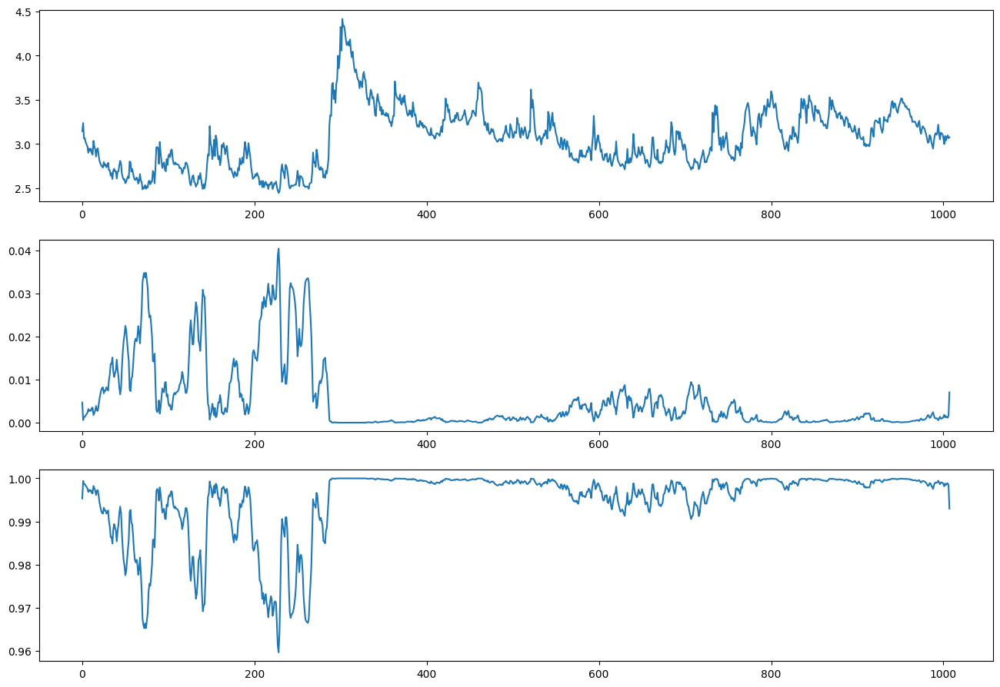


ite=0, max(diff) = 12.475128901455596

mu_hat0 = [2.6799 3.0557], 
sigma_hat0 = [0.1782 0.3301], 
P_hat0 = 
[[0.3221 0.6779]
 [0.0035 0.9965]], 
pi_hat0 = [0.0047 0.9953]



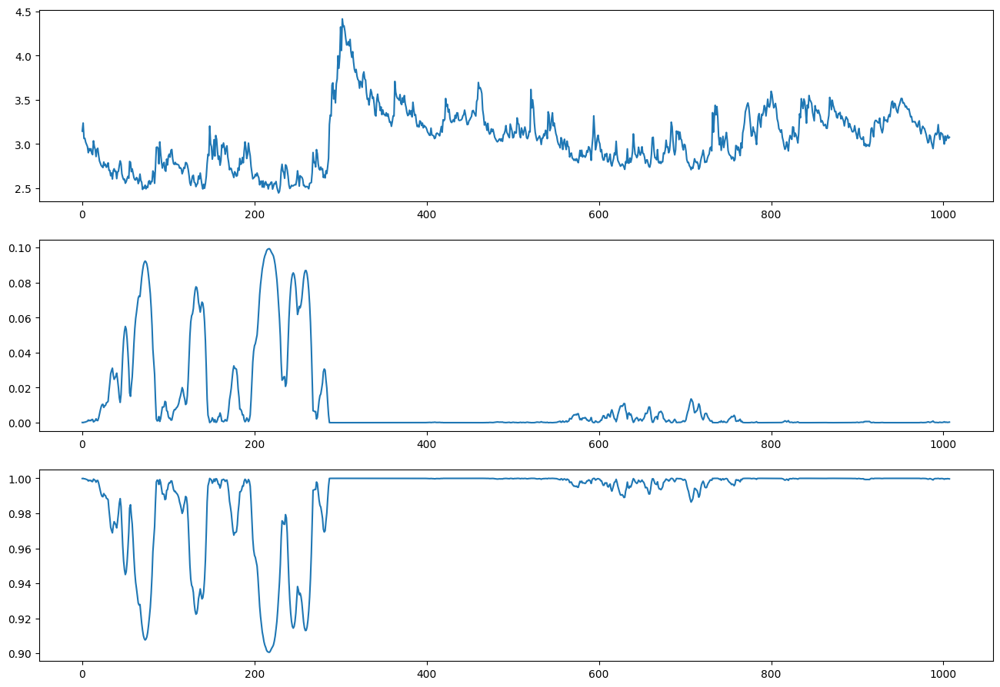


ite=1, max(diff) = 191.65963586304932

mu_hat0 = [2.6048 3.0586], 
sigma_hat0 = [0.102  0.3289], 
P_hat0 = 
[[0.6647 0.3353]
 [0.0036 0.9964]], 
pi_hat0 = [1.000e-04 9.999e-01]



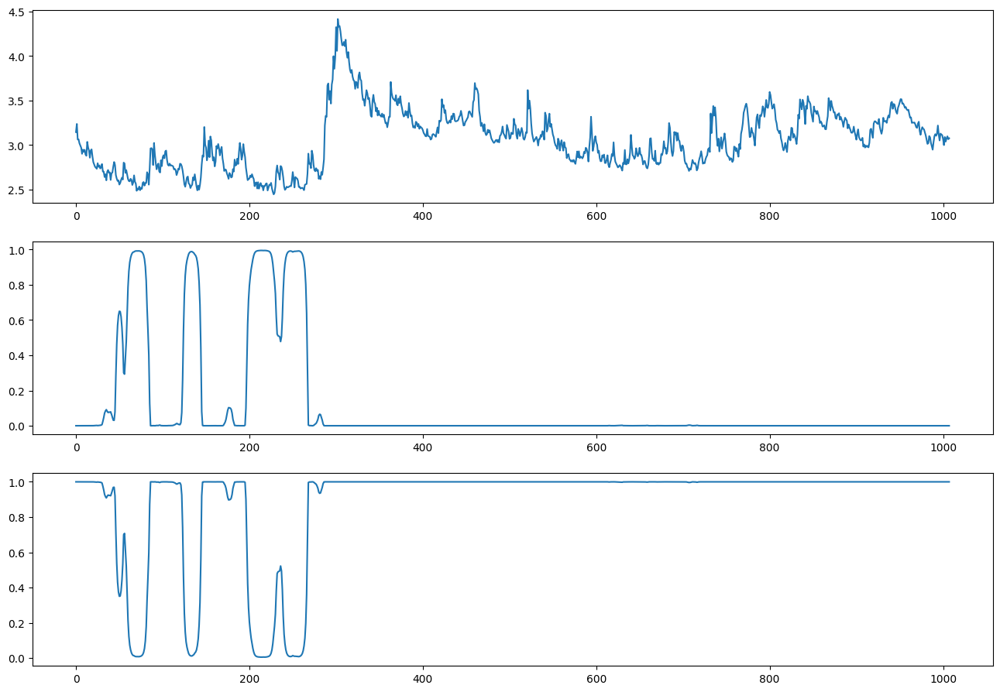


ite=2, max(diff) = 160.36770494009158

mu_hat0 = [2.5767 3.1142], 
sigma_hat0 = [0.0657 0.3002], 
P_hat0 = 
[[0.9578 0.0422]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



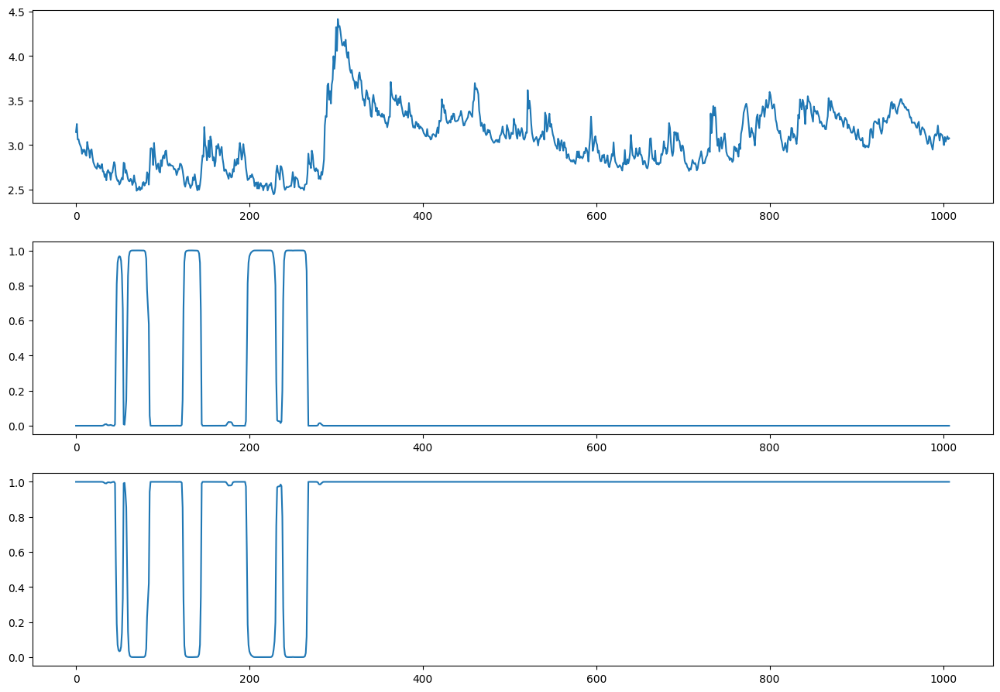


ite=3, max(diff) = 0.8505620421391517

mu_hat0 = [2.5687 3.1156], 
sigma_hat0 = [0.0554 0.2984], 
P_hat0 = 
[[0.9558 0.0442]
 [0.0056 0.9944]], 
pi_hat0 = [0. 1.]



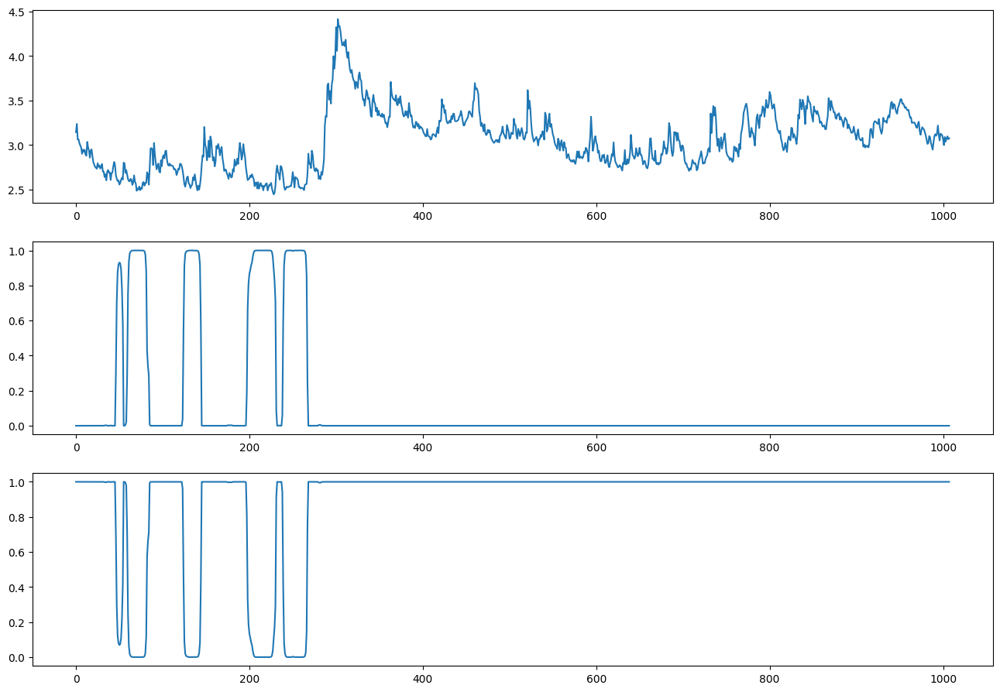


ite=4, max(diff) = 0.5261681774350212

mu_hat0 = [2.5654 3.1131], 
sigma_hat0 = [0.0527 0.2996], 
P_hat0 = 
[[0.9544 0.0456]
 [0.0055 0.9945]], 
pi_hat0 = [0. 1.]



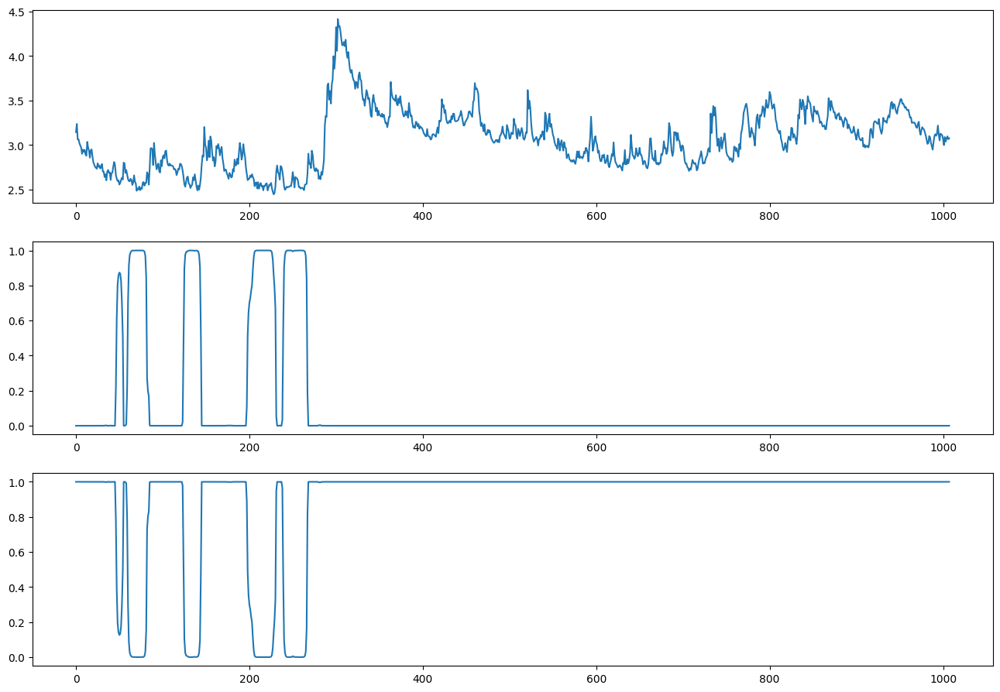


ite=5, max(diff) = 0.2942807591066436

mu_hat0 = [2.5637 3.1115], 
sigma_hat0 = [0.0517 0.3004], 
P_hat0 = 
[[0.9537 0.0463]
 [0.0055 0.9945]], 
pi_hat0 = [0. 1.]



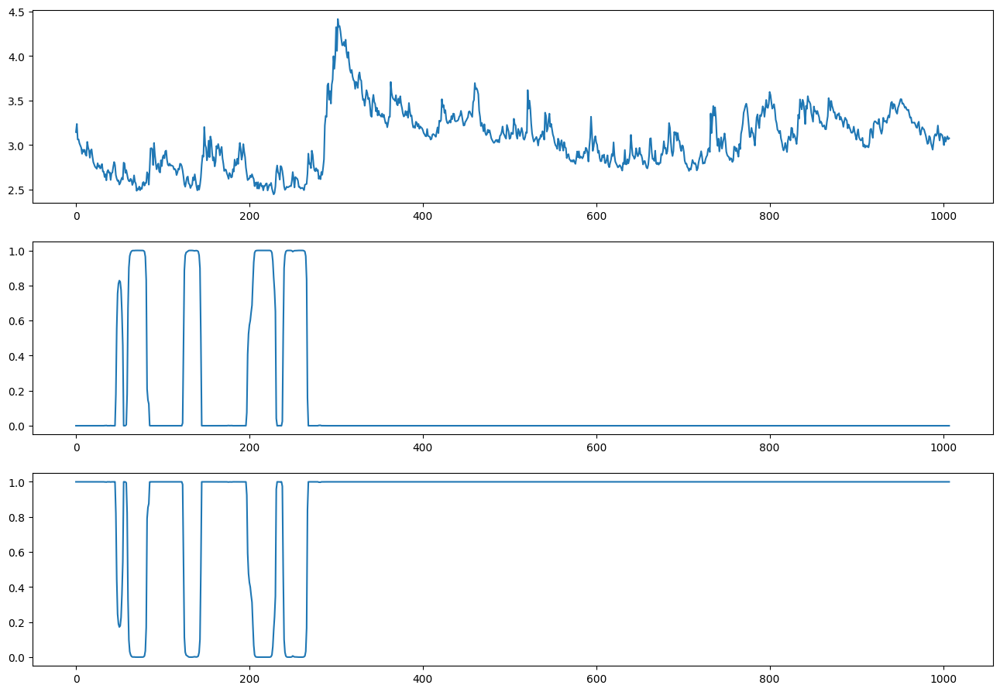


ite=6, max(diff) = 0.1626893463804627

mu_hat0 = [2.5627 3.1105], 
sigma_hat0 = [0.0512 0.3009], 
P_hat0 = 
[[0.9533 0.0467]
 [0.0054 0.9946]], 
pi_hat0 = [0. 1.]



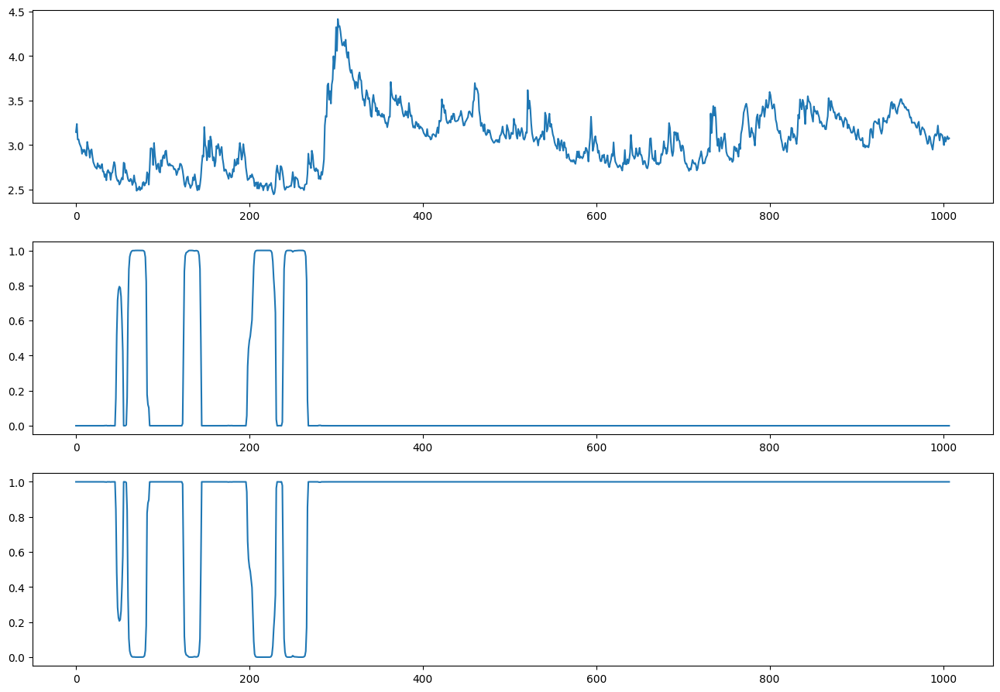


ite=7, max(diff) = 0.09869241853981955

mu_hat0 = [2.562  3.1099], 
sigma_hat0 = [0.0509 0.3013], 
P_hat0 = 
[[0.953  0.047 ]
 [0.0054 0.9946]], 
pi_hat0 = [0. 1.]



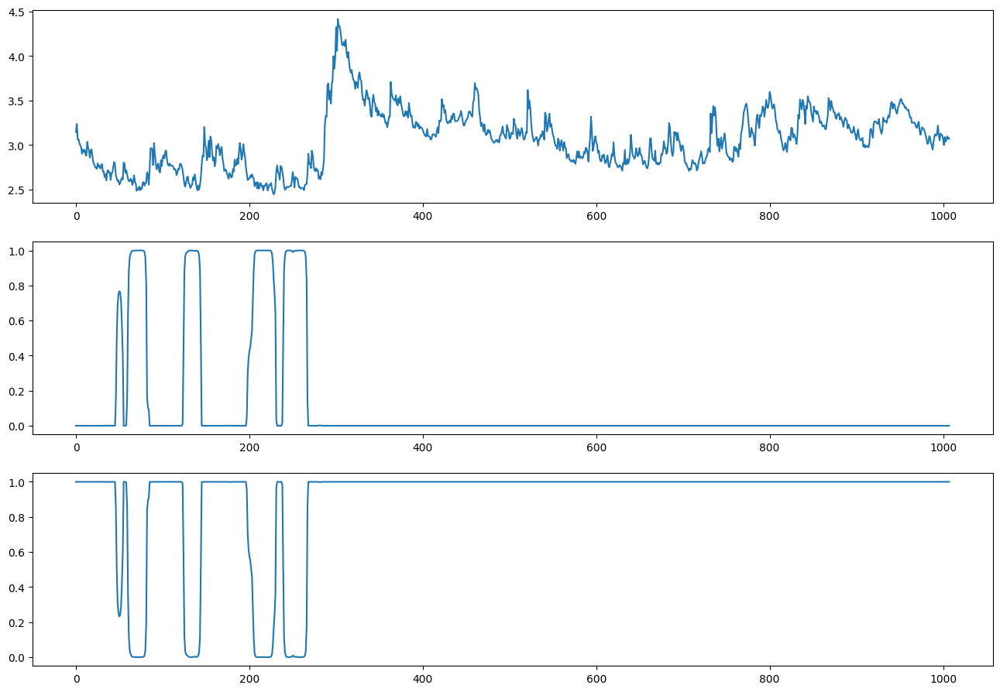


ite=8, max(diff) = 0.06371167300498583

mu_hat0 = [2.5615 3.1094], 
sigma_hat0 = [0.0507 0.3015], 
P_hat0 = 
[[0.9529 0.0471]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



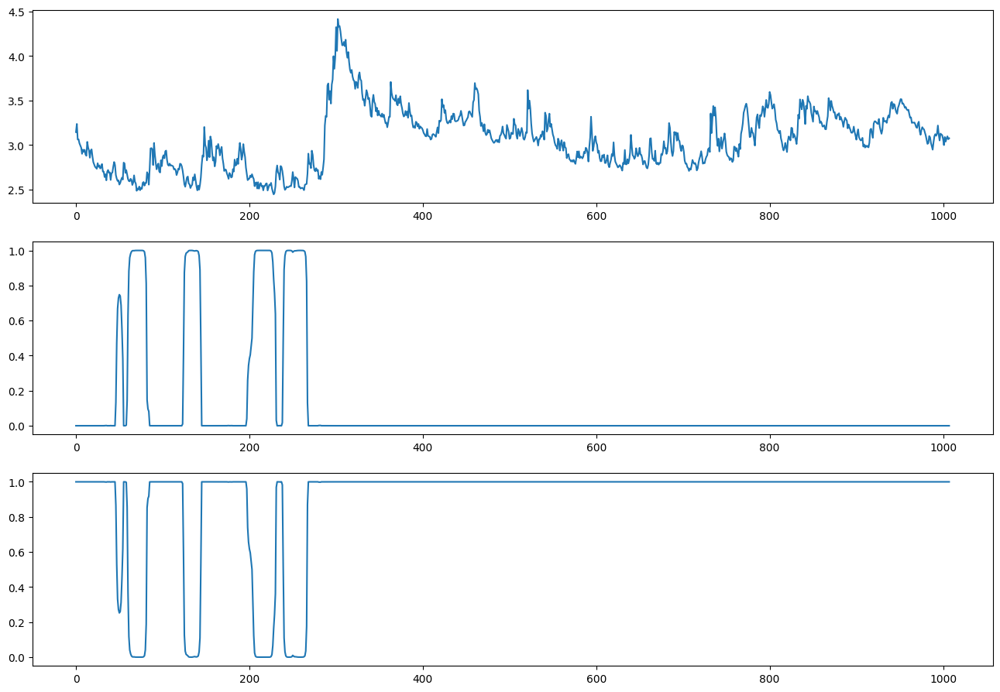


ite=9, max(diff) = 0.042435868335715825

mu_hat0 = [2.5611 3.1091], 
sigma_hat0 = [0.0505 0.3016], 
P_hat0 = 
[[0.9528 0.0472]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



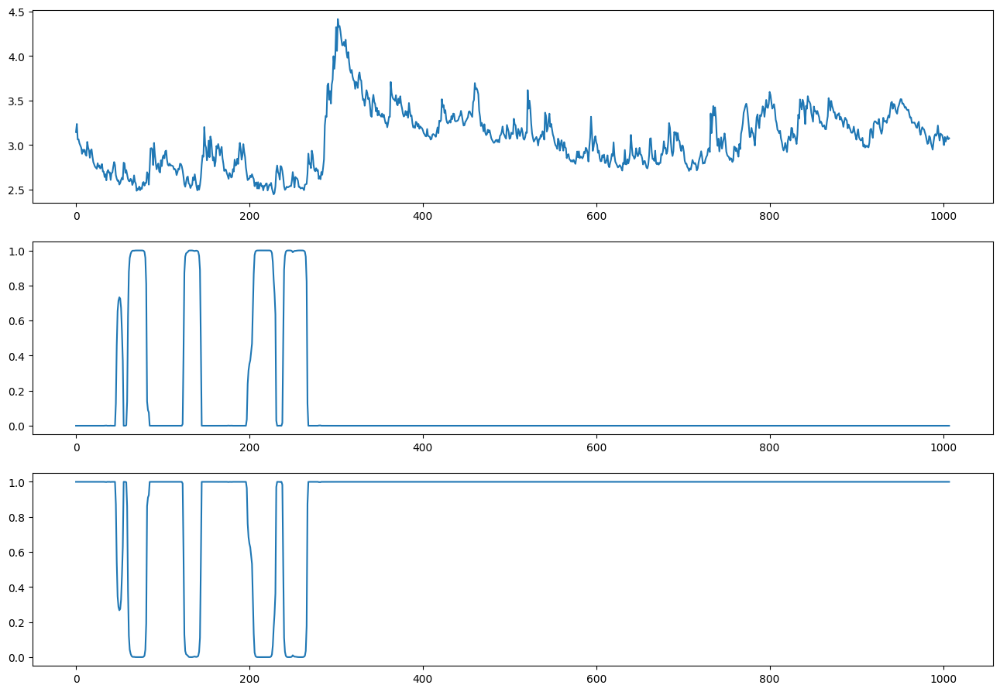


ite=10, max(diff) = 0.028745709071408203

mu_hat0 = [2.5608 3.1089], 
sigma_hat0 = [0.0504 0.3018], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



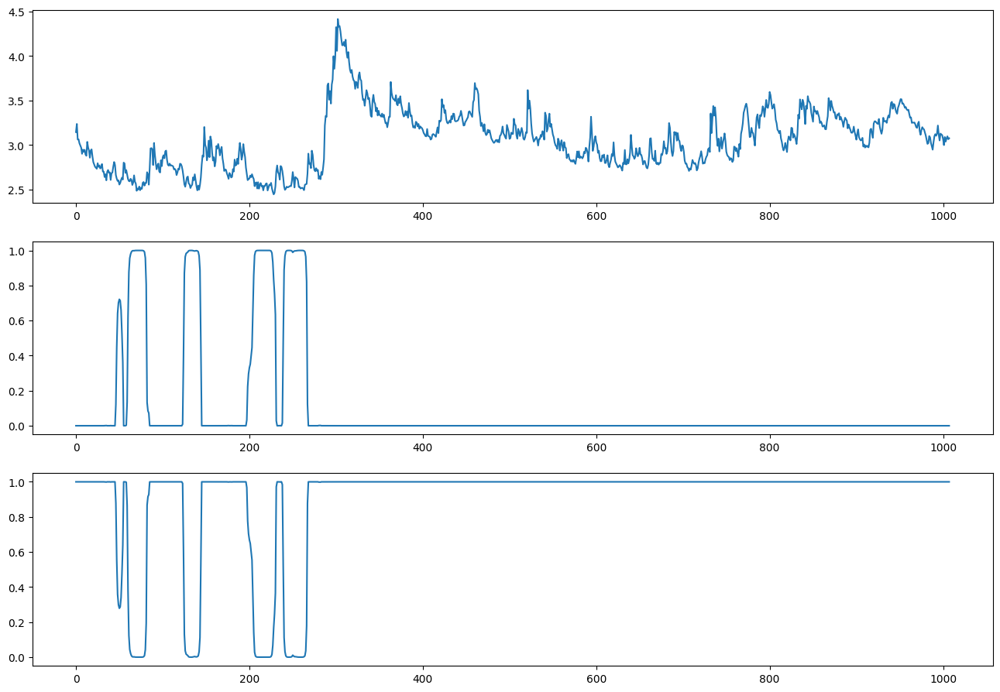


ite=11, max(diff) = 0.019689945008500465

mu_hat0 = [2.5607 3.1087], 
sigma_hat0 = [0.0503 0.3018], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



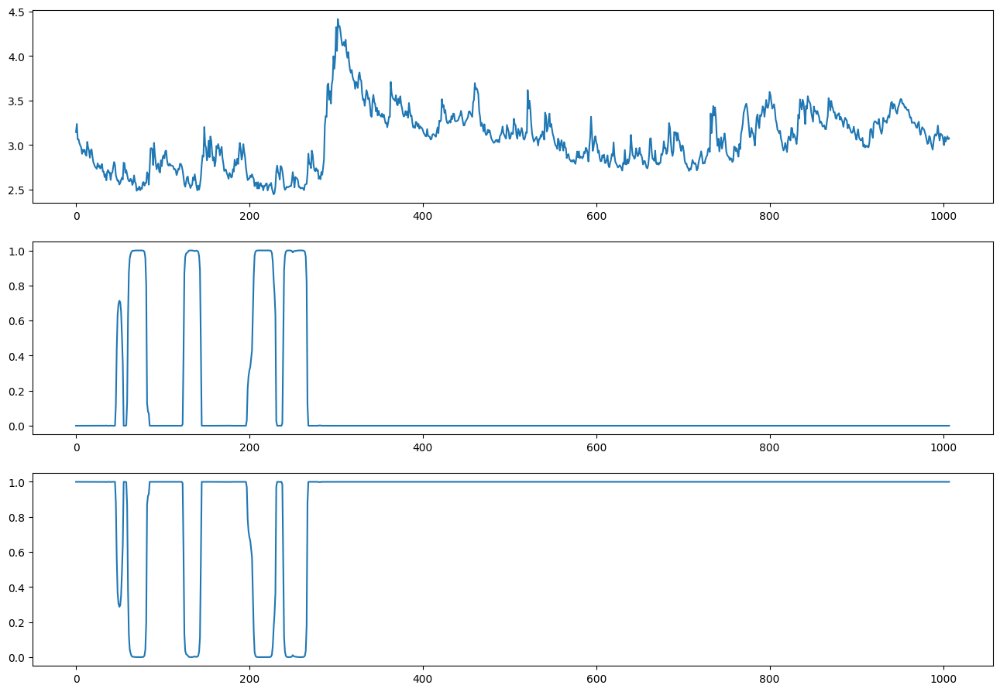


ite=12, max(diff) = 0.013605577001323125

mu_hat0 = [2.5605 3.1086], 
sigma_hat0 = [0.0502 0.3019], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



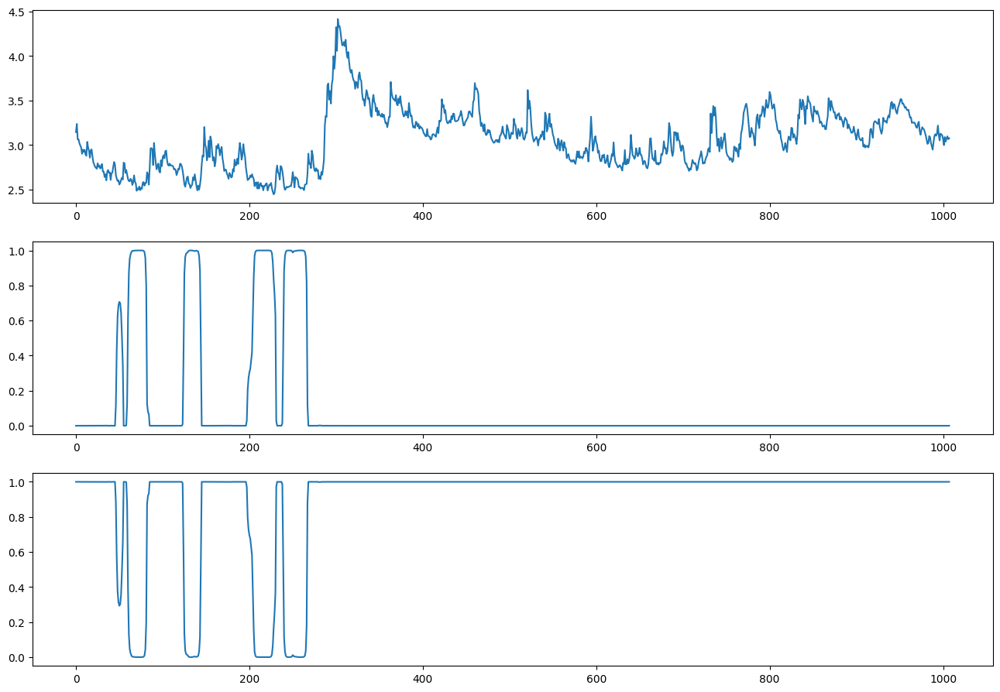


ite=13, max(diff) = 0.009471618759260189

mu_hat1 = [2.5604 3.1085], 
sigma_hat1 = [0.0502 0.3019], 
P_hat1 = 
[[0.9527 0.0473]
 [0.0052 0.9948]], 
pi_hat1 = [0. 1.]


In [ ]:
#Assume same mu different sigma
# Initialize parameters
T = len(YData)
N = 2

# SET INITIAL GUESSES

mu_hat0 = [2, 2] * np.ones((N))
sigma_hat0 = [0.3, 0.4] * np.ones((N))
P_hat0 = np.zeros((N, N))

P_hat0[0, 0] = 0.85
P_hat0[0, 1] = 1 - P_hat0[0, 0]
P_hat0[1, 1] = 0.90
P_hat0[1, 0] = 1 - P_hat0[1, 1]

pi_hat0 = [0.5, 0.5] * np.ones((N))
for t in range(1, 100):
    pi_hat0 = np.dot(P_hat0.T, pi_hat0)

# Determine maximum number of iterations until convergence and convergence tolerance
itemax = 100
itetol = 1e-2

for ite in range(0, itemax):
    #print(mu_hat0, sigma_hat0, P_hat0, pi_hat0)
    print(f"\nmu_hat0 = {np.round(mu_hat0,4)}, \nsigma_hat0 = {np.round(sigma_hat0,4)}, \nP_hat0 = \n{np.round(P_hat0,4)}, \npi_hat0 = {np.round(pi_hat0,4)}")

    # E-step
    xi_prob_t, xi_prob_t1 = forward_alg(
        pi_hat0, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )
    xi_prob_T = backward_alg(
        xi_prob_t, xi_prob_t1, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )

    print("")

    plt.subplot(3, 1, 1)
    plt.plot(YData)
    plt.subplot(3, 1, 2)
    plt.plot(xi_prob_T[:, 0])
    plt.subplot(3, 1, 3)
    plt.plot(xi_prob_T[:, 1])
    fig = plt.gcf()
    fig.set_size_inches(16, 11)
    plt.show()
    print("")

    # Compute Pr(s_t+1 = j, s_t = i)
    P_hat_T = np.zeros((N, N, T))
    for tt in range(1, T):
        for ss in range(0, N):
            for ss2 in range(0, N):
                P_hat_T[ss, ss2, tt] = (
                    P_hat0[ss, ss2]
                    * xi_prob_t[tt - 1, ss]
                    * xi_prob_T[tt, ss2]
                    / xi_prob_t1[tt - 1, ss2]
                )
    # M-step
    mu_hat1, sigma_hat1, P_hat1, pi_hat1 = M_step_func(xi_prob_T, P_hat_T, N, T, YData)

    diff = np.zeros((4))
    diff[0] = np.sum(np.absolute(mu_hat1 - mu_hat0)) / (np.min(mu_hat0) + itetol * 1e-2)
    diff[1] = np.sum(np.absolute(sigma_hat1 - sigma_hat0)) / (
        np.min(sigma_hat0) + itetol * 1e-2
    )
    diff[2] = np.sum(np.absolute(np.subtract(P_hat1, P_hat0))) / (
        np.min(P_hat0) + itetol * 1e-2
    )
    diff[3] = np.sum(np.absolute(pi_hat1 - pi_hat0)) / (np.min(pi_hat0) + itetol * 1e-2)

    print(f"ite={ite}, max(diff) = {np.max(diff)}")

    if np.max(diff) > itetol:
        mu_hat0, sigma_hat0, P_hat0, pi_hat0 = mu_hat1, sigma_hat1, P_hat1, pi_hat1
    else:
        print(f"\nmu_hat1 = {np.round(mu_hat1,4)}, \nsigma_hat1 = {np.round(sigma_hat1,4)}, \nP_hat1 = \n{np.round(P_hat1,4)}, \npi_hat1 = {np.round(pi_hat1,4)}")
        break

### different sigma same mu converged but did not behave well, this cannot be used as a regime detector.


mu_hat0 = [2. 2.], 
sigma_hat0 = [0.1 0.2], 
P_hat0 = 
[[0.85 0.15]
 [0.1  0.9 ]], 
pi_hat0 = [0.4 0.6]



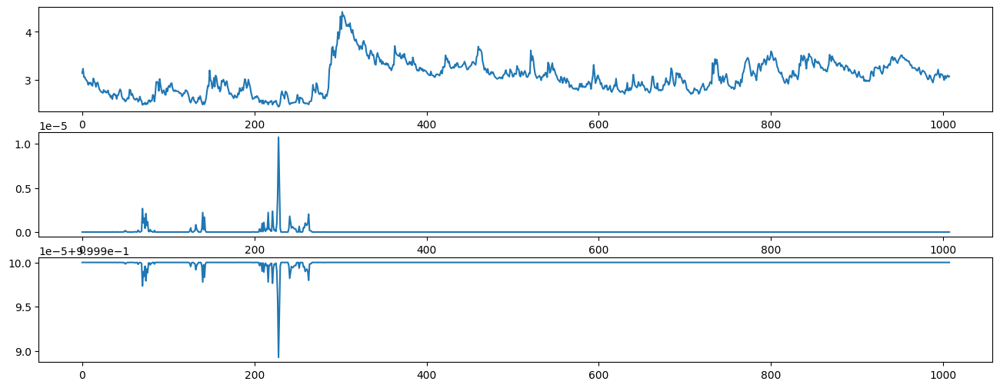


ite=0, max(diff) = 18.978847514835294

mu_hat0 = [2.4955 3.0538], 
sigma_hat0 = [0.0343 0.3306], 
P_hat0 = 
[[1.000e-04 9.999e-01]
 [0.000e+00 1.000e+00]], 
pi_hat0 = [0. 1.]



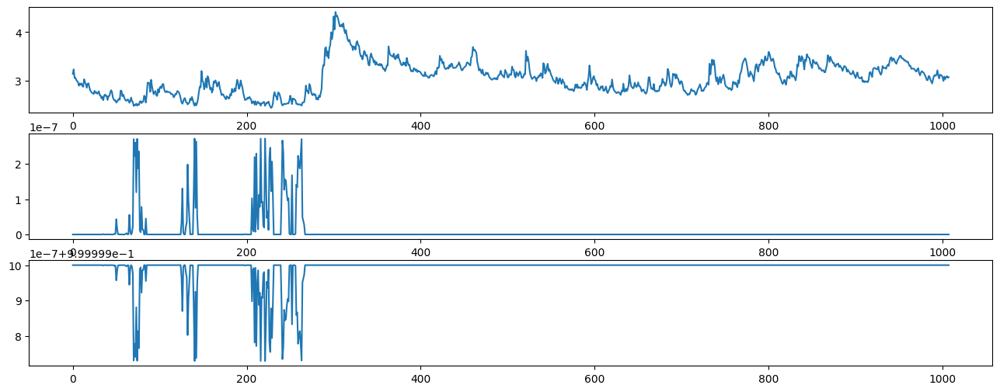


ite=1, max(diff) = 2.094503463520715

mu_hat0 = [2.5149 3.0538], 
sigma_hat0 = [0.025  0.3306], 
P_hat0 = 
[[2.000e-04 9.998e-01]
 [0.000e+00 1.000e+00]], 
pi_hat0 = [0. 1.]



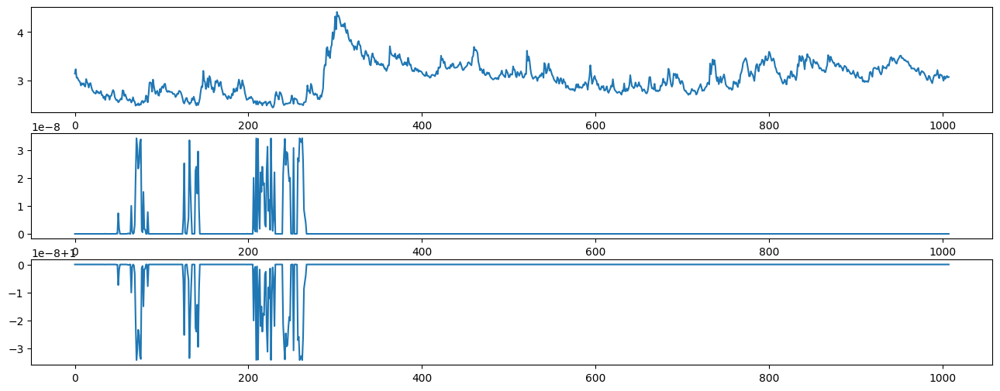


ite=2, max(diff) = 4.182902124118972

mu_hat0 = [2.5216 3.0538], 
sigma_hat0 = [0.0205 0.3306], 
P_hat0 = 
[[4.000e-04 9.996e-01]
 [0.000e+00 1.000e+00]], 
pi_hat0 = [0. 1.]



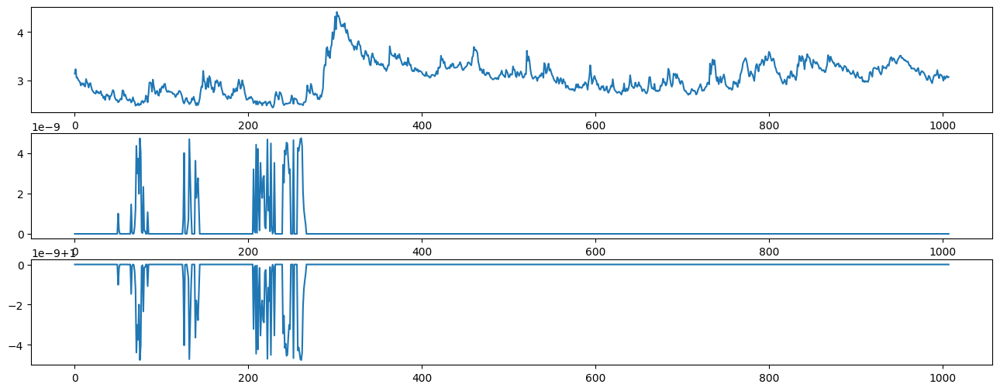


ite=3, max(diff) = 6.379902608036609

mu_hat0 = [2.5249 3.0538], 
sigma_hat0 = [0.0179 0.3306], 
P_hat0 = 
[[7.000e-04 9.993e-01]
 [0.000e+00 1.000e+00]], 
pi_hat0 = [0. 1.]



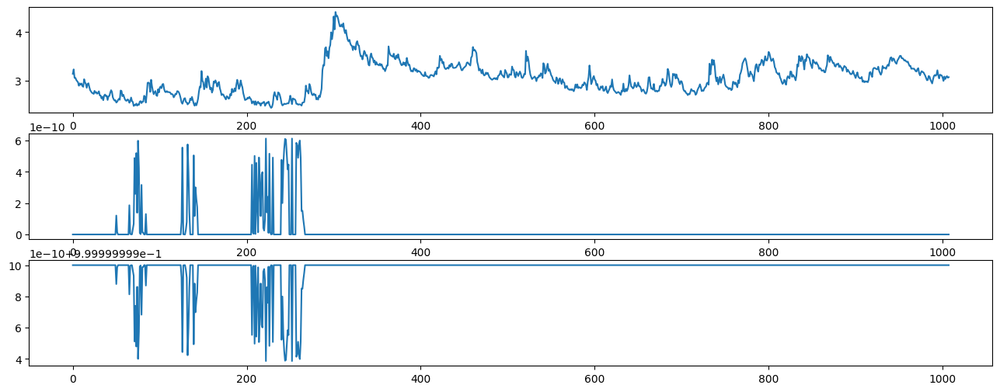


ite=4, max(diff) = 8.283638427765657

mu_hat0 = [2.527  3.0538], 
sigma_hat0 = [0.0161 0.3306], 
P_hat0 = 
[[0.0012 0.9988]
 [0.     1.    ]], 
pi_hat0 = [0. 1.]



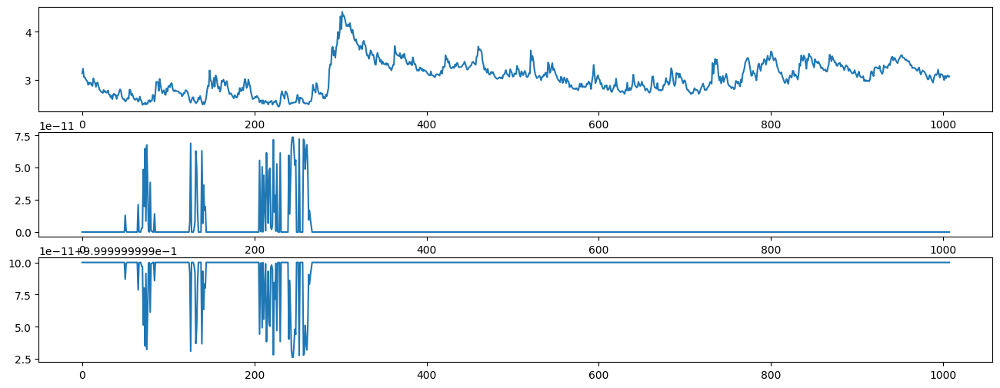


ite=5, max(diff) = 9.480872670815423

mu_hat0 = [2.5285 3.0538], 
sigma_hat0 = [0.0146 0.3306], 
P_hat0 = 
[[0.0016 0.9984]
 [0.     1.    ]], 
pi_hat0 = [0. 1.]



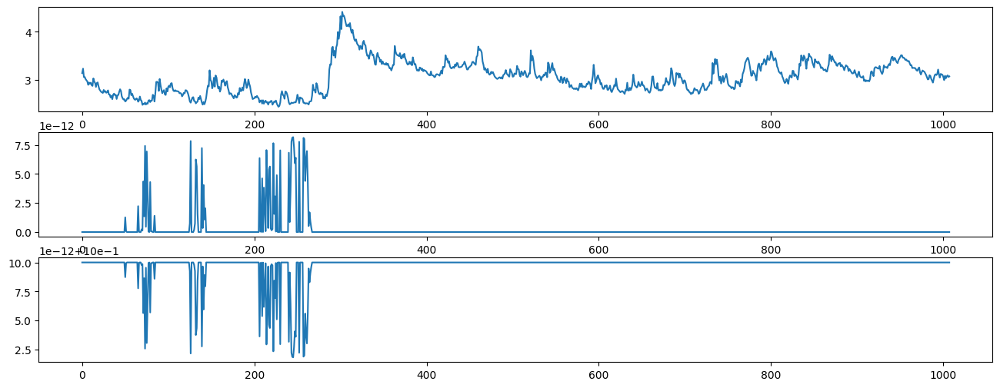


ite=6, max(diff) = 9.706870705366178

mu_hat0 = [2.5297 3.0538], 
sigma_hat0 = [0.0134 0.3306], 
P_hat0 = 
[[0.0021 0.9979]
 [0.     1.    ]], 
pi_hat0 = [0. 1.]



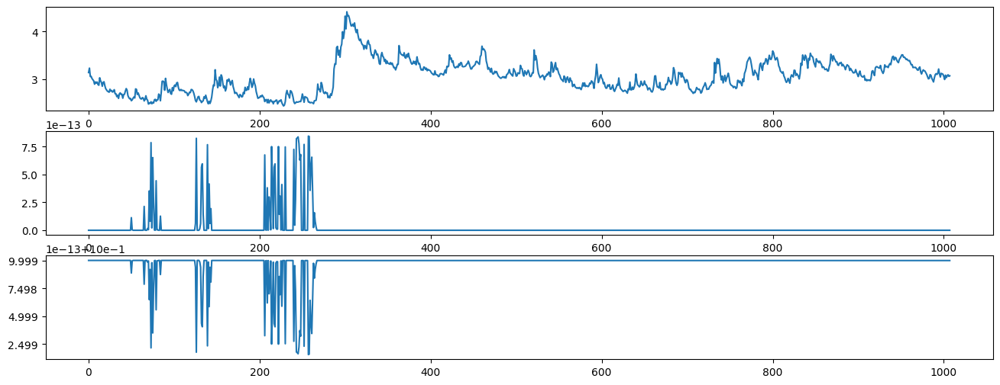


ite=7, max(diff) = 8.941082254318834

mu_hat0 = [2.5307 3.0538], 
sigma_hat0 = [0.0123 0.3306], 
P_hat0 = 
[[0.0026 0.9974]
 [0.     1.    ]], 
pi_hat0 = [0. 1.]



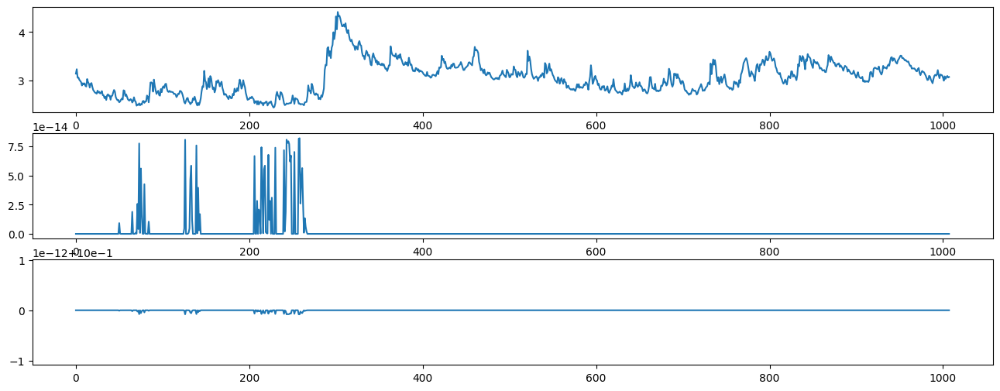


ite=8, max(diff) = 7.353965811600412

mu_hat0 = [2.5315 3.0538], 
sigma_hat0 = [0.0114 0.3306], 
P_hat0 = 
[[0.0029 0.9971]
 [0.     1.    ]], 
pi_hat0 = [0. 1.]



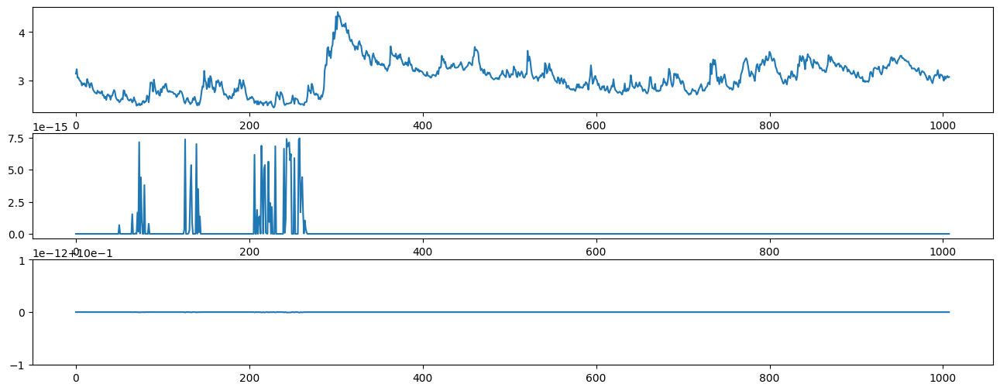


ite=9, max(diff) = 5.183072012334529

mu_hat0 = [2.5322 3.0538], 
sigma_hat0 = [0.0105 0.3306], 
P_hat0 = 
[[0.0032 0.9968]
 [0.     1.    ]], 
pi_hat0 = [0. 1.]



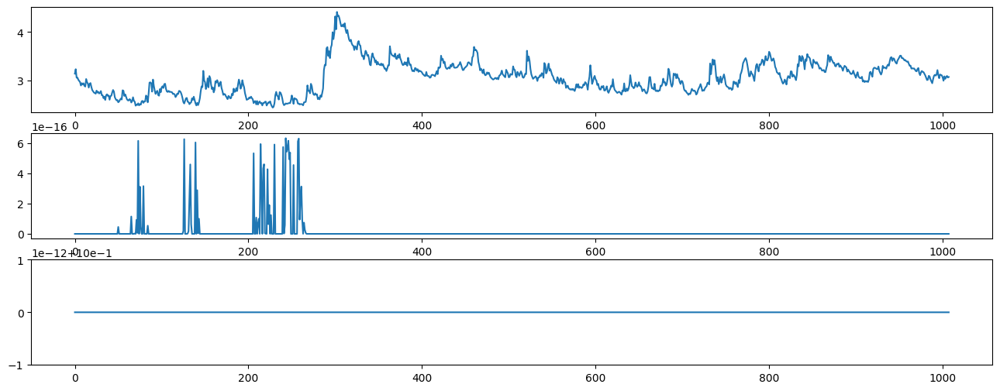


ite=10, max(diff) = 2.632132662063337

mu_hat0 = [2.5329 3.0538], 
sigma_hat0 = [0.0096 0.3306], 
P_hat0 = 
[[0.0033 0.9967]
 [0.     1.    ]], 
pi_hat0 = [0. 1.]



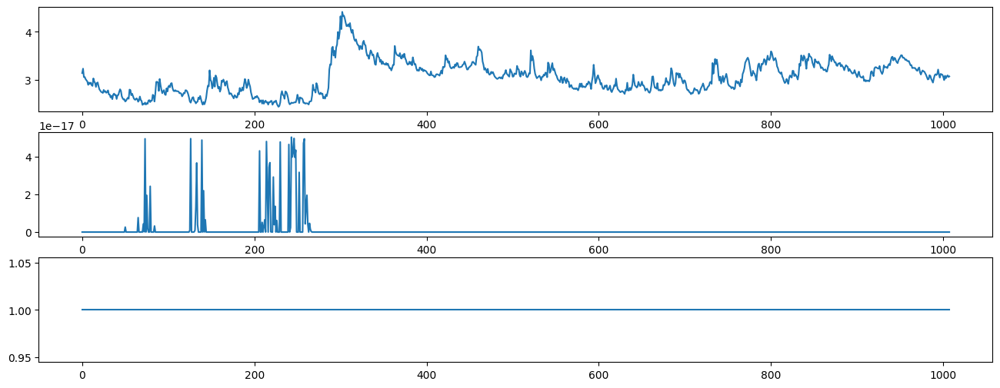


ite=11, max(diff) = 0.18282386917035715

mu_hat0 = [2.5335 3.0538], 
sigma_hat0 = [0.0086 0.3306], 
P_hat0 = 
[[0.0033 0.9967]
 [0.     1.    ]], 
pi_hat0 = [0. 1.]



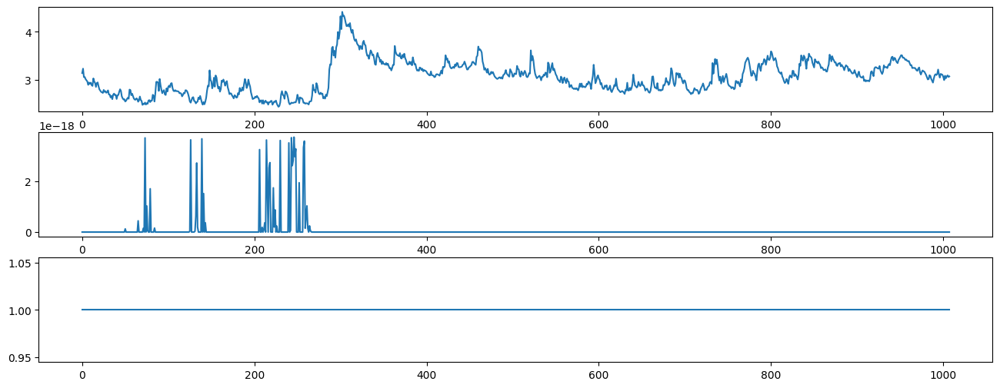


ite=12, max(diff) = 3.274893808626555

mu_hat0 = [2.5341 3.0538], 
sigma_hat0 = [0.0076 0.3306], 
P_hat0 = 
[[0.0031 0.9969]
 [0.     1.    ]], 
pi_hat0 = [0. 1.]



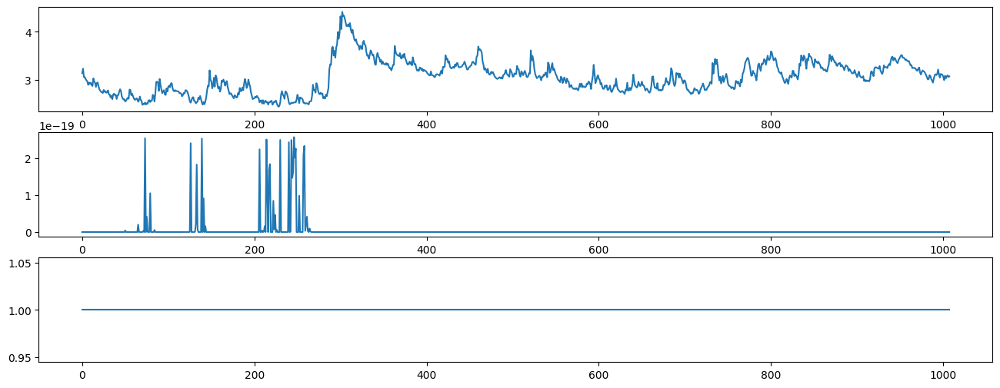


ite=13, max(diff) = 6.812254542410789

mu_hat0 = [2.5346 3.0538], 
sigma_hat0 = [0.0065 0.3306], 
P_hat0 = 
[[0.0028 0.9972]
 [0.     1.    ]], 
pi_hat0 = [0. 1.]



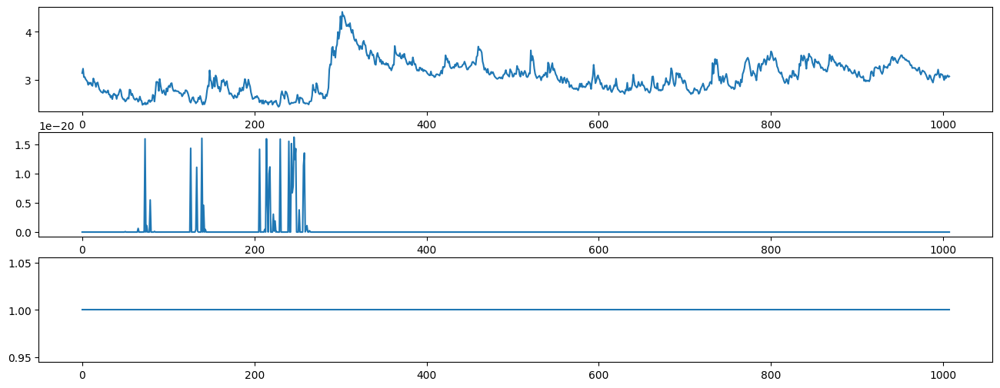


ite=14, max(diff) = 10.862065439923539

mu_hat0 = [2.535  3.0538], 
sigma_hat0 = [0.0054 0.3306], 
P_hat0 = 
[[0.0023 0.9977]
 [0.     1.    ]], 
pi_hat0 = [0. 1.]



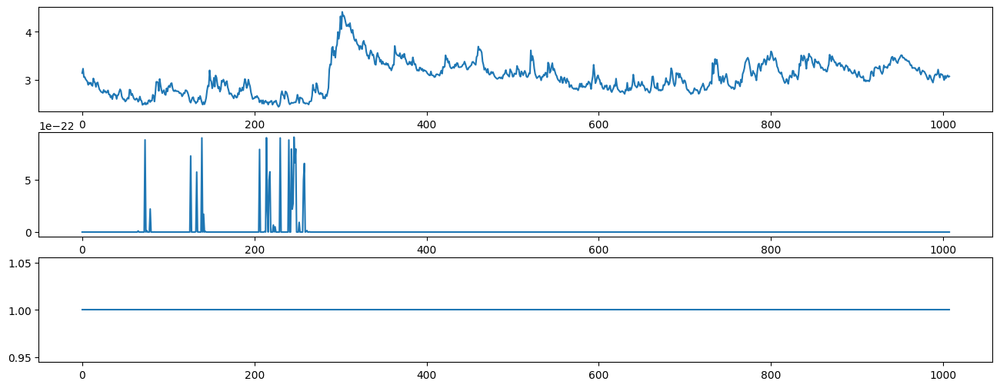


ite=15, max(diff) = 14.278469454526158

mu_hat0 = [2.5353 3.0538], 
sigma_hat0 = [0.0044 0.3306], 
P_hat0 = 
[[0.0016 0.9984]
 [0.     1.    ]], 
pi_hat0 = [0. 1.]



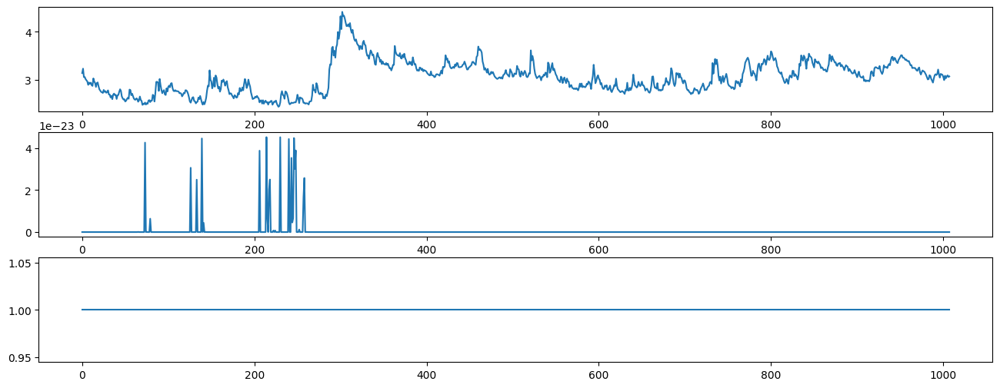


ite=16, max(diff) = 14.129911236768937

mu_hat0 = [2.5355 3.0538], 
sigma_hat0 = [0.0036 0.3306], 
P_hat0 = 
[[8.000e-04 9.992e-01]
 [0.000e+00 1.000e+00]], 
pi_hat0 = [0. 1.]



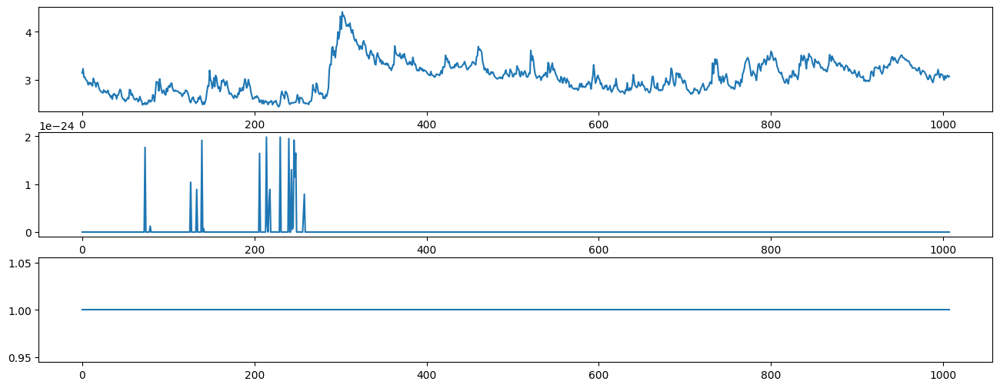


ite=17, max(diff) = 9.739390689871973

mu_hat0 = [2.5356 3.0538], 
sigma_hat0 = [0.003  0.3306], 
P_hat0 = 
[[4.000e-04 9.996e-01]
 [0.000e+00 1.000e+00]], 
pi_hat0 = [0. 1.]



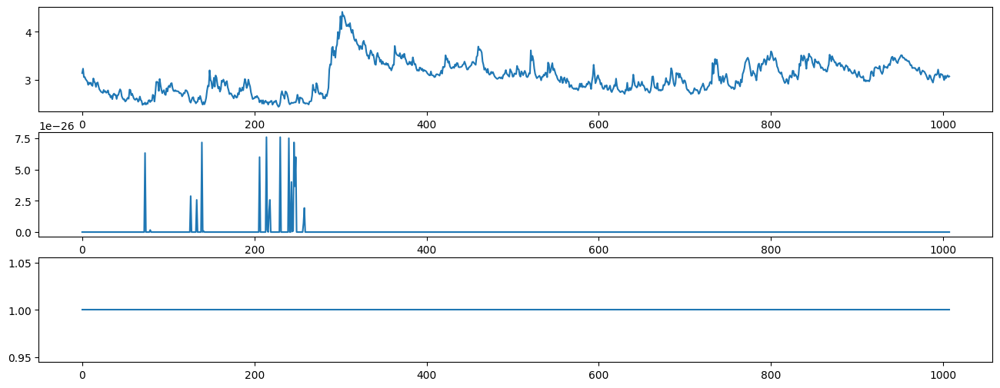


ite=18, max(diff) = 4.776035581648884

mu_hat0 = [2.5356 3.0538], 
sigma_hat0 = [0.0026 0.3306], 
P_hat0 = 
[[1.000e-04 9.999e-01]
 [0.000e+00 1.000e+00]], 
pi_hat0 = [0. 1.]



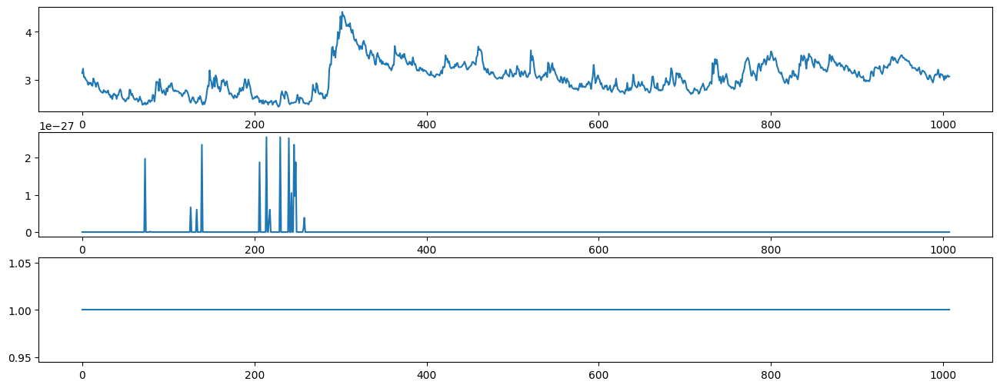


ite=19, max(diff) = 1.7546266181473125

mu_hat0 = [2.5356 3.0538], 
sigma_hat0 = [0.0023 0.3306], 
P_hat0 = 
[[0. 1.]
 [0. 1.]], 
pi_hat0 = [0. 1.]



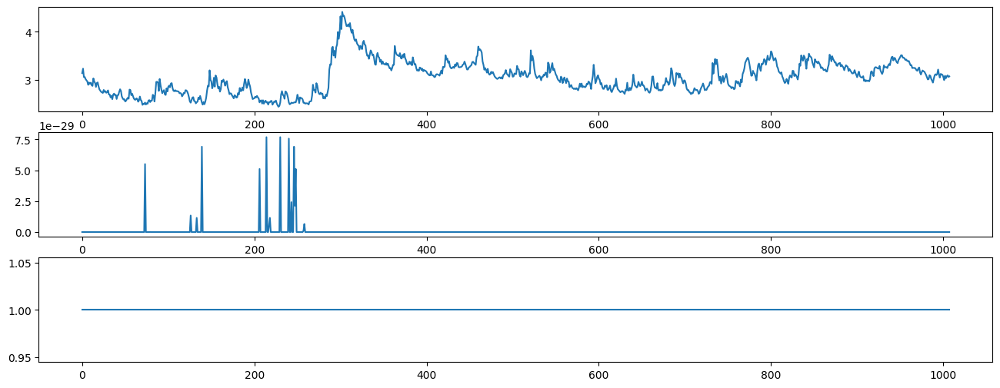


ite=20, max(diff) = 0.48847275559670167

mu_hat0 = [2.5355 3.0538], 
sigma_hat0 = [0.002  0.3306], 
P_hat0 = 
[[0. 1.]
 [0. 1.]], 
pi_hat0 = [0. 1.]



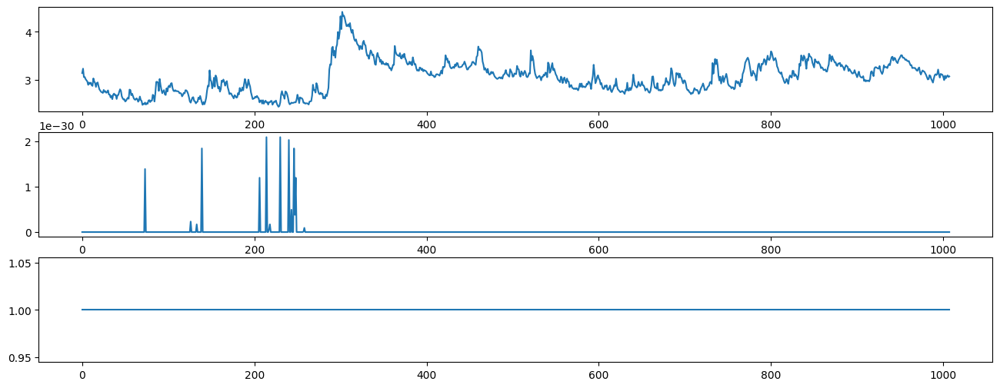


ite=21, max(diff) = 0.12101769291856153

mu_hat0 = [2.5355 3.0538], 
sigma_hat0 = [0.0017 0.3306], 
P_hat0 = 
[[0. 1.]
 [0. 1.]], 
pi_hat0 = [0. 1.]



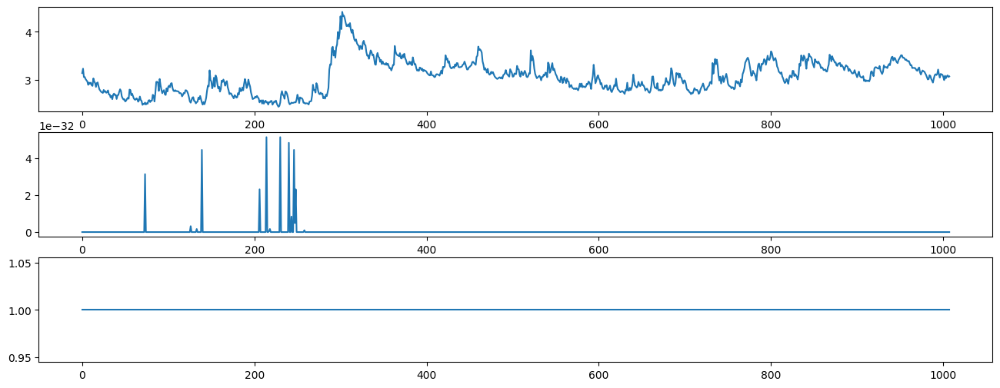


ite=22, max(diff) = 0.141859692816557

mu_hat0 = [2.5353 3.0538], 
sigma_hat0 = [0.0015 0.3306], 
P_hat0 = 
[[0. 1.]
 [0. 1.]], 
pi_hat0 = [0. 1.]



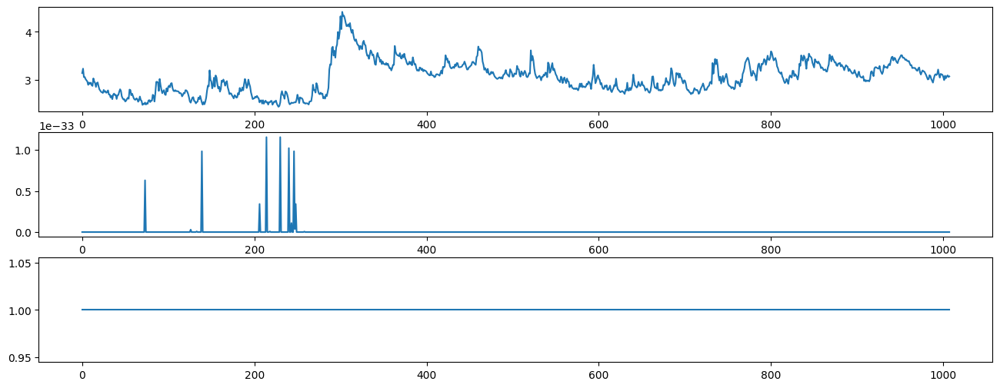


ite=23, max(diff) = 0.17408824688420602

mu_hat0 = [2.5352 3.0538], 
sigma_hat0 = [0.0012 0.3306], 
P_hat0 = 
[[0. 1.]
 [0. 1.]], 
pi_hat0 = [0. 1.]



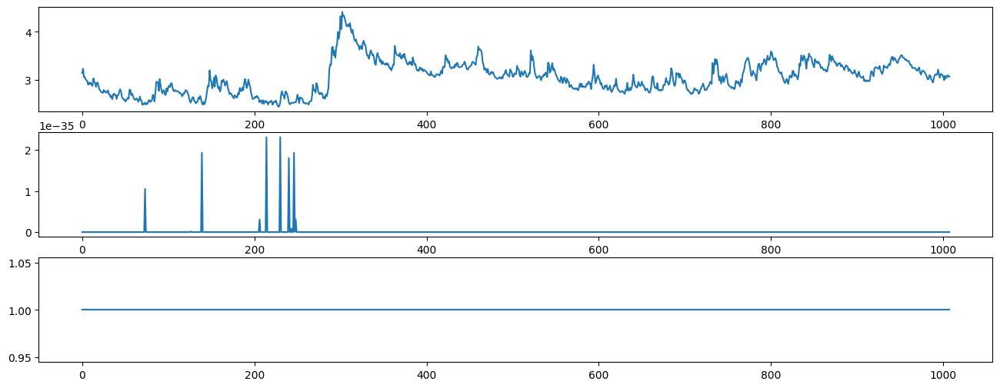


ite=24, max(diff) = 0.21073181842307917

mu_hat0 = [2.5351 3.0538], 
sigma_hat0 = [0.0009 0.3306], 
P_hat0 = 
[[0. 1.]
 [0. 1.]], 
pi_hat0 = [0. 1.]



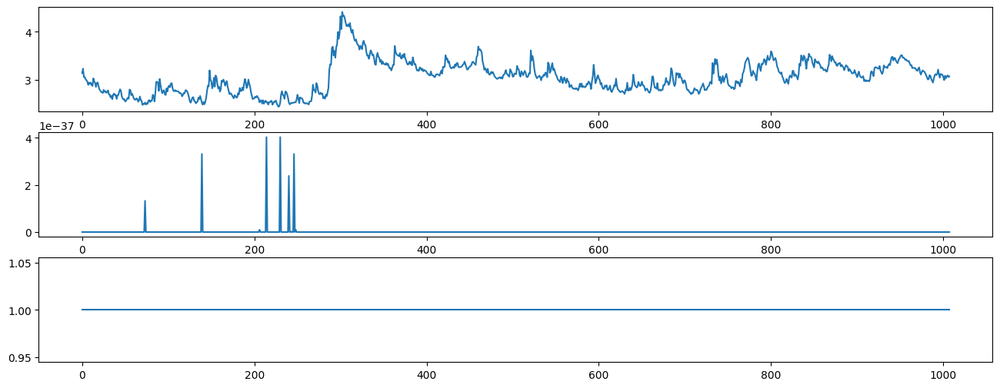


ite=25, max(diff) = 0.23216807519368152

mu_hat0 = [2.535  3.0538], 
sigma_hat0 = [0.0007 0.3306], 
P_hat0 = 
[[0. 1.]
 [0. 1.]], 
pi_hat0 = [0. 1.]



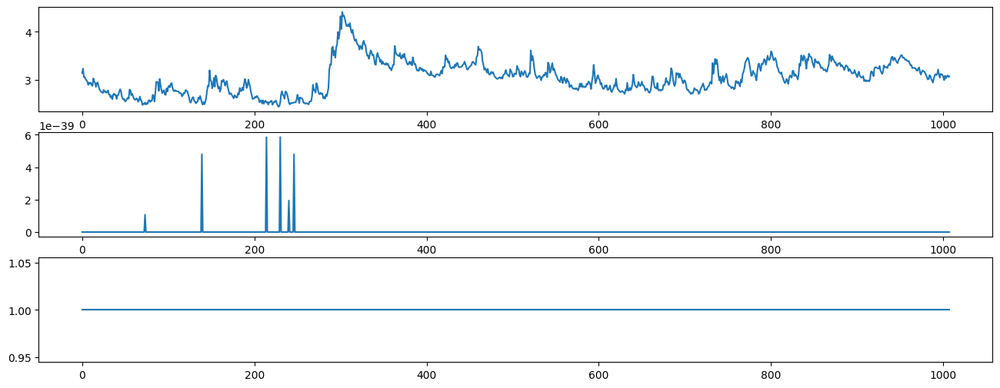


ite=26, max(diff) = 0.17380550819771143

mu_hat0 = [2.535  3.0538], 
sigma_hat0 = [0.0006 0.3306], 
P_hat0 = 
[[0. 1.]
 [0. 1.]], 
pi_hat0 = [0. 1.]



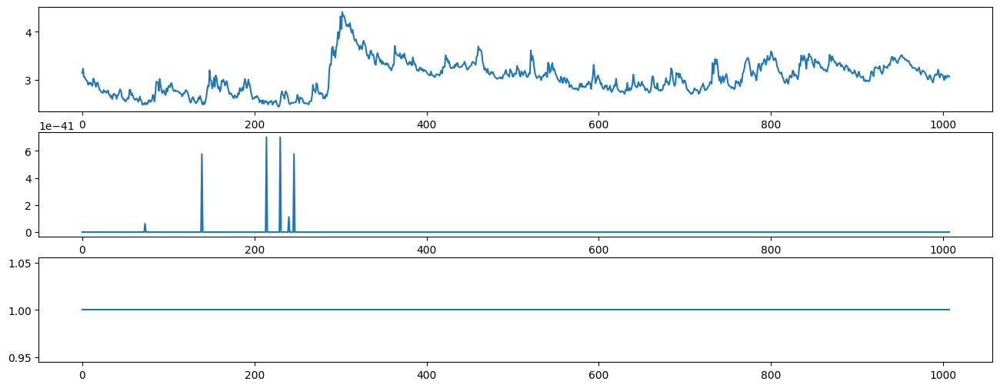


ite=27, max(diff) = 0.11058333952455358

mu_hat0 = [2.5349 3.0538], 
sigma_hat0 = [0.0005 0.3306], 
P_hat0 = 
[[0. 1.]
 [0. 1.]], 
pi_hat0 = [0. 1.]



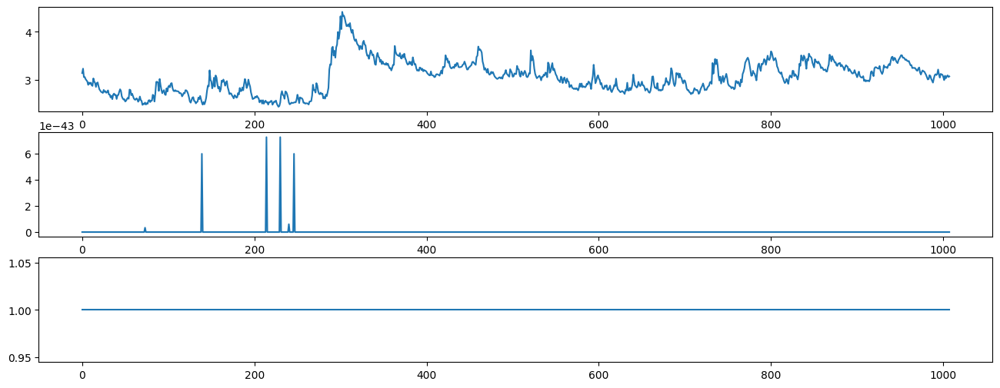


ite=28, max(diff) = 0.06693262153709018

mu_hat0 = [2.5349 3.0538], 
sigma_hat0 = [0.0004 0.3306], 
P_hat0 = 
[[0. 1.]
 [0. 1.]], 
pi_hat0 = [0. 1.]



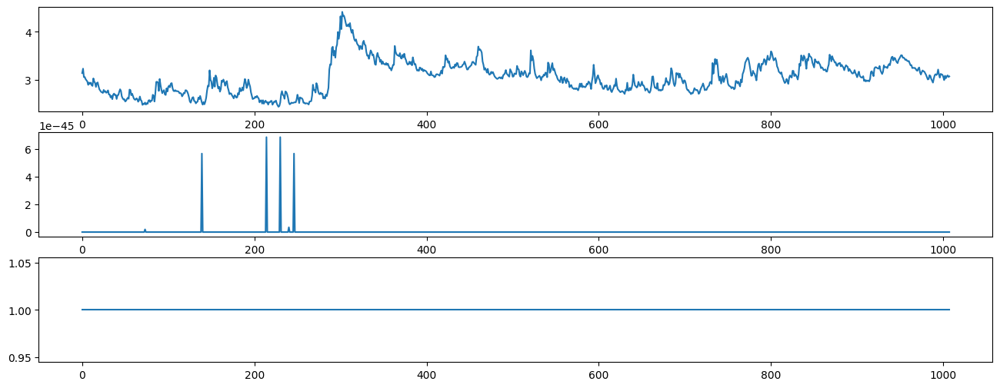


ite=29, max(diff) = 0.033639116835682124

mu_hat0 = [2.5349 3.0538], 
sigma_hat0 = [0.0004 0.3306], 
P_hat0 = 
[[0. 1.]
 [0. 1.]], 
pi_hat0 = [0. 1.]



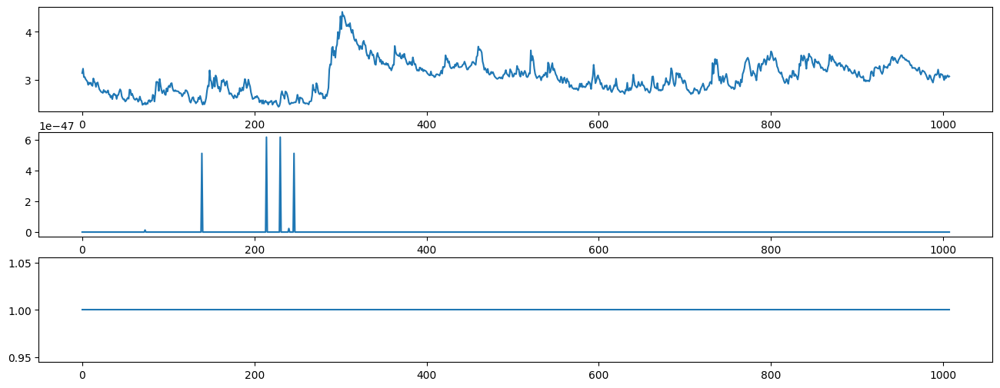


ite=30, max(diff) = 0.013942946008631982

mu_hat0 = [2.5349 3.0538], 
sigma_hat0 = [0.0004 0.3306], 
P_hat0 = 
[[0. 1.]
 [0. 1.]], 
pi_hat0 = [0. 1.]



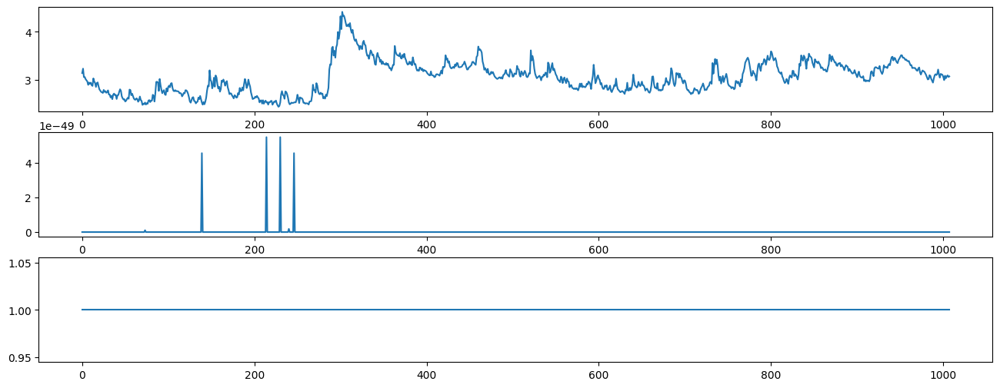


ite=31, max(diff) = 0.005102634106157239

mu_hat1 = [2.5349 3.0538], 
sigma_hat1 = [0.0004 0.3306], 
P_hat1 = 
[[0. 1.]
 [0. 1.]], 
pi_hat1 = [0. 1.]


In [ ]:
#Assume same mu different sigma
# Initialize parameters
T = len(YData)
N = 2

# SET INITIAL GUESSES

mu_hat0 = [2, 2] * np.ones((N))
sigma_hat0 = [0.1, 0.2] * np.ones((N))
P_hat0 = np.zeros((N, N))

P_hat0[0, 0] = 0.85
P_hat0[0, 1] = 1 - P_hat0[0, 0]
P_hat0[1, 1] = 0.90
P_hat0[1, 0] = 1 - P_hat0[1, 1]

pi_hat0 = [0.5, 0.5] * np.ones((N))
for t in range(1, 100):
    pi_hat0 = np.dot(P_hat0.T, pi_hat0)

# Determine maximum number of iterations until convergence and convergence tolerance
itemax = 100
itetol = 1e-2

for ite in range(0, itemax):
    #print(mu_hat0, sigma_hat0, P_hat0, pi_hat0)
    print(f"\nmu_hat0 = {np.round(mu_hat0,4)}, \nsigma_hat0 = {np.round(sigma_hat0,4)}, \nP_hat0 = \n{np.round(P_hat0,4)}, \npi_hat0 = {np.round(pi_hat0,4)}")

    # E-step
    xi_prob_t, xi_prob_t1 = forward_alg(
        pi_hat0, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )
    xi_prob_T = backward_alg(
        xi_prob_t, xi_prob_t1, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )

    print("")

    plt.subplot(3, 1, 1)
    plt.plot(YData)
    plt.subplot(3, 1, 2)
    plt.plot(xi_prob_T[:, 0])
    plt.subplot(3, 1, 3)
    plt.plot(xi_prob_T[:, 1])
    fig = plt.gcf()
    fig.set_size_inches(16, 6)
    plt.show()
    print("")

    # Compute Pr(s_t+1 = j, s_t = i)
    P_hat_T = np.zeros((N, N, T))
    for tt in range(1, T):
        for ss in range(0, N):
            for ss2 in range(0, N):
                P_hat_T[ss, ss2, tt] = (
                    P_hat0[ss, ss2]
                    * xi_prob_t[tt - 1, ss]
                    * xi_prob_T[tt, ss2]
                    / xi_prob_t1[tt - 1, ss2]
                )
    # M-step
    mu_hat1, sigma_hat1, P_hat1, pi_hat1 = M_step_func(xi_prob_T, P_hat_T, N, T, YData)

    diff = np.zeros((4))
    diff[0] = np.sum(np.absolute(mu_hat1 - mu_hat0)) / (np.min(mu_hat0) + itetol * 1e-2)
    diff[1] = np.sum(np.absolute(sigma_hat1 - sigma_hat0)) / (
        np.min(sigma_hat0) + itetol * 1e-2
    )
    diff[2] = np.sum(np.absolute(np.subtract(P_hat1, P_hat0))) / (
        np.min(P_hat0) + itetol * 1e-2
    )
    diff[3] = np.sum(np.absolute(pi_hat1 - pi_hat0)) / (np.min(pi_hat0) + itetol * 1e-2)

    print(f"ite={ite}, max(diff) = {np.max(diff)}")

    if np.max(diff) > itetol:
        mu_hat0, sigma_hat0, P_hat0, pi_hat0 = mu_hat1, sigma_hat1, P_hat1, pi_hat1
    else:
        print(f"\nmu_hat1 = {np.round(mu_hat1,4)}, \nsigma_hat1 = {np.round(sigma_hat1,4)}, \nP_hat1 = \n{np.round(P_hat1,4)}, \npi_hat1 = {np.round(pi_hat1,4)}")
        break

## STEP 2.b.iv Different mu different sigma


mu_hat0 = [2.5 3. ], 
sigma_hat0 = [0.3 0.4], 
P_hat0 = 
[[0.85 0.15]
 [0.1  0.9 ]], 
pi_hat0 = [0.4 0.6]



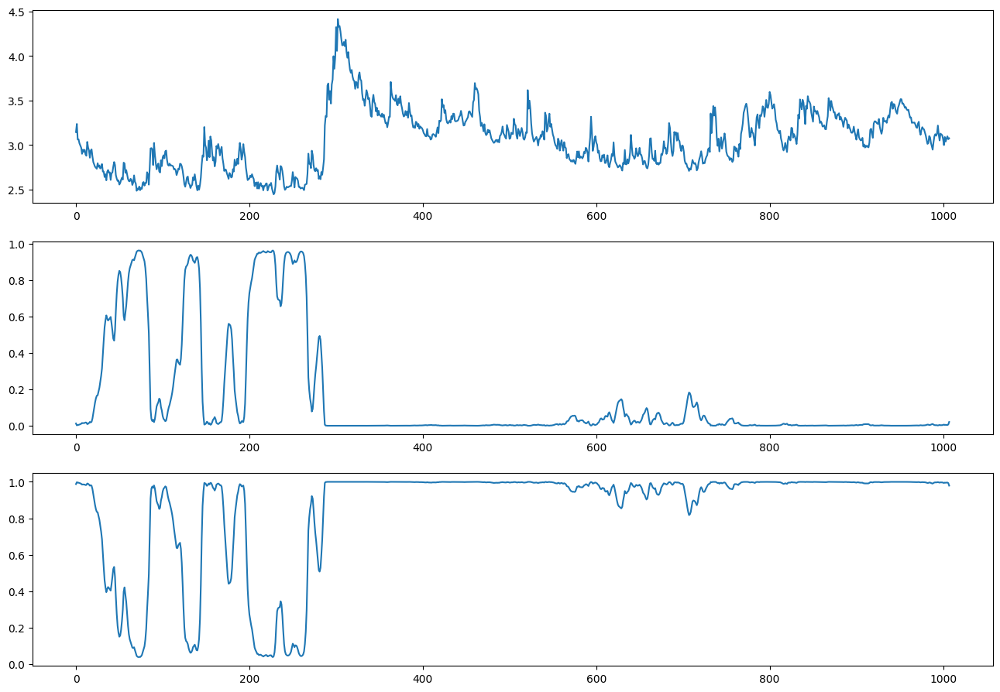


ite=0, max(diff) = 2.491930999167767

mu_hat0 = [2.6224 3.1296], 
sigma_hat0 = [0.109  0.2966], 
P_hat0 = 
[[0.8935 0.1065]
 [0.0187 0.9813]], 
pi_hat0 = [0.0124 0.9876]



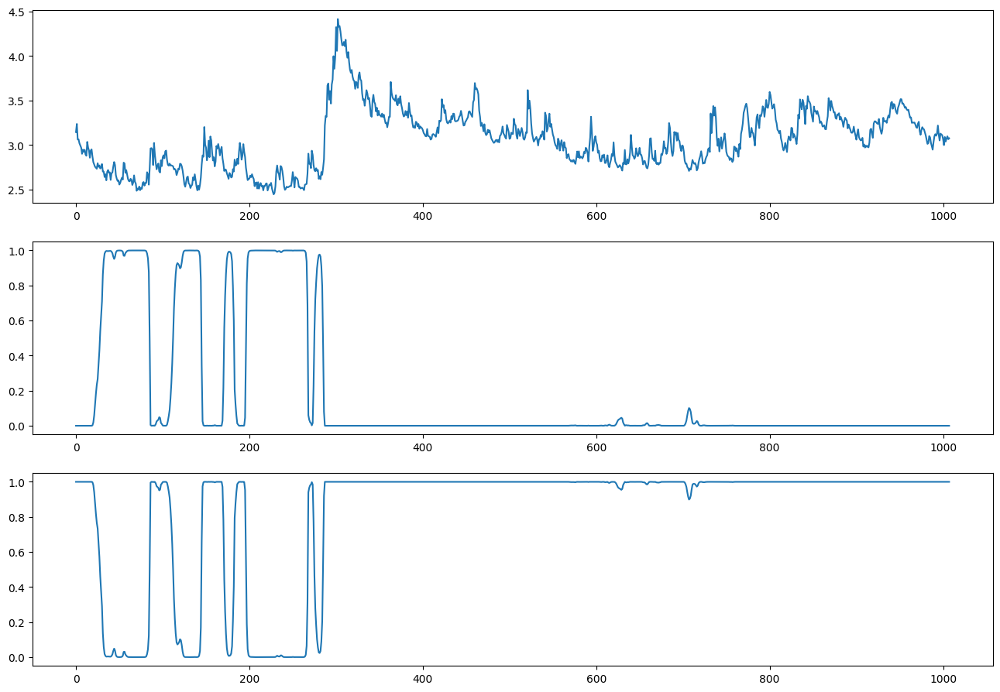


ite=1, max(diff) = 9.147080556297457

mu_hat0 = [2.6196 3.1495], 
sigma_hat0 = [0.0866 0.2846], 
P_hat0 = 
[[0.968  0.032 ]
 [0.0071 0.9929]], 
pi_hat0 = [0. 1.]



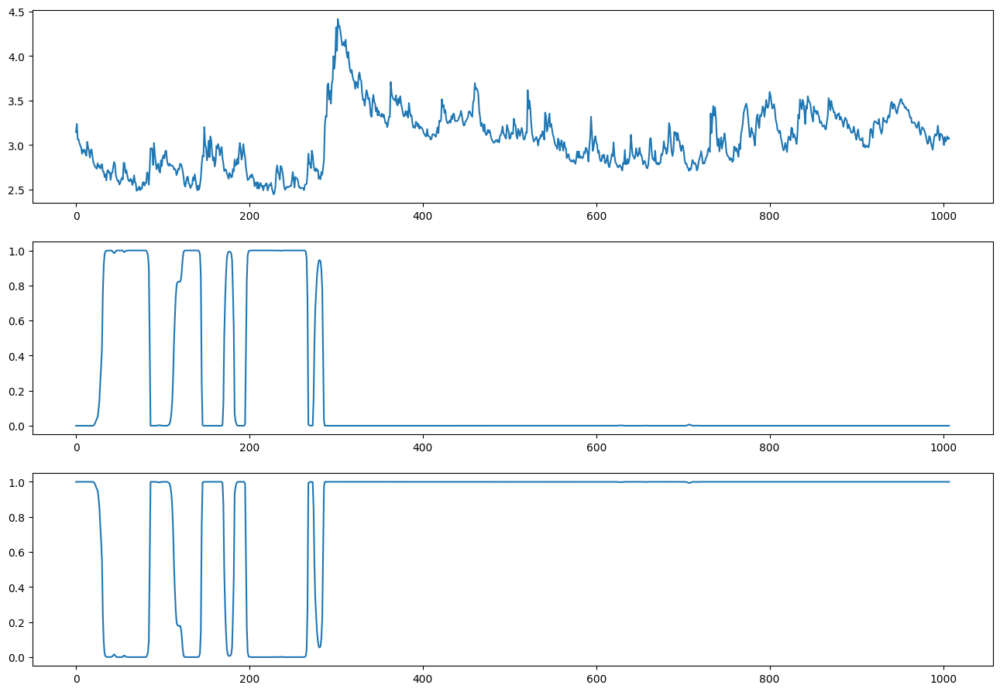


ite=2, max(diff) = 1.2193183271985668

mu_hat0 = [2.6144 3.1466], 
sigma_hat0 = [0.0835 0.2855], 
P_hat0 = 
[[0.9713 0.0287]
 [0.0061 0.9939]], 
pi_hat0 = [0. 1.]



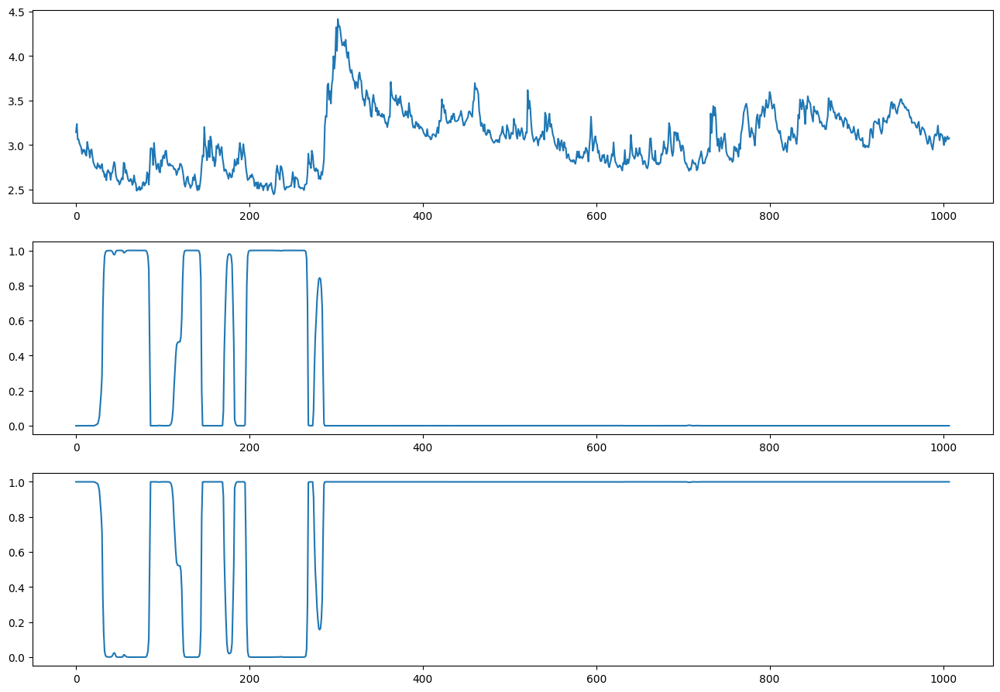


ite=3, max(diff) = 0.22738982917035946

mu_hat0 = [2.6097 3.1431], 
sigma_hat0 = [0.0815 0.2869], 
P_hat0 = 
[[0.9708 0.0292]
 [0.0059 0.9941]], 
pi_hat0 = [0. 1.]



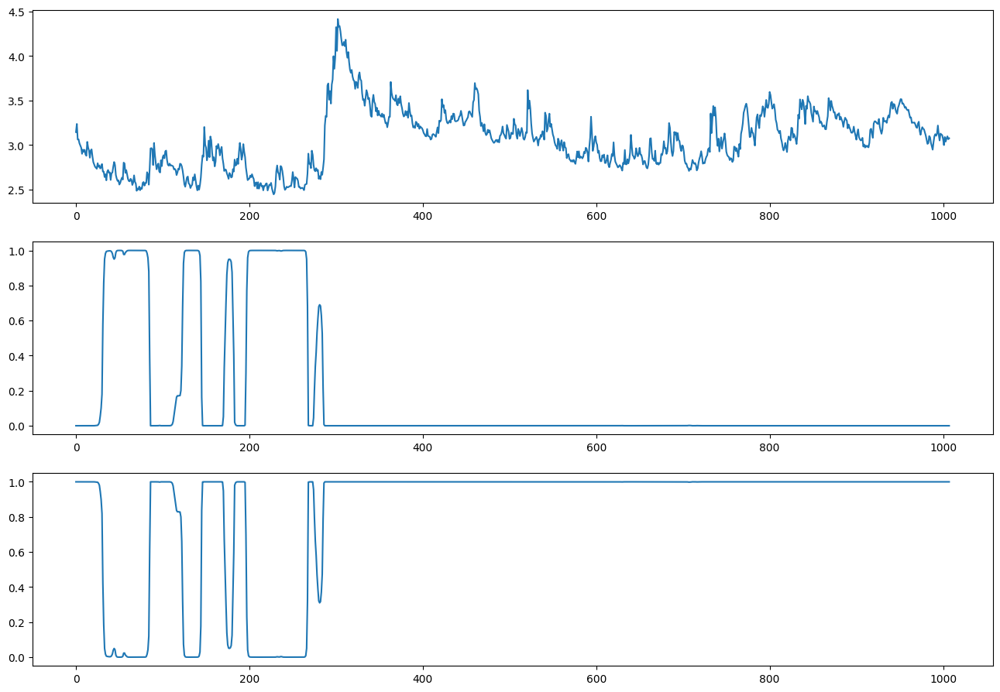


ite=4, max(diff) = 0.15172505126307403

mu_hat0 = [2.6054 3.1398], 
sigma_hat0 = [0.0796 0.2882], 
P_hat0 = 
[[0.9706 0.0294]
 [0.0056 0.9944]], 
pi_hat0 = [0. 1.]



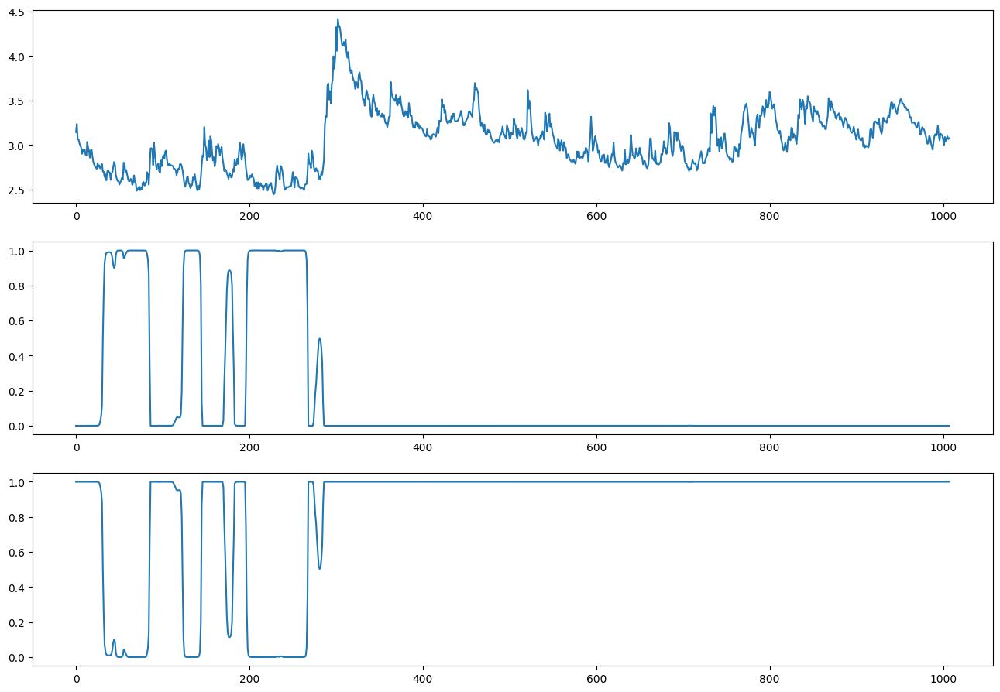


ite=5, max(diff) = 0.1905806271665443

mu_hat0 = [2.6022 3.1372], 
sigma_hat0 = [0.0783 0.2894], 
P_hat0 = 
[[0.9709 0.0291]
 [0.0054 0.9946]], 
pi_hat0 = [0. 1.]



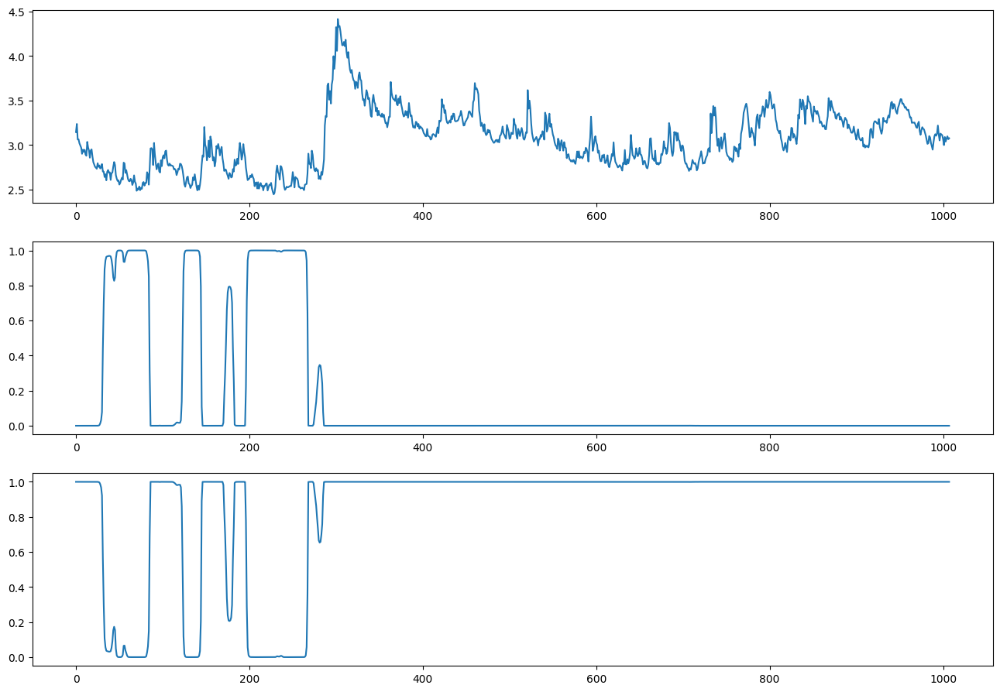


ite=6, max(diff) = 0.20622925175596485

mu_hat0 = [2.5999 3.1353], 
sigma_hat0 = [0.0774 0.2902], 
P_hat0 = 
[[0.9712 0.0288]
 [0.0052 0.9948]], 
pi_hat0 = [0. 1.]



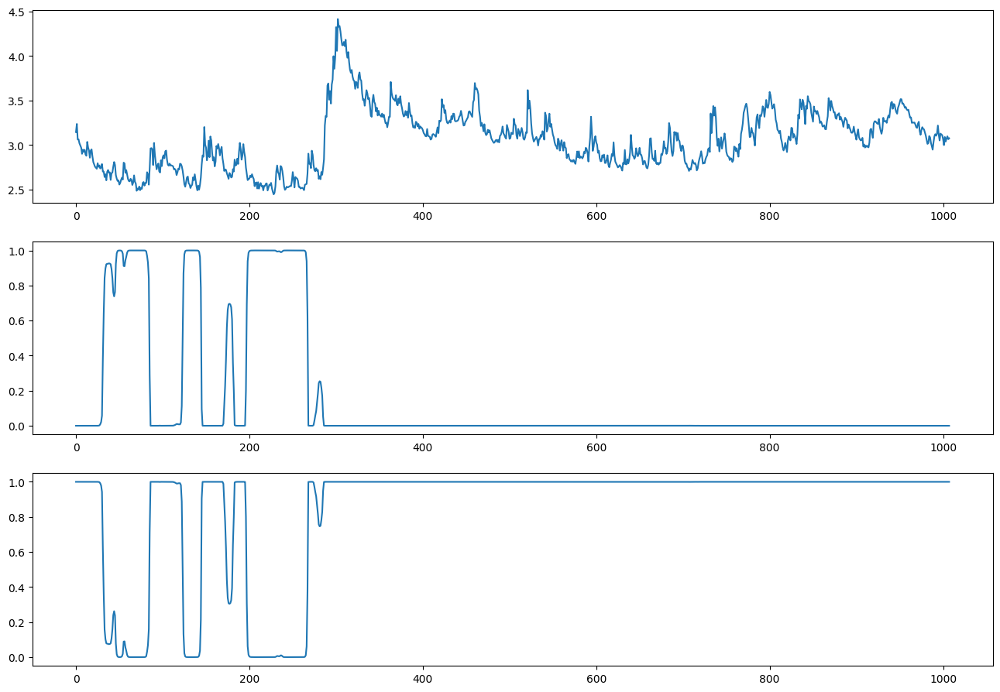


ite=7, max(diff) = 0.12240897112023823

mu_hat0 = [2.598  3.1337], 
sigma_hat0 = [0.0767 0.2909], 
P_hat0 = 
[[0.9714 0.0286]
 [0.005  0.995 ]], 
pi_hat0 = [0. 1.]



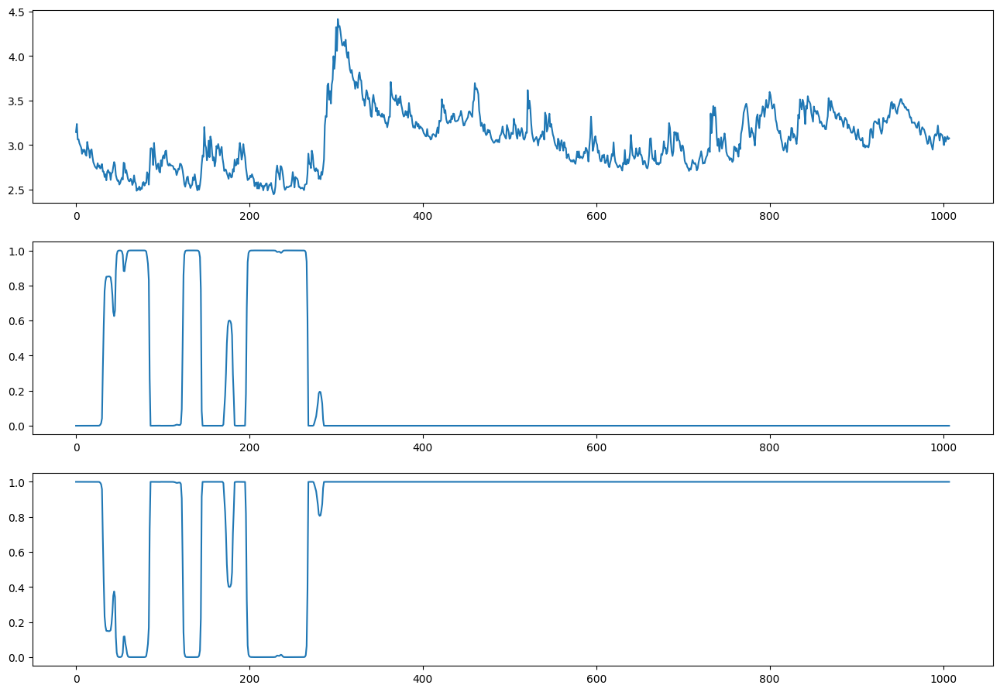


ite=8, max(diff) = 0.06185921404506878

mu_hat0 = [2.5961 3.1321], 
sigma_hat0 = [0.0759 0.2916], 
P_hat0 = 
[[0.9713 0.0287]
 [0.0049 0.9951]], 
pi_hat0 = [0. 1.]



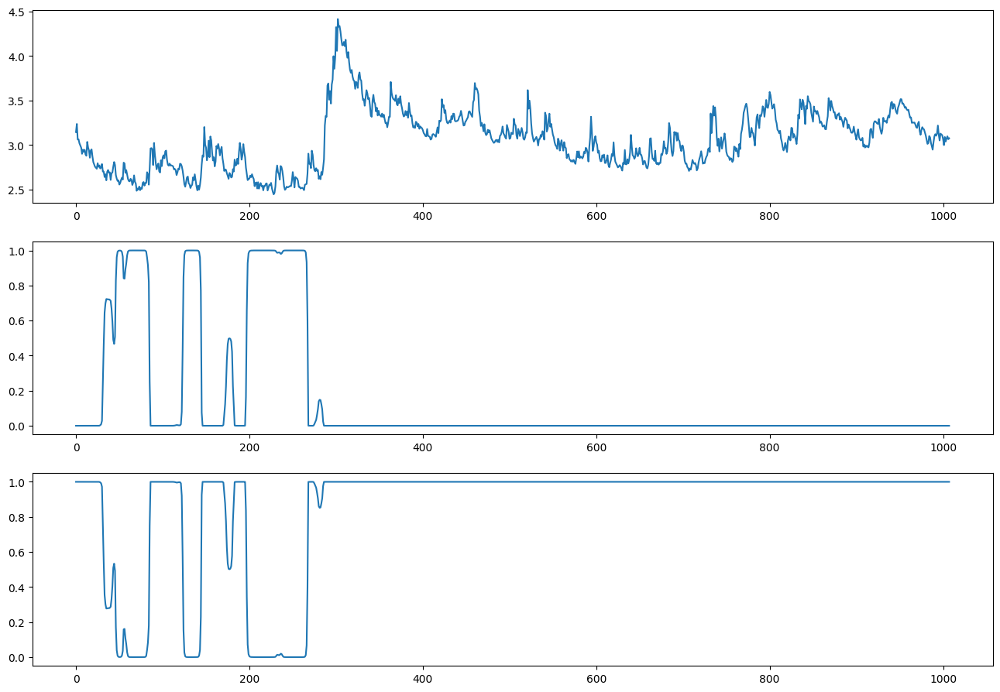


ite=9, max(diff) = 0.15675192591032583

mu_hat0 = [2.5936 3.1302], 
sigma_hat0 = [0.0748 0.2924], 
P_hat0 = 
[[0.971  0.029 ]
 [0.0048 0.9952]], 
pi_hat0 = [0. 1.]



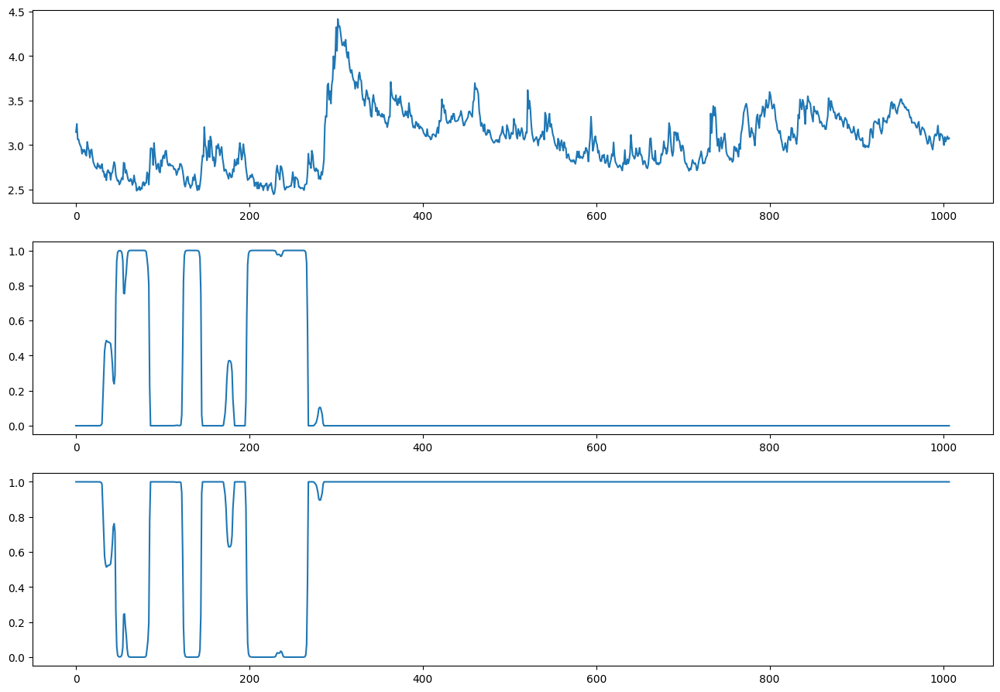


ite=10, max(diff) = 0.29425170354440827

mu_hat0 = [2.5896 3.1274], 
sigma_hat0 = [0.0728 0.2936], 
P_hat0 = 
[[0.9704 0.0296]
 [0.0047 0.9953]], 
pi_hat0 = [0. 1.]



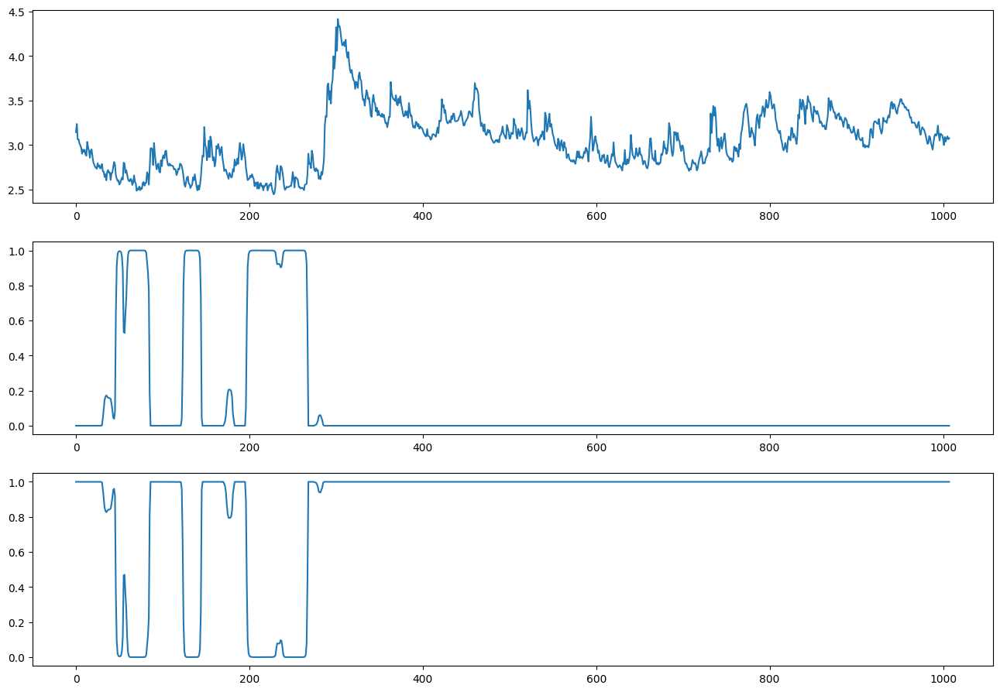


ite=11, max(diff) = 0.6094971374954293

mu_hat0 = [2.5837 3.1236], 
sigma_hat0 = [0.0693 0.2952], 
P_hat0 = 
[[0.9691 0.0309]
 [0.0046 0.9954]], 
pi_hat0 = [0. 1.]



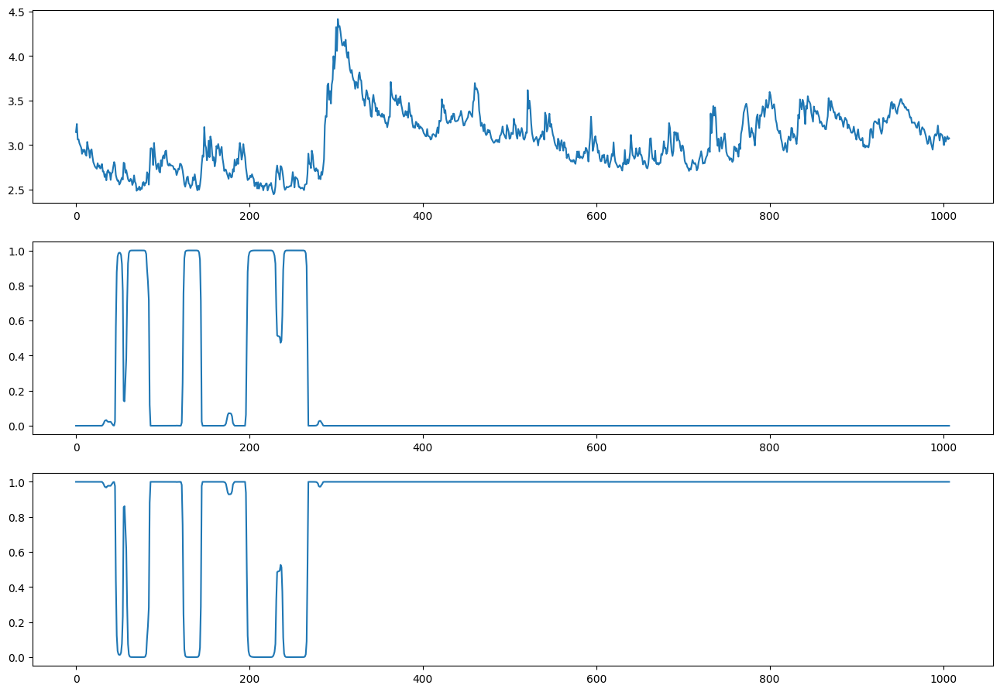


ite=12, max(diff) = 3.0538420582408112

mu_hat0 = [2.5757 3.1193], 
sigma_hat0 = [0.0625 0.2969], 
P_hat0 = 
[[0.9625 0.0375]
 [0.0051 0.9949]], 
pi_hat0 = [0. 1.]



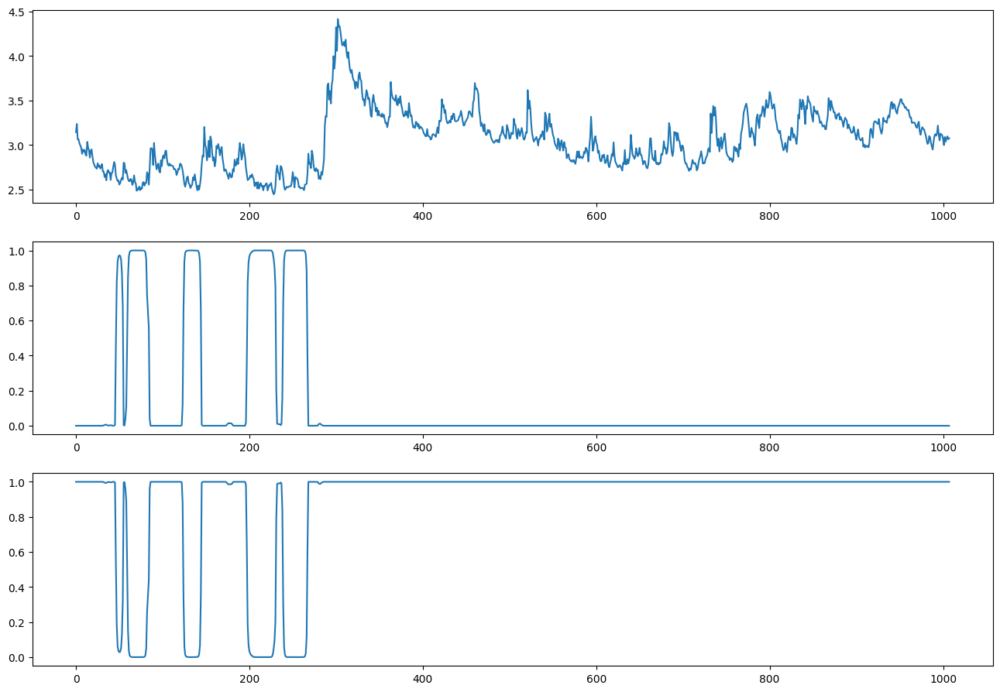


ite=13, max(diff) = 2.781692071441994

mu_hat0 = [2.5681 3.1154], 
sigma_hat0 = [0.0547 0.2985], 
P_hat0 = 
[[0.9556 0.0444]
 [0.0056 0.9944]], 
pi_hat0 = [0. 1.]



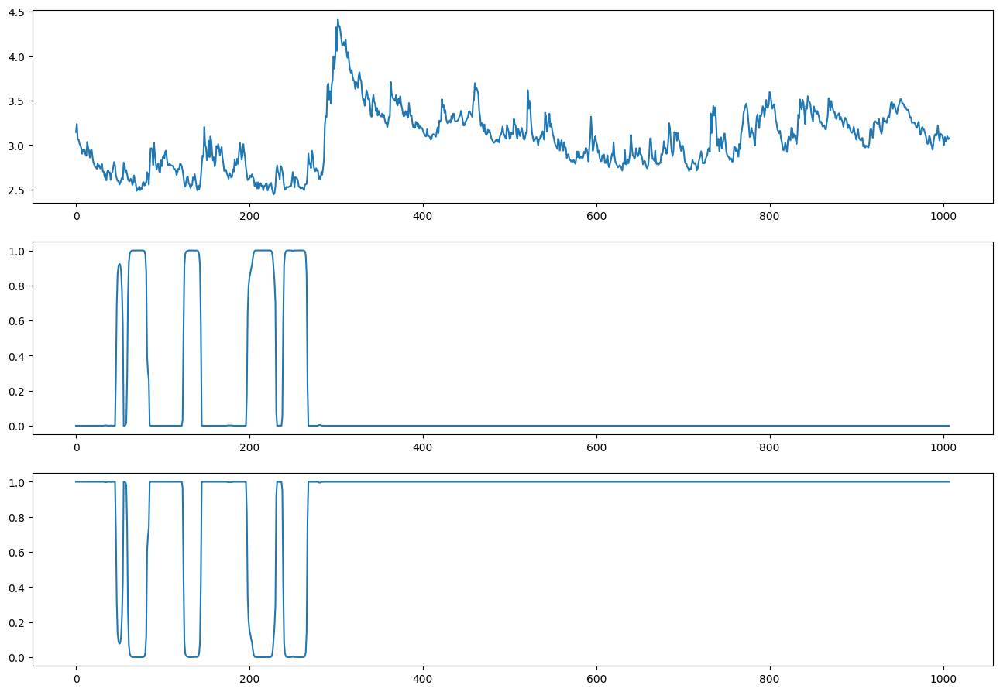


ite=14, max(diff) = 0.5156808753370109

mu_hat0 = [2.5651 3.1128], 
sigma_hat0 = [0.0525 0.2997], 
P_hat0 = 
[[0.9543 0.0457]
 [0.0055 0.9945]], 
pi_hat0 = [0. 1.]



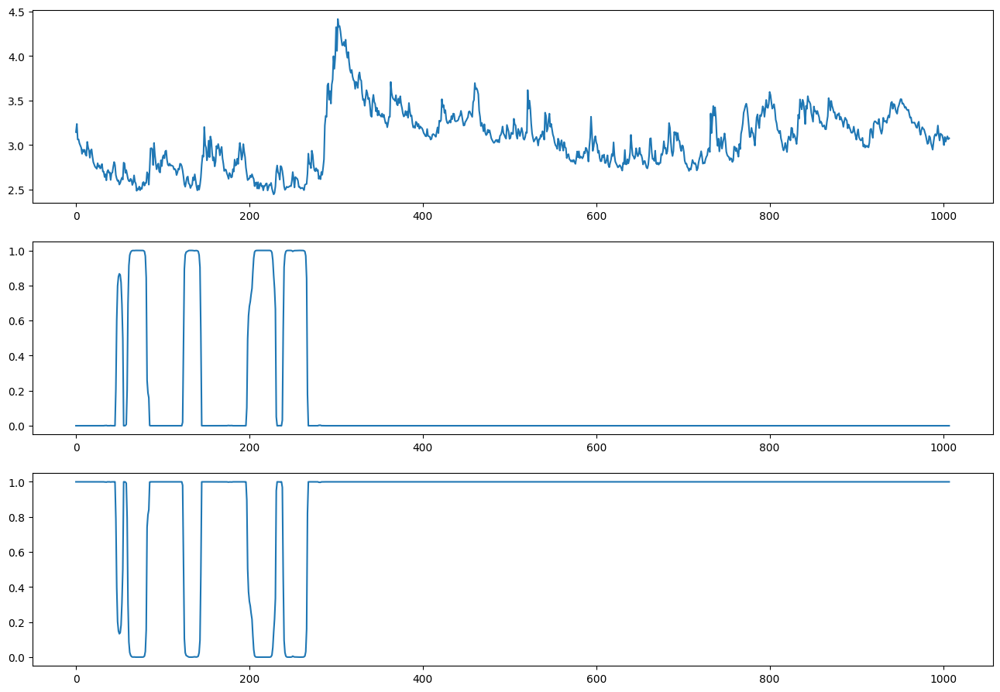


ite=15, max(diff) = 0.2696607308581511

mu_hat0 = [2.5636 3.1113], 
sigma_hat0 = [0.0517 0.3005], 
P_hat0 = 
[[0.9536 0.0464]
 [0.0054 0.9946]], 
pi_hat0 = [0. 1.]



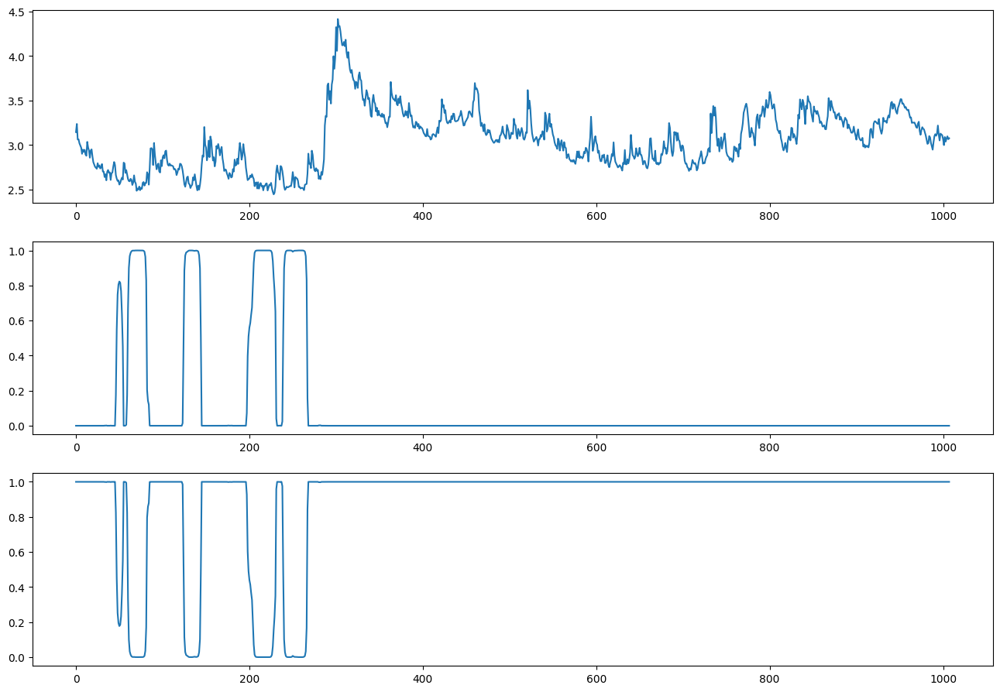


ite=16, max(diff) = 0.15101407058511332

mu_hat0 = [2.5626 3.1104], 
sigma_hat0 = [0.0512 0.301 ], 
P_hat0 = 
[[0.9532 0.0468]
 [0.0054 0.9946]], 
pi_hat0 = [0. 1.]



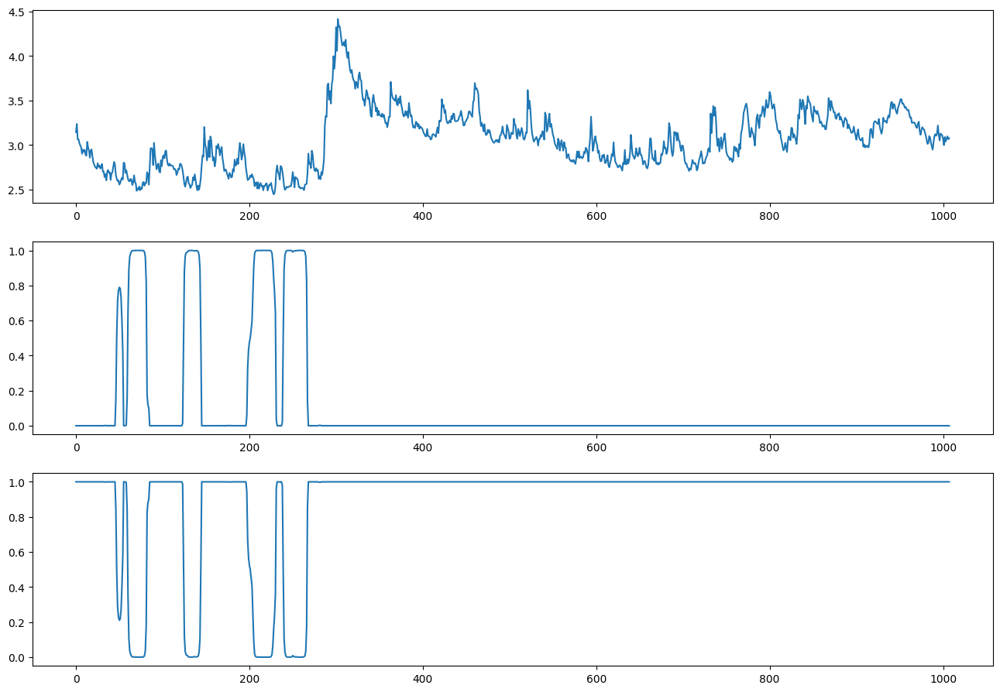


ite=17, max(diff) = 0.09269272527645761

mu_hat0 = [2.5619 3.1098], 
sigma_hat0 = [0.0509 0.3013], 
P_hat0 = 
[[0.953  0.047 ]
 [0.0054 0.9946]], 
pi_hat0 = [0. 1.]



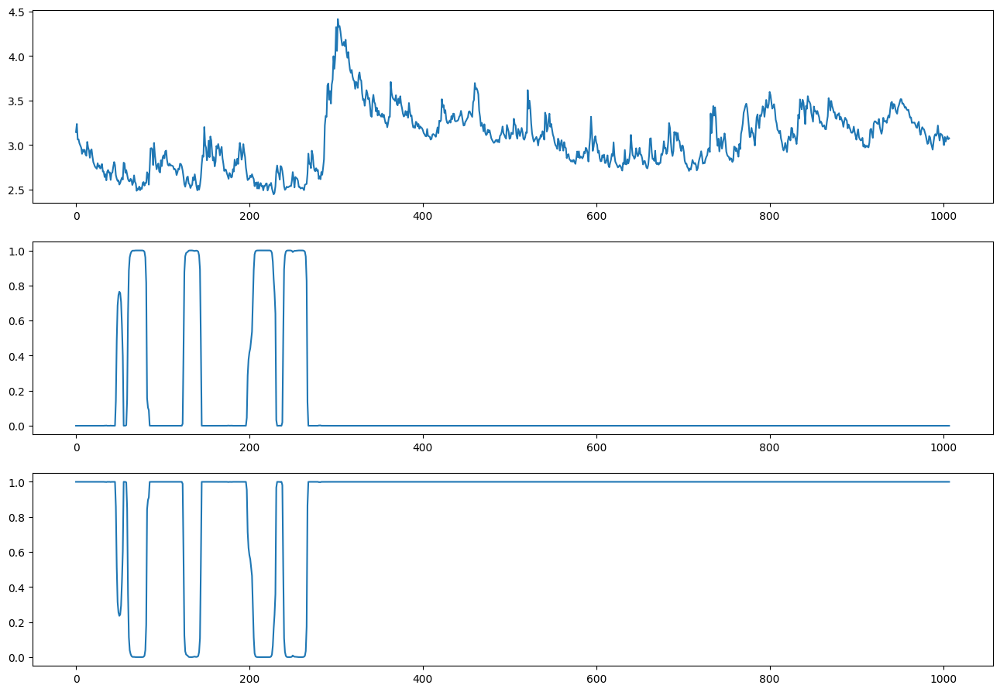


ite=18, max(diff) = 0.06018927218563181

mu_hat0 = [2.5614 3.1094], 
sigma_hat0 = [0.0506 0.3015], 
P_hat0 = 
[[0.9529 0.0471]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



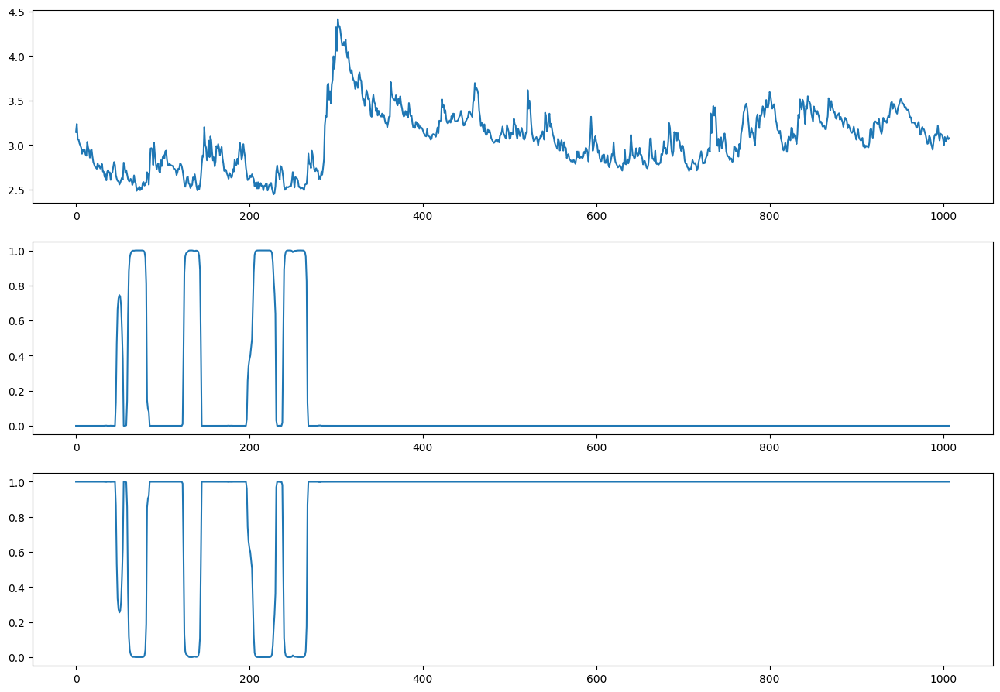


ite=19, max(diff) = 0.0402067722081332

mu_hat0 = [2.5611 3.1091], 
sigma_hat0 = [0.0505 0.3017], 
P_hat0 = 
[[0.9528 0.0472]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



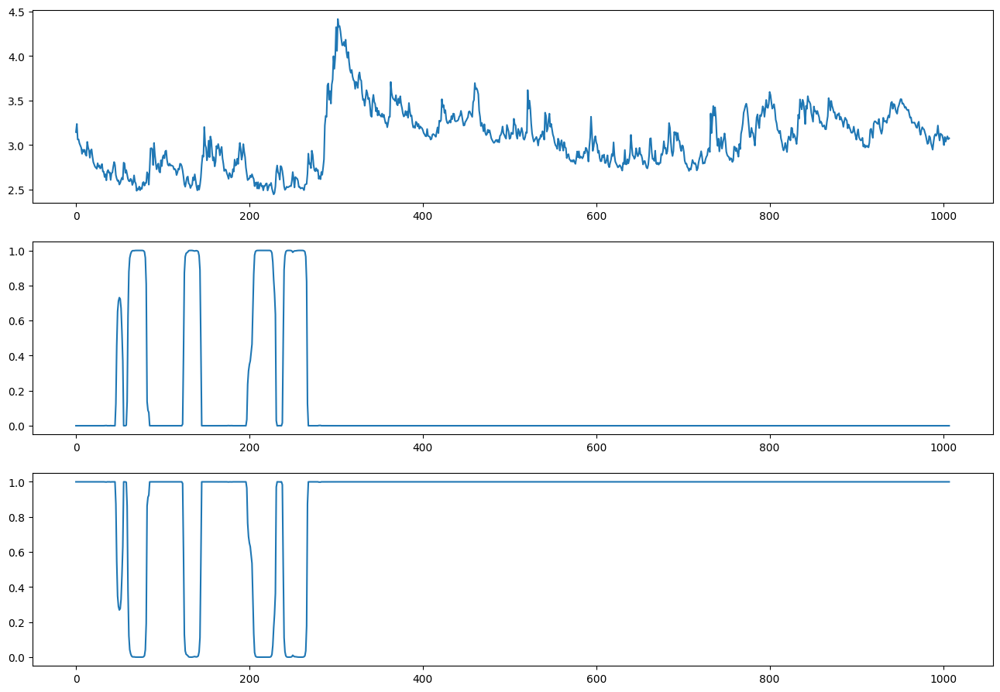


ite=20, max(diff) = 0.027283463215325387

mu_hat0 = [2.5608 3.1088], 
sigma_hat0 = [0.0504 0.3018], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



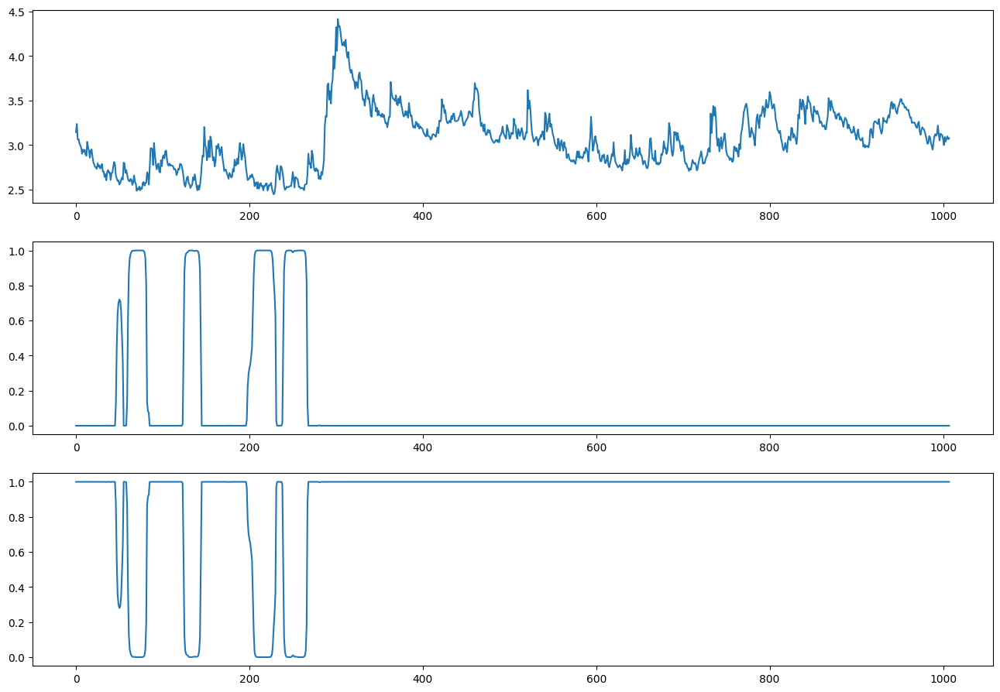


ite=21, max(diff) = 0.018712597450171262

mu_hat0 = [2.5606 3.1087], 
sigma_hat0 = [0.0503 0.3018], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



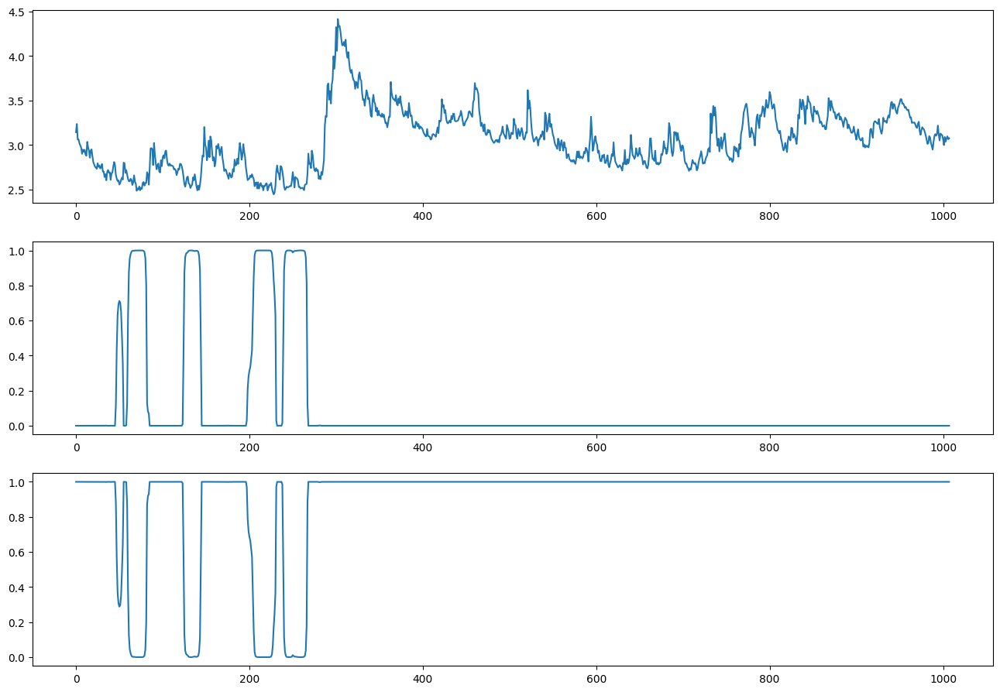


ite=22, max(diff) = 0.012944254875930716

mu_hat0 = [2.5605 3.1086], 
sigma_hat0 = [0.0502 0.3019], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



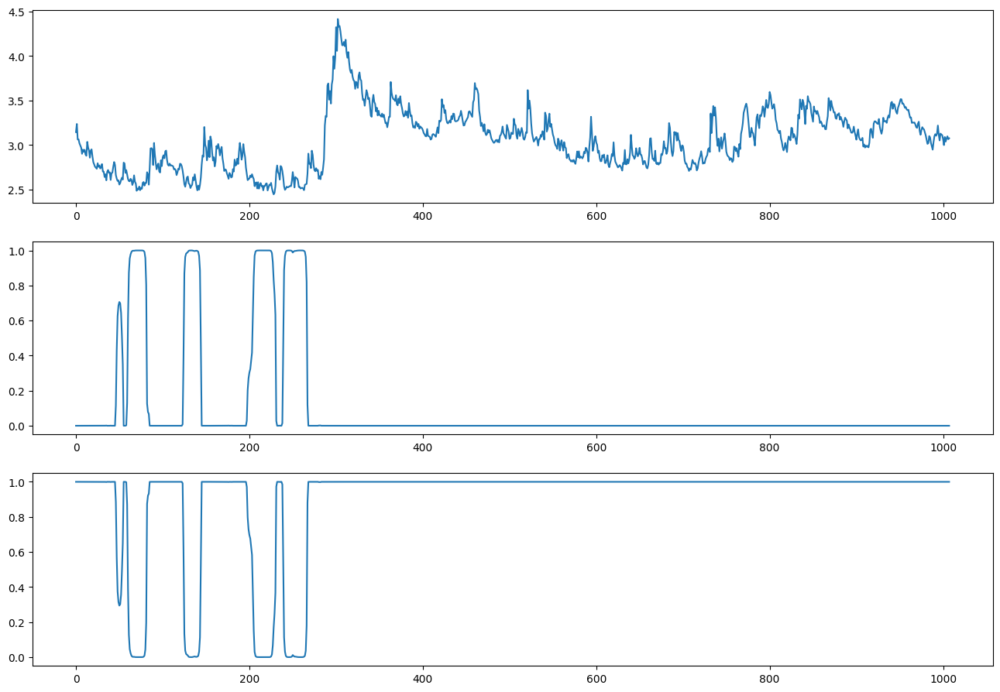


ite=23, max(diff) = 0.009019638529785766

mu_hat1 = [2.5604 3.1085], 
sigma_hat1 = [0.0502 0.3019], 
P_hat1 = 
[[0.9527 0.0473]
 [0.0052 0.9948]], 
pi_hat1 = [0. 1.]


In [ ]:
#Assume different mu different sigma
# Initialize parameters
T = len(YData)
N = 2

# SET INITIAL GUESSES

mu_hat0 = [2.5, 3] * np.ones((N))
sigma_hat0 = [0.3, 0.4] * np.ones((N))
P_hat0 = np.zeros((N, N))

P_hat0[0, 0] = 0.85
P_hat0[0, 1] = 1 - P_hat0[0, 0]
P_hat0[1, 1] = 0.90
P_hat0[1, 0] = 1 - P_hat0[1, 1]

pi_hat0 = [0.5, 0.5] * np.ones((N))
for t in range(1, 100):
    pi_hat0 = np.dot(P_hat0.T, pi_hat0)

# Determine maximum number of iterations until convergence and convergence tolerance
itemax = 100
itetol = 1e-2

for ite in range(0, itemax):
    #print(mu_hat0, sigma_hat0, P_hat0, pi_hat0)
    print(f"\nmu_hat0 = {np.round(mu_hat0,4)}, \nsigma_hat0 = {np.round(sigma_hat0,4)}, \nP_hat0 = \n{np.round(P_hat0,4)}, \npi_hat0 = {np.round(pi_hat0,4)}")

    # E-step
    xi_prob_t, xi_prob_t1 = forward_alg(
        pi_hat0, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )
    xi_prob_T = backward_alg(
        xi_prob_t, xi_prob_t1, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )

    print("")

    plt.subplot(3, 1, 1)
    plt.plot(YData)
    plt.subplot(3, 1, 2)
    plt.plot(xi_prob_T[:, 0])
    plt.subplot(3, 1, 3)
    plt.plot(xi_prob_T[:, 1])
    fig = plt.gcf()
    fig.set_size_inches(16, 11)
    plt.show()
    print("")

    # Compute Pr(s_t+1 = j, s_t = i)
    P_hat_T = np.zeros((N, N, T))
    for tt in range(1, T):
        for ss in range(0, N):
            for ss2 in range(0, N):
                P_hat_T[ss, ss2, tt] = (
                    P_hat0[ss, ss2]
                    * xi_prob_t[tt - 1, ss]
                    * xi_prob_T[tt, ss2]
                    / xi_prob_t1[tt - 1, ss2]
                )
    # M-step
    mu_hat1, sigma_hat1, P_hat1, pi_hat1 = M_step_func(xi_prob_T, P_hat_T, N, T, YData)

    diff = np.zeros((4))
    diff[0] = np.sum(np.absolute(mu_hat1 - mu_hat0)) / (np.min(mu_hat0) + itetol * 1e-2)
    diff[1] = np.sum(np.absolute(sigma_hat1 - sigma_hat0)) / (
        np.min(sigma_hat0) + itetol * 1e-2
    )
    diff[2] = np.sum(np.absolute(np.subtract(P_hat1, P_hat0))) / (
        np.min(P_hat0) + itetol * 1e-2
    )
    diff[3] = np.sum(np.absolute(pi_hat1 - pi_hat0)) / (np.min(pi_hat0) + itetol * 1e-2)

    print(f"ite={ite}, max(diff) = {np.max(diff)}")

    if np.max(diff) > itetol:
        mu_hat0, sigma_hat0, P_hat0, pi_hat0 = mu_hat1, sigma_hat1, P_hat1, pi_hat1
    else:
        print(f"\nmu_hat1 = {np.round(mu_hat1,4)}, \nsigma_hat1 = {np.round(sigma_hat1,4)}, \nP_hat1 = \n{np.round(P_hat1,4)}, \npi_hat1 = {np.round(pi_hat1,4)}")
        break

### different sigma and different mu also behaved well and may be used as a regime detector.

# STEP 3.a Performance Comparison for different mus

In the Microsoft word document



# STEP 3.b Performance Comparison for different sigmas

In the Microsoft word document

# STEP 3.d Performance Comparison for all and N = 2 and N = 3

In [ ]:
#Output under assumption of same mu and same sigma
N = 2
mu_hat1 = [3.05382796, 3.05382796]* np.ones((N))
sigma_hat1 = [0.33059937, 0.33059937]* np.ones((N))
P_hat1 = np.ones((N, N))
P_hat1[0, 0] = 0.85
P_hat1[0, 1] = 1 - P_hat1[0, 0]
P_hat1[1, 1] = 0.9
P_hat1[1, 0] = 1 - P_hat1[1, 1]
pi_hat1 = [0.4, 0.6]* np.ones((N))

#Output under assumption of different mu and same sigma
mu_hat2 = [2.56035551, 3.10842992]* np.ones((N))
sigma_hat2 = [0.05016043, 0.3019686]* np.ones((N))
P_hat2 = np.ones((N, N))
P_hat2[0, 0] = 0.95264679
P_hat2[0, 1] = 1 - P_hat1[0, 0]
P_hat2[1, 1] = 0.99475466
P_hat2[1, 0] = 1 - P_hat1[1, 1]
pi_hat2 = [0., 1.]* np.ones((N))

#Output under assumption of same mu and different sigma
mu_hat3 = [2.53492705, 3.05382796]* np.ones((N))
sigma_hat3 = [0.00041634, 0.33059937]* np.ones((N))
P_hat3 = np.ones((N, N))
P_hat3[0, 0] = 4.85549578e-121
P_hat3[0, 1] = 1 - P_hat1[0, 0]
P_hat3[1, 1] = 1.00000000e+000
P_hat3[1, 0] = 1 - P_hat1[1, 1]
pi_hat3 = [0., 1.]* np.ones((N))

#Output under assumption of different mu and different sigma

mu_hat4 = [2.56037288, 3.1084452]* np.ones((N))
sigma_hat4 = [0.05016823, 0.30196094]* np.ones((N))
P_hat4 = np.ones((N, N))
P_hat4[0, 0] = 0.95264971
P_hat4[0, 1] = 1 - P_hat1[0, 0]
P_hat4[1, 1] = 0.99475333
P_hat4[1, 0] = 1 - P_hat1[1, 1]
pi_hat4 = [0., 1.]* np.ones((N))


#Output under assumption of 3 states
N = 3

mu_hat5 = [2.55737148, 2.7017012,  3.15173827]* np.ones((N))
sigma_hat5 = [0.04825392, 0.05564275, 0.28420998]* np.ones((N))
P_hat5 = np.ones((N, N))

P_hat5[0,0] = 9.43967101e-01
P_hat5[0,1] = 3.18541130e-02
P_hat5[0,2]= 2.41787865e-02

P_hat5[1,0] = 6.48016774e-02
P_hat5[1,1] = 9.03157902e-01
P_hat5[1,2] = 3.20404208e-02

P_hat5[2,0] = 0
P_hat5[2,1] = 6.35025006e-03
P_hat5[2,2] = 9.93649750e-01

pi_hat5 = [0, 0, 1]



def log_likelihood(pi0, N, T, P, mu, sigma, Y):
    # 0. Rearrange vector of parameters

    # 1. Forward algorithm

    xi_prob_t, xi_prob_t1 = forward_alg(pi0, N, T, P, mu, sigma, Y)


    # 2. Evaluate likelihood

    y_like = np.zeros(T)
    y_like[0] = likelihood(pi0, mu, sigma, Y[0])
    for tt in range(1, T):
        y_like[tt] = likelihood(xi_prob_t1[tt - 1, :], mu, sigma, Y[tt])

    sum_log_like = -np.sum(np.log(y_like))

    return sum_log_like

N =2
log_likelihood1 = log_likelihood(pi_hat1, N, T, P_hat1, mu_hat1, sigma_hat1, YData)
log_likelihood2 = log_likelihood(pi_hat2, N, T, P_hat2, mu_hat2, sigma_hat2, YData)
log_likelihood3 = log_likelihood(pi_hat3, N, T, P_hat3, mu_hat3, sigma_hat3, YData)
log_likelihood4 = log_likelihood(pi_hat4, N, T, P_hat4, mu_hat4, sigma_hat4, YData)

N =3
log_likelihood5 = log_likelihood(pi_hat5, N, T, P_hat5, mu_hat5, sigma_hat5, YData)

# Calculate AIC score
k = N * (N-1) + 2 * N
for L in [log_likelihood1, log_likelihood2, log_likelihood3, log_likelihood4, log_likelihood5]:
  AIC = -2 * L + 2 * k
  print("With L = {:2f}, AIC score is {:.2f}".format(L, AIC))

With L = 1430.290039, AIC score is -2836.58
With L = 1443.633996, AIC score is -2863.27
With L = 1430.159694, AIC score is -2836.32
With L = 1443.642587, AIC score is -2863.29
With L = 1493.535963, AIC score is -2963.07


From the above results,
the best model would be under assumption of 3 states with different mu and different sigma with the lowest AIC value.
On the other hand, the worst model would be under assumption of 2 states with same mu. Both the model assuming same mu same sigma and assuming same mu different sigma result in the highest AIC value.

# Step 4 Autoregressive Process

First we should test our data is stationary or not. We need an ADF test for this.

In [ ]:
# ADF Test
X = YDatapd.dropna().values
result = adfuller(X)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

ADF Statistic: -3.857285
p-value: 0.002373
Critical Values:
	1%: -3.437
	5%: -2.864
	10%: -2.568


As we observe that p-value is less than 0.05 we reject the null hypothesis on non-stationarity and detect that our data **YDatapd** is stationary with %99 fidelity, as we observe that test statistic = -3.857 is less than -3.437.

We can safely continue with ACF and PACF tests.

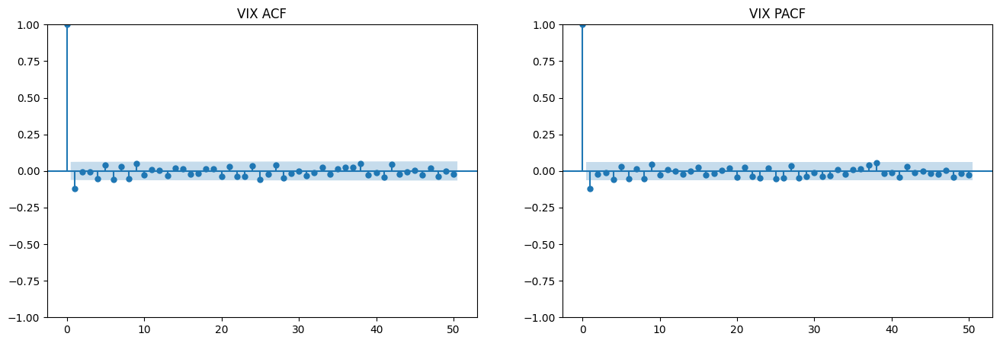

In [ ]:
#Plot ACF and PACF graph
# plot ACF and PACF
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
sm.graphics.tsa.plot_acf(np.log(YDatapd).diff().dropna(), title="VIX ACF", lags=50, ax=ax1)
sm.graphics.tsa.plot_pacf(np.log(YDatapd).diff().dropna(), title="VIX PACF", lags=50, ax=ax2)
plt.show()

As seen above in ACF and PACF graphics, VIX data seems to be not so dependent on past values, the most significant dependence is to its previous value, just one sample before. This happily matches with the Markov property.

Below code segment detects best ARIMA parameters for a given data due to AIC results, iteration with lowest AIC is selected.

In [ ]:
#Efficient ARIMA model Selection
mod_can_auto = auto_arima(
    np.log(YDatapd),  \
    start_p=0, \
    start_d=0,\
    start_q=0,\
    max_p=2,\
    max_d=2,\
    max_q=2,\
    trace=True,\
    return_valid_fits=True)

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-2210.625, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-2222.771, Time=0.11 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-2223.267, Time=0.73 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-2212.624, Time=0.13 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-2221.588, Time=1.42 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-2221.436, Time=0.64 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-2226.066, Time=1.43 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-2224.899, Time=2.87 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-2224.198, Time=2.02 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=-2228.064, Time=0.86 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-2223.434, Time=0.28 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-2223.587, Time=0.46 sec
 ARIMA(2,1,2)(0,0,0)[0]             : AIC=-2227.267, Time=1.91 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-2225.266, Time=0.29 sec
 ARIMA(2,1,1)(0,0,0

In [ ]:
# ARIMA Model for VIX
mod_can_a = ARIMA(
    np.log(YDatapd), order=(1, 1, 0), trend="n"
).fit()
print(mod_can_a.summary())

                               SARIMAX Results                                
Dep. Variable:              Adj Close   No. Observations:                 1008
Model:                 ARIMA(1, 1, 0)   Log Likelihood                1114.385
Date:                Tue, 01 Aug 2023   AIC                          -2224.769
Time:                        13:13:46   BIC                          -2214.940
Sample:                             0   HQIC                         -2221.035
                               - 1008                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1181      0.023     -5.066      0.000      -0.164      -0.072
sigma2         0.0064      0.000     39.955      0.000       0.006       0.007
Ljung-Box (L1) (Q):                   0.01   Jarque-

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


From the result, rho would be -0.1181 and sigma would be 0.0064.

In [ ]:
# Defining tauchen method

def tauchen_method(RHO, SIGMA, LAMBDA, N_GRID):
    start_tauchen = -LAMBDA * SIGMA / (1 - RHO**2) ** 0.5
    end_tauchen = -start_tauchen
    zgrid_tauchen = np.linspace(start_tauchen, end_tauchen, N_GRID)
    zmid_points = (zgrid_tauchen[1:] + zgrid_tauchen[:-1]) / 2
    P_tauchen = np.zeros((N_GRID, N_GRID))
    P_tauchen[:, 0] = norm.cdf((zmid_points[0] - RHO * zgrid_tauchen) / SIGMA)
    P_tauchen[:, -1] = 1.0 - norm.cdf((zmid_points[-1] - RHO * zgrid_tauchen) / SIGMA)
    for i in range(0, N_GRID):
        for j in range(1, N_GRID - 1):
            P_tauchen[i, j] = norm.cdf(
                (zmid_points[j] - RHO * zgrid_tauchen[i]) / SIGMA
            ) - norm.cdf((zmid_points[j - 1] - RHO * zgrid_tauchen[i]) / SIGMA)
    return P_tauchen, zgrid_tauchen


# Fix the parameters using arima model output
RHO = -0.1181
SIGMA = 0.0064
N_GRID = 2
LAMBDA = 2.0  # Used in Tauchen method

P_tauchen, zgrid_tauchen = tauchen_method(RHO, SIGMA, LAMBDA, N_GRID)
print(np.round(P_tauchen,4))

[[0.406 0.594]
 [0.594 0.406]]



mu_hat0 = [2. 4.], 
sigma_hat0 = [0.1 0.2], 
P_hat0 = 
[[0.406 0.594]
 [0.594 0.406]], 
pi_hat0 = [0.5 0.5]



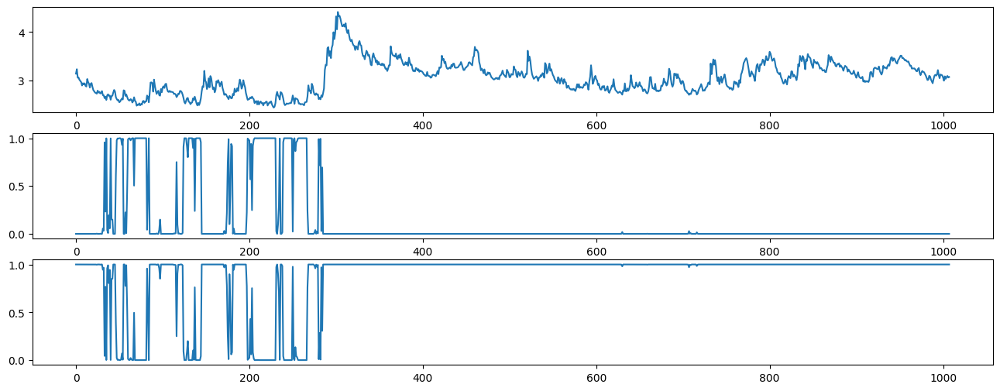


ite=0, max(diff) = 4.952700395540955

mu_hat0 = [2.5719 3.1221], 
sigma_hat0 = [0.0538 0.2946], 
P_hat0 = 
[[0.8403 0.1597]
 [0.0226 0.9774]], 
pi_hat0 = [0. 1.]



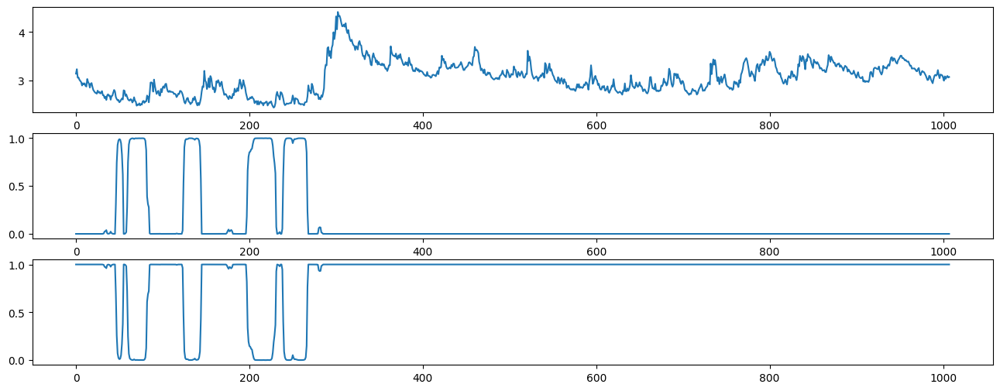


ite=1, max(diff) = 10.951470722571571

mu_hat0 = [2.5658 3.113 ], 
sigma_hat0 = [0.0525 0.2997], 
P_hat0 = 
[[0.9484 0.0516]
 [0.0063 0.9937]], 
pi_hat0 = [0. 1.]



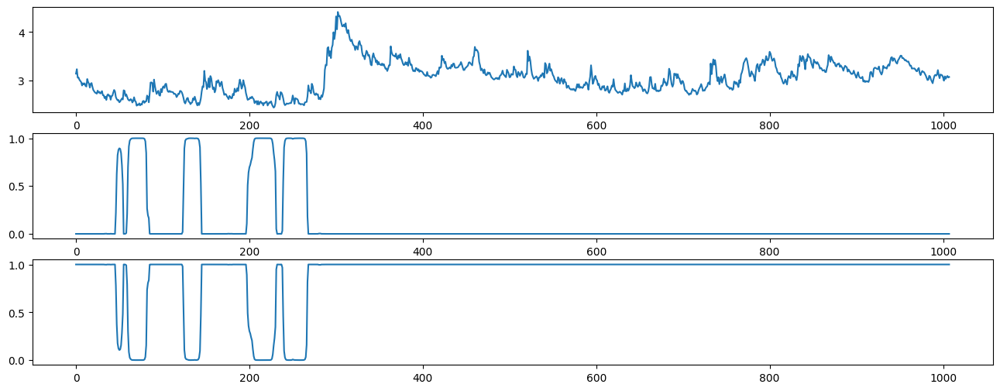


ite=2, max(diff) = 1.7875588255279178

mu_hat0 = [2.5638 3.1115], 
sigma_hat0 = [0.0517 0.3004], 
P_hat0 = 
[[0.9533 0.0467]
 [0.0055 0.9945]], 
pi_hat0 = [0. 1.]



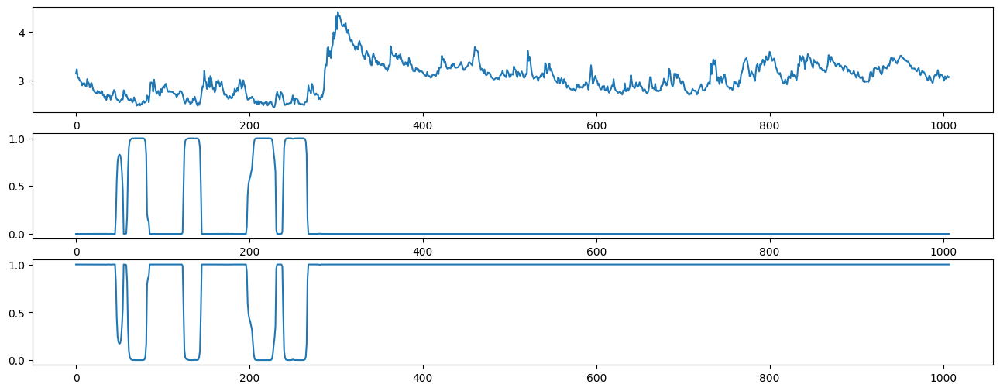


ite=3, max(diff) = 0.07660152175860867

mu_hat0 = [2.5627 3.1105], 
sigma_hat0 = [0.0512 0.3009], 
P_hat0 = 
[[0.9532 0.0468]
 [0.0054 0.9946]], 
pi_hat0 = [0. 1.]



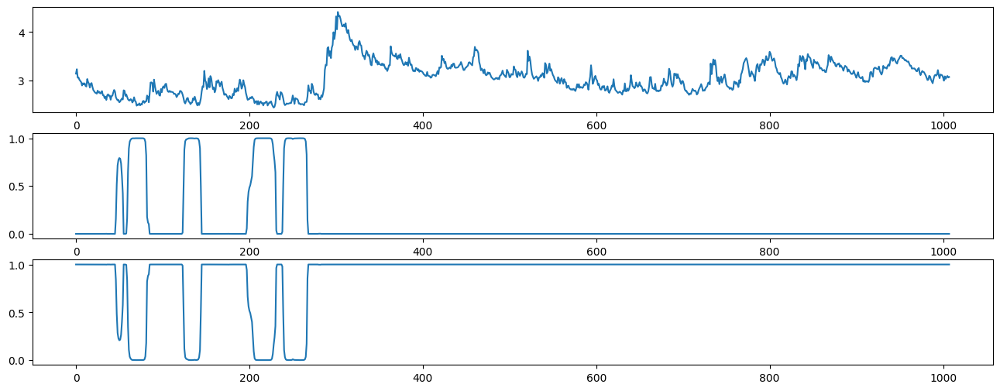


ite=4, max(diff) = 0.09057534051516432

mu_hat0 = [2.562  3.1098], 
sigma_hat0 = [0.0509 0.3013], 
P_hat0 = 
[[0.953  0.047 ]
 [0.0054 0.9946]], 
pi_hat0 = [0. 1.]



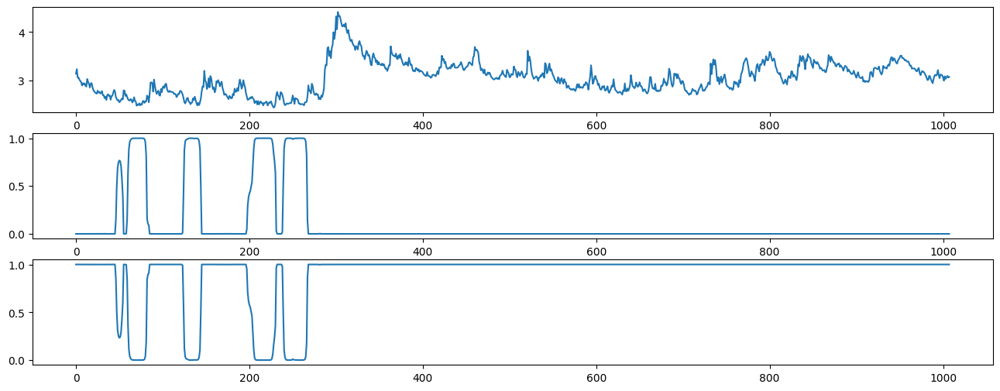


ite=5, max(diff) = 0.06218463272307505

mu_hat0 = [2.5615 3.1094], 
sigma_hat0 = [0.0507 0.3015], 
P_hat0 = 
[[0.9529 0.0471]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



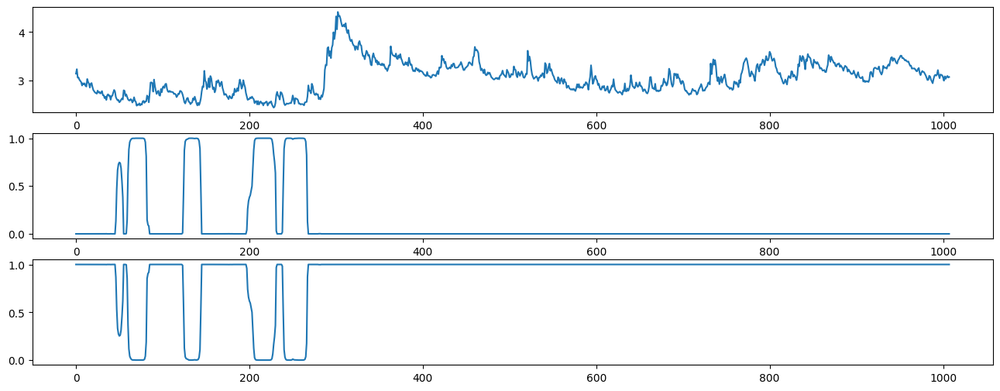


ite=6, max(diff) = 0.04184787085757746

mu_hat0 = [2.5611 3.1091], 
sigma_hat0 = [0.0505 0.3016], 
P_hat0 = 
[[0.9528 0.0472]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



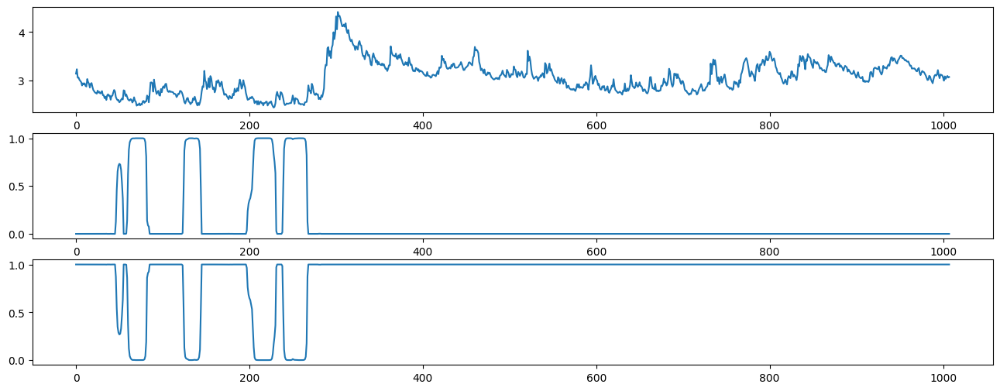


ite=7, max(diff) = 0.02840852373105446

mu_hat0 = [2.5608 3.1089], 
sigma_hat0 = [0.0504 0.3018], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



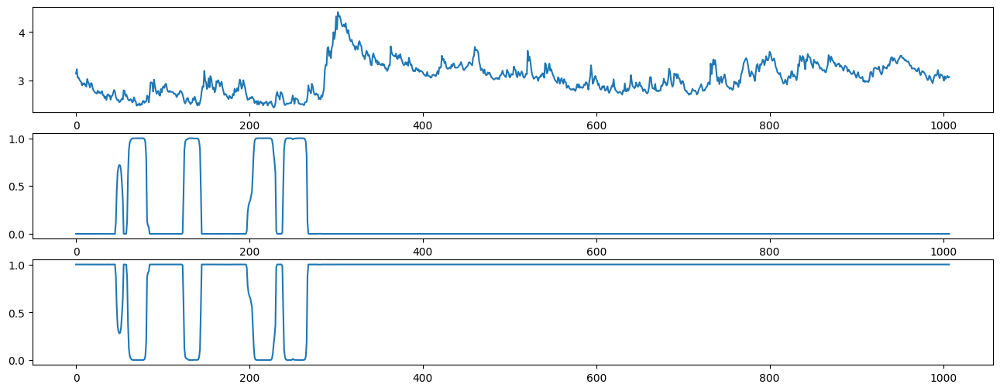


ite=8, max(diff) = 0.019471111347861052

mu_hat0 = [2.5606 3.1087], 
sigma_hat0 = [0.0503 0.3018], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



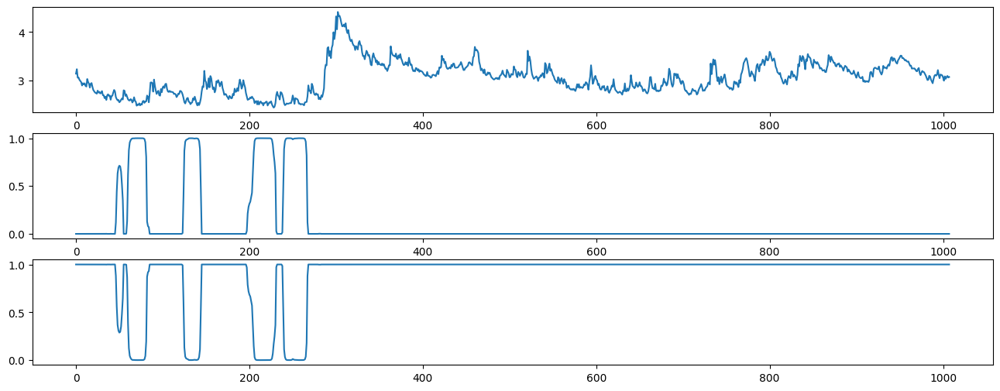


ite=9, max(diff) = 0.013458450722249141

mu_hat0 = [2.5605 3.1086], 
sigma_hat0 = [0.0502 0.3019], 
P_hat0 = 
[[0.9527 0.0473]
 [0.0053 0.9947]], 
pi_hat0 = [0. 1.]



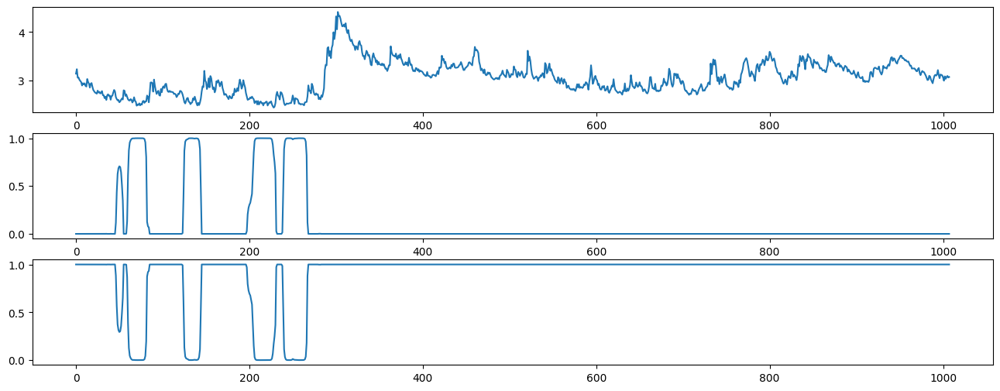


ite=10, max(diff) = 0.009371234326401518

mu_hat1 = [2.5604 3.1085], 
sigma_hat1 = [0.0502 0.3019], 
P_hat1 = 
[[0.9527 0.0473]
 [0.0052 0.9948]], 
pi_hat1 = [0. 1.]


In [ ]:
#Assume different mu different sigma
# Initialize parameters
T = len(YData)
N = 2

# SET INITIAL GUESSES

mu_hat0 = [2, 4] * np.ones((N))
sigma_hat0 = [0.1, 0.2] * np.ones((N))
P_hat0 = P_tauchen #Take result of tauchen method as the transition matrix

pi_hat0 = [0.5, 0.5] * np.ones((N))
for t in range(1, 100):
    pi_hat0 = np.dot(P_hat0.T, pi_hat0)

# Determine maximum number of iterations until convergence and convergence tolerance
itemax = 100
itetol = 1e-2

for ite in range(0, itemax):
    #print(mu_hat0, sigma_hat0, P_hat0, pi_hat0)
    print(f"\nmu_hat0 = {np.round(mu_hat0,4)}, \nsigma_hat0 = {np.round(sigma_hat0,4)}, \nP_hat0 = \n{np.round(P_hat0,4)}, \npi_hat0 = {np.round(pi_hat0,4)}")

    # E-step
    xi_prob_t, xi_prob_t1 = forward_alg(
        pi_hat0, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )
    xi_prob_T = backward_alg(
        xi_prob_t, xi_prob_t1, N, T, P_hat0, mu_hat0, sigma_hat0, YData
    )

    print("")

    plt.subplot(3, 1, 1)
    plt.plot(YData)
    plt.subplot(3, 1, 2)
    plt.plot(xi_prob_T[:, 0])
    plt.subplot(3, 1, 3)
    plt.plot(xi_prob_T[:, 1])
    fig = plt.gcf()
    fig.set_size_inches(16, 6)
    plt.show()
    print("")

    # Compute Pr(s_t+1 = j, s_t = i)
    P_hat_T = np.zeros((N, N, T))
    for tt in range(1, T):
        for ss in range(0, N):
            for ss2 in range(0, N):
                P_hat_T[ss, ss2, tt] = (
                    P_hat0[ss, ss2]
                    * xi_prob_t[tt - 1, ss]
                    * xi_prob_T[tt, ss2]
                    / xi_prob_t1[tt - 1, ss2]
                )
    # M-step
    mu_hat1, sigma_hat1, P_hat1, pi_hat1 = M_step_func(xi_prob_T, P_hat_T, N, T, YData)

    diff = np.zeros((4))
    diff[0] = np.sum(np.absolute(mu_hat1 - mu_hat0)) / (np.min(mu_hat0) + itetol * 1e-2)
    diff[1] = np.sum(np.absolute(sigma_hat1 - sigma_hat0)) / (
        np.min(sigma_hat0) + itetol * 1e-2
    )
    diff[2] = np.sum(np.absolute(np.subtract(P_hat1, P_hat0))) / (
        np.min(P_hat0) + itetol * 1e-2
    )
    diff[3] = np.sum(np.absolute(pi_hat1 - pi_hat0)) / (np.min(pi_hat0) + itetol * 1e-2)

    print(f"ite={ite}, max(diff) = {np.max(diff)}")

    if np.max(diff) > itetol:
        mu_hat0, sigma_hat0, P_hat0, pi_hat0 = mu_hat1, sigma_hat1, P_hat1, pi_hat1
    else:
        print(f"\nmu_hat1 = {np.round(mu_hat1,4)}, \nsigma_hat1 = {np.round(sigma_hat1,4)}, \nP_hat1 = \n{np.round(P_hat1,4)}, \npi_hat1 = {np.round(pi_hat1,4)}")
        break